In [1]:
import os
import json
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
from matplotlib.backends.backend_pdf import PdfPages
from matplotlib_scalebar.scalebar import ScaleBar
import seaborn as sns

from scipy.stats import kde, kruskal
from scipy.stats import mannwhitneyu
from statsmodels.stats.multitest import fdrcorrection
from scikit_posthocs import posthoc_dunn
from statannotations.Annotator import Annotator

import random
import warnings
import operator

import pickle

import sys 
sys.path.append(r'..\utils') 
from utils import get_seaad_colors, get_tx_order, format_box_plot

Data prep

In [2]:
#HANN mapping
class_col = 'class_label_Hierarchical'
subclass_col = 'subclass_label_Hierarchical'
cluster_col = 'cluster_label_Hierarchical'

In [3]:
#Load cell data

output_dir = r'\\allen\programs\celltypes\workgroups\mousecelltypes\SarahWB\datasets\human_exc\analysis\20251107_seaad\ephys'
os.makedirs(output_dir, exist_ok=True)

with open(r"\\allen\programs\celltypes\workgroups\mousecelltypes\SarahWB\datasets\human_exc\data\formatting_dicts\ttype_layer_dict.json", "r") as f:
    ttype_to_layer_dict = json.load(f)

with open(r"\\allen\programs\celltypes\workgroups\mousecelltypes\SarahWB\datasets\human_exc\data\formatting_dicts\L23_ttype_rename.json", "r") as f:
    L23_ttype_rename_dict = json.load(f)


#load and format Patch-seq metadata
metadata_path = r'\\allen\programs\celltypes\workgroups\mousecelltypes\SarahWB\datasets\human_exc\data\metadata\20251008\Datalock_Human_Glut_4_4_25(patchseq_mapping_results).csv'
metadata = pd.read_csv(metadata_path, encoding='latin1')
metadata = metadata.rename(columns={'cell_id' : 'specimen_id', cluster_col: "t_type", subclass_col:'subclass_label'}).set_index('specimen_id')
metadata["layer"] = metadata["t_type"].map(ttype_to_layer_dict)

#split Layer 2 and 3 subclass
metadata["layer_subclass"] = metadata.apply(
    lambda row: "L2 IT" if row["layer"] == 'Layer 2'
                else ("L3 IT" if row["layer"] == 'Layer 3'
                    else row["subclass_label"]),
    axis=1
)
metadata_cols = ['t_type', 'subclass_label', 'layer_subclass', 'layer', 'lobe', 'paradigm']
metadata = metadata[metadata_cols]
metadata['lobe_group'] = metadata['lobe'].apply(lambda x: x if x == 'TemL' else 'Other')
metadata['subclass_label'] = metadata['subclass_label'].fillna('TBD')  #remove vals without a seaad mapping
metadata['t_type'] = metadata['t_type'].fillna('TBD')
metadata['subclass_label'] = metadata['subclass_label'].replace('L5 ET_ME', 'L5 ET')
metadata['t_type'] = metadata['t_type'].replace('L5 ET_ME', 'L5 ET(ME)')
metadata['t_type'] = metadata['t_type'].apply(lambda x: L23_ttype_rename_dict.get(x, x))
metadata['layer'] = metadata["t_type"].map(ttype_to_layer_dict)

#load ephys features 
ephys_data_path = r'\\allen\programs\celltypes\workgroups\mousecelltypes\SarahWB\datasets\human_exc\data\ephys\20251008\20251008_ephys_features.csv'
features = pd.read_csv(ephys_data_path, index_col='specimen_id')
id_cols = ['specimen_name', 'subclass_label_Hierarchical', 'depth_from_pia_norm', 'ephys', 'feature_count'] 	
nwg_cols = [c for c in features.columns if c.startswith('nwg_')] #nathan features for FI curve plot
feature_cols = [c for c in features.columns if not c in (id_cols+nwg_cols)] #ephys features to use in this analysis

sorted_clean_data = metadata.merge(features[feature_cols], how='inner', left_index=True, right_index=True)

In [4]:
#Get custom transcriptomic order
ttype_order, subclass_order = get_tx_order()
group_order = {
    'subclass_label' : subclass_order,
    't_type' :  ttype_order,
    'lobe' : ['TemL', 'FroL'],
    'lobe_group' : ['TemL', 'Other'],
    'paradigm' : ['acute', 'culture'],
    'layer' : sorted(list(set(ttype_to_layer_dict.values())))
}

#Get color dicts
color_dict = get_seaad_colors()
with open(r"\\allen\programs\celltypes\workgroups\mousecelltypes\SarahWB\datasets\human_exc\data\colors\layer_colors.json", "r") as f: layer_color_dict = json.load(f)
with open(r"\\allen\programs\celltypes\workgroups\mousecelltypes\SarahWB\datasets\human_exc\data\colors\lobe_colors.json", "r") as f: lobe_color_dict = json.load(f)
with open(r"\\allen\programs\celltypes\workgroups\mousecelltypes\SarahWB\datasets\human_exc\data\colors\paradigm_colors.json", "r") as f: paradigm_color_dict = json.load(f)

color_dicts = {
    't_type' : color_dict, 
    'subclass_label' : color_dict, 
    'lobe' : lobe_color_dict, 
    'lobe_group' : lobe_color_dict,
    'paradigm' : paradigm_color_dict,
    'layer' : layer_color_dict  
}

Subclass x feature box plots with stats

In [5]:
# subclass x feature stats
x_var = 'subclass_label' #what to do box plots on 
x_var_order = group_order[x_var]

# Kruskal-Wallis H test on all features
kw_pvals = dict()
kw_hvals = dict()
for f in feature_cols:
    # Create a list of groups dynamically
    groups = [sorted_clean_data.loc[sorted_clean_data[x_var] == x][f].dropna() for x in x_var_order]
    
    # Only include groups that have data
    groups = [group for group in groups if not group.empty]

    if len(groups) < 2:
        print(f"Not enough groups with data for feature {f}")
        continue
    try:
        hvalue, pvalue = kruskal(*groups, nan_policy='omit')
        kw_hvals[f] = hvalue
        kw_pvals[f] = pvalue
    except ValueError as e:
        print(f'Kruskal-Wallis not calculated for {f} because of an error: {e}')

# FDR correction
kw_pvals_list = list(kw_pvals.values())
kw_rejected_list, kw_pvals_fdr_list = fdrcorrection(kw_pvals_list, alpha=0.05, method='indep', is_sorted=False)

kw_pvals_fdr = dict(zip(list(kw_pvals.keys()), list(kw_pvals_fdr_list)))
kw_rejected = dict(zip(list(kw_pvals.keys()), list(kw_rejected_list)))

# Post Hoc Dunn test for significant KW features, with FDR correction
dunn_pvals_fdr = dict()
for k, v in kw_rejected.items():
    if v:  # if null hypothesis was rejected, calculate Dunn post hoc
        dunn_pvals_fdr[k] = posthoc_dunn(sorted_clean_data[sorted_clean_data[x_var].isin(x_var_order)], val_col=k, group_col=x_var, p_adjust='fdr_bh', sort=True)


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\1564626365.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L4 IT vs. L5 IT: Custom statistical test, P_val:1.240e-02
L5 IT vs. L5/6 NP: Custom statistical test, P_val:8.530e-08
L6 IT vs. L6 CT: Custom statistical test, P_val:1.105e-04
L6 IT Car3 vs. L6 IT: Custom statistical test, P_val:7.167e-03
L2/3 IT vs. L5 IT: Custom statistical test, P_val:3.098e-03
L4 IT vs. L5/6 NP: Custom statistical test, P_val:1.019e-13
L5/6 NP vs. L6 IT Car3: Custom statistical test, P_val:1.955e-04
L6 IT vs. L6b: Custom statistical test, P_val:5.439e-03
L2/3 IT vs. L5/6 NP: Custom statistical test, P_val:1.675e-14
L5/6 NP vs. L6 IT: Custom statistical test, P_val:2.248e-14
L5/6 NP vs. L6 CT: Custom statistical test, P_val:1.240e-02
L5 IT vs. L6 IT: Custom statistical test, P_val:1.143e-05
L4 IT vs. L6 IT: Custom statistical test, P_val:1.662e-03
L2/3 IT vs. L6 IT: Custom stat

C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\1564626365.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2/3 IT vs. L4 IT: Custom statistical test, P_val:1.003e-08
L4 IT vs. L5 IT: Custom statistical test, P_val:1.285e-15
L5 IT vs. L5/6 NP: Custom statistical test, P_val:4.292e-02
L2/3 IT vs. L5 IT: Custom statistical test, P_val:2.437e-03
L4 IT vs. L5/6 NP: Custom statistical test, P_val:1.530e-02
L5/6 NP vs. L6 IT Car3: Custom statistical test, P_val:1.881e-04
L5/6 NP vs. L6 IT: Custom statistical test, P_val:3.815e-03
L5 IT vs. L6 IT Car3: Custom statistical test, P_val:8.149e-03
L5/6 NP vs. L6 CT: Custom statistical test, P_val:1.431e-02
L4 IT vs. L6 IT Car3: Custom statistical test, P_val:1.048e-10
L4 IT vs. L6 IT: Custom statistical test, P_val:1.003e-08
L2/3 IT vs. L6 IT Car3: Custom statistical test, P_val:2.761e-05
L4 IT vs. L6 CT: Custom statistical test, P_val:8.870e-07
L2/3 IT vs. L6 IT:

C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\1564626365.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2/3 IT vs. L4 IT: Custom statistical test, P_val:3.059e-06
L4 IT vs. L5 IT: Custom statistical test, P_val:1.389e-20
L5 IT vs. L5/6 NP: Custom statistical test, P_val:1.194e-03
L2/3 IT vs. L5 IT: Custom statistical test, P_val:1.153e-07
L4 IT vs. L5/6 NP: Custom statistical test, P_val:1.389e-20
L5/6 NP vs. L6 IT Car3: Custom statistical test, P_val:4.916e-03
L2/3 IT vs. L5/6 NP: Custom statistical test, P_val:1.230e-11
L5/6 NP vs. L6 IT: Custom statistical test, P_val:2.867e-02
L4 IT vs. L6 IT Car3: Custom statistical test, P_val:1.966e-03
L4 IT vs. L6 IT: Custom statistical test, P_val:1.669e-05
L4 IT vs. L6 CT: Custom statistical test, P_val:1.386e-08
L2/3 IT vs. L6 IT: Custom statistical test, P_val:2.375e-02
L2/3 IT vs. L6 CT: Custom statistical test, P_val:1.352e-04
L4 IT vs. L6b: Custom st

C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\1564626365.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2/3 IT vs. L4 IT: Custom statistical test, P_val:7.373e-04
L4 IT vs. L5 IT: Custom statistical test, P_val:3.162e-09
L5 IT vs. L5/6 NP: Custom statistical test, P_val:3.119e-05
L6 IT vs. L6 CT: Custom statistical test, P_val:2.424e-02
L6 IT Car3 vs. L6 IT: Custom statistical test, P_val:2.620e-02
L2/3 IT vs. L5 IT: Custom statistical test, P_val:6.324e-03
L4 IT vs. L5/6 NP: Custom statistical test, P_val:6.957e-17
L5/6 NP vs. L6 IT Car3: Custom statistical test, P_val:2.760e-02
L6 IT vs. L6b: Custom statistical test, P_val:1.914e-02
L2/3 IT vs. L5/6 NP: Custom statistical test, P_val:1.926e-10
L5/6 NP vs. L6 IT: Custom statistical test, P_val:3.426e-07
L5/6 NP vs. L6 CT: Custom statistical test, P_val:2.424e-02
L5 IT vs. L6 IT: Custom statistical test, P_val:1.020e-02
L4 IT vs. L6 IT Car3: Custom

C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\1564626365.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2/3 IT vs. L4 IT: Custom statistical test, P_val:2.225e-18
L4 IT vs. L5 IT: Custom statistical test, P_val:5.644e-09
L5 IT vs. L5/6 NP: Custom statistical test, P_val:2.054e-04
L5/6 NP vs. L6 IT Car3: Custom statistical test, P_val:2.226e-05
L2/3 IT vs. L5/6 NP: Custom statistical test, P_val:2.369e-06
L5/6 NP vs. L6 IT: Custom statistical test, P_val:2.226e-05
L5/6 NP vs. L6 CT: Custom statistical test, P_val:1.179e-04
L4 IT vs. L6 IT Car3: Custom statistical test, P_val:2.369e-06
L4 IT vs. L6 IT: Custom statistical test, P_val:2.369e-06
L4 IT vs. L6 CT: Custom statistical test, P_val:1.648e-05


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\1564626365.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2/3 IT vs. L4 IT: Custom statistical test, P_val:1.994e-47
L4 IT vs. L5 IT: Custom statistical test, P_val:3.986e-16
L5/6 NP vs. L5 ET: Custom statistical test, P_val:6.607e-03
L5 IT vs. L5/6 NP: Custom statistical test, P_val:3.102e-07
L2/3 IT vs. L5 IT: Custom statistical test, P_val:6.650e-05
L5/6 NP vs. L6 IT Car3: Custom statistical test, P_val:6.954e-09
L4 IT vs. L5 ET: Custom statistical test, P_val:7.003e-03
L2/3 IT vs. L5/6 NP: Custom statistical test, P_val:2.288e-15
L5/6 NP vs. L6 IT: Custom statistical test, P_val:7.600e-13
L5 IT vs. L6 IT Car3: Custom statistical test, P_val:7.188e-03
L5/6 NP vs. L6 CT: Custom statistical test, P_val:6.460e-06
L5 IT vs. L6 IT: Custom statistical test, P_val:3.904e-05
L4 IT vs. L6 IT Car3: Custom statistical test, P_val:5.546e-11
L4 IT vs. L6 IT: Cust

C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\1564626365.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2/3 IT vs. L4 IT: Custom statistical test, P_val:4.697e-02
L5/6 NP vs. L5 ET: Custom statistical test, P_val:6.355e-04
L5 IT vs. L5/6 NP: Custom statistical test, P_val:2.007e-12
L5 ET vs. L6 IT Car3: Custom statistical test, P_val:1.073e-02
L6 IT Car3 vs. L6 IT: Custom statistical test, P_val:1.740e-02
L2/3 IT vs. L5 IT: Custom statistical test, P_val:8.237e-03
L4 IT vs. L5/6 NP: Custom statistical test, P_val:1.252e-11
L6 IT Car3 vs. L6 CT: Custom statistical test, P_val:2.290e-03
L2/3 IT vs. L5/6 NP: Custom statistical test, P_val:1.344e-08
L5/6 NP vs. L6 IT: Custom statistical test, P_val:9.112e-07
L5 IT vs. L6 IT Car3: Custom statistical test, P_val:3.171e-03
L2/3 IT vs. L5 ET: Custom statistical test, P_val:4.697e-02
L5/6 NP vs. L6 CT: Custom statistical test, P_val:1.604e-08
L4 IT vs. L6 I

C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\1564626365.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2/3 IT vs. L4 IT: Custom statistical test, P_val:7.923e-55
L4 IT vs. L5 IT: Custom statistical test, P_val:1.743e-12
L5/6 NP vs. L5 ET: Custom statistical test, P_val:7.011e-06
L5 IT vs. L5/6 NP: Custom statistical test, P_val:3.370e-04
L2/3 IT vs. L5 IT: Custom statistical test, P_val:9.803e-10
L5 IT vs. L5 ET: Custom statistical test, P_val:1.786e-03
L5/6 NP vs. L6 IT Car3: Custom statistical test, P_val:2.257e-07
L4 IT vs. L5 ET: Custom statistical test, P_val:5.192e-07
L2/3 IT vs. L5/6 NP: Custom statistical test, P_val:8.536e-14
L5/6 NP vs. L6 IT: Custom statistical test, P_val:7.107e-12
L5 IT vs. L6 IT Car3: Custom statistical test, P_val:1.441e-03
L5/6 NP vs. L6 CT: Custom statistical test, P_val:1.578e-05
L5 IT vs. L6 IT: Custom statistical test, P_val:3.997e-07
L4 IT vs. L6 IT Car3: Cust

C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\1564626365.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2/3 IT vs. L4 IT: Custom statistical test, P_val:2.894e-65
L4 IT vs. L5 IT: Custom statistical test, P_val:2.070e-06
L5/6 NP vs. L5 ET: Custom statistical test, P_val:8.874e-04
L5 IT vs. L5/6 NP: Custom statistical test, P_val:3.809e-04
L2/3 IT vs. L5 IT: Custom statistical test, P_val:1.141e-22
L5 IT vs. L5 ET: Custom statistical test, P_val:2.025e-02
L5/6 NP vs. L6 IT Car3: Custom statistical test, P_val:8.874e-04
L6 IT Car3 vs. L6 CT: Custom statistical test, P_val:4.499e-02
L4 IT vs. L5 ET: Custom statistical test, P_val:1.331e-03
L2/3 IT vs. L5/6 NP: Custom statistical test, P_val:1.302e-22
L5/6 NP vs. L6 IT: Custom statistical test, P_val:4.263e-09
L5/6 NP vs. L6 CT: Custom statistical test, P_val:4.263e-09
L5 IT vs. L6 IT: Custom statistical test, P_val:1.471e-04
L4 IT vs. L6 IT Car3: Cust

C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\1564626365.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2/3 IT vs. L5 IT: Custom statistical test, P_val:1.823e-02
L5/6 NP vs. L6 IT Car3: Custom statistical test, P_val:1.762e-03
L5/6 NP vs. L6 IT: Custom statistical test, P_val:3.784e-03
L5 IT vs. L6 IT Car3: Custom statistical test, P_val:2.561e-03
L5 IT vs. L6 IT: Custom statistical test, P_val:6.010e-03
L4 IT vs. L6 IT Car3: Custom statistical test, P_val:2.583e-04
L4 IT vs. L6 IT: Custom statistical test, P_val:6.016e-04
L2/3 IT vs. L6 IT Car3: Custom statistical test, P_val:4.937e-05
L2/3 IT vs. L6 IT: Custom statistical test, P_val:7.112e-05


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\1564626365.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2/3 IT vs. L4 IT: Custom statistical test, P_val:1.771e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\1564626365.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\1564626365.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2/3 IT vs. L4 IT: Custom statistical test, P_val:4.166e-06
L4 IT vs. L5 IT: Custom statistical test, P_val:1.189e-05


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\1564626365.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2/3 IT vs. L4 IT: Custom statistical test, P_val:5.603e-03
L4 IT vs. L5 IT: Custom statistical test, P_val:5.175e-07


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\1564626365.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2/3 IT vs. L4 IT: Custom statistical test, P_val:1.108e-02
L5 IT vs. L6 IT: Custom statistical test, P_val:2.730e-02
L4 IT vs. L6 IT: Custom statistical test, P_val:1.108e-02
L5 IT vs. L6b: Custom statistical test, P_val:2.350e-02
L4 IT vs. L6b: Custom statistical test, P_val:1.108e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\1564626365.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2/3 IT vs. L4 IT: Custom statistical test, P_val:8.675e-08
L4 IT vs. L5 IT: Custom statistical test, P_val:3.198e-07
L5/6 NP vs. L5 ET: Custom statistical test, P_val:5.107e-08
L5 ET vs. L6 IT Car3: Custom statistical test, P_val:4.869e-12
L6 IT Car3 vs. L6 IT: Custom statistical test, P_val:1.596e-03
L2/3 IT vs. L5 IT: Custom statistical test, P_val:1.273e-25
L5 IT vs. L5 ET: Custom statistical test, P_val:8.675e-08
L4 IT vs. L5/6 NP: Custom statistical test, P_val:2.465e-05
L5 ET vs. L6 IT: Custom statistical test, P_val:5.203e-06
L5/6 NP vs. L6 IT Car3: Custom statistical test, P_val:7.081e-03
L6 IT Car3 vs. L6 CT: Custom statistical test, P_val:9.109e-07
L4 IT vs. L5 ET: Custom statistical test, P_val:1.295e-04
L2/3 IT vs. L5/6 NP: Custom statistical test, P_val:5.226e-13
L5 ET vs. L6 CT: Cus

C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\1564626365.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2/3 IT vs. L4 IT: Custom statistical test, P_val:2.658e-74
L4 IT vs. L5 IT: Custom statistical test, P_val:7.247e-08
L5/6 NP vs. L5 ET: Custom statistical test, P_val:4.771e-08
L5 ET vs. L6 IT Car3: Custom statistical test, P_val:9.497e-09
L6 IT Car3 vs. L6 IT: Custom statistical test, P_val:8.854e-05
L2/3 IT vs. L5 IT: Custom statistical test, P_val:2.071e-24
L5 IT vs. L5 ET: Custom statistical test, P_val:2.182e-11
L4 IT vs. L5/6 NP: Custom statistical test, P_val:6.812e-06
L5 ET vs. L6 IT: Custom statistical test, P_val:1.223e-02
L6 IT Car3 vs. L6 CT: Custom statistical test, P_val:1.276e-03
L4 IT vs. L5 ET: Custom statistical test, P_val:1.554e-18
L2/3 IT vs. L5/6 NP: Custom statistical test, P_val:2.590e-06
L5 ET vs. L6 CT: Custom statistical test, P_val:3.560e-03
L5/6 NP vs. L6 IT: Custom s

C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\1564626365.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2/3 IT vs. L4 IT: Custom statistical test, P_val:5.667e-05
L4 IT vs. L5 IT: Custom statistical test, P_val:1.202e-06
L5 ET vs. L6 IT Car3: Custom statistical test, P_val:7.522e-03
L2/3 IT vs. L5 IT: Custom statistical test, P_val:2.509e-20
L5 IT vs. L5 ET: Custom statistical test, P_val:4.677e-02
L4 IT vs. L5/6 NP: Custom statistical test, P_val:1.389e-05
L5/6 NP vs. L6 IT Car3: Custom statistical test, P_val:3.467e-02
L4 IT vs. L5 ET: Custom statistical test, P_val:1.129e-04
L2/3 IT vs. L5/6 NP: Custom statistical test, P_val:1.175e-11
L5 ET vs. L6 CT: Custom statistical test, P_val:1.665e-02
L2/3 IT vs. L5 ET: Custom statistical test, P_val:3.114e-07
L4 IT vs. L6 IT: Custom statistical test, P_val:3.466e-03
L2/3 IT vs. L6 IT: Custom statistical test, P_val:1.851e-06
L2/3 IT vs. L6 CT: Custom st

C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\1564626365.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2/3 IT vs. L4 IT: Custom statistical test, P_val:1.763e-02
L4 IT vs. L5 IT: Custom statistical test, P_val:1.944e-09
L5 IT vs. L5/6 NP: Custom statistical test, P_val:1.486e-05
L5 ET vs. L6 IT Car3: Custom statistical test, P_val:2.611e-05
L6 IT Car3 vs. L6 IT: Custom statistical test, P_val:9.528e-03
L2/3 IT vs. L5 IT: Custom statistical test, P_val:1.371e-18
L5 IT vs. L5 ET: Custom statistical test, P_val:2.824e-03
L4 IT vs. L5/6 NP: Custom statistical test, P_val:7.031e-17
L5/6 NP vs. L6 IT Car3: Custom statistical test, P_val:4.398e-07
L6 IT Car3 vs. L6 CT: Custom statistical test, P_val:1.333e-02
L4 IT vs. L5 ET: Custom statistical test, P_val:1.744e-07
L2/3 IT vs. L5/6 NP: Custom statistical test, P_val:5.051e-23
L5/6 NP vs. L6 IT: Custom statistical test, P_val:3.852e-02
L5 IT vs. L6 IT Ca

C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\1564626365.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L4 IT vs. L5 IT: Custom statistical test, P_val:2.357e-03
L5/6 NP vs. L5 ET: Custom statistical test, P_val:2.379e-04
L5 ET vs. L6 IT Car3: Custom statistical test, P_val:5.010e-04
L2/3 IT vs. L5 IT: Custom statistical test, P_val:4.141e-04
L5 IT vs. L5 ET: Custom statistical test, P_val:1.183e-03
L4 IT vs. L5/6 NP: Custom statistical test, P_val:2.379e-04
L5 ET vs. L6 IT: Custom statistical test, P_val:2.026e-03
L4 IT vs. L5 ET: Custom statistical test, P_val:1.686e-02
L2/3 IT vs. L5/6 NP: Custom statistical test, P_val:2.379e-04
L5 ET vs. L6 CT: Custom statistical test, P_val:2.379e-04
L2/3 IT vs. L5 ET: Custom statistical test, P_val:2.023e-02
L4 IT vs. L6 IT Car3: Custom statistical test, P_val:9.888e-03
L5 ET vs. L6b: Custom statistical test, P_val:2.379e-04
L2/3 IT vs. L6 IT Car3: Custom sta

C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\1564626365.py:24: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(nrows=1,ncols=1,figsize=(7,6),sharex=True, gridspec_kw = {'wspace':0, 'hspace':0.1}) #gridspec_kw = {'wspace':0, 'hspace':0},
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\1564626365.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L4 IT vs. L5 IT: Custom statistical test, P_val:2.327e-02
L5 IT vs. L5/6 NP: Custom statistical test, P_val:2.327e-02
L2/3 IT vs. L5 IT: Custom statistical test, P_val:2.327e-02
L5 IT vs. L5 ET: Custom statistical test, P_val:2.327e-02
L6 IT Car3 vs. L6b: Custom statistical test, P_val:2.327e-02
L5 IT vs. L6b: Custom statistical test, P_val:6.047e-03
L4 IT vs. L6b: Custom statistical test, P_val:2.327e-02
L2/3 IT vs. L6b: Custom statistical test, P_val:2.327e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\1564626365.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2/3 IT vs. L4 IT: Custom statistical test, P_val:1.987e-03
L4 IT vs. L5 IT: Custom statistical test, P_val:1.953e-06
L5/6 NP vs. L5 ET: Custom statistical test, P_val:1.725e-06
L5 ET vs. L6 IT Car3: Custom statistical test, P_val:4.124e-06
L2/3 IT vs. L5 IT: Custom statistical test, P_val:1.706e-02
L5 IT vs. L5 ET: Custom statistical test, P_val:6.642e-06
L4 IT vs. L5/6 NP: Custom statistical test, P_val:9.911e-06
L5 ET vs. L6 IT: Custom statistical test, P_val:1.600e-05
L4 IT vs. L5 ET: Custom statistical test, P_val:4.166e-03
L2/3 IT vs. L5/6 NP: Custom statistical test, P_val:3.737e-03
L5 ET vs. L6 CT: Custom statistical test, P_val:1.725e-06
L2/3 IT vs. L5 ET: Custom statistical test, P_val:1.318e-04
L4 IT vs. L6 IT Car3: Custom statistical test, P_val:2.873e-04
L5 ET vs. L6b: Custom statisti

C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\1564626365.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L5/6 NP vs. L5 ET: Custom statistical test, P_val:6.574e-04
L5 IT vs. L5/6 NP: Custom statistical test, P_val:1.176e-04
L5 ET vs. L6 IT Car3: Custom statistical test, P_val:1.332e-02
L4 IT vs. L5/6 NP: Custom statistical test, P_val:2.553e-05
L5 ET vs. L6 IT: Custom statistical test, P_val:9.618e-03
L6 IT vs. L6b: Custom statistical test, P_val:1.720e-02
L2/3 IT vs. L5/6 NP: Custom statistical test, P_val:1.771e-06
L5 ET vs. L6 CT: Custom statistical test, P_val:3.374e-04
L6 IT Car3 vs. L6b: Custom statistical test, P_val:1.720e-02
L5 IT vs. L6 IT: Custom statistical test, P_val:3.864e-02
L4 IT vs. L6 IT Car3: Custom statistical test, P_val:3.864e-02
L5 ET vs. L6b: Custom statistical test, P_val:3.075e-05
L5 IT vs. L6 CT: Custom statistical test, P_val:3.171e-04
L4 IT vs. L6 IT: Custom statistical

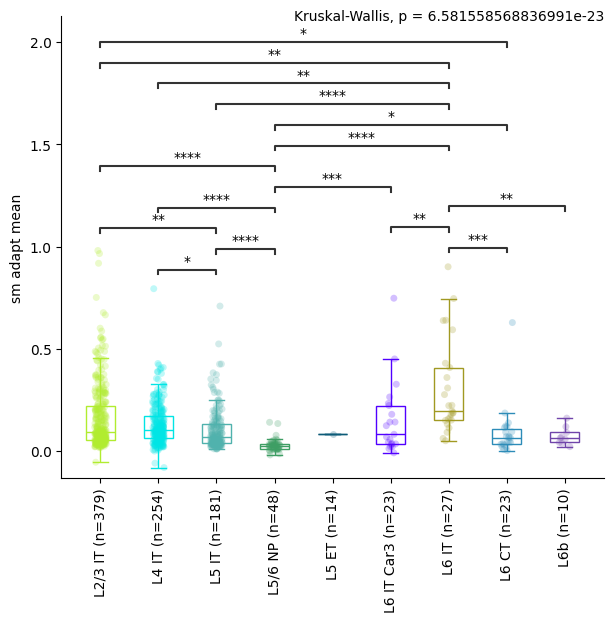

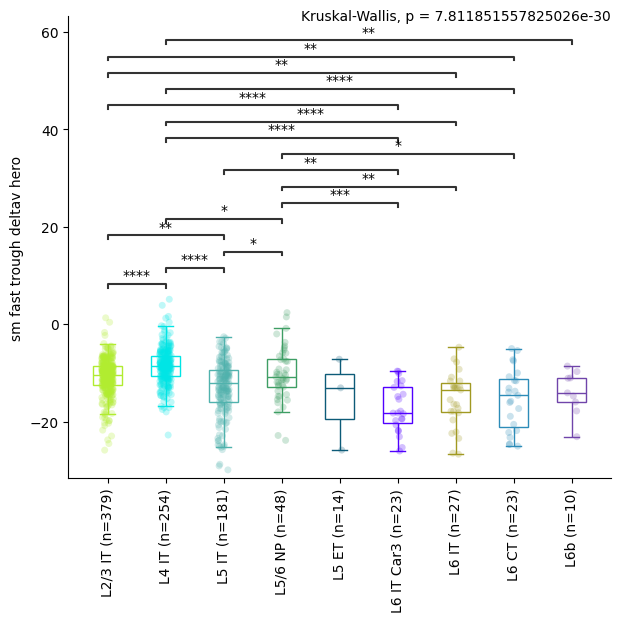

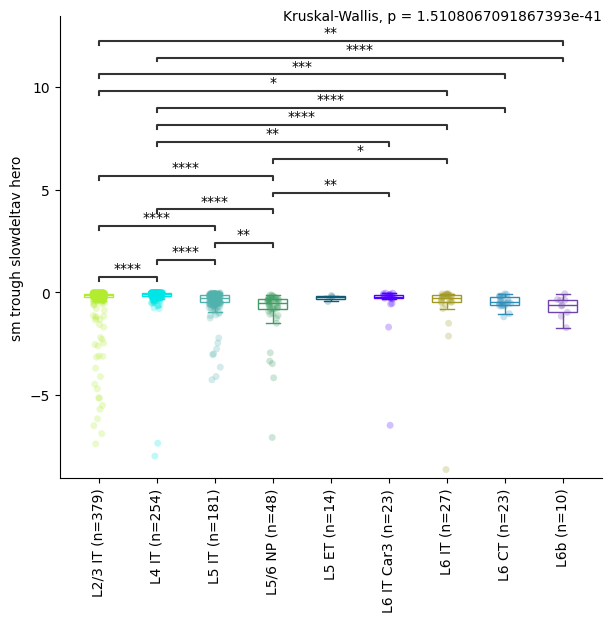

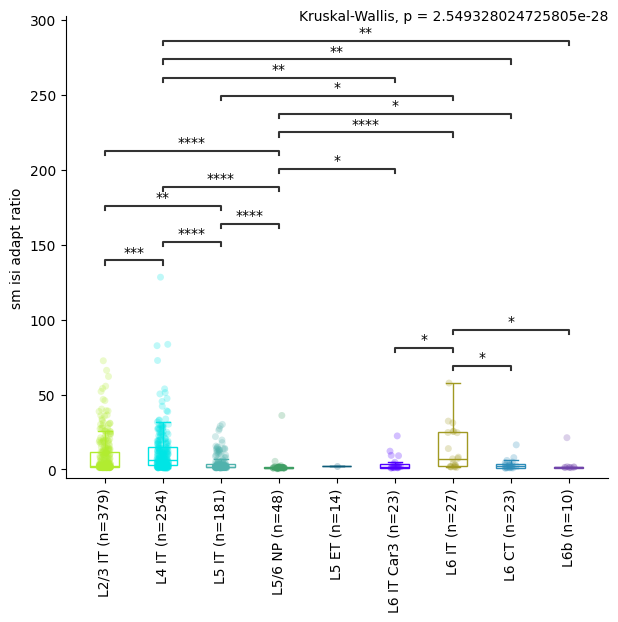

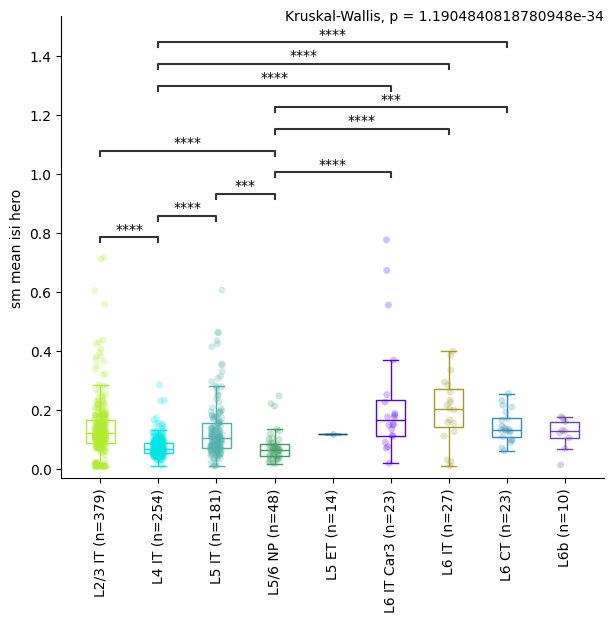

...

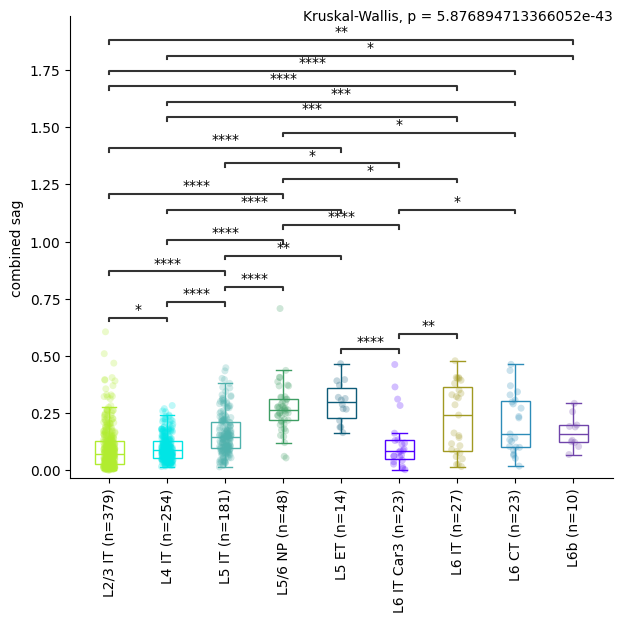

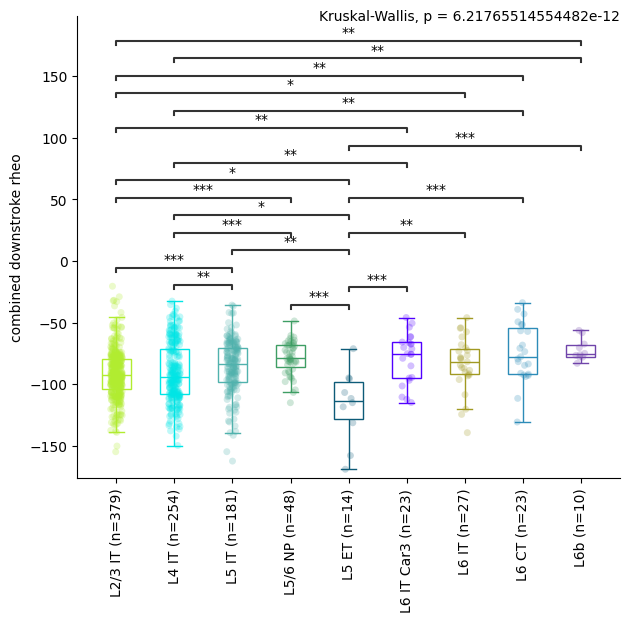

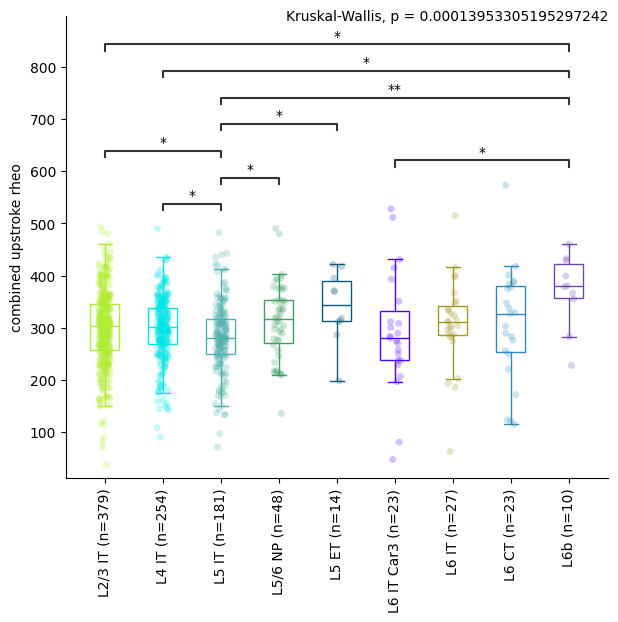

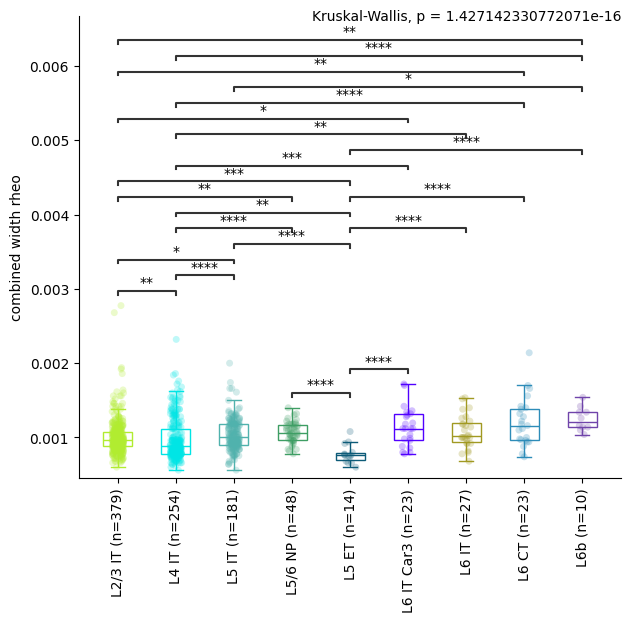

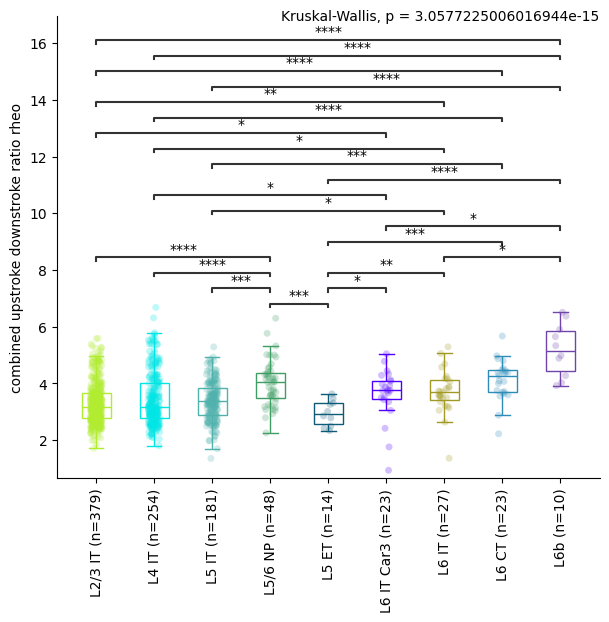

<Figure size 640x480 with 0 Axes>

In [6]:
# subclass x feature box plots

#ADJUST VARS
fig_name = 'human_excitatory_boxplots_ephys_features_KW_Dunn_FDR_bySubclass.pdf'

color_palette = color_dict #colors for x_var
hue_var = 't_type' #seperate strip plots into these categories 
hue_color_palette = color_dicts[hue_var] #color palette for hue_var
##### MAKE SURE TO UPDATE KRUSKAL CALL IN CODE BELOW TO CONTAIN ALL THE X_VAR GROUPS #####

#######################

ephys_features = feature_cols.copy()

fig_path = os.path.join(output_dir, fig_name)

with warnings.catch_warnings():
    warnings.simplefilter(action='ignore', category=FutureWarning)

    with PdfPages(fig_path) as pdf:
        while ephys_features != []:
            
            #one fig per page, each has page (fig) has 4 rows. 
            fig, ax = plt.subplots(nrows=1,ncols=1,figsize=(7,6),sharex=True, gridspec_kw = {'wspace':0, 'hspace':0.1}) #gridspec_kw = {'wspace':0, 'hspace':0},
            # for ax in axes: #plot as many neurons as fit on this page (num_rows rows of plotting)
            
            y_var = ephys_features.pop()
            
            sns.stripplot(data=sorted_clean_data, x=x_var, y=y_var, ax=ax, order=x_var_order, palette=color_palette, alpha=0.25)
            # sns.stripplot(data=sorted_clean_data, x=x_var, y=y_var, ax=ax, order=x_var_order, palette=hue_color_palette, alpha=0.25, 
            #                   hue=hue_var, dodge=True, jitter=False) #TODO figure out how to do this with no legend
            # ax.legend_.remove()
            sns.boxplot(data=sorted_clean_data, x=x_var, y=y_var, ax=ax, order=x_var_order, palette=color_palette, saturation=1, showfliers = False, width=0.5)
            format_box_plot(ax) #color line not fill of boxplot


            #add num observations per x_var
            nobs = []
            for t in x_var_order:
                n = len(sorted_clean_data[sorted_clean_data[x_var] == t])
                nobs.append(" (n=%s)" % str(n))
            new_x_tick_labels = [x_var_order[i] + nobs[i] for i in range(len(x_var_order))]  
            ax.set_xticklabels(new_x_tick_labels)

            # add stats (KW w/ Dunn post hoc FDR corrected)

            #plot signif dunn fdr p-vals 
            if y_var in dunn_pvals_fdr.keys(): 
                #kw fdr val was signif so there are dunn fdr vals to plot
                
                this_dunn_pvals_fdr = dunn_pvals_fdr[y_var]
                remove = np.tril(np.ones(this_dunn_pvals_fdr.shape), k=0).astype("bool")
                this_dunn_pvals_fdr[remove] = np.nan
                dunn_pvals_fdr_melt = this_dunn_pvals_fdr.melt(ignore_index=False).reset_index().dropna()

                #set insignificant pvals to nan 
                p_thresh = 0.05 #threshold for plotting p vals 
                dunn_pvals_fdr_melt.drop(dunn_pvals_fdr_melt[dunn_pvals_fdr_melt['value'] > p_thresh].index, inplace = True)

                #plot bar for all signif fdr corrected dunn p vals 
                pairs = [(i[1]["index"], i[1]["variable"]) for i in dunn_pvals_fdr_melt.iterrows()]
                if len(pairs): 
                    #there's at least one pair of x_vals for which fdr corrected dunn test is signif
                    p_values = [i[1]["value"] for i in dunn_pvals_fdr_melt.iterrows()]                    
                    annotator = Annotator(ax=ax, pairs=pairs, data=sorted_clean_data, x=x_var, y=y_var, order=x_var_order)
                    annotator.configure(text_format="star", loc="inside") #text_format="simple"
                    annotator.set_pvalues_and_annotate(p_values)
                    
            #plot Kruskal-Wallis fdr p-vals
            if y_var in kw_pvals_fdr.keys():
                xlimit = ax.get_xlim()
                ylimit = ax.get_ylim()
                p_txt = 'Kruskal-Wallis, p = ' + str(kw_pvals_fdr[y_var])
                ax.text(xlimit[1], ylimit[1], p_txt, verticalalignment='center', horizontalalignment='right')

            #rotate and format x_var labels 
            ax.set(xlabel=None)
            ax.tick_params(axis='x', rotation=90)
            ax.set_ylabel(y_var.replace("_", " "), rotation=90)
            ax.spines[['right', 'top']].set_visible(False)

            fig.subplots_adjust(wspace=0, hspace=0.0)
            pdf.savefig(dpi=600, bbox_inches='tight')
        plt.show()
        plt.clf()
        print()



T-type x feature box plots with stats

In [7]:
# ttype x feature stats

x_var = 't_type'  # what to do box plots on
x_var_order = [x for x in group_order[x_var] if x in sorted_clean_data[x_var].tolist()]

# Kruskal-Wallis H test on all features
kw_pvals = dict()
kw_hvals = dict()
for f in feature_cols:
    # Create a list of groups dynamically
    groups = [sorted_clean_data.loc[sorted_clean_data[x_var] == x][f].dropna() for x in x_var_order]
    
    # Only include groups that have data
    groups = [group for group in groups if not group.empty]

    if len(groups) < 2:
        print(f"Not enough groups with data for feature {f}")
        continue
    try:
        hvalue, pvalue = kruskal(*groups, nan_policy='omit')
        kw_hvals[f] = hvalue
        kw_pvals[f] = pvalue
    except ValueError as e:
        print(f'Kruskal-Wallis not calculated for {f} because of an error: {e}')

# FDR correction
kw_pvals_list = list(kw_pvals.values())
kw_rejected_list, kw_pvals_fdr_list = fdrcorrection(kw_pvals_list, alpha=0.05, method='indep', is_sorted=False)

kw_pvals_fdr = dict(zip(list(kw_pvals.keys()), list(kw_pvals_fdr_list)))
kw_rejected = dict(zip(list(kw_pvals.keys()), list(kw_rejected_list)))

# Post Hoc Dunn test for significant KW features, with FDR correction
dunn_pvals_fdr = dict()
for k, v in kw_rejected.items():
    if v:  # if null hypothesis was rejected, calculate Dunn post hoc
        dunn_pvals_fdr[k] = posthoc_dunn(sorted_clean_data[sorted_clean_data[x_var].isin(x_var_order)], val_col=k, group_col=x_var, p_adjust='fdr_bh', sort=True)

c:\Users\sarah.wallingbell\AppData\Local\anaconda3\envs\morph_utils_v4\lib\site-packages\scikit_posthocs\_posthocs.py:365: RuntimeWarning: divide by zero encountered in divide
  B = 1.0 / x_lens.loc[i] + 1.0 / x_lens.loc[j]
c:\Users\sarah.wallingbell\AppData\Local\anaconda3\envs\morph_utils_v4\lib\site-packages\scikit_posthocs\_posthocs.py:365: RuntimeWarning: divide by zero encountered in divide
  B = 1.0 / x_lens.loc[i] + 1.0 / x_lens.loc[j]
c:\Users\sarah.wallingbell\AppData\Local\anaconda3\envs\morph_utils_v4\lib\site-packages\scikit_posthocs\_posthocs.py:365: RuntimeWarning: divide by zero encountered in divide
  B = 1.0 / x_lens.loc[i] + 1.0 / x_lens.loc[j]
c:\Users\sarah.wallingbell\AppData\Local\anaconda3\envs\morph_utils_v4\lib\site-packages\scikit_posthocs\_posthocs.py:365: RuntimeWarning: divide by zero encountered in divide
  B = 1.0 / x_lens.loc[i] + 1.0 / x_lens.loc[j]
c:\Users\sarah.wallingbell\AppData\Local\anaconda3\envs\morph_utils_v4\lib\site-packages\scikit_posthocs

C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4152111602.py:41: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4152111602.py:41: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4152111602.py:41: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4152111602.py:41: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users

p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2 IT_6 vs. L2 IT_1: Custom statistical test, P_val:8.155e-04
L4 IT_4 vs. L4 IT_2: Custom statistical test, P_val:2.705e-03
L5 IT_5 vs. L5 IT_2: Custom statistical test, P_val:5.666e-03
L4 IT_1 vs. L5 IT_6: Custom statistical test, P_val:1.071e-11
L5 IT_6 vs. L5 IT_5: Custom statistical test, P_val:1.844e-02
L5 IT_1 vs. L5 IT_7: Custom statistical test, P_val:2.243e-02
L5 IT_3 vs. L5/6 NP_2: Custom statistical test, P_val:1.342e-02
L5/6 NP_4 vs. L5 ET_1: Custom statistical test, P_val:5.805e-03
L2 IT_2 vs. L3 IT_12: Custom statistical test, P_val:3.249e-02
L3 IT_5 vs. L4 IT_3: Custom statistical test, P_val:2.058e-03
L4 IT_4 vs. L4 IT_1: Custom statistical test, P_val:2.103e-02
L4 IT_1 vs. L5 IT_5: Custom statistical test, P_val:3.008e-04
L4 IT_2 vs. L5 IT_6: Custom statistical test, P_val:2.701e-

C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4152111602.py:41: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4152111602.py:41: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L5 ET_1 vs. L5 ET_2: Custom statistical test, P_val:1.673e-02
L5 ET_1 vs. L6 IT Car3_1: Custom statistical test, P_val:4.039e-02
L2 IT_2 vs. L3 IT_10: Custom statistical test, P_val:2.771e-02
L3 IT_5 vs. L4 IT_4: Custom statistical test, P_val:1.840e-02
L5 IT_5 vs. L5 IT_7: Custom statistical test, P_val:4.039e-02
L5 ET_1 vs. L6 IT Car3_3: Custom statistical test, P_val:9.100e-03
L5 IT_6 vs. L5 IT_7: Custom statistical test, P_val:3.770e-02
L5 ET_1 vs. L6 IT Car3_2: Custom statistical test, P_val:1.006e-02
L2 IT_2 vs. L3 IT_5: Custom statistical test, P_val:1.840e-02
L3 IT_10 vs. L4 IT_4: Custom statistical test, P_val:3.085e-02
L4 IT_1 vs. L5 IT_7: Custom statistical test, P_val:1.673e-02
L5 ET_1 vs. L6 IT_2: Custom statistical test, P_val:8.384e-03
L4 IT_2 vs. L5 IT_7: Custom statistical test, P

C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4152111602.py:41: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4152111602.py:41: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4152111602.py:41: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L4 IT_2 vs. L4 IT_1: Custom statistical test, P_val:1.772e-03
L4 IT_4 vs. L4 IT_1: Custom statistical test, P_val:1.340e-02
L4 IT_2 vs. L5 IT_5: Custom statistical test, P_val:2.365e-02
L3 IT_5 vs. L4 IT_2: Custom statistical test, P_val:1.536e-02
L4 IT_2 vs. L5 IT_2: Custom statistical test, P_val:1.173e-03
L4 IT_4 vs. L5 IT_2: Custom statistical test, P_val:1.340e-02
L3 IT_10 vs. L4 IT_2: Custom statistical test, P_val:1.803e-02
L4 IT_2 vs. L5 IT_7: Custom statistical test, P_val:3.753e-02
L2 IT_1 vs. L4 IT_4: Custom statistical test, P_val:6.190e-03
L2 IT_1 vs. L4 IT_2: Custom statistical test, P_val:9.198e-05


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4152111602.py:41: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L4 IT_4 vs. L4 IT_2: Custom statistical test, P_val:4.169e-02
L4 IT_4 vs. L4 IT_1: Custom statistical test, P_val:3.952e-04
L3 IT_5 vs. L4 IT_4: Custom statistical test, P_val:4.862e-02
L4 IT_2 vs. L5 IT_5: Custom statistical test, P_val:4.126e-02
L4 IT_4 vs. L5 IT_6: Custom statistical test, P_val:2.079e-04
L3 IT_13 vs. L4 IT_4: Custom statistical test, P_val:1.019e-02
L4 IT_4 vs. L5 IT_5: Custom statistical test, P_val:2.961e-05
L3 IT_10 vs. L4 IT_4: Custom statistical test, P_val:4.036e-03
L4 IT_4 vs. L5 IT_2: Custom statistical test, P_val:1.253e-04
L4 IT_3 vs. L5 IT_5: Custom statistical test, P_val:1.438e-02
L4 IT_4 vs. L5 IT_7: Custom statistical test, P_val:1.208e-03
L2 IT_1 vs. L4 IT_4: Custom statistical test, P_val:8.343e-05
L5 IT_5 vs. L5 ET_2: Custom statistical test, P_val:4.679e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4152111602.py:41: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L4 IT_4 vs. L4 IT_2: Custom statistical test, P_val:2.245e-07
L3 IT_12 vs. L3 IT_13: Custom statistical test, P_val:3.468e-03
L3 IT_5 vs. L4 IT_2: Custom statistical test, P_val:3.468e-03
L3 IT_13 vs. L4 IT_4: Custom statistical test, P_val:1.072e-02
L4 IT_4 vs. L5 IT_2: Custom statistical test, P_val:4.135e-02
L4 IT_2 vs. L5 IT_7: Custom statistical test, P_val:1.389e-02
L3 IT_12 vs. L4 IT_2: Custom statistical test, P_val:8.377e-06
L2 IT_2 vs. L4 IT_2: Custom statistical test, P_val:3.468e-03
L3 IT_12 vs. L5 IT_6: Custom statistical test, P_val:4.135e-02
L4 IT_2 vs. L5/6 NP_1: Custom statistical test, P_val:3.468e-03
L2 IT_1 vs. L4 IT_2: Custom statistical test, P_val:2.426e-04
L3 IT_12 vs. L5 IT_2: Custom statistical test, P_val:1.389e-02
L2 IT_6 vs. L4 IT_2: Custom statistical test, P_val:2.68

C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4152111602.py:41: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L3 IT_13 vs. L3 IT_5: Custom statistical test, P_val:2.416e-03
L4 IT_4 vs. L4 IT_2: Custom statistical test, P_val:3.205e-15
L4 IT_3 vs. L4 IT_4: Custom statistical test, P_val:2.323e-02
L4 IT_1 vs. L5 IT_6: Custom statistical test, P_val:2.168e-03
L5 ET_2 vs. L6 IT Car3_1: Custom statistical test, P_val:8.967e-05
L3 IT_13 vs. L3 IT_3: Custom statistical test, P_val:1.120e-02
L4 IT_4 vs. L4 IT_1: Custom statistical test, P_val:3.792e-05
L4 IT_1 vs. L5 IT_5: Custom statistical test, P_val:3.995e-03
L4 IT_2 vs. L5 IT_6: Custom statistical test, P_val:2.556e-09
L5/6 NP_4 vs. L5 ET_2: Custom statistical test, P_val:5.226e-03
L5 ET_2 vs. L6 IT Car3_3: Custom statistical test, P_val:2.875e-09
L3 IT_13 vs. L4 IT_3: Custom statistical test, P_val:2.032e-03
L3 IT_5 vs. L4 IT_4: Custom statistical test, P_v

C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4152111602.py:41: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2 IT_6 vs. L2 IT_1: Custom statistical test, P_val:2.192e-04
L4 IT_4 vs. L4 IT_2: Custom statistical test, P_val:1.146e-02
L4 IT_3 vs. L4 IT_4: Custom statistical test, P_val:3.432e-03
L4 IT_1 vs. L5 IT_6: Custom statistical test, P_val:2.488e-07
L5 IT_6 vs. L5 IT_5: Custom statistical test, P_val:6.451e-03
L5 IT_1 vs. L5 IT_7: Custom statistical test, P_val:4.084e-03
L5/6 NP_4 vs. L5 ET_1: Custom statistical test, P_val:2.612e-03
L5 ET_2 vs. L6 IT Car3_1: Custom statistical test, P_val:3.836e-03
L6 IT Car3_2 vs. L6 IT_2: Custom statistical test, P_val:2.153e-02
L2 IT_2 vs. L3 IT_12: Custom statistical test, P_val:1.078e-03
L3 IT_13 vs. L3 IT_3: Custom statistical test, P_val:6.446e-03
L3 IT_5 vs. L4 IT_3: Custom statistical test, P_val:2.748e-03
L3 IT_3 vs. L4 IT_4: Custom statistical test, P_va

C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4152111602.py:41: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L4 IT_2 vs. L4 IT_1: Custom statistical test, P_val:7.167e-04
L4 IT_4 vs. L4 IT_2: Custom statistical test, P_val:3.875e-07
L5 ET_2 vs. L6 IT Car3_1: Custom statistical test, P_val:1.604e-03
L6 CT_1 vs. L6b_6: Custom statistical test, P_val:2.207e-02
L6b_6 vs. L6b_3: Custom statistical test, P_val:3.941e-02
L4 IT_2 vs. L5 IT_6: Custom statistical test, P_val:4.970e-05
L5 ET_1 vs. L6 IT Car3_1: Custom statistical test, P_val:3.542e-02
L4 IT_2 vs. L5 IT_5: Custom statistical test, P_val:6.163e-05
L5 IT_1 vs. L5/6 NP_2: Custom statistical test, P_val:4.115e-02
L6 IT Car3_1 vs. L6 IT_2: Custom statistical test, P_val:1.080e-02
L2 IT_1 vs. L3 IT_12: Custom statistical test, P_val:3.561e-04
L3 IT_5 vs. L4 IT_2: Custom statistical test, P_val:8.283e-03
L4 IT_2 vs. L5 IT_2: Custom statistical test, P_val:

C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4152111602.py:41: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L4 IT_2 vs. L4 IT_1: Custom statistical test, P_val:1.292e-04
L4 IT_3 vs. L4 IT_4: Custom statistical test, P_val:2.306e-02
L5 ET_2 vs. L6 IT Car3_1: Custom statistical test, P_val:9.455e-04
L6 IT Car3_3 vs. L6 IT Car3_2: Custom statistical test, P_val:2.415e-02
L6 IT Car3_2 vs. L6 IT_2: Custom statistical test, P_val:5.482e-04
L2 IT_2 vs. L3 IT_12: Custom statistical test, P_val:3.046e-02
L3 IT_12 vs. L3 IT_13: Custom statistical test, P_val:1.977e-02
L4 IT_4 vs. L4 IT_1: Custom statistical test, P_val:2.218e-06
L4 IT_2 vs. L5 IT_6: Custom statistical test, P_val:9.475e-06
L5 ET_1 vs. L6 IT Car3_1: Custom statistical test, P_val:5.842e-03
L5 ET_2 vs. L6 IT Car3_3: Custom statistical test, P_val:2.458e-02
L6 IT Car3_2 vs. L6 IT_1: Custom statistical test, P_val:3.003e-02
L2 IT_2 vs. L3 IT_10: Cust

C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4152111602.py:41: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2 IT_6 vs. L2 IT_1: Custom statistical test, P_val:2.607e-04
L3 IT_13 vs. L3 IT_5: Custom statistical test, P_val:9.855e-03
L4 IT_4 vs. L4 IT_2: Custom statistical test, P_val:1.054e-25
L4 IT_3 vs. L4 IT_4: Custom statistical test, P_val:2.991e-02
L5 IT_5 vs. L5 IT_2: Custom statistical test, P_val:2.949e-04
L4 IT_1 vs. L5 IT_6: Custom statistical test, P_val:7.125e-08
L5 ET_2 vs. L6 IT Car3_1: Custom statistical test, P_val:2.188e-02
L3 IT_13 vs. L3 IT_3: Custom statistical test, P_val:2.272e-02
L4 IT_3 vs. L4 IT_2: Custom statistical test, P_val:6.840e-03
L4 IT_4 vs. L4 IT_1: Custom statistical test, P_val:1.121e-11
L4 IT_1 vs. L5 IT_5: Custom statistical test, P_val:2.294e-04
L4 IT_2 vs. L5 IT_6: Custom statistical test, P_val:1.081e-15
L5 IT_6 vs. L5 IT_2: Custom statistical test, P_val:4.584

C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4152111602.py:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(nrows=1,ncols=1,figsize=(7,6),sharex=True, gridspec_kw = {'wspace':0, 'hspace':0.1}) #gridspec_kw = {'wspace':0, 'hspace':0},
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4152111602.py:41: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L6 CT_1 vs. L6b_6: Custom statistical test, P_val:3.431e-02
L4 IT_1 vs. L5 IT_5: Custom statistical test, P_val:3.431e-02
L3 IT_5 vs. L4 IT_4: Custom statistical test, P_val:5.273e-03
L3 IT_5 vs. L4 IT_2: Custom statistical test, P_val:1.048e-02
L2 IT_6 vs. L3 IT_12: Custom statistical test, P_val:7.487e-03
L2 IT_2 vs. L3 IT_5: Custom statistical test, P_val:1.151e-02
L3 IT_12 vs. L4 IT_4: Custom statistical test, P_val:4.483e-02
L3 IT_5 vs. L5 IT_6: Custom statistical test, P_val:3.051e-03
L2 IT_1 vs. L3 IT_5: Custom statistical test, P_val:5.273e-03
L3 IT_5 vs. L5 IT_5: Custom statistical test, P_val:1.259e-04
L5 IT_5 vs. L5/6 NP_1: Custom statistical test, P_val:1.545e-02
L6 IT Car3_2 vs. L6b_6: Custom statistical test, P_val:2.454e-02
L2 IT_6 vs. L3 IT_5: Custom statistical test, P_val:1.259e-

C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4152111602.py:41: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2 IT_6 vs. L2 IT_1: Custom statistical test, P_val:1.035e-04
L3 IT_13 vs. L3 IT_5: Custom statistical test, P_val:1.336e-02
L4 IT_2 vs. L4 IT_1: Custom statistical test, P_val:2.754e-02
L4 IT_4 vs. L4 IT_2: Custom statistical test, P_val:9.055e-38
L4 IT_3 vs. L4 IT_4: Custom statistical test, P_val:2.584e-04
L5 IT_5 vs. L5 IT_2: Custom statistical test, P_val:1.043e-04
L4 IT_1 vs. L5 IT_6: Custom statistical test, P_val:1.826e-07
L5/6 NP_4 vs. L5 ET_1: Custom statistical test, P_val:9.421e-03
L5 ET_2 vs. L6 IT Car3_1: Custom statistical test, P_val:2.361e-02
L2 IT_2 vs. L3 IT_12: Custom statistical test, P_val:3.914e-02
L3 IT_12 vs. L3 IT_13: Custom statistical test, P_val:2.913e-02
L4 IT_3 vs. L4 IT_2: Custom statistical test, P_val:9.421e-03
L4 IT_4 vs. L4 IT_1: Custom statistical test, P_val:6

C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4152111602.py:41: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2 IT_6 vs. L2 IT_1: Custom statistical test, P_val:4.577e-02
L3 IT_12 vs. L3 IT_10: Custom statistical test, P_val:2.705e-02
L3 IT_13 vs. L3 IT_5: Custom statistical test, P_val:8.486e-06
L3 IT_8 vs. L3 IT_12: Custom statistical test, P_val:2.521e-02
L4 IT_2 vs. L4 IT_1: Custom statistical test, P_val:1.870e-02
L4 IT_4 vs. L4 IT_2: Custom statistical test, P_val:7.535e-29
L5 IT_5 vs. L5 IT_2: Custom statistical test, P_val:2.141e-02
L4 IT_1 vs. L5 IT_6: Custom statistical test, P_val:8.766e-03
L2 IT_2 vs. L3 IT_12: Custom statistical test, P_val:8.784e-06
L3 IT_12 vs. L3 IT_13: Custom statistical test, P_val:7.486e-04
L3 IT_13 vs. L3 IT_3: Custom statistical test, P_val:2.696e-03
L3 IT_10 vs. L3 IT_5: Custom statistical test, P_val:3.814e-03
L4 IT_3 vs. L4 IT_2: Custom statistical test, P_val:1.3

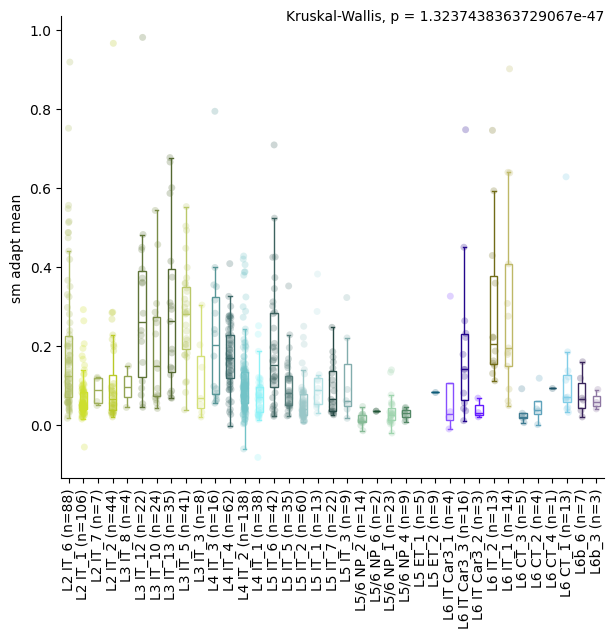

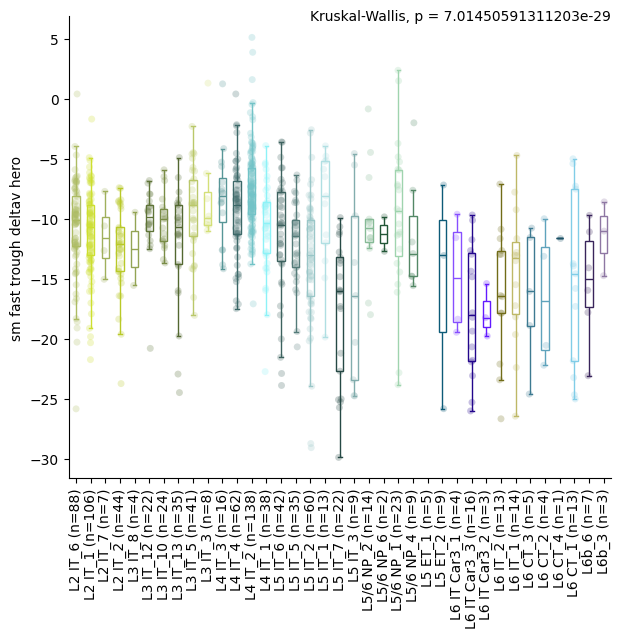

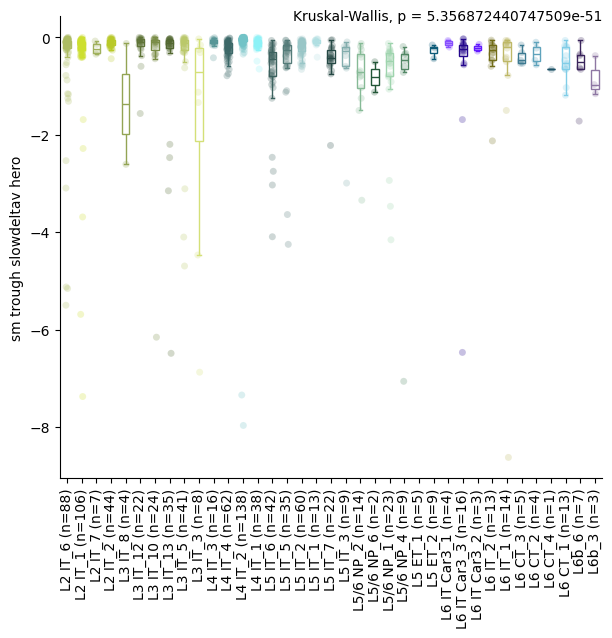

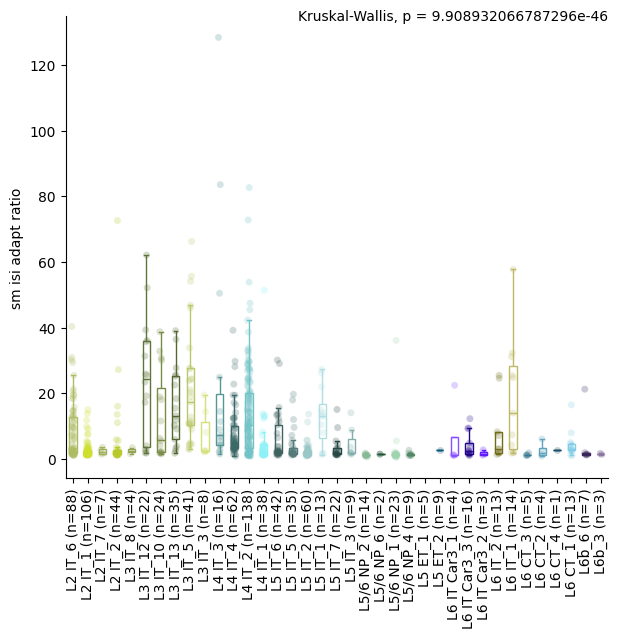

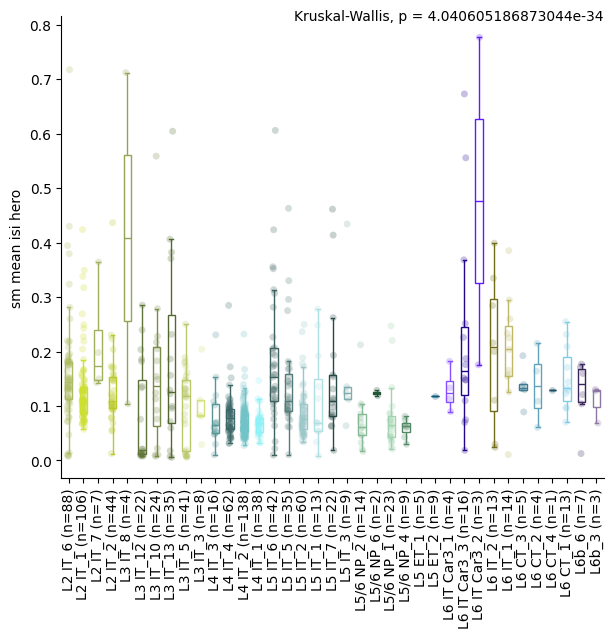

...

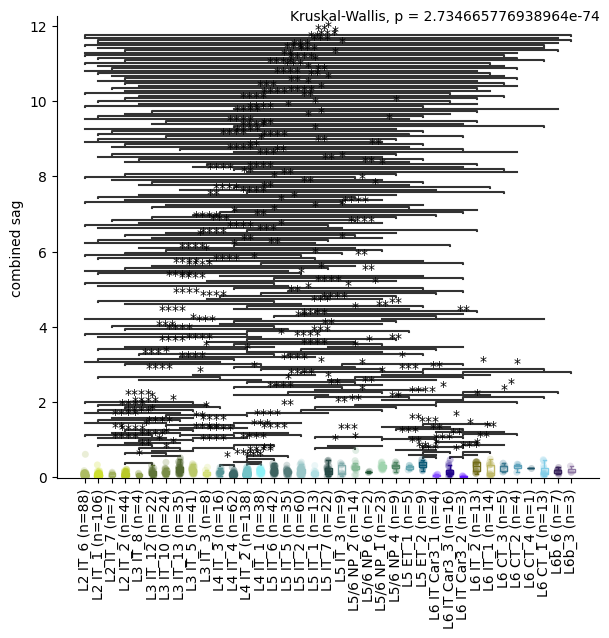

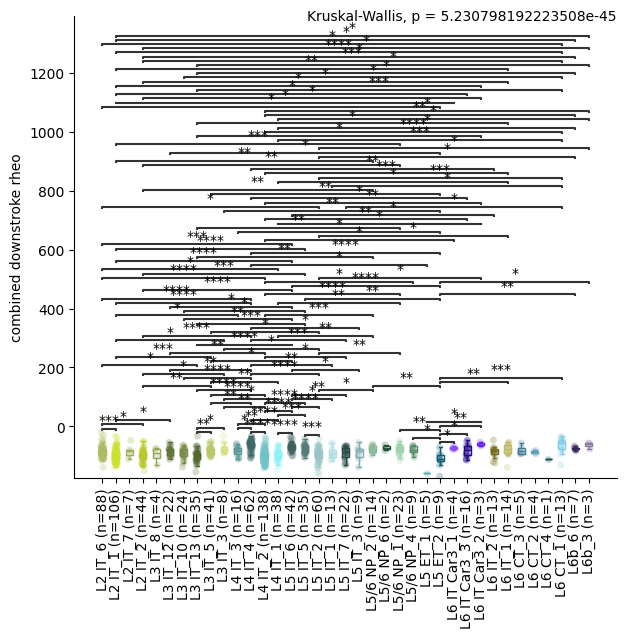

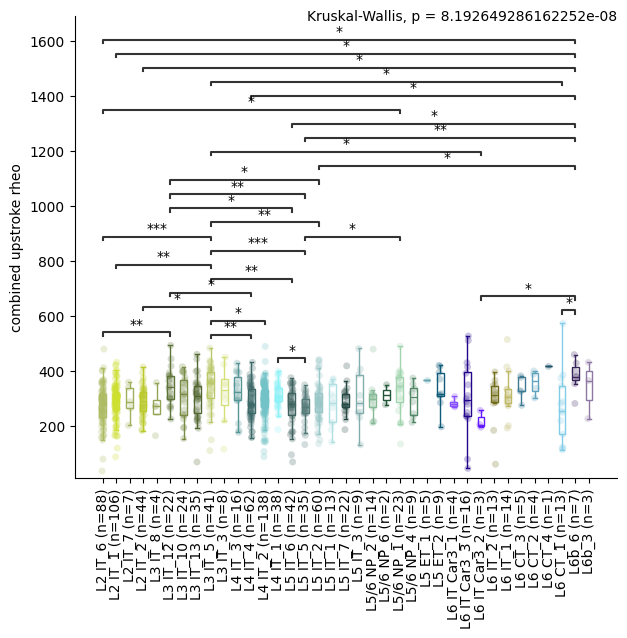

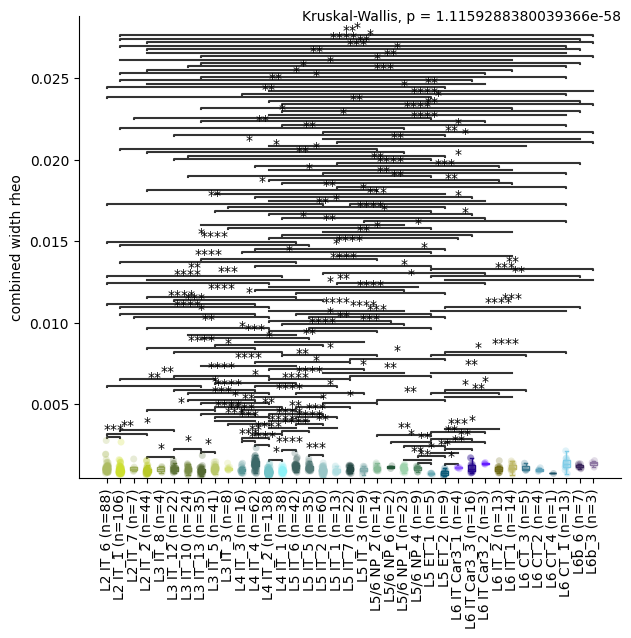

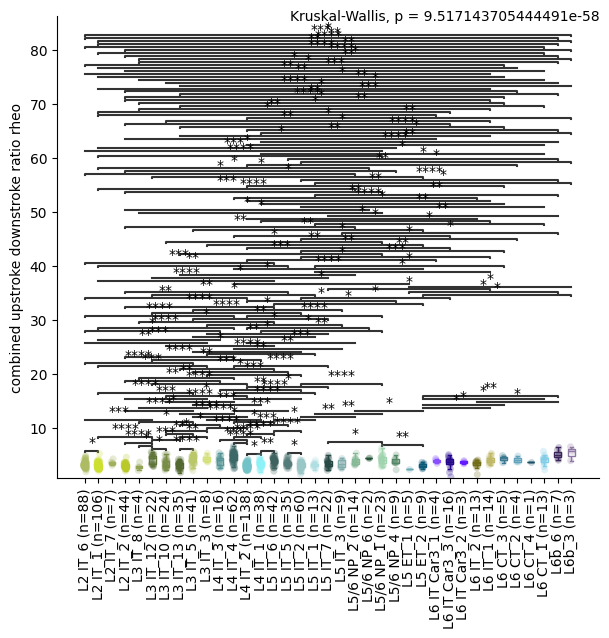

<Figure size 640x480 with 0 Axes>

In [8]:
# ttype x feature box plots

#ADJUST VARS
fig_name = 'human_excitatory_boxplots_ephys_features_KW_Dunn_FDR_byTtype.pdf'
color_palette = color_dict #colors for x_var
hue_var = 't_type' #seperate strip plots into these categories 
hue_color_palette = color_dicts[hue_var] #color palette for hue_var
##### MAKE SURE TO UPDATE KRUSKAL CALL IN CODE BELOW TO CONTAIN ALL THE X_VAR GROUPS #####

#######################

fig_path = os.path.join(output_dir, fig_name)
ephys_features = feature_cols.copy()

with warnings.catch_warnings():
    warnings.simplefilter(action='ignore', category=FutureWarning)

    with PdfPages(fig_path) as pdf:
        while ephys_features != []:
            
            #one fig per page, each has page (fig) has 4 rows. 
            fig, ax = plt.subplots(nrows=1,ncols=1,figsize=(7,6),sharex=True, gridspec_kw = {'wspace':0, 'hspace':0.1}) #gridspec_kw = {'wspace':0, 'hspace':0},
            # for ax in axes: #plot as many neurons as fit on this page (num_rows rows of plotting)
            
            y_var = ephys_features.pop()
            
            sns.stripplot(data=sorted_clean_data, x=x_var, y=y_var, ax=ax, order=x_var_order, palette=color_palette, alpha=0.25)
            # sns.stripplot(data=sorted_clean_data, x=x_var, y=y_var, ax=ax, order=x_var_order, palette=hue_color_palette, alpha=0.25, 
            #                   hue=hue_var, dodge=True, jitter=False) #TODO figure out how to do this with no legend
            # ax.legend_.remove()
            sns.boxplot(data=sorted_clean_data, x=x_var, y=y_var, ax=ax, order=x_var_order, palette=color_palette, saturation=1, showfliers = False, width=0.5)
            format_box_plot(ax) #color line not fill of boxplot


            #add num observations per x_var
            nobs = []
            for t in x_var_order:
                n = len(sorted_clean_data[sorted_clean_data[x_var] == t])
                nobs.append(" (n=%s)" % str(n))
            new_x_tick_labels = [x_var_order[i] + nobs[i] for i in range(len(x_var_order))]  
            ax.set_xticklabels(new_x_tick_labels)

            # add stats (KW w/ Dunn post hoc FDR corrected)

            #plot signif dunn fdr p-vals 
            if y_var in dunn_pvals_fdr.keys(): 
                #kw fdr val was signif so there are dunn fdr vals to plot
                
                this_dunn_pvals_fdr = dunn_pvals_fdr[y_var]
                remove = np.tril(np.ones(this_dunn_pvals_fdr.shape), k=0).astype("bool")
                this_dunn_pvals_fdr[remove] = np.nan
                dunn_pvals_fdr_melt = this_dunn_pvals_fdr.melt(ignore_index=False).reset_index().dropna()

                #set insignificant pvals to nan 
                p_thresh = 0.05 #threshold for plotting p vals 
                dunn_pvals_fdr_melt.drop(dunn_pvals_fdr_melt[dunn_pvals_fdr_melt['value'] > p_thresh].index, inplace = True)

                #plot bar for all signif fdr corrected dunn p vals 
                pairs = [(i[1]["index"], i[1]["variable"]) for i in dunn_pvals_fdr_melt.iterrows()]
                if len(pairs): 
                    #there's at least one pair of x_vals for which fdr corrected dunn test is signif
                    p_values = [i[1]["value"] for i in dunn_pvals_fdr_melt.iterrows()]                    
                    annotator = Annotator(ax, pairs, data=sorted_clean_data, x=x_var, y=y_var, order=x_var_order)
                    annotator.configure(text_format="star", loc="inside") #text_format="simple"
                    annotator.set_pvalues_and_annotate(p_values)
                    
            #plot Kruskal-Wallis fdr p-vals
            if y_var in kw_pvals_fdr.keys():
                xlimit = ax.get_xlim()
                ylimit = ax.get_ylim()
                p_txt = 'Kruskal-Wallis, p = ' + str(kw_pvals_fdr[y_var])
                ax.text(xlimit[1], ylimit[1], p_txt, verticalalignment='center', horizontalalignment='right')

            #rotate and format x_var labels 
            ax.set(xlabel=None)
            ax.tick_params(axis='x', rotation=90)
            ax.set_ylabel(y_var.replace("_", " "), rotation=90)
            ax.spines[['right', 'top']].set_visible(False)

            fig.subplots_adjust(wspace=0, hspace=0.0)
            pdf.savefig(dpi=600, bbox_inches='tight')
        plt.show()
        plt.clf()
        print()



Layer x feature box plots with stats

In [9]:
# subclass x feature stats
x_var = 'layer' #what to do box plots on 
x_var_order = group_order[x_var]

# Kruskal-Wallis H test on all features
kw_pvals = dict()
kw_hvals = dict()
for f in feature_cols:
    # Create a list of groups dynamically
    groups = [sorted_clean_data.loc[sorted_clean_data[x_var] == x][f].dropna() for x in x_var_order]
    
    # Only include groups that have data
    groups = [group for group in groups if not group.empty]

    if len(groups) < 2:
        print(f"Not enough groups with data for feature {f}")
        continue
    try:
        hvalue, pvalue = kruskal(*groups, nan_policy='omit')
        kw_hvals[f] = hvalue
        kw_pvals[f] = pvalue
    except ValueError as e:
        print(f'Kruskal-Wallis not calculated for {f} because of an error: {e}')

# FDR correction
kw_pvals_list = list(kw_pvals.values())
kw_rejected_list, kw_pvals_fdr_list = fdrcorrection(kw_pvals_list, alpha=0.05, method='indep', is_sorted=False)

kw_pvals_fdr = dict(zip(list(kw_pvals.keys()), list(kw_pvals_fdr_list)))
kw_rejected = dict(zip(list(kw_pvals.keys()), list(kw_rejected_list)))

# Post Hoc Dunn test for significant KW features, with FDR correction
dunn_pvals_fdr = dict()
for k, v in kw_rejected.items():
    if v:  # if null hypothesis was rejected, calculate Dunn post hoc
        dunn_pvals_fdr[k] = posthoc_dunn(sorted_clean_data[sorted_clean_data[x_var].isin(x_var_order)], val_col=k, group_col=x_var, p_adjust='fdr_bh', sort=True)


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2502680099.py:37: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Layer 2 vs. Layer 3: Custom statistical test, P_val:6.817e-11
Layer 3 vs. Layer 4: Custom statistical test, P_val:7.574e-07
Layer 4 vs. Layer 5: Custom statistical test, P_val:4.016e-07
Layer 5 vs. Layer 6: Custom statistical test, P_val:3.342e-04
Layer 2 vs. Layer 4: Custom statistical test, P_val:2.390e-02
Layer 3 vs. Layer 5: Custom statistical test, P_val:2.657e-18
Layer 2 vs. Layer 5: Custom statistical test, P_val:6.594e-03
Layer 3 vs. Layer 6: Custom statistical test, P_val:1.152e-04


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2502680099.py:37: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Layer 3 vs. Layer 4: Custom statistical test, P_val:1.934e-03
Layer 4 vs. Layer 5: Custom statistical test, P_val:1.459e-15
Layer 5 vs. Layer 6: Custom statistical test, P_val:1.074e-04
Layer 2 vs. Layer 4: Custom statistical test, P_val:8.619e-10
Layer 3 vs. Layer 5: Custom statistical test, P_val:1.168e-03
Layer 4 vs. Layer 6: Custom statistical test, P_val:1.499e-22
Layer 3 vs. Layer 6: Custom statistical test, P_val:1.255e-09
Layer 2 vs. Layer 6: Custom statistical test, P_val:2.286e-07


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2502680099.py:37: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Layer 3 vs. Layer 4: Custom statistical test, P_val:8.889e-04
Layer 4 vs. Layer 5: Custom statistical test, P_val:1.914e-30
Layer 2 vs. Layer 4: Custom statistical test, P_val:3.802e-06
Layer 3 vs. Layer 5: Custom statistical test, P_val:1.009e-08
Layer 4 vs. Layer 6: Custom statistical test, P_val:7.407e-16
Layer 2 vs. Layer 5: Custom statistical test, P_val:7.451e-11
Layer 3 vs. Layer 6: Custom statistical test, P_val:8.463e-06
Layer 2 vs. Layer 6: Custom statistical test, P_val:3.802e-06


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2502680099.py:37: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Layer 2 vs. Layer 3: Custom statistical test, P_val:1.036e-12
Layer 3 vs. Layer 4: Custom statistical test, P_val:1.333e-02
Layer 4 vs. Layer 5: Custom statistical test, P_val:3.756e-17
Layer 2 vs. Layer 4: Custom statistical test, P_val:2.780e-10
Layer 3 vs. Layer 5: Custom statistical test, P_val:6.499e-18
Layer 4 vs. Layer 6: Custom statistical test, P_val:6.088e-05
Layer 2 vs. Layer 5: Custom statistical test, P_val:4.696e-02
Layer 3 vs. Layer 6: Custom statistical test, P_val:7.600e-08


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2502680099.py:37: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Layer 2 vs. Layer 3: Custom statistical test, P_val:1.120e-03
Layer 3 vs. Layer 4: Custom statistical test, P_val:8.271e-05
Layer 4 vs. Layer 5: Custom statistical test, P_val:6.704e-07
Layer 5 vs. Layer 6: Custom statistical test, P_val:2.460e-05
Layer 2 vs. Layer 4: Custom statistical test, P_val:3.160e-21
Layer 4 vs. Layer 6: Custom statistical test, P_val:1.834e-15
Layer 2 vs. Layer 5: Custom statistical test, P_val:3.507e-05
Layer 3 vs. Layer 6: Custom statistical test, P_val:1.986e-04


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2502680099.py:37: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Layer 2 vs. Layer 3: Custom statistical test, P_val:3.343e-04
Layer 3 vs. Layer 4: Custom statistical test, P_val:4.727e-39
Layer 4 vs. Layer 5: Custom statistical test, P_val:1.499e-12
Layer 5 vs. Layer 6: Custom statistical test, P_val:5.347e-09
Layer 2 vs. Layer 4: Custom statistical test, P_val:2.089e-31
Layer 3 vs. Layer 5: Custom statistical test, P_val:6.235e-13
Layer 4 vs. Layer 6: Custom statistical test, P_val:9.854e-29
Layer 2 vs. Layer 5: Custom statistical test, P_val:9.858e-06
Layer 2 vs. Layer 6: Custom statistical test, P_val:1.048e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2502680099.py:37: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Layer 2 vs. Layer 3: Custom statistical test, P_val:1.926e-11
Layer 3 vs. Layer 4: Custom statistical test, P_val:3.124e-03
Layer 2 vs. Layer 4: Custom statistical test, P_val:2.016e-06
Layer 3 vs. Layer 5: Custom statistical test, P_val:5.749e-05
Layer 2 vs. Layer 5: Custom statistical test, P_val:1.854e-03
Layer 3 vs. Layer 6: Custom statistical test, P_val:6.988e-03
Layer 2 vs. Layer 6: Custom statistical test, P_val:2.755e-03


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2502680099.py:37: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Layer 2 vs. Layer 3: Custom statistical test, P_val:1.372e-03
Layer 3 vs. Layer 4: Custom statistical test, P_val:2.542e-42
Layer 4 vs. Layer 5: Custom statistical test, P_val:6.764e-12
Layer 5 vs. Layer 6: Custom statistical test, P_val:1.824e-11
Layer 2 vs. Layer 4: Custom statistical test, P_val:9.976e-38
Layer 3 vs. Layer 5: Custom statistical test, P_val:1.666e-15
Layer 4 vs. Layer 6: Custom statistical test, P_val:2.973e-32
Layer 2 vs. Layer 5: Custom statistical test, P_val:5.550e-09
Layer 2 vs. Layer 6: Custom statistical test, P_val:1.615e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2502680099.py:37: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Layer 3 vs. Layer 4: Custom statistical test, P_val:5.000e-38
Layer 4 vs. Layer 5: Custom statistical test, P_val:3.903e-05
Layer 5 vs. Layer 6: Custom statistical test, P_val:6.972e-10
Layer 2 vs. Layer 4: Custom statistical test, P_val:1.268e-52
Layer 3 vs. Layer 5: Custom statistical test, P_val:9.417e-21
Layer 4 vs. Layer 6: Custom statistical test, P_val:1.089e-20
Layer 2 vs. Layer 5: Custom statistical test, P_val:4.717e-27


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2502680099.py:37: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Layer 2 vs. Layer 3: Custom statistical test, P_val:4.561e-02
Layer 3 vs. Layer 4: Custom statistical test, P_val:2.472e-02
Layer 5 vs. Layer 6: Custom statistical test, P_val:3.802e-05
Layer 3 vs. Layer 5: Custom statistical test, P_val:1.028e-03
Layer 4 vs. Layer 6: Custom statistical test, P_val:5.216e-07
Layer 3 vs. Layer 6: Custom statistical test, P_val:3.669e-10
Layer 2 vs. Layer 6: Custom statistical test, P_val:2.642e-07


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2502680099.py:37: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Layer 2 vs. Layer 4: Custom statistical test, P_val:8.051e-03


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2502680099.py:37: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Layer 2 vs. Layer 3: Custom statistical test, P_val:1.910e-03
Layer 3 vs. Layer 4: Custom statistical test, P_val:4.613e-03


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2502680099.py:37: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Layer 3 vs. Layer 4: Custom statistical test, P_val:5.165e-05
Layer 4 vs. Layer 5: Custom statistical test, P_val:1.065e-04
Layer 2 vs. Layer 4: Custom statistical test, P_val:5.165e-05
Layer 4 vs. Layer 6: Custom statistical test, P_val:3.666e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2502680099.py:37: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Layer 3 vs. Layer 4: Custom statistical test, P_val:1.307e-02
Layer 4 vs. Layer 5: Custom statistical test, P_val:1.604e-05
Layer 2 vs. Layer 4: Custom statistical test, P_val:7.669e-03


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2502680099.py:37: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Layer 5 vs. Layer 6: Custom statistical test, P_val:7.910e-03
Layer 2 vs. Layer 4: Custom statistical test, P_val:2.847e-03
Layer 4 vs. Layer 6: Custom statistical test, P_val:1.431e-04


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2502680099.py:37: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Layer 3 vs. Layer 4: Custom statistical test, P_val:4.961e-07
Layer 4 vs. Layer 5: Custom statistical test, P_val:1.887e-07
Layer 2 vs. Layer 4: Custom statistical test, P_val:7.861e-06
Layer 3 vs. Layer 5: Custom statistical test, P_val:7.467e-21
Layer 4 vs. Layer 6: Custom statistical test, P_val:7.442e-06
Layer 2 vs. Layer 5: Custom statistical test, P_val:2.676e-21
Layer 3 vs. Layer 6: Custom statistical test, P_val:2.742e-15
Layer 2 vs. Layer 6: Custom statistical test, P_val:2.763e-14


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2502680099.py:37: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Layer 2 vs. Layer 3: Custom statistical test, P_val:3.952e-06
Layer 3 vs. Layer 4: Custom statistical test, P_val:1.662e-64
Layer 4 vs. Layer 5: Custom statistical test, P_val:1.460e-14
Layer 5 vs. Layer 6: Custom statistical test, P_val:1.893e-05
Layer 2 vs. Layer 4: Custom statistical test, P_val:6.032e-48
Layer 3 vs. Layer 5: Custom statistical test, P_val:5.616e-25
Layer 4 vs. Layer 6: Custom statistical test, P_val:9.742e-23
Layer 2 vs. Layer 5: Custom statistical test, P_val:1.819e-11
Layer 3 vs. Layer 6: Custom statistical test, P_val:4.260e-05


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2502680099.py:37: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Layer 2 vs. Layer 3: Custom statistical test, P_val:9.192e-11
Layer 4 vs. Layer 5: Custom statistical test, P_val:7.825e-11
Layer 2 vs. Layer 4: Custom statistical test, P_val:3.671e-11
Layer 3 vs. Layer 5: Custom statistical test, P_val:5.559e-06
Layer 4 vs. Layer 6: Custom statistical test, P_val:1.285e-03
Layer 2 vs. Layer 5: Custom statistical test, P_val:3.070e-39
Layer 3 vs. Layer 6: Custom statistical test, P_val:2.600e-02
Layer 2 vs. Layer 6: Custom statistical test, P_val:2.509e-15


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2502680099.py:37: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Layer 2 vs. Layer 3: Custom statistical test, P_val:1.344e-33
Layer 3 vs. Layer 4: Custom statistical test, P_val:5.782e-09
Layer 4 vs. Layer 5: Custom statistical test, P_val:3.013e-19
Layer 2 vs. Layer 4: Custom statistical test, P_val:5.761e-14
Layer 4 vs. Layer 6: Custom statistical test, P_val:4.375e-06
Layer 2 vs. Layer 5: Custom statistical test, P_val:7.832e-60
Layer 2 vs. Layer 6: Custom statistical test, P_val:3.971e-23


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2502680099.py:37: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Layer 2 vs. Layer 3: Custom statistical test, P_val:1.840e-02
Layer 4 vs. Layer 5: Custom statistical test, P_val:3.414e-04
Layer 5 vs. Layer 6: Custom statistical test, P_val:3.321e-02
Layer 4 vs. Layer 6: Custom statistical test, P_val:1.736e-06
Layer 2 vs. Layer 5: Custom statistical test, P_val:1.084e-06
Layer 3 vs. Layer 6: Custom statistical test, P_val:8.839e-04
Layer 2 vs. Layer 6: Custom statistical test, P_val:1.895e-08


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2502680099.py:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(nrows=1,ncols=1,figsize=(7,6),sharex=True, gridspec_kw = {'wspace':0, 'hspace':0.1}) #gridspec_kw = {'wspace':0, 'hspace':0},
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2502680099.py:37: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Layer 2 vs. Layer 3: Custom statistical test, P_val:4.996e-06
Layer 3 vs. Layer 4: Custom statistical test, P_val:3.484e-03
Layer 5 vs. Layer 6: Custom statistical test, P_val:3.704e-02
Layer 3 vs. Layer 5: Custom statistical test, P_val:2.110e-05
Layer 2 vs. Layer 6: Custom statistical test, P_val:1.686e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2502680099.py:37: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Layer 3 vs. Layer 4: Custom statistical test, P_val:6.453e-04
Layer 4 vs. Layer 5: Custom statistical test, P_val:4.164e-07
Layer 5 vs. Layer 6: Custom statistical test, P_val:1.933e-03
Layer 2 vs. Layer 4: Custom statistical test, P_val:2.758e-02
Layer 4 vs. Layer 6: Custom statistical test, P_val:1.979e-11
Layer 2 vs. Layer 5: Custom statistical test, P_val:4.381e-03
Layer 3 vs. Layer 6: Custom statistical test, P_val:6.927e-04
Layer 2 vs. Layer 6: Custom statistical test, P_val:3.909e-07


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2502680099.py:37: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Layer 2 vs. Layer 3: Custom statistical test, P_val:1.457e-11
Layer 3 vs. Layer 4: Custom statistical test, P_val:5.043e-04
Layer 5 vs. Layer 6: Custom statistical test, P_val:1.178e-05
Layer 2 vs. Layer 4: Custom statistical test, P_val:6.524e-05
Layer 4 vs. Layer 6: Custom statistical test, P_val:9.673e-09
Layer 2 vs. Layer 5: Custom statistical test, P_val:9.673e-09
Layer 3 vs. Layer 6: Custom statistical test, P_val:1.118e-02
Layer 2 vs. Layer 6: Custom statistical test, P_val:1.630e-17


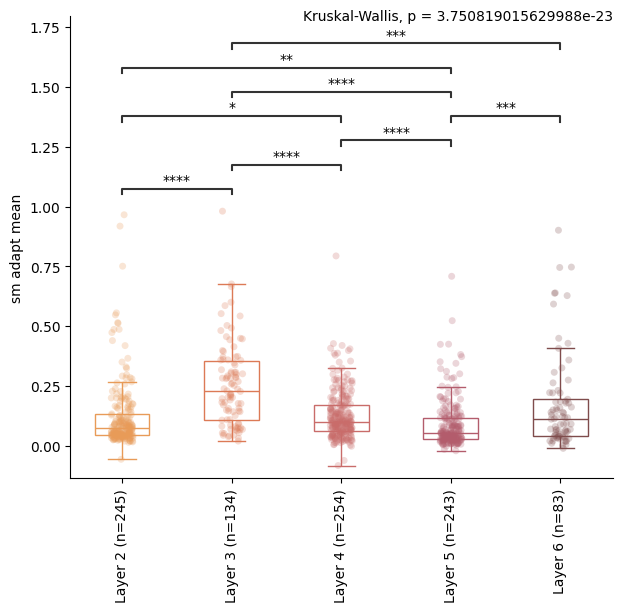

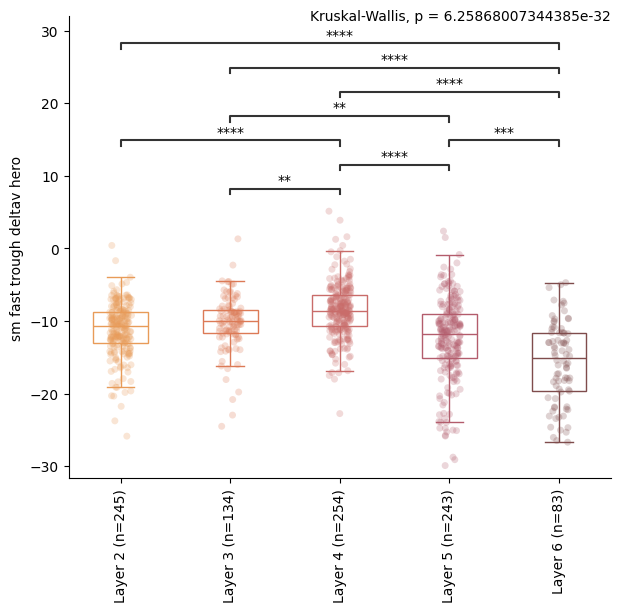

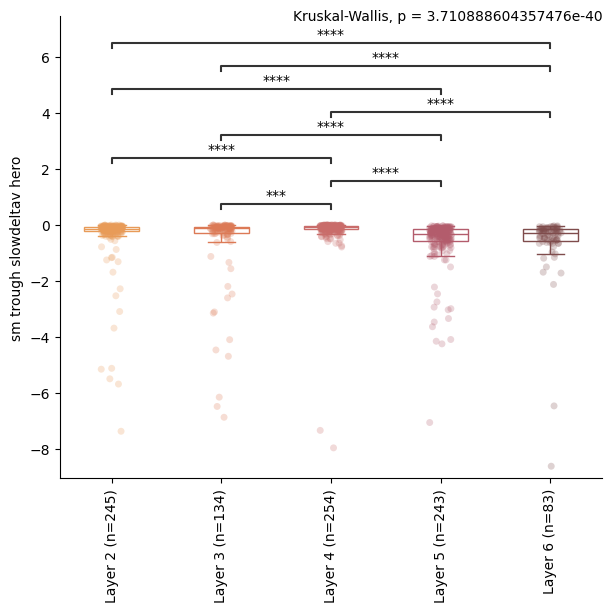

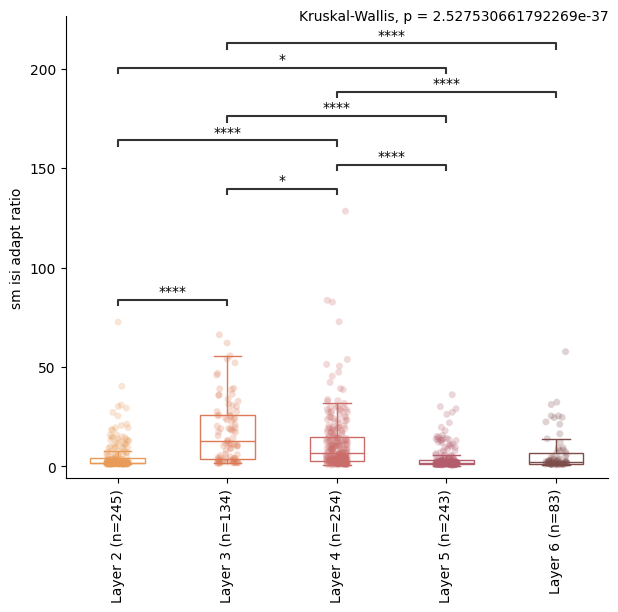

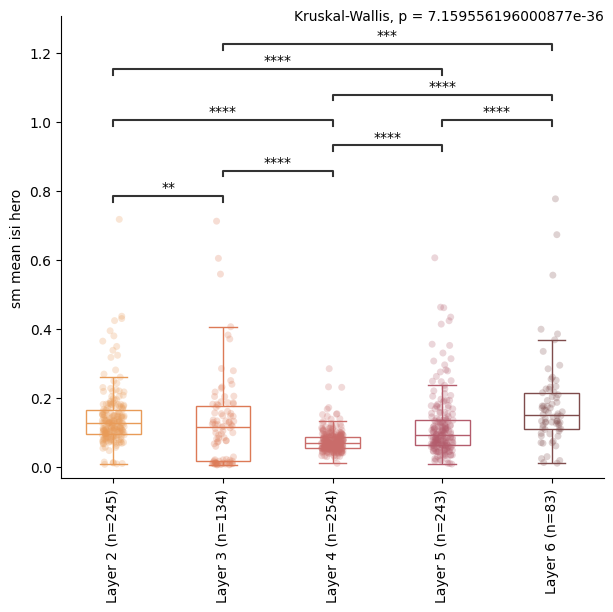

...

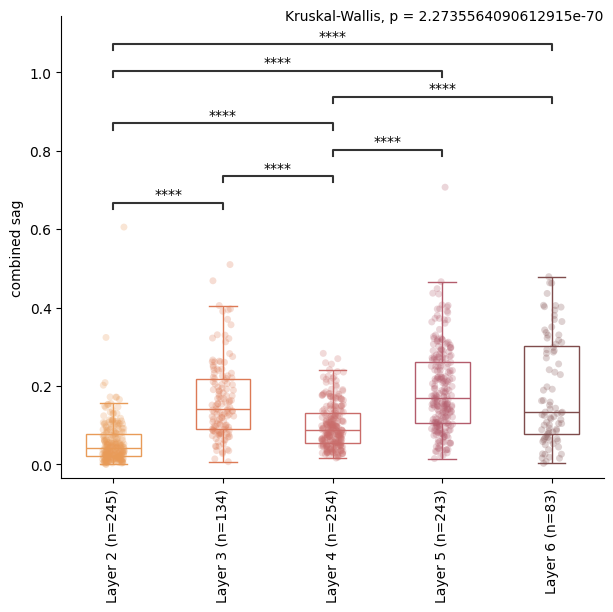

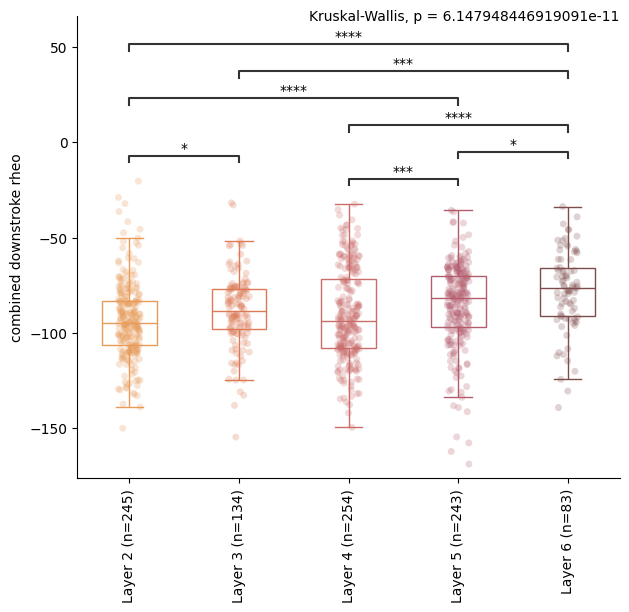

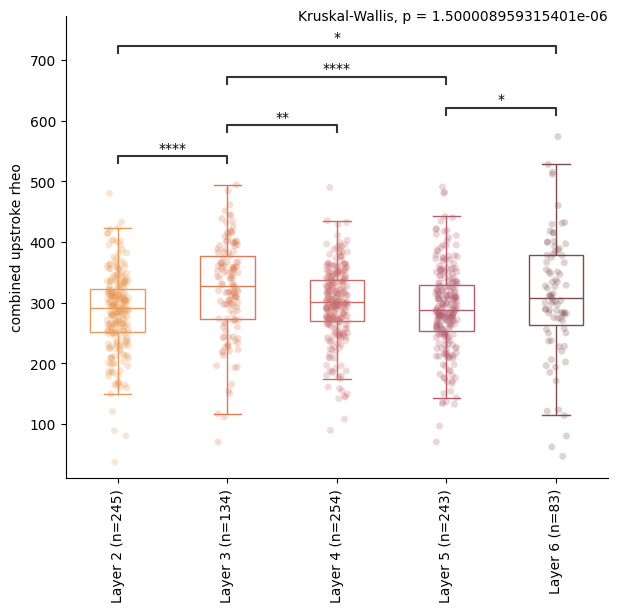

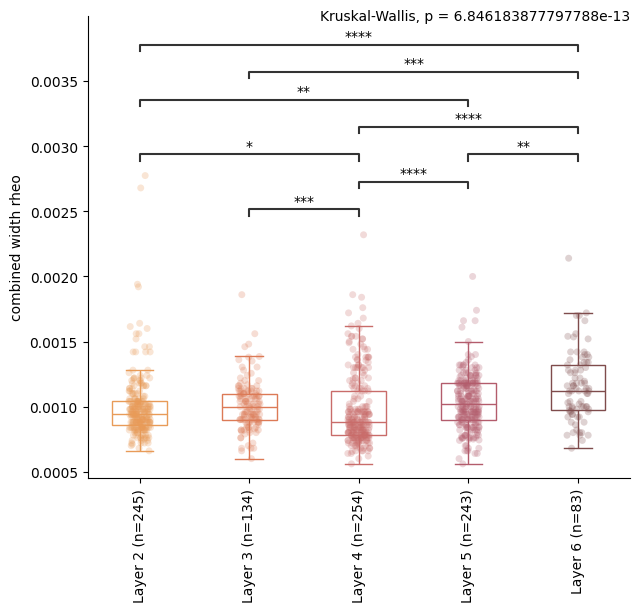

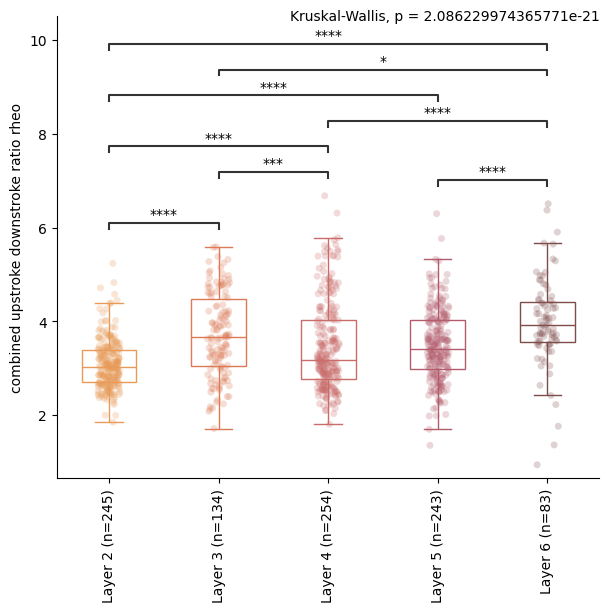

<Figure size 640x480 with 0 Axes>

In [10]:
# subclass x feature box plots

#ADJUST VARS
fig_name = 'human_excitatory_boxplots_ephys_features_KW_Dunn_FDR_byLayer.pdf'

hue_var = 'layer' #seperate strip plots into these categories 
color_palette = color_dicts[hue_var] #colors for x_var

#######################

ephys_features = feature_cols.copy()

fig_path = os.path.join(output_dir, fig_name)

with warnings.catch_warnings():
    warnings.simplefilter(action='ignore', category=FutureWarning)

    with PdfPages(fig_path) as pdf:
        while ephys_features != []:
            
            #one fig per page, each has page (fig) has 4 rows. 
            fig, ax = plt.subplots(nrows=1,ncols=1,figsize=(7,6),sharex=True, gridspec_kw = {'wspace':0, 'hspace':0.1}) #gridspec_kw = {'wspace':0, 'hspace':0},
            # for ax in axes: #plot as many neurons as fit on this page (num_rows rows of plotting)
            
            y_var = ephys_features.pop()
            
            sns.stripplot(data=sorted_clean_data, x=x_var, y=y_var, ax=ax, order=x_var_order, palette=color_palette, alpha=0.25) 
            sns.boxplot(data=sorted_clean_data, x=x_var, y=y_var, ax=ax, order=x_var_order, saturation=1, palette=color_palette, showfliers = False, width=0.5) 
            format_box_plot(ax) #color line not fill of boxplot

            #add num observations per x_var
            nobs = []
            for t in x_var_order:
                n = len(sorted_clean_data[sorted_clean_data[x_var] == t])
                nobs.append(" (n=%s)" % str(n))
            new_x_tick_labels = [x_var_order[i] + nobs[i] for i in range(len(x_var_order))]  
            ax.set_xticklabels(new_x_tick_labels)

            # add stats (KW w/ Dunn post hoc FDR corrected)

            #plot signif dunn fdr p-vals 
            if y_var in dunn_pvals_fdr.keys(): 
                #kw fdr val was signif so there are dunn fdr vals to plot
                
                this_dunn_pvals_fdr = dunn_pvals_fdr[y_var]
                remove = np.tril(np.ones(this_dunn_pvals_fdr.shape), k=0).astype("bool")
                this_dunn_pvals_fdr[remove] = np.nan
                dunn_pvals_fdr_melt = this_dunn_pvals_fdr.melt(ignore_index=False).reset_index().dropna()

                #set insignificant pvals to nan 
                p_thresh = 0.05 #threshold for plotting p vals 
                dunn_pvals_fdr_melt.drop(dunn_pvals_fdr_melt[dunn_pvals_fdr_melt['value'] > p_thresh].index, inplace = True)

                #plot bar for all signif fdr corrected dunn p vals 
                pairs = [(i[1]["index"], i[1]["variable"]) for i in dunn_pvals_fdr_melt.iterrows()]
                if len(pairs): 
                    #there's at least one pair of x_vals for which fdr corrected dunn test is signif
                    p_values = [i[1]["value"] for i in dunn_pvals_fdr_melt.iterrows()]                    
                    annotator = Annotator(ax=ax, pairs=pairs, data=sorted_clean_data, x=x_var, y=y_var, order=x_var_order)
                    annotator.configure(text_format="star", loc="inside") #text_format="simple"
                    annotator.set_pvalues_and_annotate(p_values)
                    
            #plot Kruskal-Wallis fdr p-vals
            if y_var in kw_pvals_fdr.keys():
                xlimit = ax.get_xlim()
                ylimit = ax.get_ylim()
                p_txt = 'Kruskal-Wallis, p = ' + str(kw_pvals_fdr[y_var])
                ax.text(xlimit[1], ylimit[1], p_txt, verticalalignment='center', horizontalalignment='right')

            #rotate and format x_var labels 
            ax.set(xlabel=None)
            ax.tick_params(axis='x', rotation=90)
            ax.set_ylabel(y_var.replace("_", " "), rotation=90)
            ax.spines[['right', 'top']].set_visible(False)

            fig.subplots_adjust(wspace=0, hspace=0.0)
            pdf.savefig(dpi=600, bbox_inches='tight')
        plt.show()
        plt.clf()
        print()



T-Types within each Layer x feature box plots with stats

In [6]:
#ttypes within each layer

ttype_order = group_order['t_type']

# layer x feature stats
layer_var = 'layer' #what to do box plots on 
layer_var_order = group_order[layer_var]

kw_pvals_fdr_layer = dict()
dunn_pvals_fdr_layer = dict()
for layer in layer_var_order:
    print(layer)
    layer_data = sorted_clean_data.loc[sorted_clean_data[layer_var] == layer]

    #now run stats on the ttypes in this layer 
    x_var = 't_type'  # what to do box plots on
    x_var_order = [t for t in ttype_order if t in layer_data[x_var].unique()]

    # Kruskal-Wallis H test on all features
    kw_hvals = dict()
    kw_pvals = dict()
    for f in feature_cols:
        # Create a list of groups dynamically
        groups = [layer_data.loc[layer_data[x_var] == x][f].dropna() for x in x_var_order]
        
        # Only include groups that have data
        groups = [group for group in groups if not group.empty]

        if len(groups) < 2:
            print(f"Not enough groups with data for feature {f}")
            continue
        try:
            hvalue, pvalue = kruskal(*groups, nan_policy='omit')
            kw_hvals[f] = hvalue
            kw_pvals[f] = pvalue
        except ValueError as e:
            print(f'Kruskal-Wallis not calculated for {f} because of an error: {e}')

    # FDR correction
    kw_pvals_list = list(kw_pvals.values())
    kw_rejected_list, kw_pvals_fdr_list = fdrcorrection(kw_pvals_list, alpha=0.05, method='indep', is_sorted=False)

    kw_pvals_fdr = dict(zip(list(kw_pvals.keys()), list(kw_pvals_fdr_list)))
    kw_rejected = dict(zip(list(kw_pvals.keys()), list(kw_rejected_list)))

    # Post Hoc Dunn test for significant KW features, with FDR correction
    dunn_pvals_fdr = dict()
    for k, v in kw_rejected.items():
        if v:  # if null hypothesis was rejected, calculate Dunn post hoc
            dunn_pvals_fdr[k] = posthoc_dunn(layer_data[layer_data[x_var].isin(x_var_order)], val_col=k, group_col=x_var, p_adjust='fdr_bh', sort=True)

    kw_pvals_fdr_layer[layer] = kw_pvals_fdr
    dunn_pvals_fdr_layer[layer] = dunn_pvals_fdr

Layer 2
Layer 3
Layer 4
Layer 5


c:\Users\sarah.wallingbell\AppData\Local\anaconda3\envs\morph_utils_v4\lib\site-packages\scikit_posthocs\_posthocs.py:365: RuntimeWarning: divide by zero encountered in divide
  B = 1.0 / x_lens.loc[i] + 1.0 / x_lens.loc[j]
c:\Users\sarah.wallingbell\AppData\Local\anaconda3\envs\morph_utils_v4\lib\site-packages\scikit_posthocs\_posthocs.py:365: RuntimeWarning: divide by zero encountered in divide
  B = 1.0 / x_lens.loc[i] + 1.0 / x_lens.loc[j]
c:\Users\sarah.wallingbell\AppData\Local\anaconda3\envs\morph_utils_v4\lib\site-packages\scikit_posthocs\_posthocs.py:365: RuntimeWarning: divide by zero encountered in divide
  B = 1.0 / x_lens.loc[i] + 1.0 / x_lens.loc[j]
c:\Users\sarah.wallingbell\AppData\Local\anaconda3\envs\morph_utils_v4\lib\site-packages\scikit_posthocs\_posthocs.py:365: RuntimeWarning: divide by zero encountered in divide
  B = 1.0 / x_lens.loc[i] + 1.0 / x_lens.loc[j]
c:\Users\sarah.wallingbell\AppData\Local\anaconda3\envs\morph_utils_v4\lib\site-packages\scikit_posthocs

Layer 6


In [7]:
#Save stats
rows = []

for layer in layer_var_order:
    kw_dict = kw_pvals_fdr_layer.get(layer, {})
    dunn_dict = dunn_pvals_fdr_layer.get(layer, {})
    
    for feature, kw_p in kw_dict.items():
        # if Dunn exists for this feature
        if feature in dunn_dict:
            dunn_df = dunn_dict[feature]
            # Flatten Dunn results: pairwise comparisons
            for i in dunn_df.index:
                for j in dunn_df.columns:
                    if i != j:  # skip self-comparison
                        rows.append({
                            'layer': layer,
                            'feature': feature,
                            'kw_pval_fdr': kw_p,
                            'group1': i,
                            'group2': j,
                            'dunn_pval_fdr': dunn_df.loc[i, j]
                        })
        else:
            # No post-hoc, just KW
            rows.append({
                'layer': layer,
                'feature': feature,
                'kw_pval_fdr': kw_p,
                'group1': None,
                'group2': None,
                'dunn_pval_fdr': None
            })

# Convert to DataFrame
stats_df = pd.DataFrame(rows)
stats_df.to_csv(os.path.join(output_dir, r'ephys_feature_box_plot_stats_supertypes_within_layer.csv'), index=False)
stats_df

,layer,feature,kw_pval_fdr,group1,group2,dunn_pval_fdr
0,Layer 2,combined_upstroke_downstroke_ratio_rheo,0.001258,L2 IT_1,L2 IT_2,0.990434
1,Layer 2,combined_upstroke_downstroke_ratio_rheo,0.001258,L2 IT_1,L2 IT_6,0.007305
2,Layer 2,combined_upstroke_downstroke_ratio_rheo,0.001258,L2 IT_1,L2 IT_7,0.019792
3,Layer 2,combined_upstroke_downstroke_ratio_rheo,0.001258,L2 IT_2,L2 IT_1,0.990434
4,Layer 2,combined_upstroke_downstroke_ratio_rheo,0.001258,L2 IT_2,L2 IT_6,0.019792
...,...,...,...,...,...,...
4924,Layer 6,sm_adapt_mean,0.001096,L6b_6,L6 IT Car3_2,0.775750
4925,Layer 6,sm_adapt_mean,0.001096,L6b_6,L6 IT Car3_3,0.478896
4926,Layer 6,sm_adapt_mean,0.001096,L6b_6,L6 IT_1,0.110756
4927,Layer 6,sm_adapt_mean,0.001096,L6b_6,L6 IT_2,0.084489


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2 IT_6 vs. L2 IT_1: Custom statistical test, P_val:4.579e-08
L2 IT_6 vs. L2 IT_2: Custom statistical test, P_val:8.380e-03


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2 IT_6 vs. L2 IT_1: Custom statistical test, P_val:9.219e-05
L2 IT_6 vs. L2 IT_2: Custom statistical test, P_val:6.358e-03


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2 IT_6 vs. L2 IT_1: Custom statistical test, P_val:2.085e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2 IT_6 vs. L2 IT_1: Custom statistical test, P_val:2.059e-06
L2 IT_6 vs. L2 IT_2: Custom statistical test, P_val:7.027e-03


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2 IT_6 vs. L2 IT_1: Custom statistical test, P_val:9.104e-08
L2 IT_1 vs. L2 IT_7: Custom statistical test, P_val:3.630e-02
L2 IT_6 vs. L2 IT_2: Custom statistical test, P_val:5.984e-04


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2 IT_6 vs. L2 IT_1: Custom statistical test, P_val:2.273e-06
L2 IT_6 vs. L2 IT_2: Custom statistical test, P_val:5.050e-05


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users

p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2 IT_6 vs. L2 IT_1: Custom statistical test, P_val:9.183e-09
L2 IT_1 vs. L2 IT_7: Custom statistical test, P_val:1.530e-02
L2 IT_7 vs. L2 IT_2: Custom statistical test, P_val:1.530e-02
L2 IT_6 vs. L2 IT_2: Custom statistical test, P_val:7.348e-07


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2 IT_1 vs. L2 IT_2: Custom statistical test, P_val:1.290e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2 IT_6 vs. L2 IT_1: Custom statistical test, P_val:2.186e-06
L2 IT_6 vs. L2 IT_2: Custom statistical test, P_val:9.389e-04


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:33: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(nrows=1,ncols=1,figsize=(7,6),sharex=True, gridspec_kw = {'wspace':0, 'hspace':0.1}) #gridspec_kw = {'wspace':0, 'hspace':0},
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2 IT_6 vs. L2 IT_1: Custom statistical test, P_val:3.638e-07
L2 IT_6 vs. L2 IT_2: Custom statistical test, P_val:1.109e-04


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2 IT_6 vs. L2 IT_1: Custom statistical test, P_val:7.305e-03
L2 IT_1 vs. L2 IT_7: Custom statistical test, P_val:1.979e-02
L2 IT_7 vs. L2 IT_2: Custom statistical test, P_val:1.979e-02
L2 IT_6 vs. L2 IT_2: Custom statistical test, P_val:1.979e-02


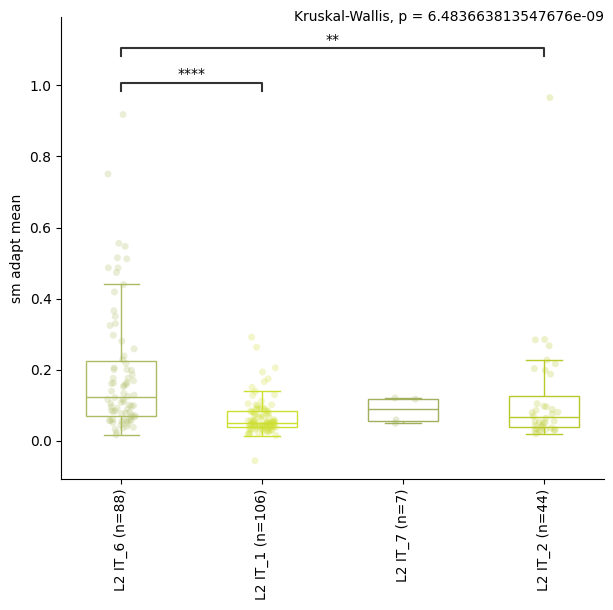

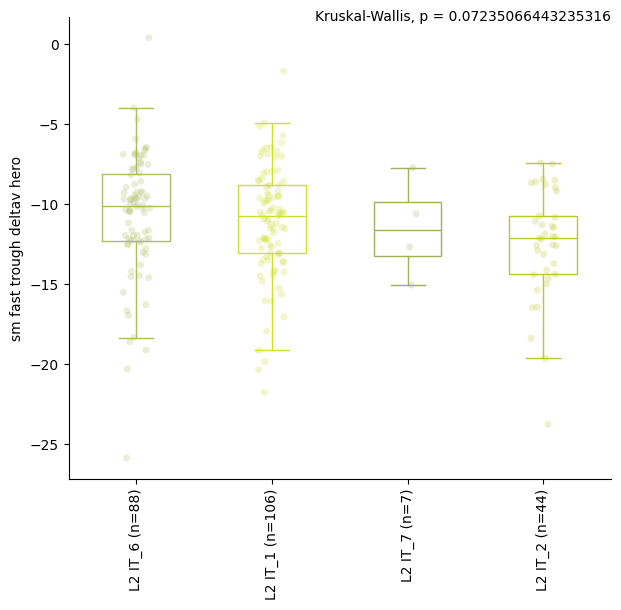

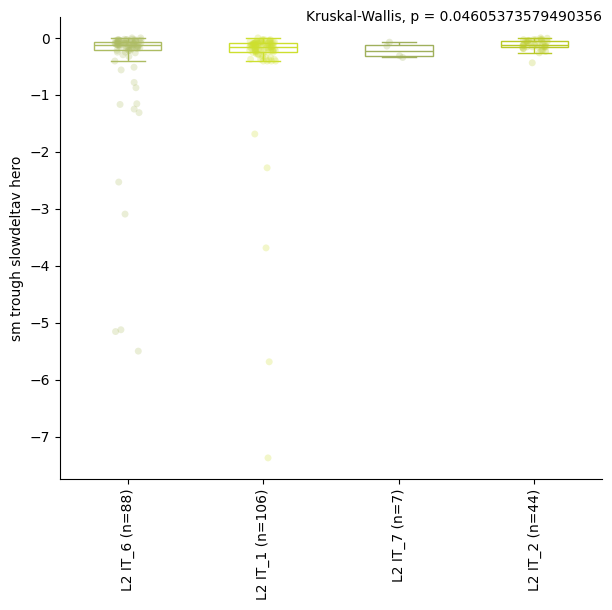

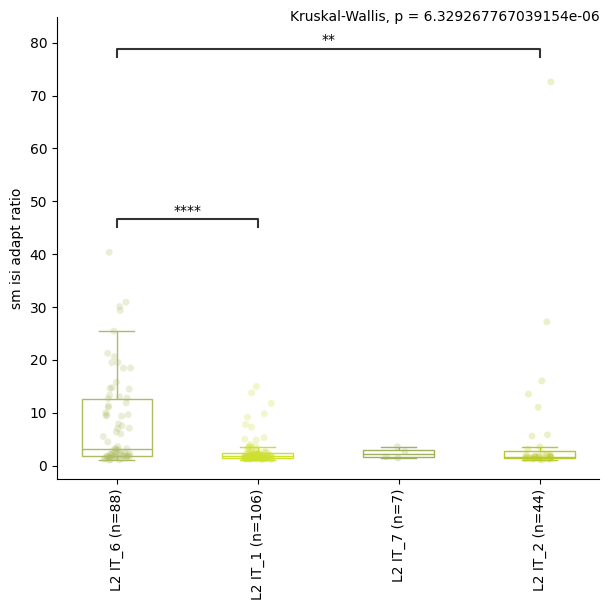

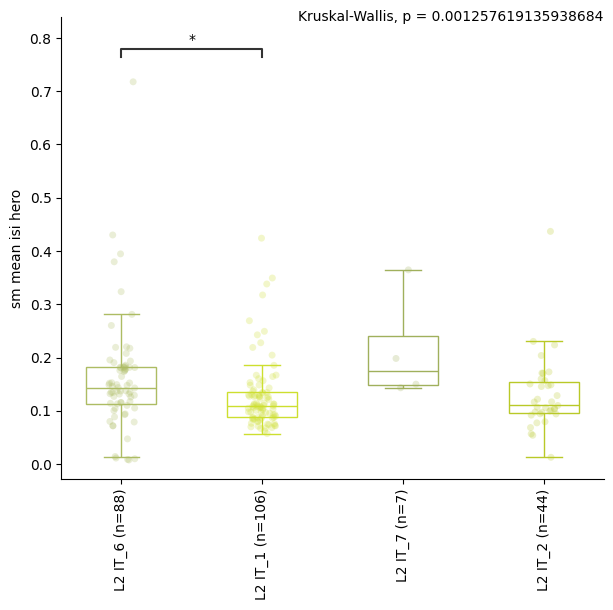

...

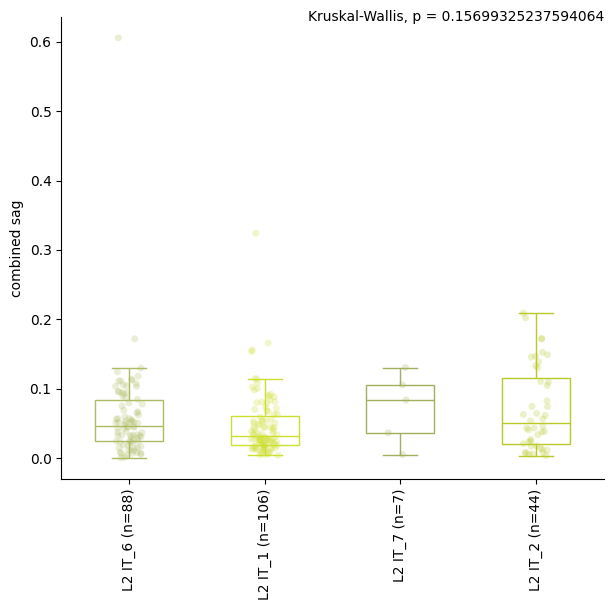

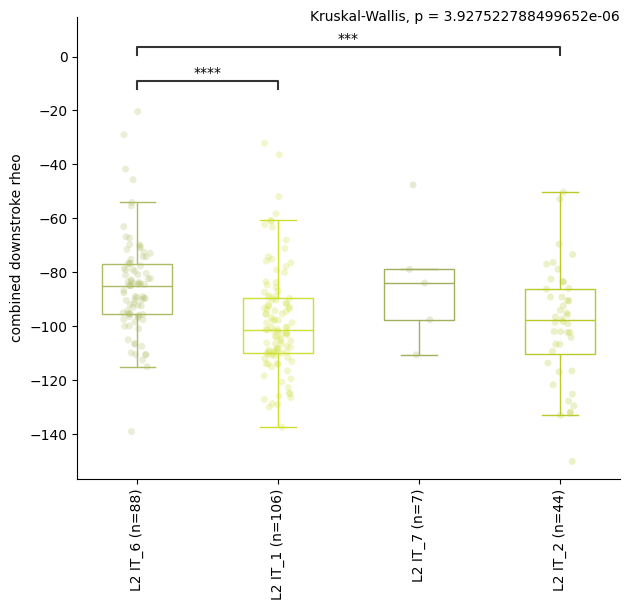

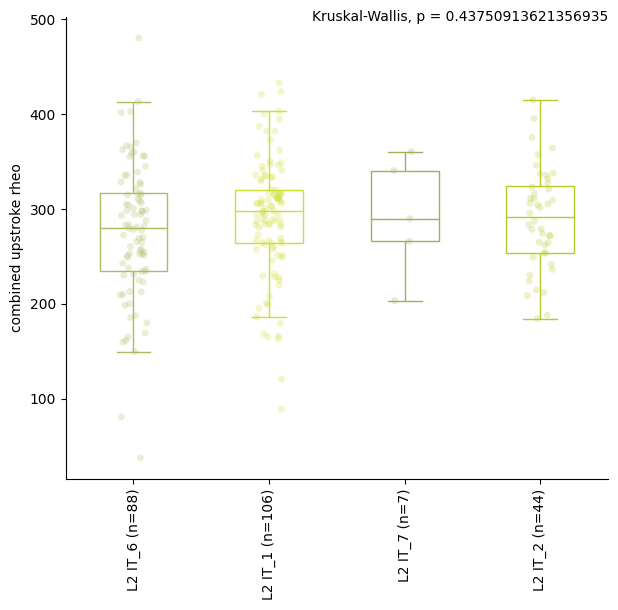

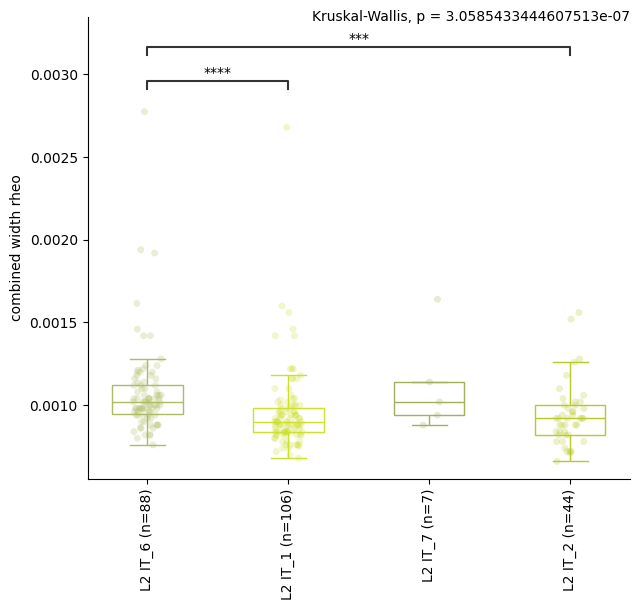

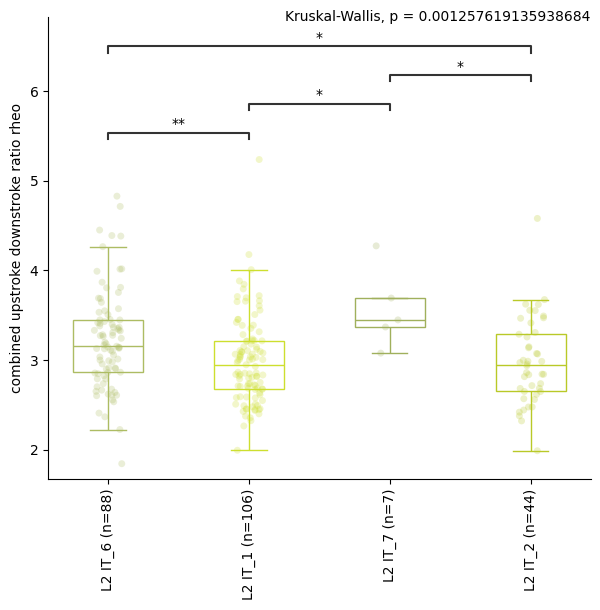

C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users

p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L3 IT_13 vs. L3 IT_5: Custom statistical test, P_val:2.203e-02
L3 IT_13 vs. L3 IT_3: Custom statistical test, P_val:3.590e-02
L3 IT_12 vs. L3 IT_5: Custom statistical test, P_val:3.590e-02
L3 IT_12 vs. L3 IT_3: Custom statistical test, P_val:4.535e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users

p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L3 IT_12 vs. L3 IT_13: Custom statistical test, P_val:6.660e-04


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L3 IT_13 vs. L3 IT_5: Custom statistical test, P_val:2.893e-04
L3 IT_13 vs. L3 IT_3: Custom statistical test, P_val:6.736e-03
L3 IT_10 vs. L3 IT_5: Custom statistical test, P_val:3.669e-02
L3 IT_10 vs. L3 IT_3: Custom statistical test, P_val:3.910e-02
L3 IT_12 vs. L3 IT_5: Custom statistical test, P_val:3.669e-02
L3 IT_12 vs. L3 IT_3: Custom statistical test, P_val:3.669e-02
L3 IT_8 vs. L3 IT_5: Custom statistical test, P_val:3.669e-02
L3 IT_8 vs. L3 IT_3: Custom statistical test, P_val:3.669e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L3 IT_13 vs. L3 IT_5: Custom statistical test, P_val:2.465e-03
L3 IT_13 vs. L3 IT_3: Custom statistical test, P_val:5.394e-03
L3 IT_12 vs. L3 IT_5: Custom statistical test, P_val:2.173e-02
L3 IT_12 vs. L3 IT_3: Custom statistical test, P_val:2.014e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L3 IT_10 vs. L3 IT_13: Custom statistical test, P_val:1.591e-02
L3 IT_12 vs. L3 IT_13: Custom statistical test, P_val:1.030e-02
L3 IT_13 vs. L3 IT_3: Custom statistical test, P_val:1.591e-02
L3 IT_12 vs. L3 IT_5: Custom statistical test, P_val:2.271e-02
L3 IT_8 vs. L3 IT_13: Custom statistical test, P_val:1.030e-02
L3 IT_8 vs. L3 IT_5: Custom statistical test, P_val:1.591e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:33: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(nrows=1,ncols=1,figsize=(7,6),sharex=True, gridspec_kw = {'wspace':0, 'hspace':0.1}) #gridspec_kw = {'wspace':0, 'hspace':0},
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L3 IT_13 vs. L3 IT_5: Custom statistical test, P_val:3.031e-03
L3 IT_13 vs. L3 IT_3: Custom statistical test, P_val:7.915e-03


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L3 IT_13 vs. L3 IT_5: Custom statistical test, P_val:1.237e-02
L3 IT_12 vs. L3 IT_13: Custom statistical test, P_val:2.094e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L3 IT_12 vs. L3 IT_10: Custom statistical test, P_val:1.398e-02
L3 IT_13 vs. L3 IT_5: Custom statistical test, P_val:3.618e-06
L3 IT_8 vs. L3 IT_12: Custom statistical test, P_val:1.456e-02
L3 IT_12 vs. L3 IT_13: Custom statistical test, P_val:2.965e-04
L3 IT_13 vs. L3 IT_3: Custom statistical test, P_val:1.781e-03
L3 IT_10 vs. L3 IT_5: Custom statistical test, P_val:2.553e-03
L3 IT_10 vs. L3 IT_3: Custom statistical test, P_val:1.456e-02
L3 IT_8 vs. L3 IT_5: Custom statistical test, P_val:1.291e-02
L3 IT_8 vs. L3 IT_3: Custom statistical test, P_val:1.332e-02


<Figure size 640x480 with 0 Axes>

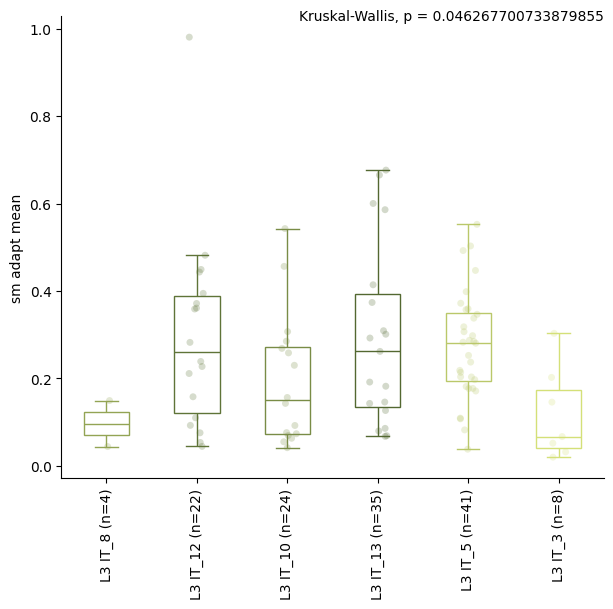

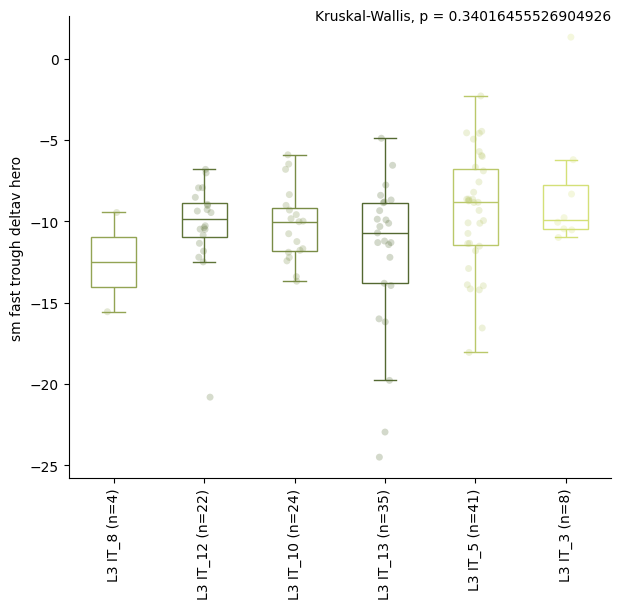

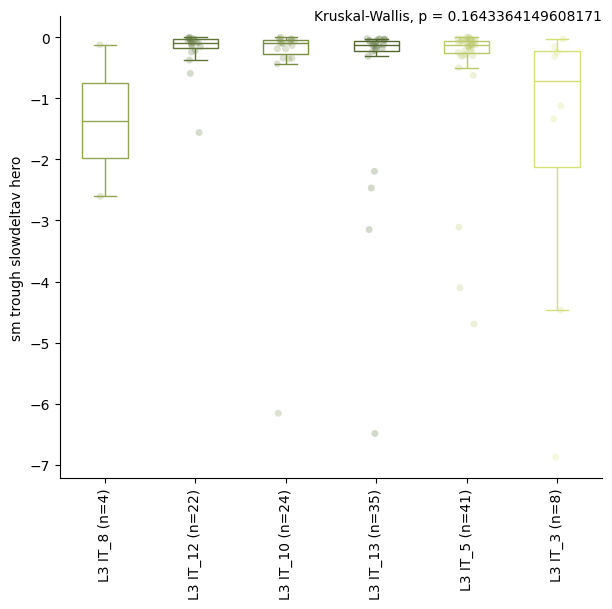

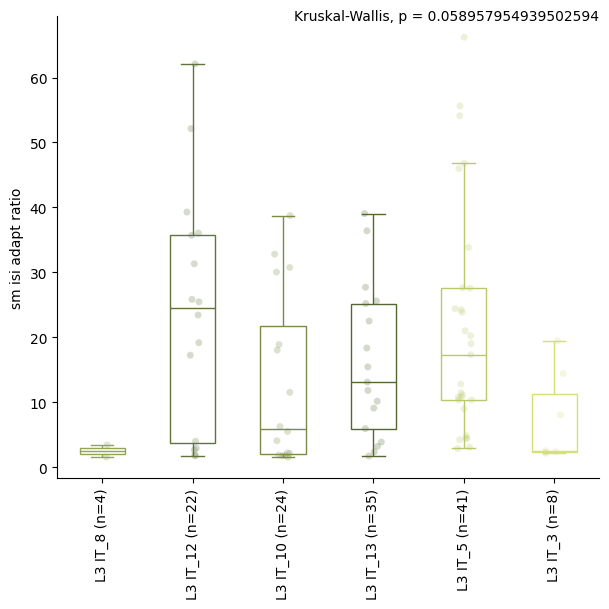

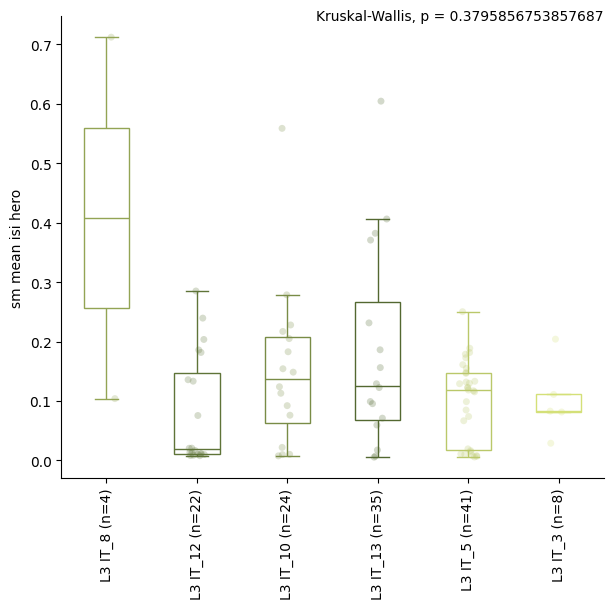

...

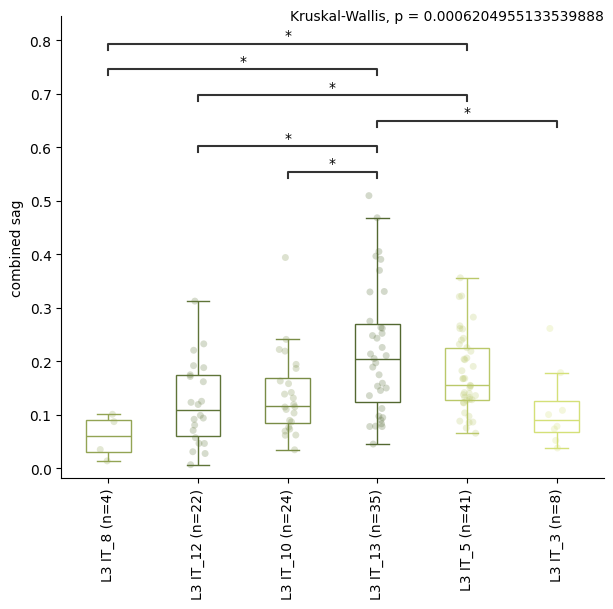

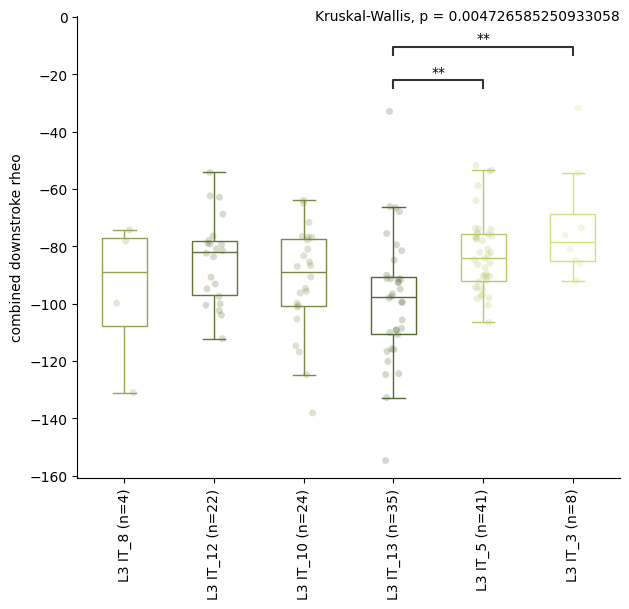

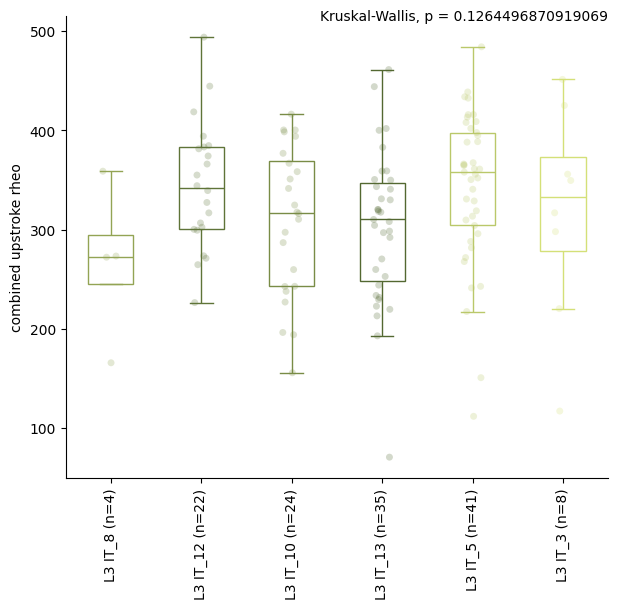

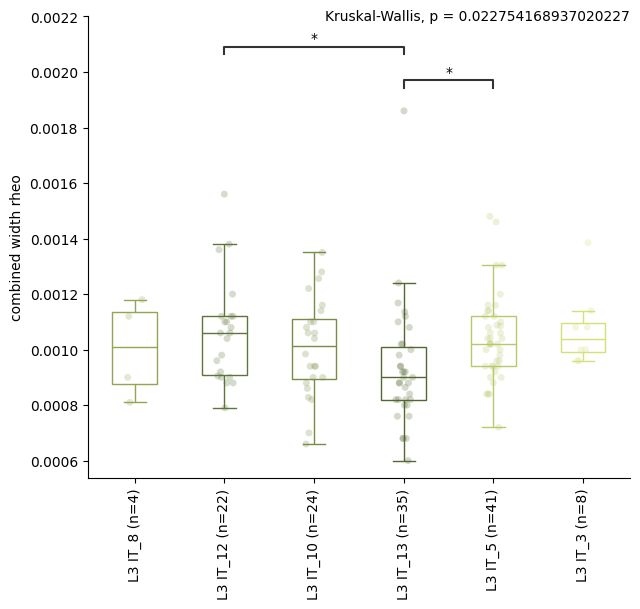

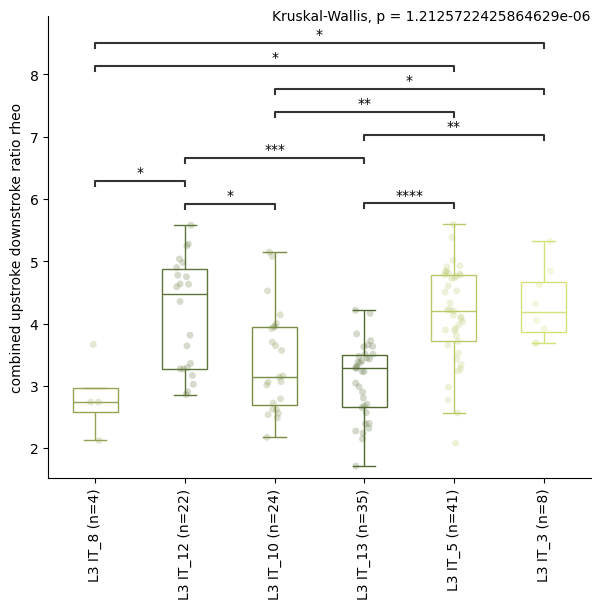

C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L4 IT_2 vs. L4 IT_1: Custom statistical test, P_val:1.863e-02
L4 IT_4 vs. L4 IT_2: Custom statistical test, P_val:7.354e-07
L4 IT_3 vs. L4 IT_2: Custom statistical test, P_val:8.515e-03
L4 IT_4 vs. L4 IT_1: Custom statistical test, P_val:1.180e-08
L4 IT_3 vs. L4 IT_1: Custom statistical test, P_val:1.596e-04


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L4 IT_2 vs. L4 IT_1: Custom statistical test, P_val:2.186e-04
L4 IT_4 vs. L4 IT_2: Custom statistical test, P_val:2.432e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L4 IT_2 vs. L4 IT_1: Custom statistical test, P_val:6.046e-05
L4 IT_4 vs. L4 IT_2: Custom statistical test, P_val:2.196e-17
L4 IT_3 vs. L4 IT_4: Custom statistical test, P_val:8.382e-03
L4 IT_4 vs. L4 IT_1: Custom statistical test, P_val:1.137e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L4 IT_2 vs. L4 IT_1: Custom statistical test, P_val:1.562e-06
L4 IT_4 vs. L4 IT_2: Custom statistical test, P_val:2.336e-02
L4 IT_4 vs. L4 IT_1: Custom statistical test, P_val:1.045e-02
L4 IT_3 vs. L4 IT_1: Custom statistical test, P_val:4.931e-03


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L4 IT_4 vs. L4 IT_2: Custom statistical test, P_val:5.760e-05
L4 IT_4 vs. L4 IT_1: Custom statistical test, P_val:1.349e-05
L4 IT_3 vs. L4 IT_1: Custom statistical test, P_val:1.220e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L4 IT_4 vs. L4 IT_2: Custom statistical test, P_val:1.429e-07
L4 IT_3 vs. L4 IT_2: Custom statistical test, P_val:1.622e-02
L4 IT_4 vs. L4 IT_1: Custom statistical test, P_val:4.261e-05
L4 IT_3 vs. L4 IT_1: Custom statistical test, P_val:1.992e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L4 IT_2 vs. L4 IT_1: Custom statistical test, P_val:4.278e-02
L4 IT_4 vs. L4 IT_2: Custom statistical test, P_val:8.097e-11
L4 IT_3 vs. L4 IT_4: Custom statistical test, P_val:5.811e-05
L4 IT_4 vs. L4 IT_1: Custom statistical test, P_val:4.083e-03


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L4 IT_4 vs. L4 IT_2: Custom statistical test, P_val:3.787e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L4 IT_2 vs. L4 IT_1: Custom statistical test, P_val:6.399e-05
L4 IT_4 vs. L4 IT_1: Custom statistical test, P_val:1.994e-04
L4 IT_3 vs. L4 IT_1: Custom statistical test, P_val:1.375e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L4 IT_2 vs. L4 IT_1: Custom statistical test, P_val:2.358e-02
L4 IT_4 vs. L4 IT_2: Custom statistical test, P_val:6.354e-04
L4 IT_4 vs. L4 IT_1: Custom statistical test, P_val:5.559e-06
L4 IT_3 vs. L4 IT_1: Custom statistical test, P_val:2.351e-03


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L4 IT_2 vs. L4 IT_1: Custom statistical test, P_val:9.717e-03
L4 IT_4 vs. L4 IT_2: Custom statistical test, P_val:2.616e-09
L4 IT_3 vs. L4 IT_2: Custom statistical test, P_val:4.312e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L4 IT_2 vs. L4 IT_1: Custom statistical test, P_val:3.084e-02
L4 IT_4 vs. L4 IT_2: Custom statistical test, P_val:7.362e-19
L4 IT_3 vs. L4 IT_4: Custom statistical test, P_val:1.088e-02
L4 IT_3 vs. L4 IT_2: Custom statistical test, P_val:3.084e-02
L4 IT_4 vs. L4 IT_1: Custom statistical test, P_val:5.894e-06


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L4 IT_4 vs. L4 IT_2: Custom statistical test, P_val:8.373e-08
L4 IT_3 vs. L4 IT_4: Custom statistical test, P_val:3.681e-06
L4 IT_4 vs. L4 IT_1: Custom statistical test, P_val:7.798e-03
L4 IT_3 vs. L4 IT_1: Custom statistical test, P_val:1.522e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L4 IT_2 vs. L4 IT_1: Custom statistical test, P_val:7.028e-06
L4 IT_4 vs. L4 IT_2: Custom statistical test, P_val:9.418e-10
L4 IT_3 vs. L4 IT_2: Custom statistical test, P_val:4.371e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L4 IT_2 vs. L4 IT_1: Custom statistical test, P_val:5.041e-08
L4 IT_4 vs. L4 IT_2: Custom statistical test, P_val:1.750e-02
L4 IT_3 vs. L4 IT_4: Custom statistical test, P_val:5.076e-04
L4 IT_3 vs. L4 IT_2: Custom statistical test, P_val:1.750e-02
L4 IT_4 vs. L4 IT_1: Custom statistical test, P_val:4.690e-11


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:33: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(nrows=1,ncols=1,figsize=(7,6),sharex=True, gridspec_kw = {'wspace':0, 'hspace':0.1}) #gridspec_kw = {'wspace':0, 'hspace':0},
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L4 IT_4 vs. L4 IT_2: Custom statistical test, P_val:2.702e-21
L4 IT_3 vs. L4 IT_4: Custom statistical test, P_val:2.700e-02
L4 IT_3 vs. L4 IT_2: Custom statistical test, P_val:3.998e-03
L4 IT_4 vs. L4 IT_1: Custom statistical test, P_val:1.461e-09
L4 IT_3 vs. L4 IT_1: Custom statistical test, P_val:4.544e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L4 IT_2 vs. L4 IT_1: Custom statistical test, P_val:2.658e-03
L4 IT_4 vs. L4 IT_2: Custom statistical test, P_val:3.232e-27
L4 IT_3 vs. L4 IT_4: Custom statistical test, P_val:2.658e-03
L4 IT_3 vs. L4 IT_2: Custom statistical test, P_val:2.658e-03
L4 IT_4 vs. L4 IT_1: Custom statistical test, P_val:1.931e-07


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L4 IT_2 vs. L4 IT_1: Custom statistical test, P_val:7.776e-03
L4 IT_4 vs. L4 IT_2: Custom statistical test, P_val:2.661e-25
L4 IT_3 vs. L4 IT_2: Custom statistical test, P_val:1.281e-04
L4 IT_4 vs. L4 IT_1: Custom statistical test, P_val:2.403e-07


<Figure size 640x480 with 0 Axes>

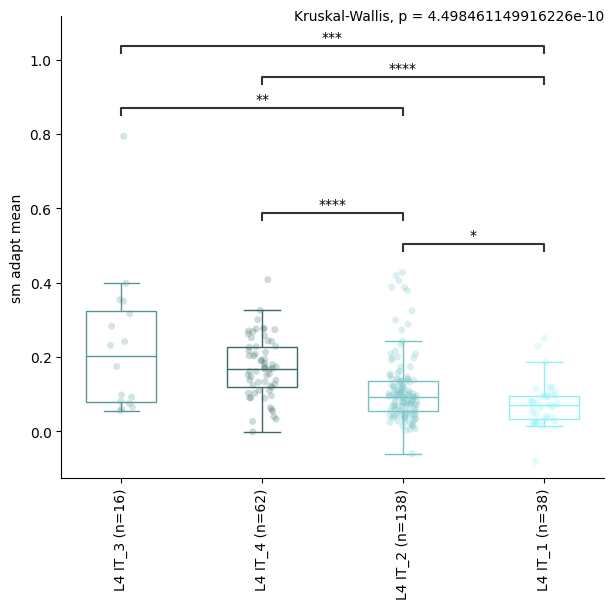

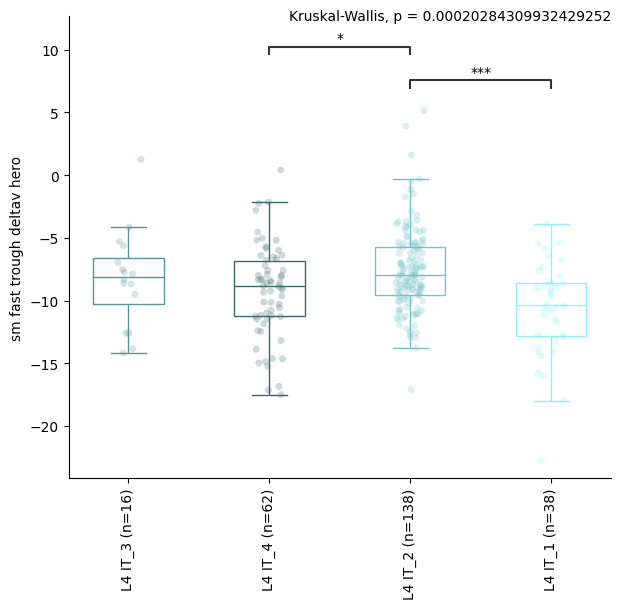

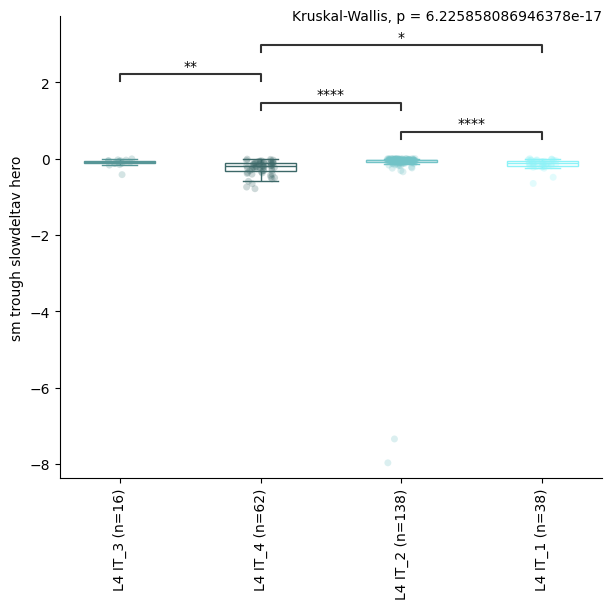

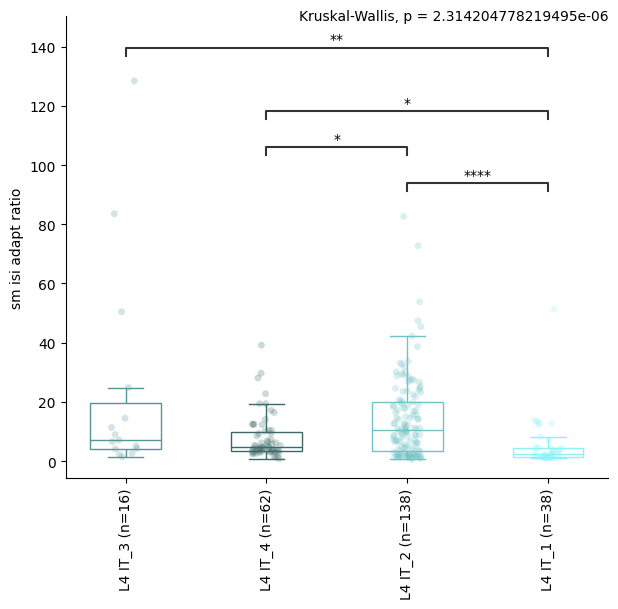

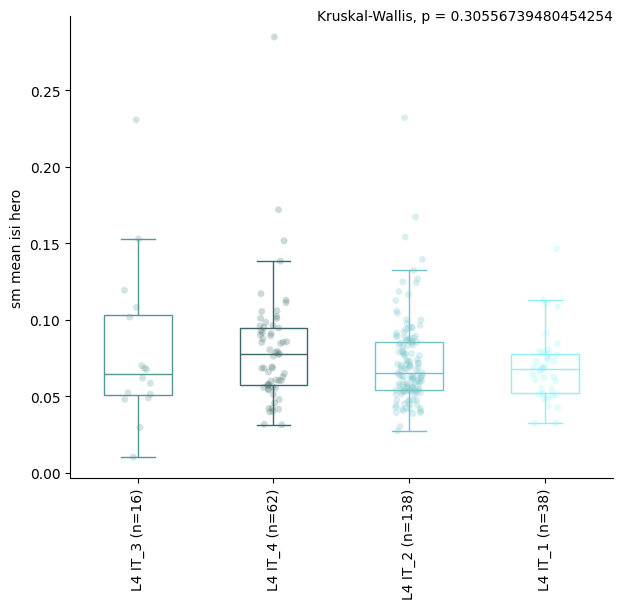

...

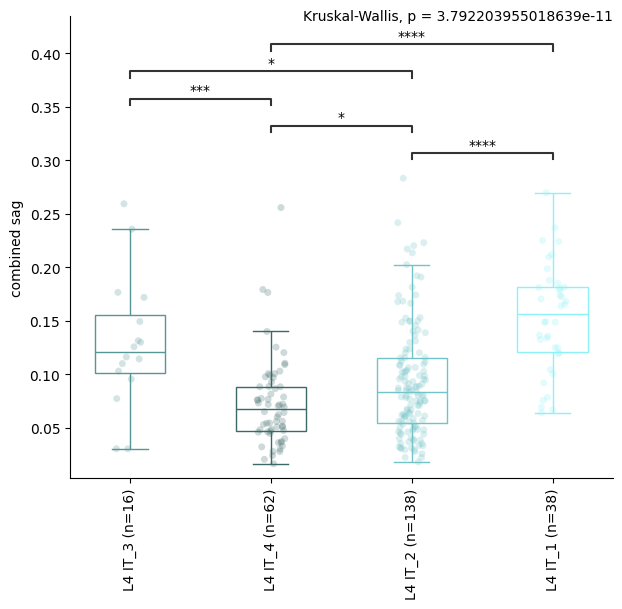

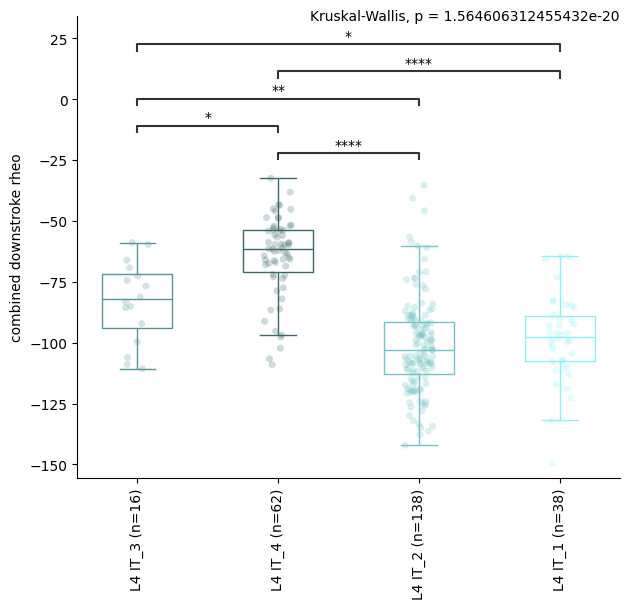

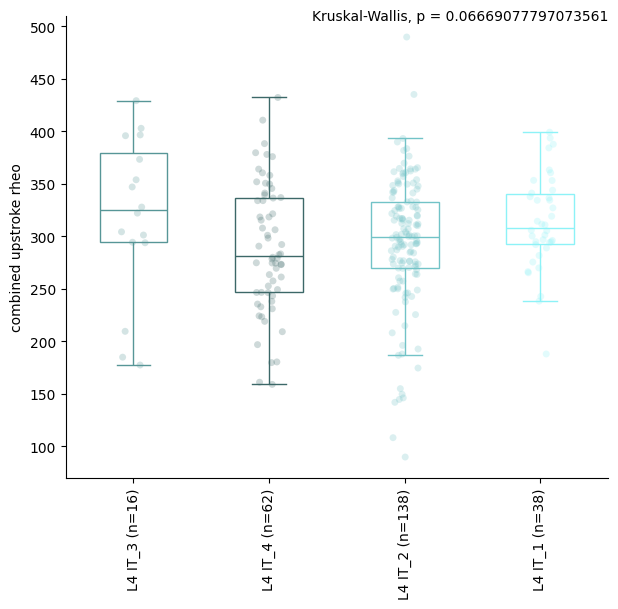

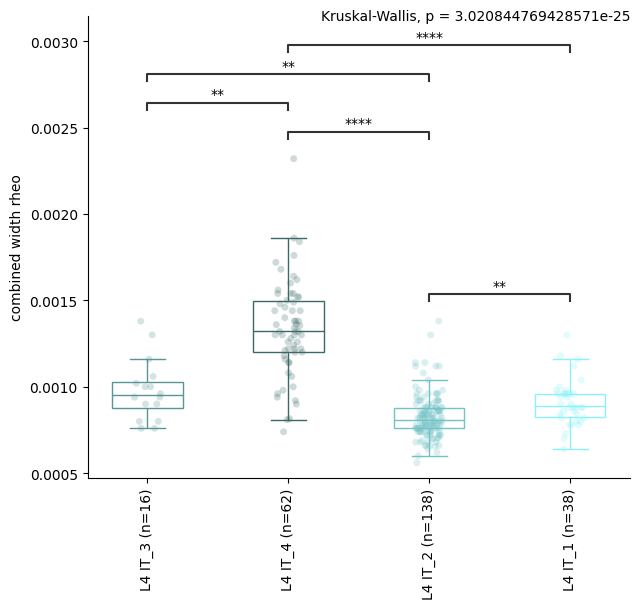

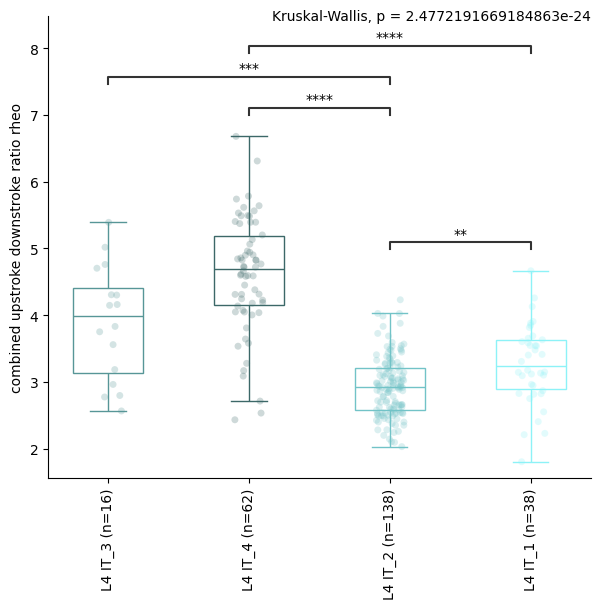

C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users

p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L5 IT_5 vs. L5 IT_2: Custom statistical test, P_val:4.495e-03
L5 IT_6 vs. L5 IT_5: Custom statistical test, P_val:2.418e-02
L5 IT_1 vs. L5 IT_7: Custom statistical test, P_val:1.264e-02
L5 IT_3 vs. L5/6 NP_2: Custom statistical test, P_val:9.208e-03
L5/6 NP_4 vs. L5 ET_1: Custom statistical test, P_val:9.208e-03
L5 IT_6 vs. L5 IT_2: Custom statistical test, P_val:2.297e-09
L5 IT_2 vs. L5 IT_7: Custom statistical test, P_val:2.392e-04
L5/6 NP_1 vs. L5 ET_1: Custom statistical test, P_val:8.771e-03
L5 IT_7 vs. L5/6 NP_2: Custom statistical test, P_val:6.207e-04
L5/6 NP_4 vs. L5 ET_2: Custom statistical test, P_val:1.719e-02
L5 IT_2 vs. L5 IT_3: Custom statistical test, P_val:1.719e-02
L5 IT_6 vs. L5 IT_1: Custom statistical test, P_val:6.207e-04
L5/6 NP_1 vs. L5 ET_2: Custom statistical test, P_val:

C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L5 ET_1 vs. L5 ET_2: Custom statistical test, P_val:1.735e-02
L5 IT_5 vs. L5 IT_7: Custom statistical test, P_val:4.179e-02
L5 IT_6 vs. L5 IT_7: Custom statistical test, P_val:4.179e-02
L5 IT_7 vs. L5 ET_1: Custom statistical test, P_val:8.295e-03


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users

p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L5/6 NP_4 vs. L5 ET_2: Custom statistical test, P_val:3.580e-02
L5/6 NP_1 vs. L5 ET_2: Custom statistical test, P_val:1.467e-06
L5 IT_3 vs. L5/6 NP_1: Custom statistical test, P_val:2.261e-03
L5 IT_5 vs. L5 IT_3: Custom statistical test, P_val:3.886e-02
L5 IT_6 vs. L5 IT_3: Custom statistical test, P_val:2.775e-02
L5/6 NP_2 vs. L5 ET_2: Custom statistical test, P_val:6.323e-03
L5 IT_2 vs. L5/6 NP_1: Custom statistical test, P_val:4.605e-03
L5 IT_7 vs. L5 ET_2: Custom statistical test, P_val:2.261e-03
L5 IT_1 vs. L5 ET_2: Custom statistical test, P_val:1.165e-02
L5 IT_2 vs. L5 ET_2: Custom statistical test, P_val:2.261e-03
L5 IT_5 vs. L5 ET_2: Custom statistical test, P_val:6.718e-05
L5 IT_6 vs. L5 ET_2: Custom statistical test, P_val:3.566e-05


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L5 IT_6 vs. L5 IT_5: Custom statistical test, P_val:3.551e-03
L5 IT_1 vs. L5 IT_7: Custom statistical test, P_val:2.129e-03
L5/6 NP_4 vs. L5 ET_1: Custom statistical test, P_val:9.334e-03
L5 IT_1 vs. L5 IT_3: Custom statistical test, P_val:2.081e-03
L5 IT_5 vs. L5 IT_1: Custom statistical test, P_val:2.393e-02
L5 IT_6 vs. L5 IT_2: Custom statistical test, P_val:6.398e-08
L5 IT_2 vs. L5 IT_7: Custom statistical test, P_val:4.715e-03
L5/6 NP_1 vs. L5 ET_1: Custom statistical test, P_val:1.749e-02
L5/6 NP_4 vs. L5 ET_2: Custom statistical test, P_val:2.081e-03
L5 IT_2 vs. L5 IT_3: Custom statistical test, P_val:5.939e-03
L5 IT_6 vs. L5 IT_1: Custom statistical test, P_val:6.317e-06
L5/6 NP_1 vs. L5 ET_2: Custom statistical test, P_val:2.101e-03
L5 IT_1 vs. L5/6 NP_2: Custom statistical test, P_val:1.

C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L5 IT_2 vs. L5 IT_7: Custom statistical test, P_val:4.726e-02
L5/6 NP_2 vs. L5/6 NP_1: Custom statistical test, P_val:4.726e-02
L5 IT_1 vs. L5/6 NP_2: Custom statistical test, P_val:1.312e-02
L5/6 NP_2 vs. L5/6 NP_4: Custom statistical test, P_val:4.726e-02
L5 IT_2 vs. L5/6 NP_2: Custom statistical test, P_val:8.252e-03
L5 IT_5 vs. L5/6 NP_2: Custom statistical test, P_val:1.379e-02
L5 IT_6 vs. L5/6 NP_2: Custom statistical test, P_val:1.312e-02
L5 IT_1 vs. L5 ET_2: Custom statistical test, P_val:1.379e-02
L5 IT_2 vs. L5 ET_2: Custom statistical test, P_val:1.379e-02
L5 IT_5 vs. L5 ET_2: Custom statistical test, P_val:3.716e-02
L5 IT_6 vs. L5 ET_2: Custom statistical test, P_val:2.668e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L5 IT_1 vs. L5/6 NP_2: Custom statistical test, P_val:9.663e-04
L5 IT_7 vs. L5/6 NP_1: Custom statistical test, P_val:6.912e-03
L5 IT_2 vs. L5/6 NP_2: Custom statistical test, P_val:9.928e-03
L5 IT_1 vs. L5/6 NP_1: Custom statistical test, P_val:1.860e-05
L5 IT_5 vs. L5/6 NP_2: Custom statistical test, P_val:2.703e-03
L5 IT_2 vs. L5/6 NP_1: Custom statistical test, P_val:5.809e-05
L5 IT_1 vs. L5/6 NP_4: Custom statistical test, P_val:9.663e-04
L5 IT_1 vs. L5 ET_1: Custom statistical test, P_val:6.912e-03
L5 IT_7 vs. L5 ET_2: Custom statistical test, P_val:1.400e-02
L5 IT_5 vs. L5/6 NP_1: Custom statistical test, P_val:1.860e-05
L5 IT_2 vs. L5/6 NP_4: Custom statistical test, P_val:8.954e-03
L5 IT_1 vs. L5 ET_2: Custom statistical test, P_val:1.325e-04
L5 IT_6 vs. L5/6 NP_1: Custom statistical test

C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:33: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(nrows=1,ncols=1,figsize=(7,6),sharex=True, gridspec_kw = {'wspace':0, 'hspace':0.1}) #gridspec_kw = {'wspace':0, 'hspace':0},
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L5 IT_5 vs. L5 IT_2: Custom statistical test, P_val:5.176e-04
L5 IT_6 vs. L5 IT_2: Custom statistical test, P_val:1.133e-08
L5 IT_6 vs. L5 IT_1: Custom statistical test, P_val:7.354e-03
L5/6 NP_1 vs. L5 ET_2: Custom statistical test, P_val:7.893e-03
L5 IT_6 vs. L5 IT_7: Custom statistical test, P_val:7.354e-03
L5 IT_2 vs. L5/6 NP_2: Custom statistical test, P_val:1.240e-02
L5 IT_6 vs. L5 IT_3: Custom statistical test, P_val:3.693e-02
L5/6 NP_2 vs. L5 ET_2: Custom statistical test, P_val:7.893e-03
L5 IT_2 vs. L5/6 NP_1: Custom statistical test, P_val:7.893e-03
L5 IT_5 vs. L5 ET_2: Custom statistical test, P_val:3.700e-03
L5 IT_6 vs. L5 ET_2: Custom statistical test, P_val:5.330e-05


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L5 IT_5 vs. L5/6 NP_1: Custom statistical test, P_val:4.233e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L5 IT_5 vs. L5 IT_2: Custom statistical test, P_val:4.755e-05
L5/6 NP_4 vs. L5 ET_1: Custom statistical test, P_val:1.534e-02
L5 IT_5 vs. L5 IT_1: Custom statistical test, P_val:7.709e-03
L5 IT_6 vs. L5 IT_2: Custom statistical test, P_val:4.128e-09
L5/6 NP_1 vs. L5 ET_1: Custom statistical test, P_val:4.289e-03
L5/6 NP_4 vs. L5 ET_2: Custom statistical test, P_val:2.751e-02
L5 IT_6 vs. L5 IT_1: Custom statistical test, P_val:2.625e-04
L5/6 NP_1 vs. L5 ET_2: Custom statistical test, P_val:5.151e-03
L5/6 NP_6 vs. L5 ET_1: Custom statistical test, P_val:2.751e-02
L5 IT_6 vs. L5 IT_7: Custom statistical test, P_val:1.033e-02
L5/6 NP_2 vs. L5 ET_1: Custom statistical test, P_val:5.182e-03
L5 IT_2 vs. L5/6 NP_2: Custom statistical test, P_val:2.337e-02
L5 IT_6 vs. L5 IT_3: Custom statistical test, P_va

C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L5 IT_5 vs. L5 IT_2: Custom statistical test, P_val:3.842e-02
L5 IT_6 vs. L5 IT_2: Custom statistical test, P_val:1.909e-06
L5 IT_6 vs. L5 IT_1: Custom statistical test, P_val:8.093e-03
L5/6 NP_1 vs. L5 ET_2: Custom statistical test, P_val:7.282e-03
L5 IT_1 vs. L5/6 NP_2: Custom statistical test, P_val:4.846e-02
L5 IT_6 vs. L5 IT_7: Custom statistical test, P_val:4.846e-02
L5 IT_7 vs. L5/6 NP_1: Custom statistical test, P_val:3.842e-02
L5 IT_2 vs. L5/6 NP_2: Custom statistical test, P_val:6.973e-03
L5 IT_1 vs. L5/6 NP_1: Custom statistical test, P_val:6.973e-03
L5/6 NP_2 vs. L5 ET_2: Custom statistical test, P_val:4.846e-02
L5 IT_2 vs. L5/6 NP_6: Custom statistical test, P_val:4.846e-02
L5 IT_2 vs. L5/6 NP_1: Custom statistical test, P_val:7.557e-06
L5 IT_2 vs. L5/6 NP_4: Custom statistical test, 

<Figure size 640x480 with 0 Axes>

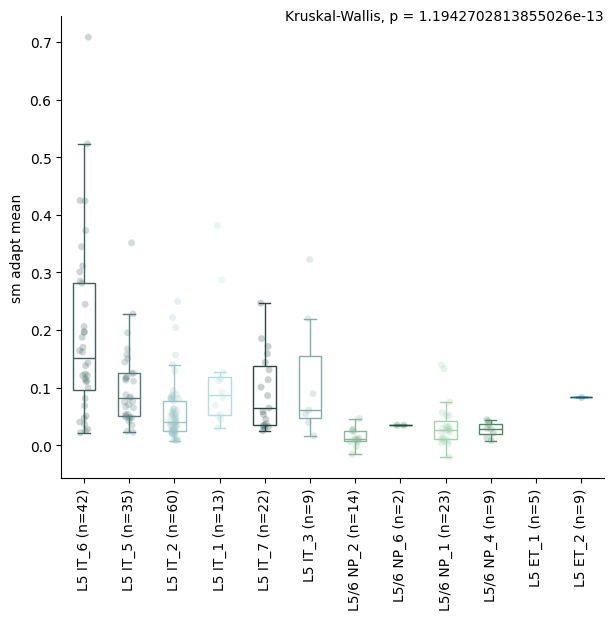

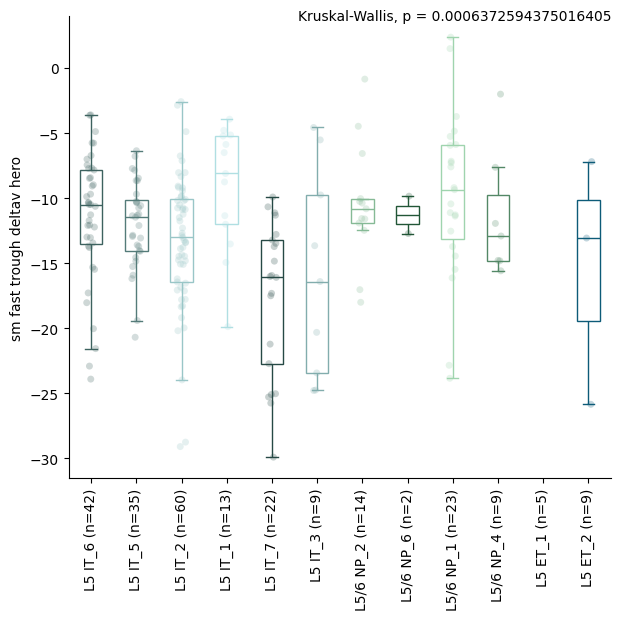

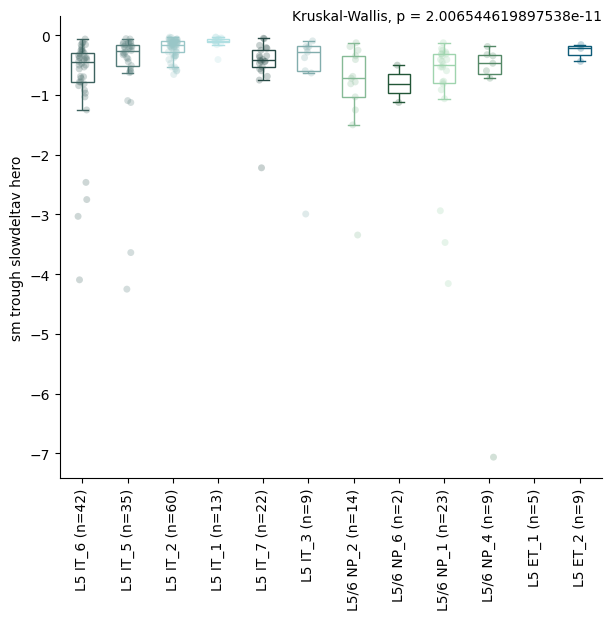

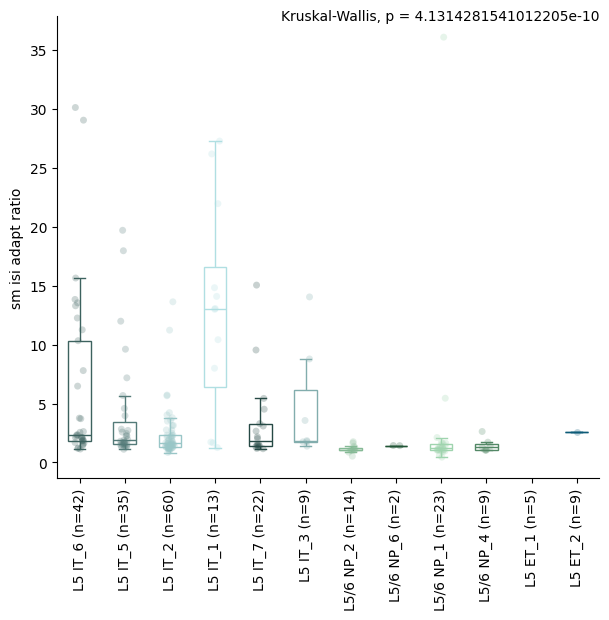

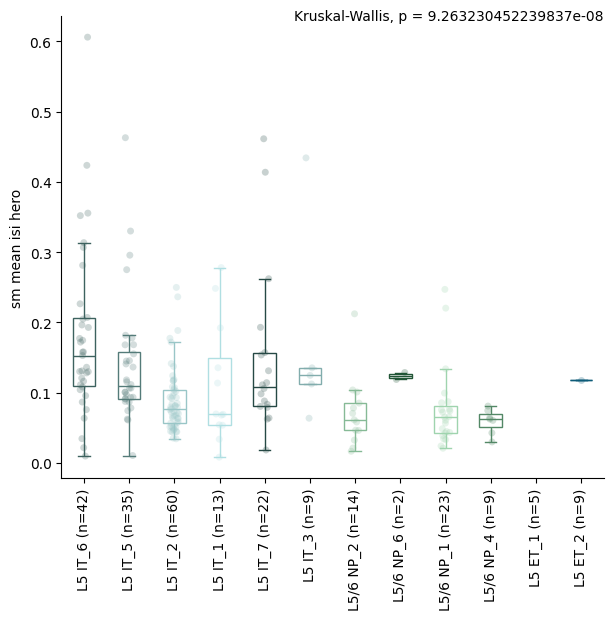

...

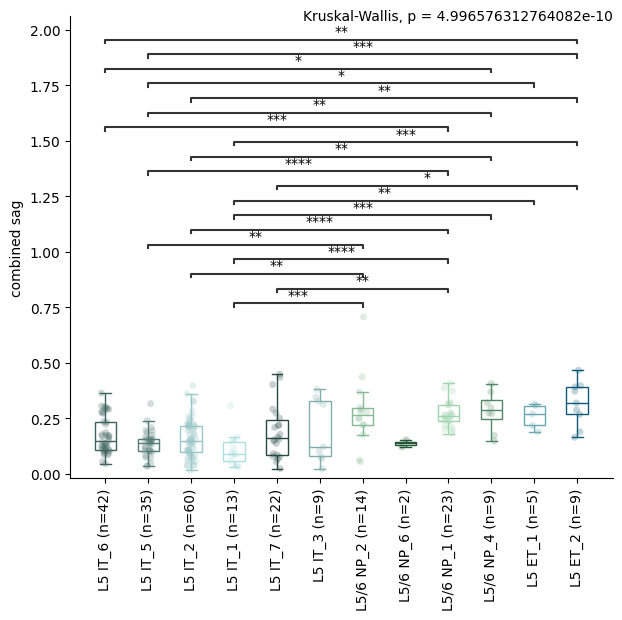

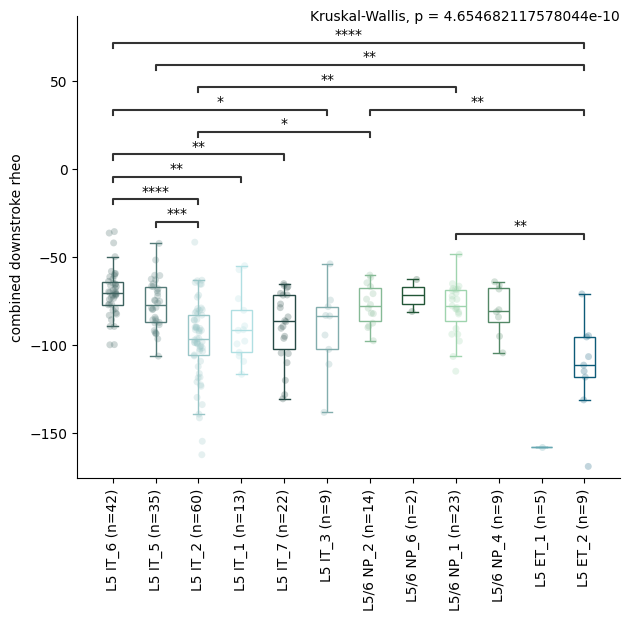

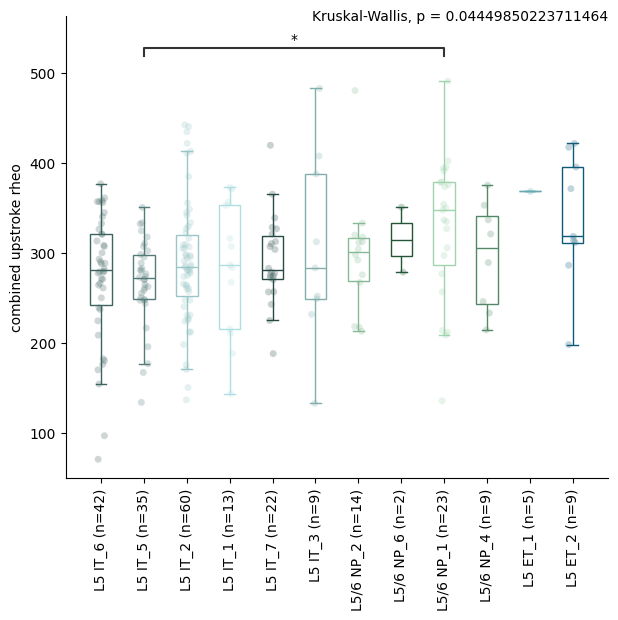

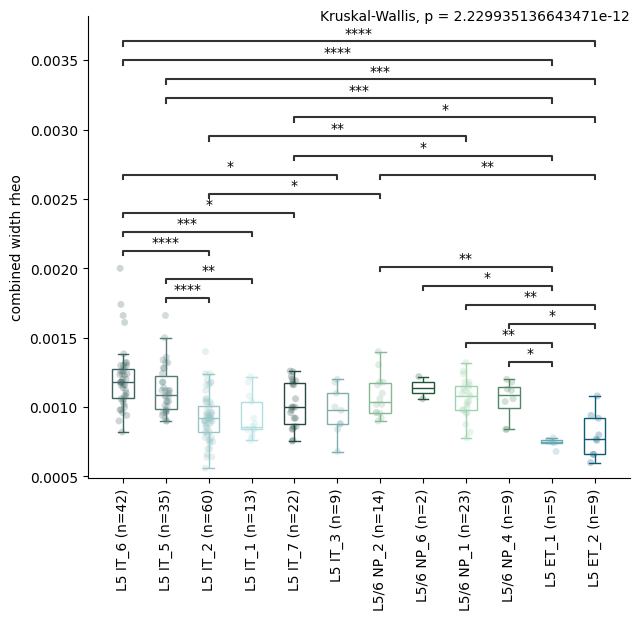

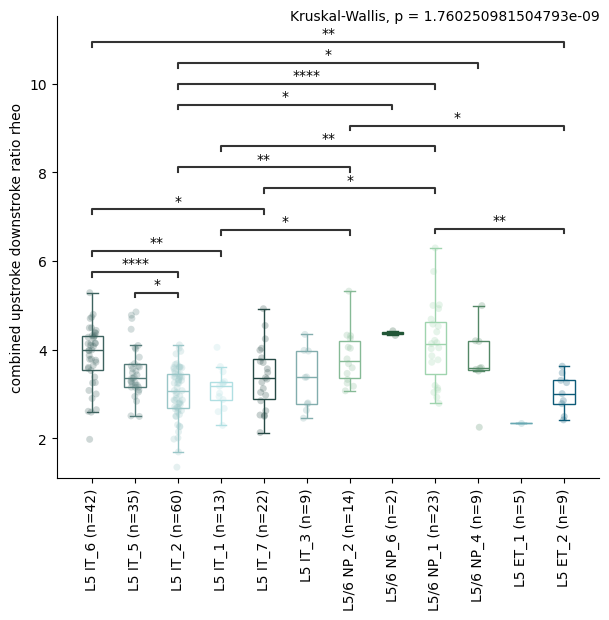

C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L6 IT_1 vs. L6 CT_3: Custom statistical test, P_val:1.839e-02
L6 IT_2 vs. L6 CT_3: Custom statistical test, P_val:1.839e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users

p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L6 IT_2 vs. L6 CT_1: Custom statistical test, P_val:2.652e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users

p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L6 IT Car3_2 vs. L6 IT_1: Custom statistical test, P_val:1.972e-02
L6 IT Car3_3 vs. L6 IT_2: Custom statistical test, P_val:2.504e-02
L6 IT Car3_2 vs. L6 CT_3: Custom statistical test, P_val:1.972e-02
L6 IT Car3_3 vs. L6 IT_1: Custom statistical test, P_val:3.531e-03
L6 IT Car3_2 vs. L6 CT_2: Custom statistical test, P_val:2.504e-02
L6 IT Car3_3 vs. L6 CT_3: Custom statistical test, P_val:1.066e-02
L6 IT Car3_1 vs. L6 CT_3: Custom statistical test, P_val:4.944e-02
L6 IT Car3_2 vs. L6 CT_4: Custom statistical test, P_val:3.005e-02
L6 IT Car3_3 vs. L6 CT_2: Custom statistical test, P_val:1.972e-02
L6 IT Car3_2 vs. L6 CT_1: Custom statistical test, P_val:1.972e-02
L6 IT Car3_3 vs. L6 CT_4: Custom statistical test, P_val:4.079e-02
L6 IT Car3_3 vs. L6 CT_1: Custom statistical test, P_val:3.531e-03
L6 I

C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L6 IT Car3_2 vs. L6 IT_2: Custom statistical test, P_val:3.996e-02
L6 IT Car3_3 vs. L6 IT_2: Custom statistical test, P_val:3.056e-03
L6 IT Car3_1 vs. L6 IT_2: Custom statistical test, P_val:4.944e-02
L6 IT Car3_3 vs. L6 CT_3: Custom statistical test, P_val:3.508e-02
L6 IT Car3_2 vs. L6b_6: Custom statistical test, P_val:3.709e-02
L6 IT Car3_3 vs. L6b_6: Custom statistical test, P_val:3.710e-03
L6 IT Car3_1 vs. L6b_6: Custom statistical test, P_val:3.996e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L6 CT_1 vs. L6b_6: Custom statistical test, P_val:2.333e-02
L6b_6 vs. L6b_3: Custom statistical test, P_val:3.413e-02
L6 IT Car3_1 vs. L6 IT_2: Custom statistical test, P_val:3.413e-02
L6 IT Car3_3 vs. L6b_6: Custom statistical test, P_val:3.413e-02
L6 IT Car3_1 vs. L6b_6: Custom statistical test, P_val:3.317e-03


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L6 IT Car3_2 vs. L6 IT_2: Custom statistical test, P_val:1.997e-02
L6 IT Car3_2 vs. L6 CT_3: Custom statistical test, P_val:4.680e-02
L6 IT Car3_1 vs. L6 IT_2: Custom statistical test, P_val:1.997e-02
L6 IT Car3_2 vs. L6 CT_2: Custom statistical test, P_val:4.680e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:33: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(nrows=1,ncols=1,figsize=(7,6),sharex=True, gridspec_kw = {'wspace':0, 'hspace':0.1}) #gridspec_kw = {'wspace':0, 'hspace':0},
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\4170761183.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L6 IT_2 vs. L6b_6: Custom statistical test, P_val:1.108e-03
L6 IT_2 vs. L6b_3: Custom statistical test, P_val:4.469e-02
L6 IT Car3_3 vs. L6b_6: Custom statistical test, P_val:3.997e-02


<Figure size 640x480 with 0 Axes>

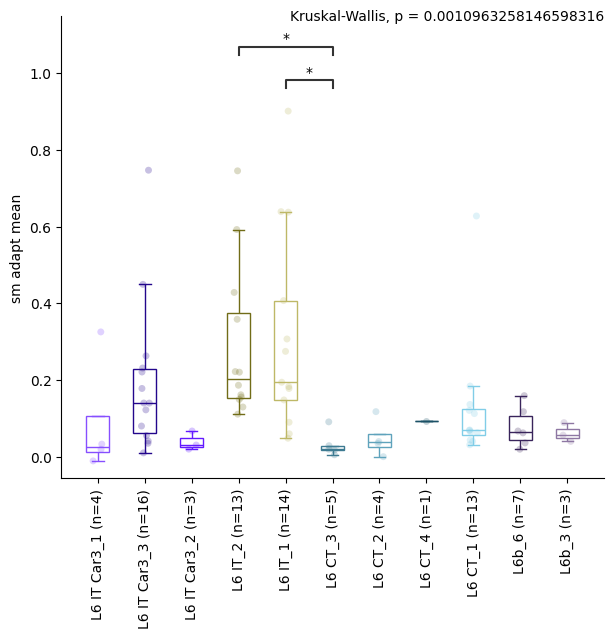

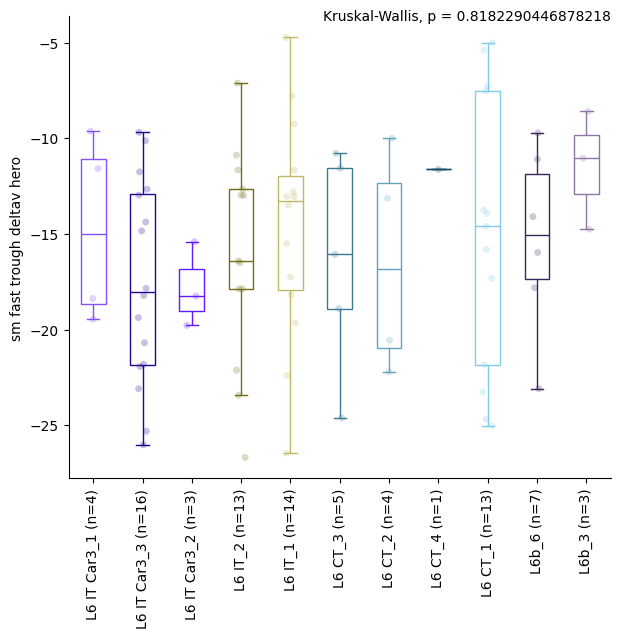

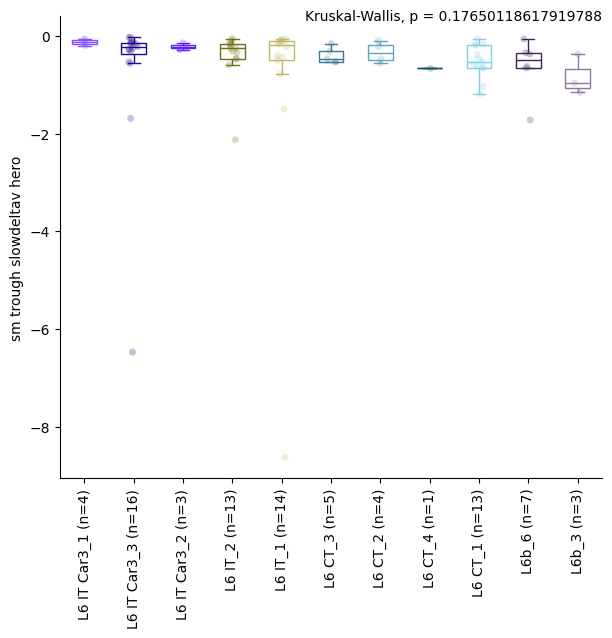

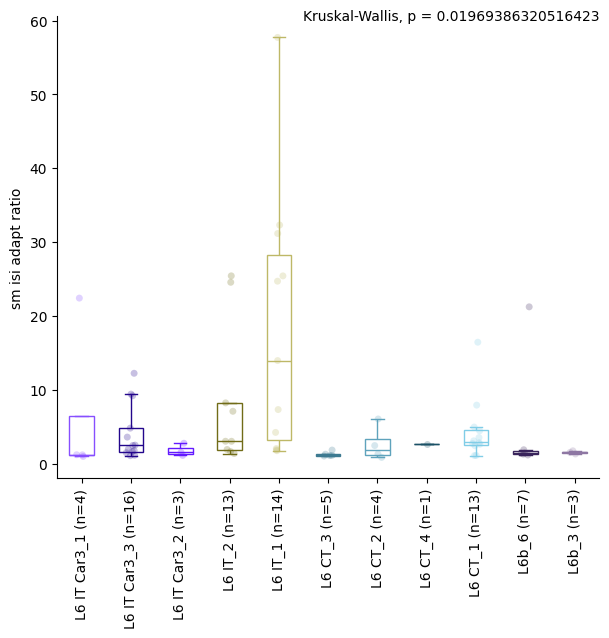

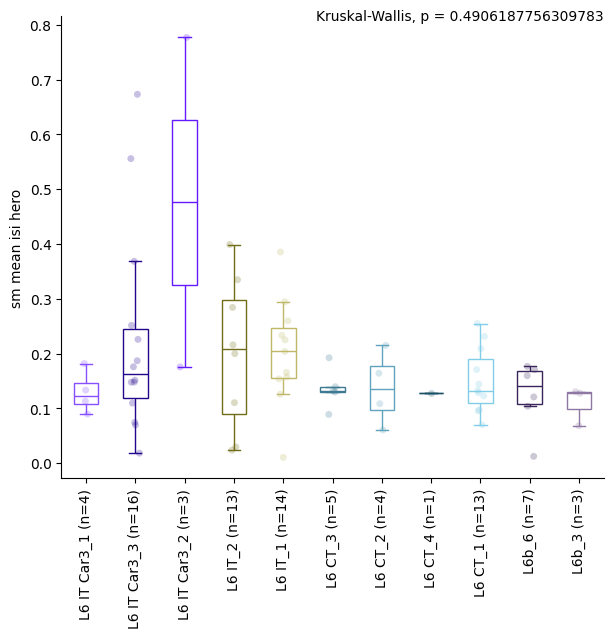

...

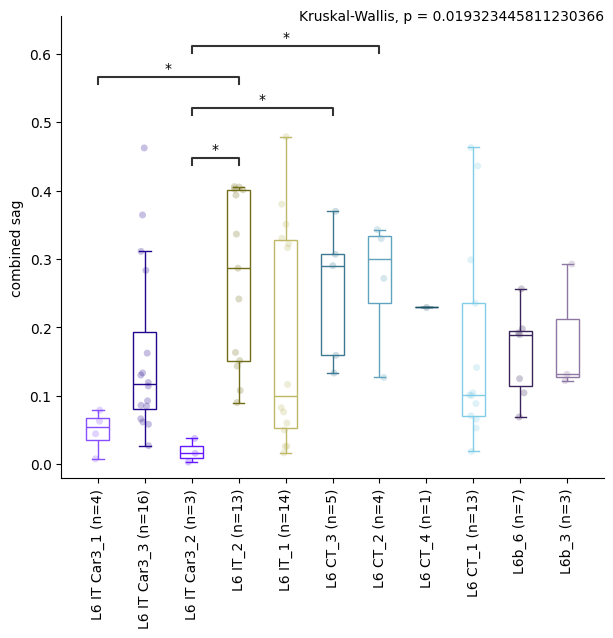

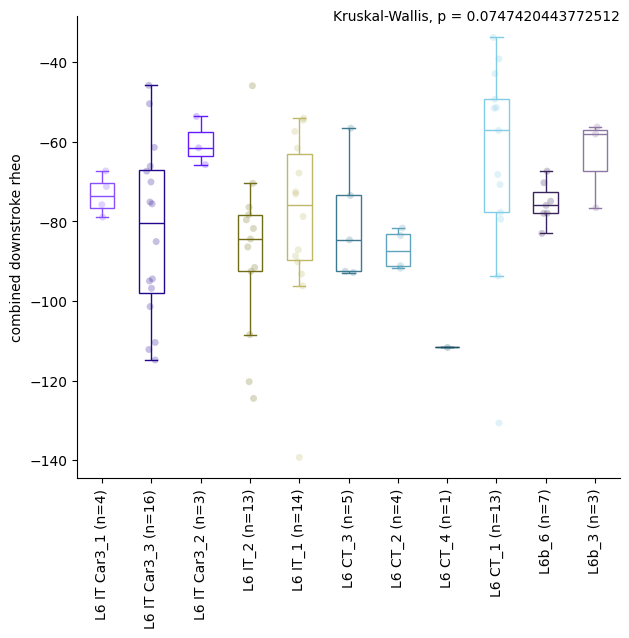

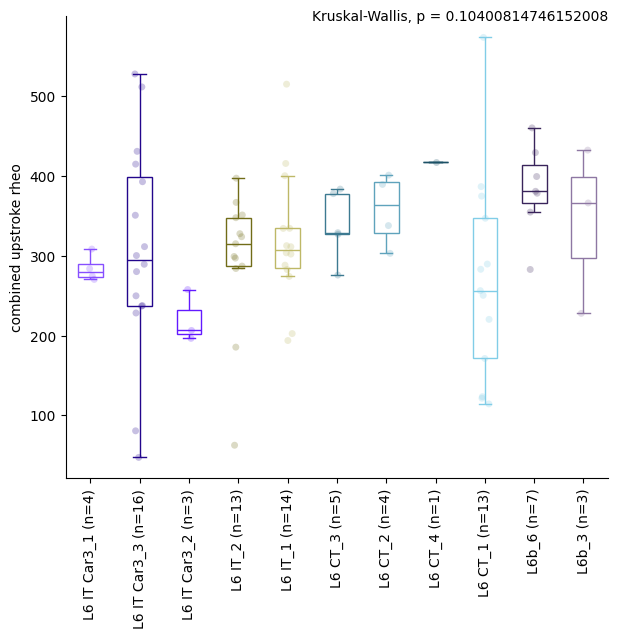

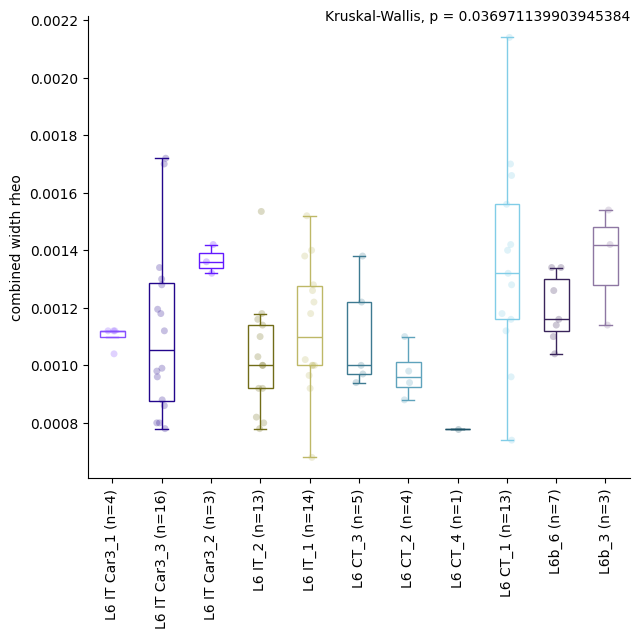

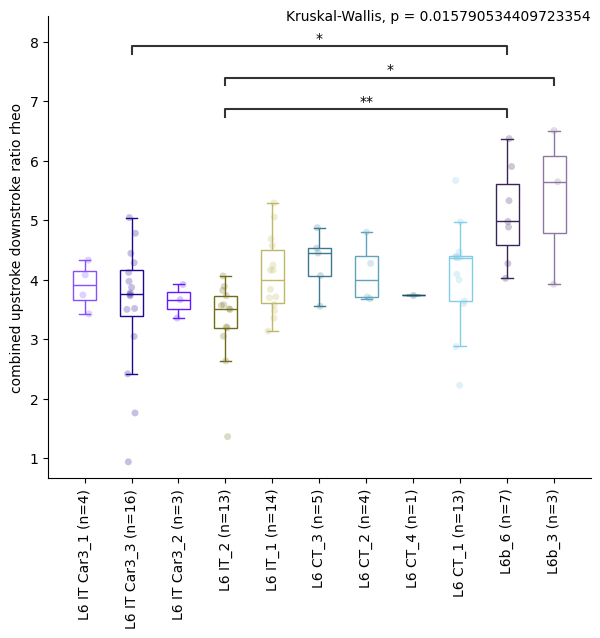

<Figure size 640x480 with 0 Axes>

In [12]:
# ttype x feature box plots

ttype_order = group_order['t_type']

for layer in kw_pvals_fdr_layer.keys():
    if kw_pvals_fdr_layer[layer]:
        #layer has results (there were enough ttypes in the layer, etc.)
        layer_data = sorted_clean_data.loc[sorted_clean_data[layer_var] == layer]
        kw_pvals_fdr = kw_pvals_fdr_layer[layer]  
        dunn_pvals_fdr = dunn_pvals_fdr_layer[layer]
        x_var = 't_type'  # what to do box plots on
        x_var_order = [t for t in ttype_order if t in layer_data[x_var].unique()]

        #ADJUST VARS
        fig_name = 'human_excitatory_boxplots_ephys_features_KW_Dunn_FDR_{}_byTtype.pdf'.format(layer.replace('/', '-').replace(' ', '_'))
        color_palette = color_dict #colors for x_var
        hue_var = 't_type' #seperate strip plots into these categories 
        hue_color_palette = color_dicts[hue_var] #color palette for hue_var
        ##### MAKE SURE TO UPDATE KRUSKAL CALL IN CODE BELOW TO CONTAIN ALL THE X_VAR GROUPS #####

        #######################

        fig_path = os.path.join(output_dir, fig_name)
        ephys_features = feature_cols.copy()

        with warnings.catch_warnings():
            warnings.simplefilter(action='ignore', category=FutureWarning)

            with PdfPages(fig_path) as pdf:
                while ephys_features != []:
                    
                    #one fig per page, each has page (fig) has 4 rows. 
                    fig, ax = plt.subplots(nrows=1,ncols=1,figsize=(7,6),sharex=True, gridspec_kw = {'wspace':0, 'hspace':0.1}) #gridspec_kw = {'wspace':0, 'hspace':0},
                    # for ax in axes: #plot as many neurons as fit on this page (num_rows rows of plotting)
                    
                    y_var = ephys_features.pop()
                    
                    sns.stripplot(data=layer_data, x=x_var, y=y_var, ax=ax, order=x_var_order, palette=color_palette, alpha=0.25)
                    sns.boxplot(data=layer_data, x=x_var, y=y_var, ax=ax, order=x_var_order, palette=color_palette, saturation=1, showfliers = False, width=0.5)
                    format_box_plot(ax) #color line not fill of boxplot


                    #add num observations per x_var
                    nobs = []
                    for t in x_var_order:
                        n = len(layer_data[layer_data[x_var] == t])
                        nobs.append(" (n=%s)" % str(n))
                    new_x_tick_labels = [x_var_order[i] + nobs[i] for i in range(len(x_var_order))]  
                    ax.set_xticklabels(new_x_tick_labels)

                    # add stats (KW w/ Dunn post hoc FDR corrected)

                    #plot signif dunn fdr p-vals 
                    if y_var in dunn_pvals_fdr.keys(): 
                        #kw fdr val was signif so there are dunn fdr vals to plot
                        
                        this_dunn_pvals_fdr = dunn_pvals_fdr[y_var]
                        remove = np.tril(np.ones(this_dunn_pvals_fdr.shape), k=0).astype("bool")
                        this_dunn_pvals_fdr[remove] = np.nan
                        dunn_pvals_fdr_melt = this_dunn_pvals_fdr.melt(ignore_index=False).reset_index().dropna()

                        #set insignificant pvals to nan 
                        p_thresh = 0.05 #threshold for plotting p vals 
                        dunn_pvals_fdr_melt.drop(dunn_pvals_fdr_melt[dunn_pvals_fdr_melt['value'] > p_thresh].index, inplace = True)

                        #plot bar for all signif fdr corrected dunn p vals 
                        pairs = [(i[1]["index"], i[1]["variable"]) for i in dunn_pvals_fdr_melt.iterrows()]
                        if len(pairs): 
                            #there's at least one pair of x_vals for which fdr corrected dunn test is signif
                            p_values = [i[1]["value"] for i in dunn_pvals_fdr_melt.iterrows()]                    
                            annotator = Annotator(ax, pairs, data=layer_data, x=x_var, y=y_var, order=x_var_order)
                            annotator.configure(text_format="star", loc="inside") #text_format="simple"
                            annotator.set_pvalues_and_annotate(p_values)
                            
                    #plot Kruskal-Wallis fdr p-vals
                    if y_var in kw_pvals_fdr.keys():
                        xlimit = ax.get_xlim()
                        ylimit = ax.get_ylim()
                        p_txt = 'Kruskal-Wallis, p = ' + str(kw_pvals_fdr[y_var])
                        ax.text(xlimit[1], ylimit[1], p_txt, verticalalignment='center', horizontalalignment='right')

                    #rotate and format x_var labels 
                    ax.set(xlabel=None)
                    ax.tick_params(axis='x', rotation=90)
                    ax.set_ylabel(y_var.replace("_", " "), rotation=90)
                    ax.spines[['right', 'top']].set_visible(False)

                    fig.subplots_adjust(wspace=0, hspace=0.0)
                    pdf.savefig(dpi=600, bbox_inches='tight')
                plt.show()
                plt.clf()
                print()



T-Types within each Subclass x feature box plots with stats

In [13]:
#ttypes within each subclass

ttype_order = group_order['t_type']

# subclass x feature stats
subcalss_var = 'subclass_label' #what to do box plots on 
subclass_var_order = group_order['subclass_label']

kw_pvals_fdr_subclass = dict()
dunn_pvals_fdr_subclass = dict()
for subclass in subclass_var_order:
    print(subclass)
    subclass_data = sorted_clean_data.loc[sorted_clean_data[subcalss_var] == subclass]

    #now run stats on the ttypes in this subclass 
    x_var = 't_type'  # what to do box plots on
    x_var_order = [t for t in ttype_order if t in subclass_data[x_var].unique()]

    # Kruskal-Wallis H test on all features
    kw_hvals = dict()
    kw_pvals = dict()
    for f in feature_cols:
        # Create a list of groups dynamically
        groups = [subclass_data.loc[subclass_data[x_var] == x][f].dropna() for x in x_var_order]
        
        # Only include groups that have data
        groups = [group for group in groups if not group.empty]

        if len(groups) < 2:
            print(f"Not enough groups with data for feature {f}")
            continue
        try:
            hvalue, pvalue = kruskal(*groups, nan_policy='omit')
            kw_hvals[f] = hvalue
            kw_pvals[f] = pvalue
        except ValueError as e:
            print(f'Kruskal-Wallis not calculated for {f} because of an error: {e}')

    # FDR correction
    kw_pvals_list = list(kw_pvals.values())
    kw_rejected_list, kw_pvals_fdr_list = fdrcorrection(kw_pvals_list, alpha=0.05, method='indep', is_sorted=False)

    kw_pvals_fdr = dict(zip(list(kw_pvals.keys()), list(kw_pvals_fdr_list)))
    kw_rejected = dict(zip(list(kw_pvals.keys()), list(kw_rejected_list)))

    # Post Hoc Dunn test for significant KW features, with FDR correction
    dunn_pvals_fdr = dict()
    for k, v in kw_rejected.items():
        if v:  # if null hypothesis was rejected, calculate Dunn post hoc
            dunn_pvals_fdr[k] = posthoc_dunn(subclass_data[subclass_data[x_var].isin(x_var_order)], val_col=k, group_col=x_var, p_adjust='fdr_bh', sort=True)

    kw_pvals_fdr_subclass[subclass] = kw_pvals_fdr
    dunn_pvals_fdr_subclass[subclass] = dunn_pvals_fdr

L2/3 IT
L4 IT
L5 IT
L5/6 NP
L5 ET
Not enough groups with data for feature sm_rheobase_i
Not enough groups with data for feature sm_latency_rheo
Not enough groups with data for feature sm_avg_rate_hero
Not enough groups with data for feature sm_mean_isi_hero
Not enough groups with data for feature sm_isi_adapt_ratio
Not enough groups with data for feature sm_trough_slowdeltav_hero
Not enough groups with data for feature sm_fast_trough_deltav_hero
Not enough groups with data for feature sm_adapt_mean
L6 IT Car3
L6 IT
L6 CT
Not enough groups with data for feature combined_peak_freq_chirp
Not enough groups with data for feature combined_peak_impedance_chirp
L6b


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2 IT_6 vs. L2 IT_1: Custom statistical test, P_val:7.753e-06
L2 IT_2 vs. L3 IT_12: Custom statistical test, P_val:7.331e-03
L2 IT_6 vs. L2 IT_2: Custom statistical test, P_val:4.718e-02
L2 IT_1 vs. L3 IT_12: Custom statistical test, P_val:3.621e-05
L2 IT_2 vs. L3 IT_13: Custom statistical test, P_val:5.019e-03
L2 IT_1 vs. L3 IT_10: Custom statistical test, P_val:8.325e-03
L2 IT_2 vs. L3 IT_5: Custom statistical test, P_val:1.172e-04
L2 IT_1 vs. L3 IT_13: Custom statistical test, P_val:1.725e-05
L2 IT_1 vs. L3 IT_5: Custom statistical test, P_val:5.382e-09
L2 IT_6 vs. L3 IT_5: Custom statistical test, P_val:4.718e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2 IT_6 vs. L2 IT_1: Custom statistical test, P_val:1.185e-03
L2 IT_2 vs. L3 IT_12: Custom statistical test, P_val:1.140e-03
L2 IT_6 vs. L2 IT_2: Custom statistical test, P_val:4.521e-02
L2 IT_2 vs. L3 IT_10: Custom statistical test, P_val:4.521e-02
L2 IT_1 vs. L3 IT_12: Custom statistical test, P_val:9.071e-05
L2 IT_2 vs. L3 IT_13: Custom statistical test, P_val:1.937e-03
L2 IT_1 vs. L3 IT_10: Custom statistical test, P_val:9.650e-03
L2 IT_2 vs. L3 IT_5: Custom statistical test, P_val:3.116e-05
L2 IT_1 vs. L3 IT_13: Custom statistical test, P_val:1.853e-04
L2 IT_1 vs. L3 IT_5: Custom statistical test, P_val:7.767e-08
L2 IT_6 vs. L3 IT_5: Custom statistical test, P_val:9.436e-03


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2 IT_6 vs. L2 IT_1: Custom statistical test, P_val:1.040e-04
L2 IT_2 vs. L3 IT_12: Custom statistical test, P_val:8.672e-03
L2 IT_6 vs. L2 IT_2: Custom statistical test, P_val:2.812e-02
L2 IT_2 vs. L3 IT_10: Custom statistical test, P_val:2.812e-02
L2 IT_1 vs. L3 IT_12: Custom statistical test, P_val:4.148e-04
L2 IT_2 vs. L3 IT_13: Custom statistical test, P_val:4.611e-04
L2 IT_1 vs. L3 IT_10: Custom statistical test, P_val:1.933e-03
L2 IT_1 vs. L3 IT_13: Custom statistical test, P_val:3.888e-06
L2 IT_1 vs. L3 IT_5: Custom statistical test, P_val:8.549e-03


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2 IT_2 vs. L3 IT_12: Custom statistical test, P_val:2.439e-02
L2 IT_2 vs. L3 IT_10: Custom statistical test, P_val:2.252e-02
L2 IT_1 vs. L3 IT_12: Custom statistical test, P_val:1.132e-03
L2 IT_2 vs. L3 IT_13: Custom statistical test, P_val:1.132e-03
L2 IT_1 vs. L3 IT_10: Custom statistical test, P_val:1.132e-03
L2 IT_6 vs. L3 IT_12: Custom statistical test, P_val:1.324e-02
L2 IT_7 vs. L3 IT_13: Custom statistical test, P_val:2.755e-02
L2 IT_2 vs. L3 IT_5: Custom statistical test, P_val:1.928e-02
L2 IT_6 vs. L3 IT_10: Custom statistical test, P_val:1.266e-02
L2 IT_1 vs. L3 IT_13: Custom statistical test, P_val:1.152e-05
L2 IT_6 vs. L3 IT_13: Custom statistical test, P_val:2.872e-04
L2 IT_1 vs. L3 IT_5: Custom statistical test, P_val:2.872e-04
L2 IT_6 vs. L3 IT_5: Custom statistical test, P_val:6.

C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2 IT_6 vs. L2 IT_1: Custom statistical test, P_val:7.956e-06
L2 IT_2 vs. L3 IT_12: Custom statistical test, P_val:4.388e-03
L3 IT_13 vs. L3 IT_3: Custom statistical test, P_val:3.760e-02
L2 IT_6 vs. L2 IT_2: Custom statistical test, P_val:4.845e-03
L2 IT_1 vs. L3 IT_12: Custom statistical test, P_val:2.735e-04
L2 IT_2 vs. L3 IT_13: Custom statistical test, P_val:3.807e-04
L2 IT_1 vs. L3 IT_10: Custom statistical test, P_val:1.862e-02
L2 IT_2 vs. L3 IT_5: Custom statistical test, P_val:3.980e-02
L2 IT_1 vs. L3 IT_13: Custom statistical test, P_val:7.956e-06
L2 IT_1 vs. L3 IT_5: Custom statistical test, P_val:2.575e-03


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2 IT_6 vs. L2 IT_1: Custom statistical test, P_val:5.136e-05
L3 IT_13 vs. L3 IT_5: Custom statistical test, P_val:2.666e-03
L2 IT_2 vs. L3 IT_12: Custom statistical test, P_val:7.069e-03
L3 IT_13 vs. L3 IT_3: Custom statistical test, P_val:7.181e-03
L3 IT_10 vs. L3 IT_5: Custom statistical test, P_val:3.485e-02
L2 IT_6 vs. L2 IT_2: Custom statistical test, P_val:1.010e-03
L2 IT_2 vs. L3 IT_10: Custom statistical test, P_val:2.981e-02
L3 IT_10 vs. L3 IT_3: Custom statistical test, P_val:3.288e-02
L3 IT_12 vs. L3 IT_5: Custom statistical test, P_val:8.144e-03
L2 IT_1 vs. L3 IT_12: Custom statistical test, P_val:5.468e-03
L2 IT_2 vs. L3 IT_13: Custom statistical test, P_val:1.973e-03
L3 IT_12 vs. L3 IT_3: Custom statistical test, P_val:1.201e-02
L2 IT_1 vs. L3 IT_10: Custom statistical test, P_val:2

C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2 IT_2 vs. L3 IT_10: Custom statistical test, P_val:2.941e-02
L2 IT_2 vs. L3 IT_5: Custom statistical test, P_val:2.619e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sar

p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L3 IT_12 vs. L3 IT_13: Custom statistical test, P_val:1.353e-03


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L3 IT_13 vs. L3 IT_5: Custom statistical test, P_val:1.411e-03
L3 IT_13 vs. L3 IT_3: Custom statistical test, P_val:1.690e-02
L2 IT_1 vs. L3 IT_13: Custom statistical test, P_val:2.926e-02
L2 IT_6 vs. L3 IT_13: Custom statistical test, P_val:5.007e-03


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2 IT_6 vs. L2 IT_1: Custom statistical test, P_val:1.580e-07
L2 IT_1 vs. L2 IT_7: Custom statistical test, P_val:3.329e-02
L2 IT_7 vs. L2 IT_2: Custom statistical test, P_val:2.890e-02
L3 IT_13 vs. L3 IT_5: Custom statistical test, P_val:3.095e-03
L2 IT_2 vs. L3 IT_12: Custom statistical test, P_val:1.624e-07
L3 IT_13 vs. L3 IT_3: Custom statistical test, P_val:1.327e-03
L2 IT_6 vs. L2 IT_2: Custom statistical test, P_val:8.101e-06
L2 IT_2 vs. L3 IT_10: Custom statistical test, P_val:4.108e-06
L3 IT_10 vs. L3 IT_3: Custom statistical test, P_val:1.767e-02
L3 IT_12 vs. L3 IT_5: Custom statistical test, P_val:2.549e-02
L2 IT_1 vs. L3 IT_12: Custom statistical test, P_val:3.379e-08
L2 IT_2 vs. L3 IT_13: Custom statistical test, P_val:1.742e-10
L3 IT_12 vs. L3 IT_3: Custom statistical test, P_val:4.0

C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2 IT_1 vs. L2 IT_2: Custom statistical test, P_val:1.758e-02
L2 IT_1 vs. L3 IT_12: Custom statistical test, P_val:6.303e-05
L2 IT_1 vs. L3 IT_10: Custom statistical test, P_val:1.665e-02
L2 IT_6 vs. L3 IT_12: Custom statistical test, P_val:2.757e-03
L2 IT_1 vs. L3 IT_13: Custom statistical test, P_val:1.519e-04
L2 IT_6 vs. L3 IT_13: Custom statistical test, P_val:1.162e-02
L2 IT_1 vs. L3 IT_5: Custom statistical test, P_val:3.856e-07
L2 IT_1 vs. L3 IT_3: Custom statistical test, P_val:2.872e-03
L2 IT_6 vs. L3 IT_5: Custom statistical test, P_val:1.584e-04
L2 IT_6 vs. L3 IT_3: Custom statistical test, P_val:1.758e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2 IT_2 vs. L3 IT_12: Custom statistical test, P_val:2.449e-02
L3 IT_12 vs. L3 IT_13: Custom statistical test, P_val:4.322e-02
L2 IT_2 vs. L3 IT_10: Custom statistical test, P_val:9.288e-04
L3 IT_8 vs. L3 IT_13: Custom statistical test, P_val:2.584e-02
L2 IT_1 vs. L3 IT_12: Custom statistical test, P_val:3.246e-05
L2 IT_2 vs. L3 IT_13: Custom statistical test, P_val:2.206e-08
L3 IT_8 vs. L3 IT_5: Custom statistical test, P_val:3.125e-02
L2 IT_1 vs. L3 IT_10: Custom statistical test, P_val:6.652e-08
L2 IT_6 vs. L3 IT_12: Custom statistical test, P_val:1.292e-03
L2 IT_7 vs. L3 IT_13: Custom statistical test, P_val:3.125e-02
L2 IT_2 vs. L3 IT_5: Custom statistical test, P_val:2.616e-08
L2 IT_6 vs. L3 IT_10: Custom statistical test, P_val:1.086e-05
L2 IT_1 vs. L3 IT_13: Custom statistical test, P_val:

C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2 IT_6 vs. L2 IT_1: Custom statistical test, P_val:1.025e-05
L3 IT_13 vs. L3 IT_5: Custom statistical test, P_val:1.729e-03
L2 IT_2 vs. L3 IT_12: Custom statistical test, P_val:2.353e-02
L3 IT_12 vs. L3 IT_13: Custom statistical test, P_val:2.925e-02
L3 IT_13 vs. L3 IT_3: Custom statistical test, P_val:6.503e-03
L2 IT_6 vs. L2 IT_2: Custom statistical test, P_val:2.643e-03
L2 IT_1 vs. L3 IT_12: Custom statistical test, P_val:4.670e-03
L2 IT_2 vs. L3 IT_5: Custom statistical test, P_val:9.493e-04
L2 IT_2 vs. L3 IT_3: Custom statistical test, P_val:5.962e-03
L2 IT_6 vs. L3 IT_13: Custom statistical test, P_val:5.115e-03
L2 IT_1 vs. L3 IT_5: Custom statistical test, P_val:1.025e-05
L2 IT_1 vs. L3 IT_3: Custom statistical test, P_val:2.643e-03


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:33: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(nrows=1,ncols=1,figsize=(7,6),sharex=True, gridspec_kw = {'wspace':0, 'hspace':0.1}) #gridspec_kw = {'wspace':0, 'hspace':0},
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2 IT_2 vs. L3 IT_12: Custom statistical test, P_val:2.729e-02
L2 IT_1 vs. L3 IT_12: Custom statistical test, P_val:2.533e-02
L2 IT_6 vs. L3 IT_12: Custom statistical test, P_val:1.813e-03
L2 IT_2 vs. L3 IT_5: Custom statistical test, P_val:2.453e-03
L2 IT_1 vs. L3 IT_5: Custom statistical test, P_val:1.211e-03
L2 IT_6 vs. L3 IT_5: Custom statistical test, P_val:1.814e-05


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2 IT_6 vs. L2 IT_1: Custom statistical test, P_val:5.056e-06
L3 IT_13 vs. L3 IT_5: Custom statistical test, P_val:3.651e-03
L2 IT_2 vs. L3 IT_12: Custom statistical test, P_val:1.405e-02
L3 IT_12 vs. L3 IT_13: Custom statistical test, P_val:1.127e-02
L3 IT_13 vs. L3 IT_3: Custom statistical test, P_val:3.118e-02
L2 IT_6 vs. L2 IT_2: Custom statistical test, P_val:6.307e-04
L2 IT_1 vs. L3 IT_12: Custom statistical test, P_val:3.867e-03
L2 IT_1 vs. L3 IT_10: Custom statistical test, P_val:4.958e-02
L2 IT_2 vs. L3 IT_5: Custom statistical test, P_val:3.867e-03
L2 IT_2 vs. L3 IT_3: Custom statistical test, P_val:3.886e-02
L2 IT_6 vs. L3 IT_13: Custom statistical test, P_val:6.307e-04
L2 IT_1 vs. L3 IT_5: Custom statistical test, P_val:5.425e-04
L2 IT_1 vs. L3 IT_3: Custom statistical test, P_val:2.66

C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2 IT_6 vs. L2 IT_1: Custom statistical test, P_val:1.338e-02
L3 IT_12 vs. L3 IT_10: Custom statistical test, P_val:1.555e-02
L3 IT_13 vs. L3 IT_5: Custom statistical test, P_val:3.953e-06
L3 IT_8 vs. L3 IT_12: Custom statistical test, P_val:1.222e-02
L2 IT_2 vs. L3 IT_12: Custom statistical test, P_val:3.285e-06
L3 IT_12 vs. L3 IT_13: Custom statistical test, P_val:5.068e-04
L3 IT_13 vs. L3 IT_3: Custom statistical test, P_val:1.244e-03
L3 IT_10 vs. L3 IT_5: Custom statistical test, P_val:1.759e-03
L3 IT_10 vs. L3 IT_3: Custom statistical test, P_val:1.222e-02
L2 IT_1 vs. L3 IT_12: Custom statistical test, P_val:2.496e-07
L3 IT_8 vs. L3 IT_5: Custom statistical test, P_val:5.732e-03
L2 IT_1 vs. L3 IT_10: Custom statistical test, P_val:4.788e-02
L2 IT_6 vs. L3 IT_12: Custom statistical test, P_val

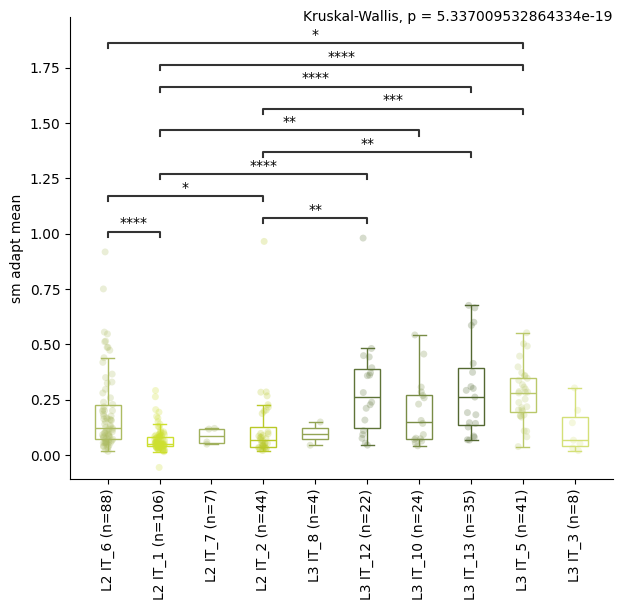

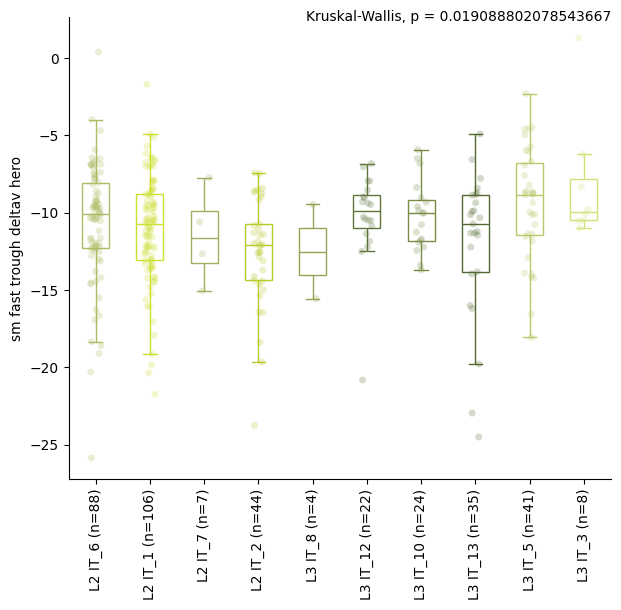

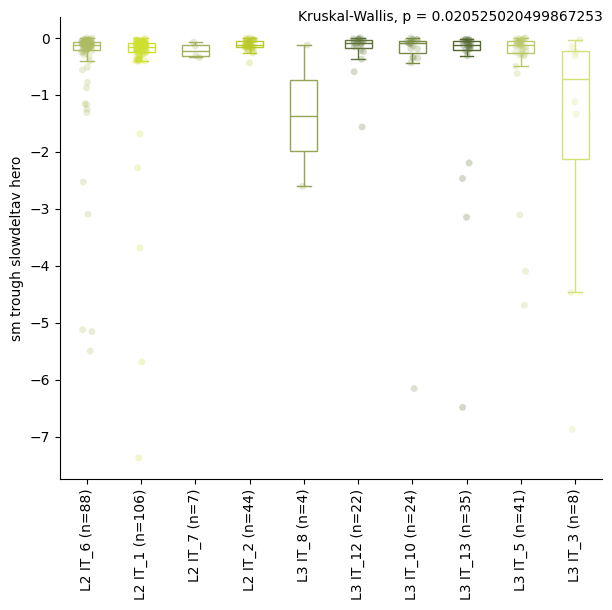

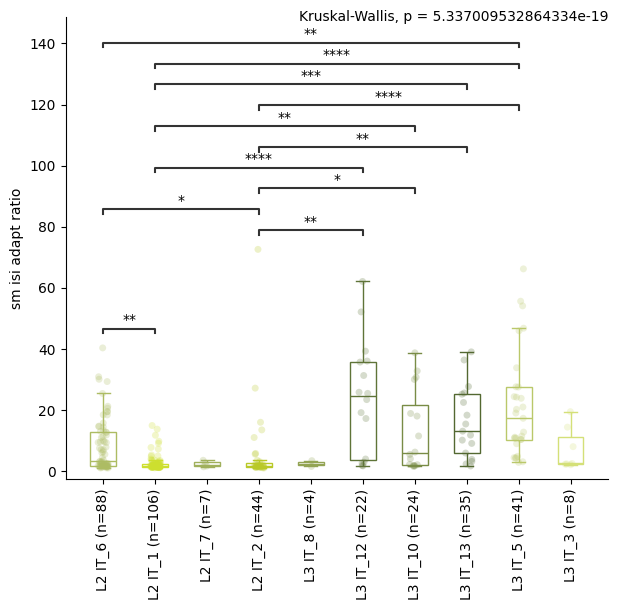

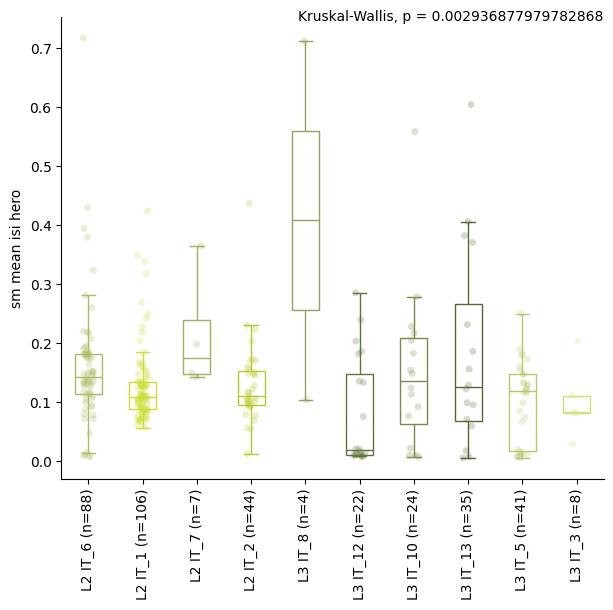

...

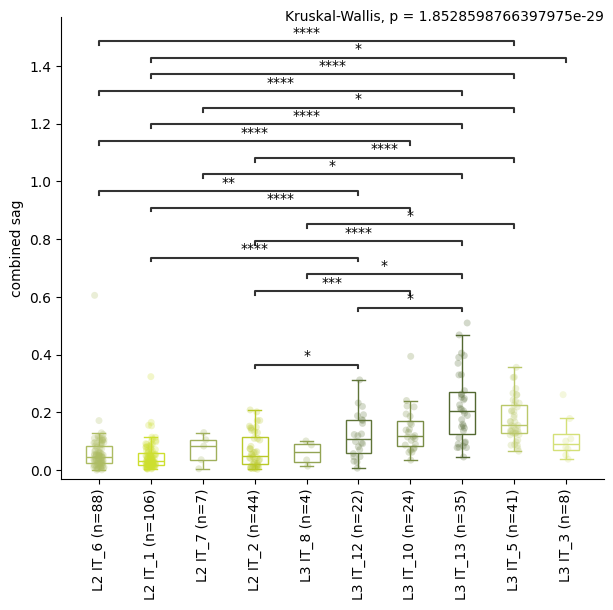

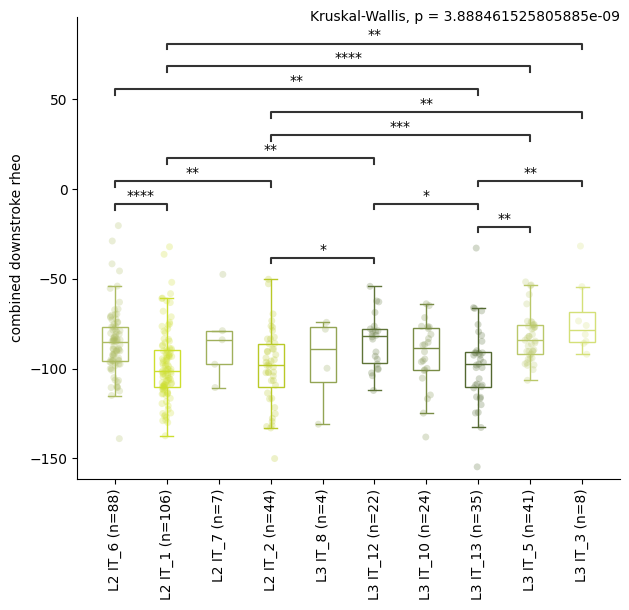

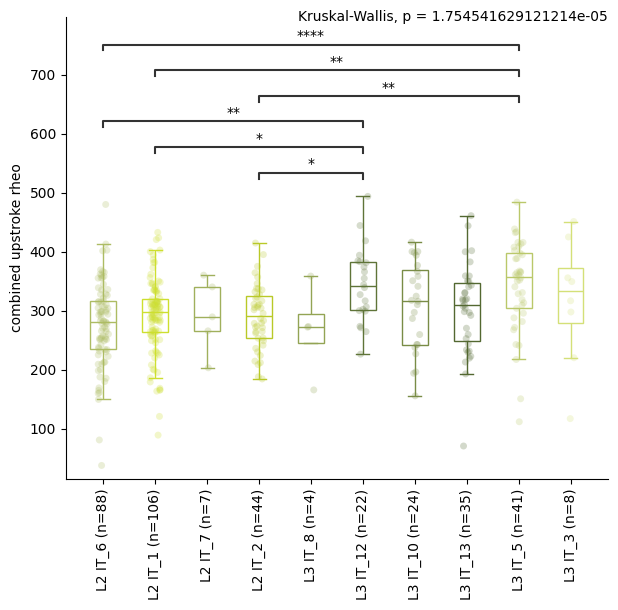

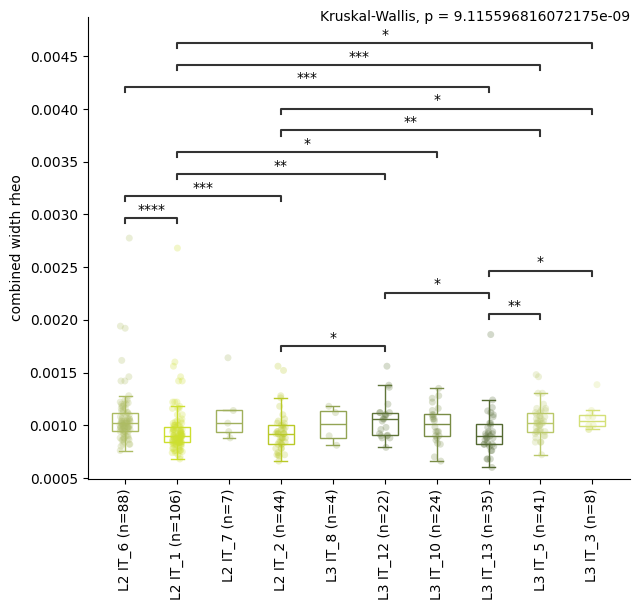

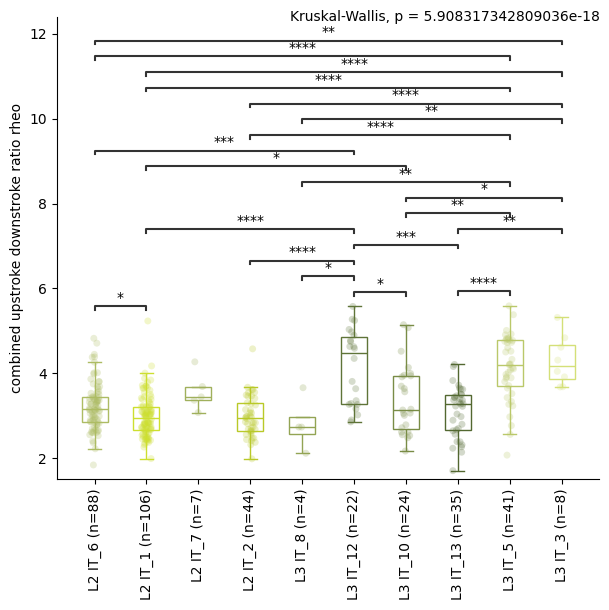

C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L4 IT_2 vs. L4 IT_1: Custom statistical test, P_val:1.863e-02
L4 IT_4 vs. L4 IT_2: Custom statistical test, P_val:7.354e-07
L4 IT_3 vs. L4 IT_2: Custom statistical test, P_val:8.515e-03
L4 IT_4 vs. L4 IT_1: Custom statistical test, P_val:1.180e-08
L4 IT_3 vs. L4 IT_1: Custom statistical test, P_val:1.596e-04


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L4 IT_2 vs. L4 IT_1: Custom statistical test, P_val:2.186e-04
L4 IT_4 vs. L4 IT_2: Custom statistical test, P_val:2.432e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L4 IT_2 vs. L4 IT_1: Custom statistical test, P_val:6.046e-05
L4 IT_4 vs. L4 IT_2: Custom statistical test, P_val:2.196e-17
L4 IT_3 vs. L4 IT_4: Custom statistical test, P_val:8.382e-03
L4 IT_4 vs. L4 IT_1: Custom statistical test, P_val:1.137e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L4 IT_2 vs. L4 IT_1: Custom statistical test, P_val:1.562e-06
L4 IT_4 vs. L4 IT_2: Custom statistical test, P_val:2.336e-02
L4 IT_4 vs. L4 IT_1: Custom statistical test, P_val:1.045e-02
L4 IT_3 vs. L4 IT_1: Custom statistical test, P_val:4.931e-03


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L4 IT_4 vs. L4 IT_2: Custom statistical test, P_val:5.760e-05
L4 IT_4 vs. L4 IT_1: Custom statistical test, P_val:1.349e-05
L4 IT_3 vs. L4 IT_1: Custom statistical test, P_val:1.220e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L4 IT_4 vs. L4 IT_2: Custom statistical test, P_val:1.429e-07
L4 IT_3 vs. L4 IT_2: Custom statistical test, P_val:1.622e-02
L4 IT_4 vs. L4 IT_1: Custom statistical test, P_val:4.261e-05
L4 IT_3 vs. L4 IT_1: Custom statistical test, P_val:1.992e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L4 IT_2 vs. L4 IT_1: Custom statistical test, P_val:4.278e-02
L4 IT_4 vs. L4 IT_2: Custom statistical test, P_val:8.097e-11
L4 IT_3 vs. L4 IT_4: Custom statistical test, P_val:5.811e-05
L4 IT_4 vs. L4 IT_1: Custom statistical test, P_val:4.083e-03


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L4 IT_4 vs. L4 IT_2: Custom statistical test, P_val:3.787e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L4 IT_2 vs. L4 IT_1: Custom statistical test, P_val:6.399e-05
L4 IT_4 vs. L4 IT_1: Custom statistical test, P_val:1.994e-04
L4 IT_3 vs. L4 IT_1: Custom statistical test, P_val:1.375e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L4 IT_2 vs. L4 IT_1: Custom statistical test, P_val:2.358e-02
L4 IT_4 vs. L4 IT_2: Custom statistical test, P_val:6.354e-04
L4 IT_4 vs. L4 IT_1: Custom statistical test, P_val:5.559e-06
L4 IT_3 vs. L4 IT_1: Custom statistical test, P_val:2.351e-03


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L4 IT_2 vs. L4 IT_1: Custom statistical test, P_val:9.717e-03
L4 IT_4 vs. L4 IT_2: Custom statistical test, P_val:2.616e-09
L4 IT_3 vs. L4 IT_2: Custom statistical test, P_val:4.312e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L4 IT_2 vs. L4 IT_1: Custom statistical test, P_val:3.084e-02
L4 IT_4 vs. L4 IT_2: Custom statistical test, P_val:7.362e-19
L4 IT_3 vs. L4 IT_4: Custom statistical test, P_val:1.088e-02
L4 IT_3 vs. L4 IT_2: Custom statistical test, P_val:3.084e-02
L4 IT_4 vs. L4 IT_1: Custom statistical test, P_val:5.894e-06


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L4 IT_4 vs. L4 IT_2: Custom statistical test, P_val:8.373e-08
L4 IT_3 vs. L4 IT_4: Custom statistical test, P_val:3.681e-06
L4 IT_4 vs. L4 IT_1: Custom statistical test, P_val:7.798e-03
L4 IT_3 vs. L4 IT_1: Custom statistical test, P_val:1.522e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L4 IT_2 vs. L4 IT_1: Custom statistical test, P_val:7.028e-06
L4 IT_4 vs. L4 IT_2: Custom statistical test, P_val:9.418e-10
L4 IT_3 vs. L4 IT_2: Custom statistical test, P_val:4.371e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L4 IT_2 vs. L4 IT_1: Custom statistical test, P_val:5.041e-08
L4 IT_4 vs. L4 IT_2: Custom statistical test, P_val:1.750e-02
L4 IT_3 vs. L4 IT_4: Custom statistical test, P_val:5.076e-04
L4 IT_3 vs. L4 IT_2: Custom statistical test, P_val:1.750e-02
L4 IT_4 vs. L4 IT_1: Custom statistical test, P_val:4.690e-11


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:33: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(nrows=1,ncols=1,figsize=(7,6),sharex=True, gridspec_kw = {'wspace':0, 'hspace':0.1}) #gridspec_kw = {'wspace':0, 'hspace':0},
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L4 IT_4 vs. L4 IT_2: Custom statistical test, P_val:2.702e-21
L4 IT_3 vs. L4 IT_4: Custom statistical test, P_val:2.700e-02
L4 IT_3 vs. L4 IT_2: Custom statistical test, P_val:3.998e-03
L4 IT_4 vs. L4 IT_1: Custom statistical test, P_val:1.461e-09
L4 IT_3 vs. L4 IT_1: Custom statistical test, P_val:4.544e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L4 IT_2 vs. L4 IT_1: Custom statistical test, P_val:2.658e-03
L4 IT_4 vs. L4 IT_2: Custom statistical test, P_val:3.232e-27
L4 IT_3 vs. L4 IT_4: Custom statistical test, P_val:2.658e-03
L4 IT_3 vs. L4 IT_2: Custom statistical test, P_val:2.658e-03
L4 IT_4 vs. L4 IT_1: Custom statistical test, P_val:1.931e-07


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L4 IT_2 vs. L4 IT_1: Custom statistical test, P_val:7.776e-03
L4 IT_4 vs. L4 IT_2: Custom statistical test, P_val:2.661e-25
L4 IT_3 vs. L4 IT_2: Custom statistical test, P_val:1.281e-04
L4 IT_4 vs. L4 IT_1: Custom statistical test, P_val:2.403e-07


<Figure size 640x480 with 0 Axes>

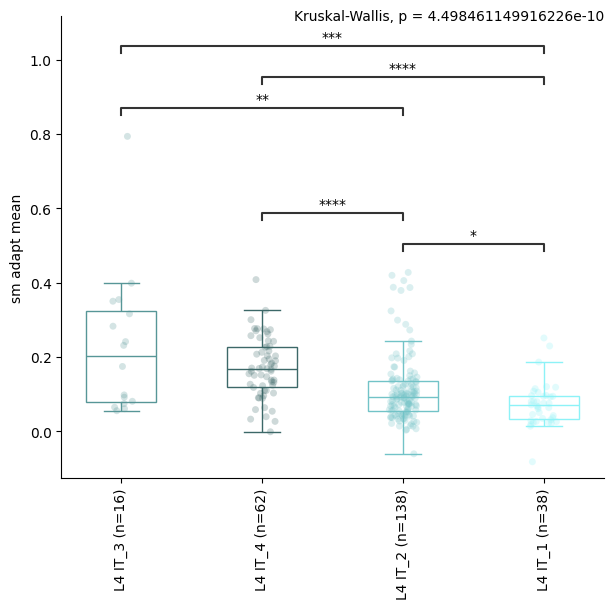

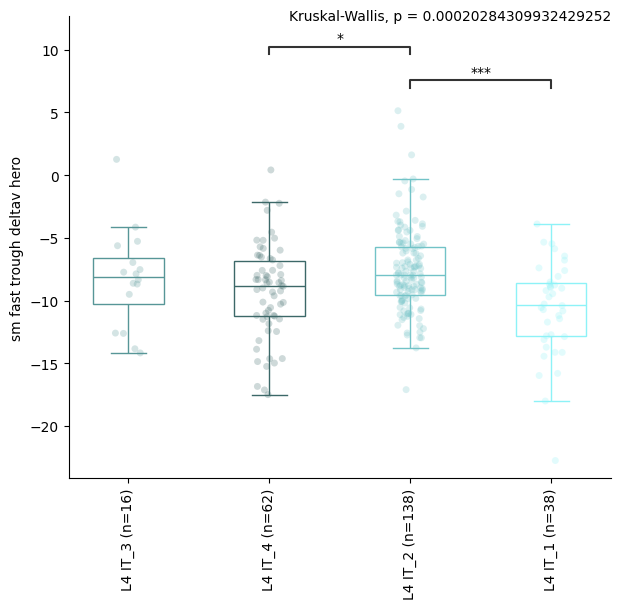

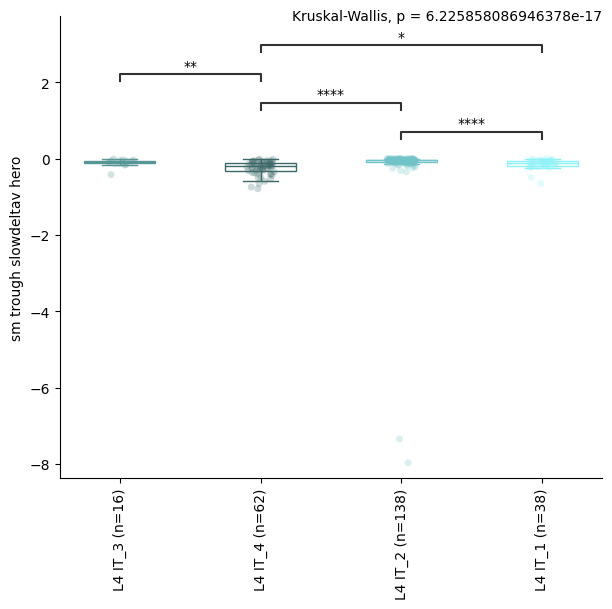

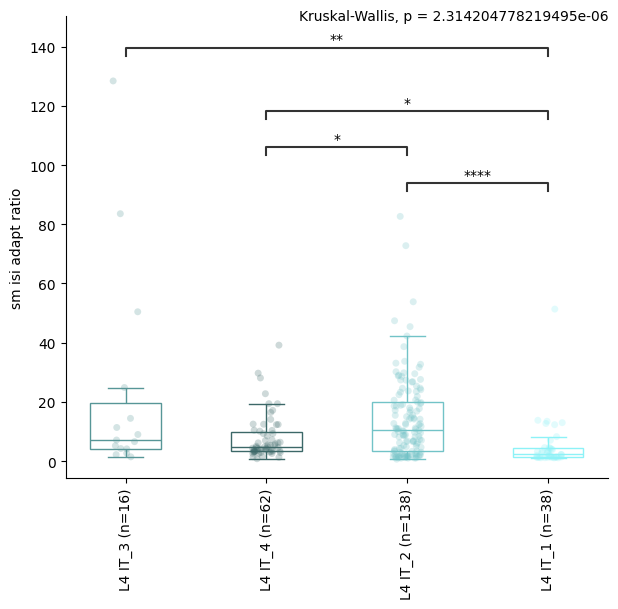

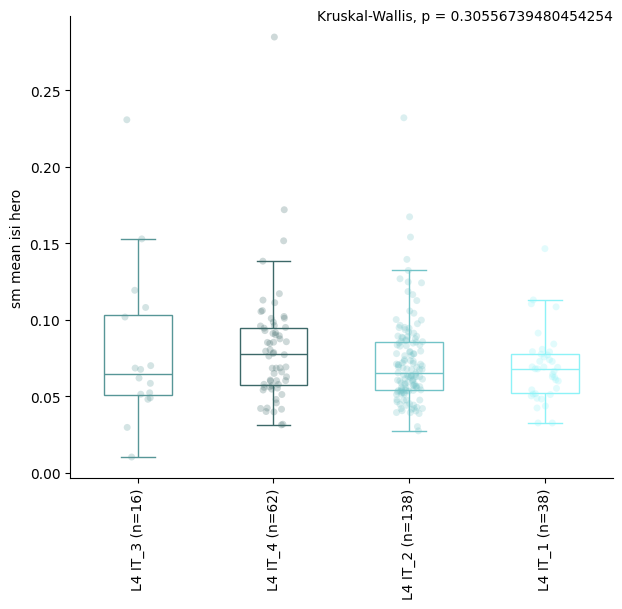

...

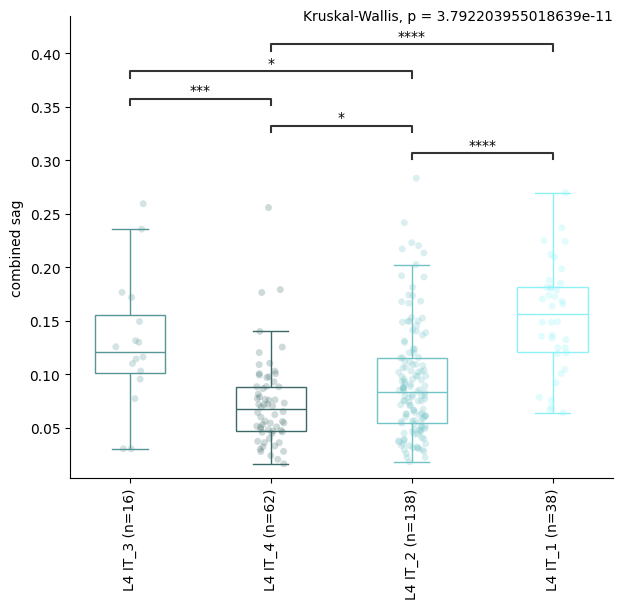

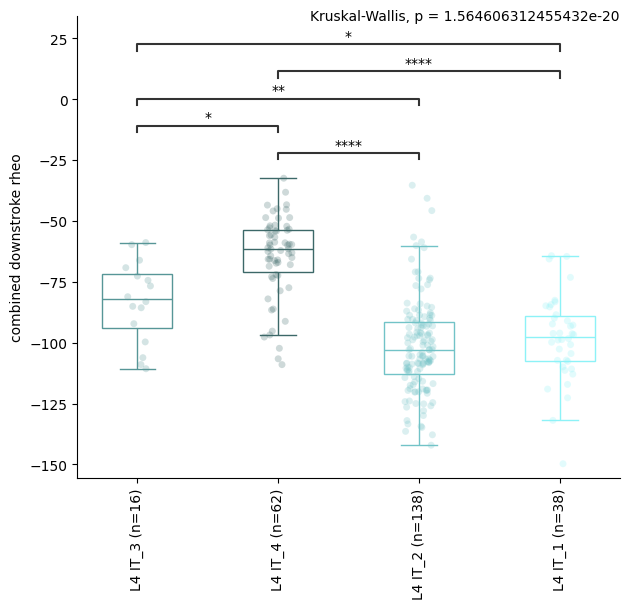

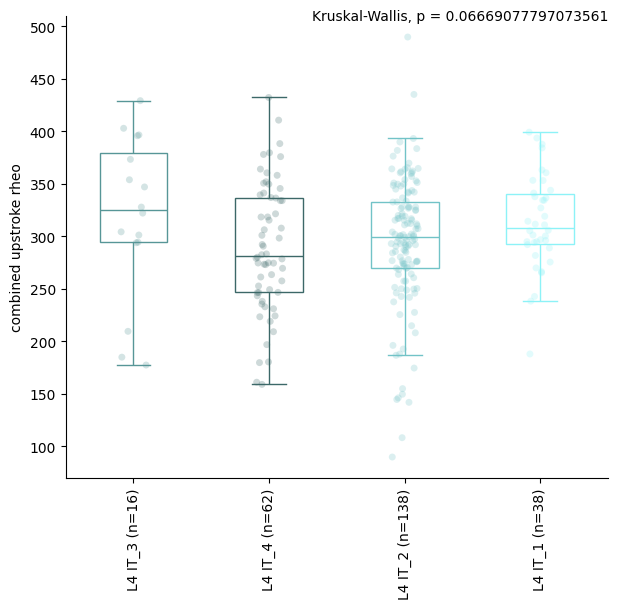

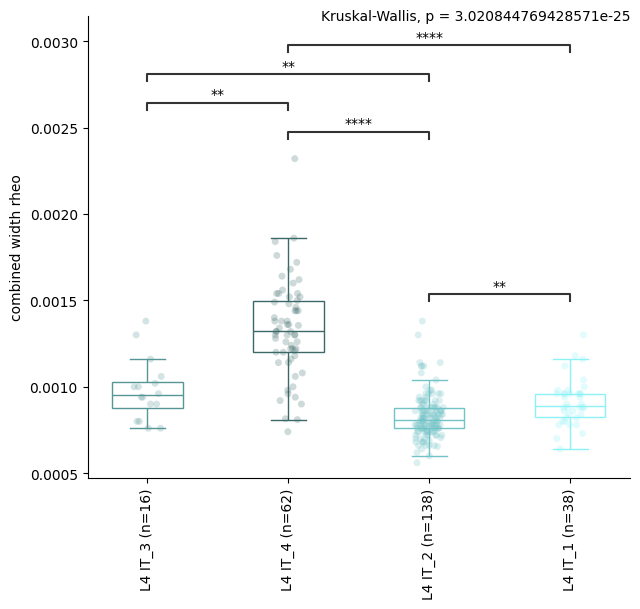

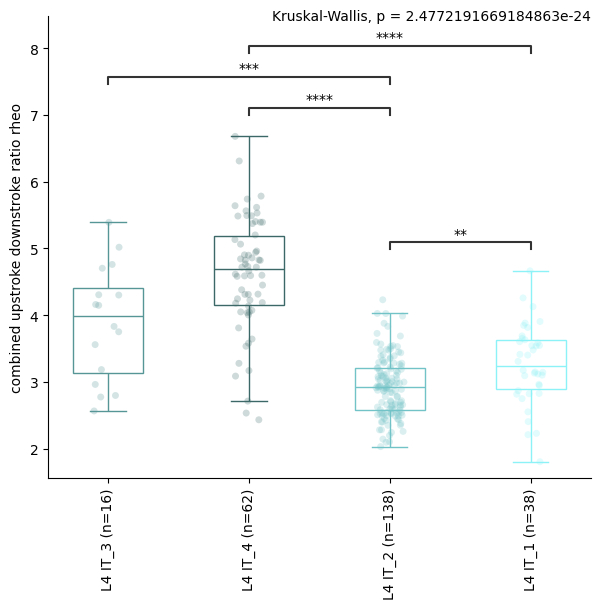

C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L5 IT_5 vs. L5 IT_2: Custom statistical test, P_val:1.229e-02
L5 IT_6 vs. L5 IT_2: Custom statistical test, P_val:7.756e-07


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L5 IT_2 vs. L5 IT_1: Custom statistical test, P_val:4.167e-02
L5 IT_1 vs. L5 IT_7: Custom statistical test, P_val:9.263e-04
L5 IT_1 vs. L5 IT_3: Custom statistical test, P_val:4.379e-02
L5 IT_2 vs. L5 IT_7: Custom statistical test, P_val:4.167e-02
L5 IT_5 vs. L5 IT_7: Custom statistical test, P_val:1.459e-02
L5 IT_6 vs. L5 IT_7: Custom statistical test, P_val:9.263e-04


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L5 IT_5 vs. L5 IT_2: Custom statistical test, P_val:2.561e-02
L5 IT_1 vs. L5 IT_7: Custom statistical test, P_val:1.228e-04
L5 IT_1 vs. L5 IT_3: Custom statistical test, P_val:5.710e-03
L5 IT_5 vs. L5 IT_1: Custom statistical test, P_val:9.224e-04
L5 IT_6 vs. L5 IT_2: Custom statistical test, P_val:1.504e-06
L5 IT_2 vs. L5 IT_7: Custom statistical test, P_val:3.074e-03
L5 IT_6 vs. L5 IT_1: Custom statistical test, P_val:1.017e-06


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L5 IT_2 vs. L5 IT_1: Custom statistical test, P_val:5.705e-03
L5 IT_6 vs. L5 IT_2: Custom statistical test, P_val:2.280e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L5 IT_5 vs. L5 IT_2: Custom statistical test, P_val:2.805e-02
L5 IT_6 vs. L5 IT_2: Custom statistical test, P_val:2.870e-04


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L5 IT_5 vs. L5 IT_2: Custom statistical test, P_val:1.617e-02
L5 IT_6 vs. L5 IT_5: Custom statistical test, P_val:4.197e-02
L5 IT_6 vs. L5 IT_2: Custom statistical test, P_val:6.053e-08
L5 IT_2 vs. L5 IT_7: Custom statistical test, P_val:1.972e-03
L5 IT_2 vs. L5 IT_3: Custom statistical test, P_val:1.972e-03
L5 IT_6 vs. L5 IT_1: Custom statistical test, P_val:4.474e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L5 IT_5 vs. L5 IT_3: Custom statistical test, P_val:2.543e-02
L5 IT_6 vs. L5 IT_3: Custom statistical test, P_val:2.543e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L5 IT_5 vs. L5 IT_2: Custom statistical test, P_val:1.999e-03
L5 IT_6 vs. L5 IT_5: Custom statistical test, P_val:8.680e-03
L5 IT_1 vs. L5 IT_7: Custom statistical test, P_val:7.809e-03
L5 IT_6 vs. L5 IT_2: Custom statistical test, P_val:3.469e-11
L5 IT_2 vs. L5 IT_7: Custom statistical test, P_val:3.816e-05
L5 IT_2 vs. L5 IT_3: Custom statistical test, P_val:8.680e-03
L5 IT_6 vs. L5 IT_1: Custom statistical test, P_val:1.259e-04


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L5 IT_6 vs. L5 IT_5: Custom statistical test, P_val:6.135e-03
L5 IT_1 vs. L5 IT_7: Custom statistical test, P_val:1.797e-03
L5 IT_1 vs. L5 IT_3: Custom statistical test, P_val:1.797e-03
L5 IT_6 vs. L5 IT_2: Custom statistical test, P_val:8.342e-05
L5 IT_2 vs. L5 IT_7: Custom statistical test, P_val:1.274e-02
L5 IT_2 vs. L5 IT_3: Custom statistical test, P_val:1.151e-02
L5 IT_6 vs. L5 IT_1: Custom statistical test, P_val:8.342e-05
L5 IT_5 vs. L5 IT_3: Custom statistical test, P_val:4.829e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L5 IT_1 vs. L5 IT_7: Custom statistical test, P_val:4.229e-02
L5 IT_5 vs. L5 IT_7: Custom statistical test, P_val:1.514e-02
L5 IT_6 vs. L5 IT_7: Custom statistical test, P_val:1.514e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sar

p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L5 IT_5 vs. L5 IT_3: Custom statistical test, P_val:3.327e-02
L5 IT_6 vs. L5 IT_3: Custom statistical test, P_val:3.327e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L5 IT_5 vs. L5 IT_2: Custom statistical test, P_val:4.150e-02
L5 IT_6 vs. L5 IT_5: Custom statistical test, P_val:3.115e-03
L5 IT_1 vs. L5 IT_7: Custom statistical test, P_val:1.560e-03
L5 IT_1 vs. L5 IT_3: Custom statistical test, P_val:1.560e-03
L5 IT_5 vs. L5 IT_1: Custom statistical test, P_val:1.095e-02
L5 IT_6 vs. L5 IT_2: Custom statistical test, P_val:2.420e-08
L5 IT_2 vs. L5 IT_7: Custom statistical test, P_val:3.115e-03
L5 IT_2 vs. L5 IT_3: Custom statistical test, P_val:3.115e-03
L5 IT_6 vs. L5 IT_1: Custom statistical test, P_val:1.882e-06


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:33: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(nrows=1,ncols=1,figsize=(7,6),sharex=True, gridspec_kw = {'wspace':0, 'hspace':0.1}) #gri

p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L5 IT_5 vs. L5 IT_2: Custom statistical test, P_val:1.470e-04
L5 IT_6 vs. L5 IT_2: Custom statistical test, P_val:1.857e-09
L5 IT_6 vs. L5 IT_1: Custom statistical test, P_val:2.166e-03
L5 IT_6 vs. L5 IT_7: Custom statistical test, P_val:2.166e-03
L5 IT_6 vs. L5 IT_3: Custom statistical test, P_val:1.818e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L5 IT_5 vs. L5 IT_2: Custom statistical test, P_val:1.995e-05
L5 IT_5 vs. L5 IT_1: Custom statistical test, P_val:3.784e-03
L5 IT_6 vs. L5 IT_2: Custom statistical test, P_val:1.405e-09
L5 IT_6 vs. L5 IT_1: Custom statistical test, P_val:8.067e-05
L5 IT_6 vs. L5 IT_7: Custom statistical test, P_val:6.523e-03
L5 IT_6 vs. L5 IT_3: Custom statistical test, P_val:1.079e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L5 IT_5 vs. L5 IT_2: Custom statistical test, P_val:1.757e-02
L5 IT_6 vs. L5 IT_2: Custom statistical test, P_val:1.418e-07
L5 IT_6 vs. L5 IT_1: Custom statistical test, P_val:3.690e-03
L5 IT_6 vs. L5 IT_7: Custom statistical test, P_val:2.583e-02


<Figure size 640x480 with 0 Axes>

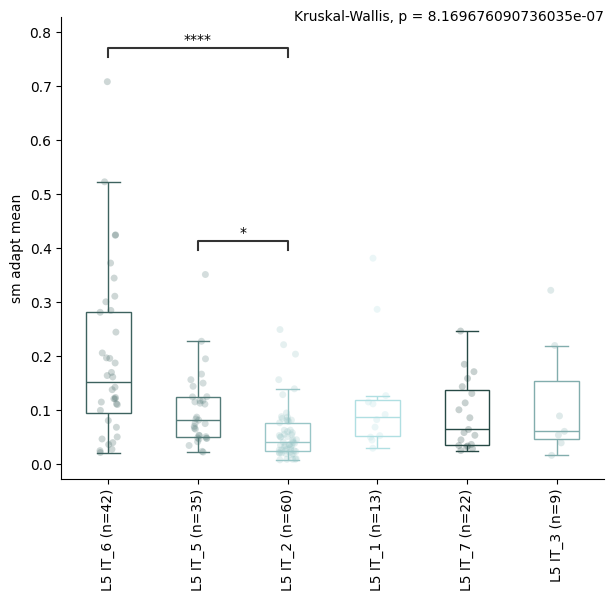

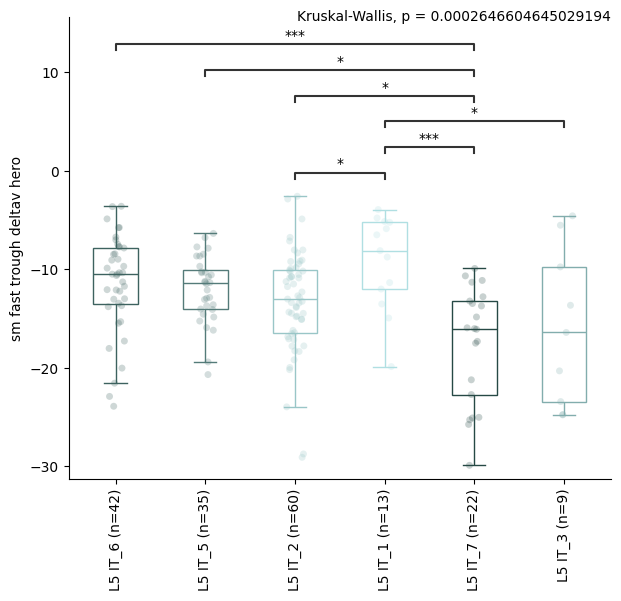

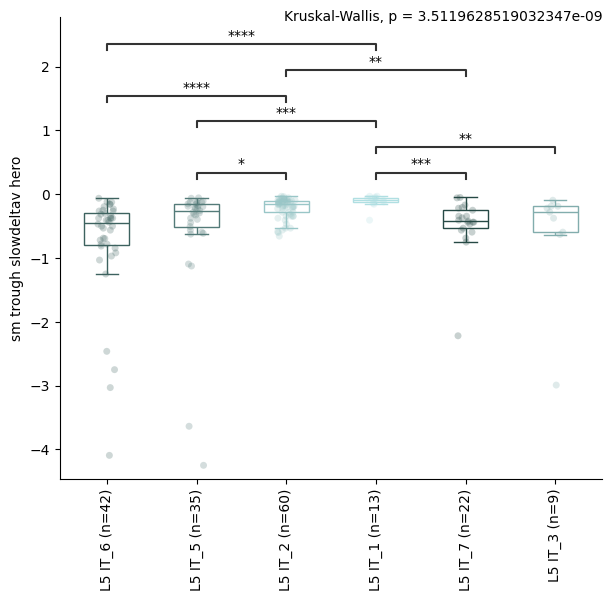

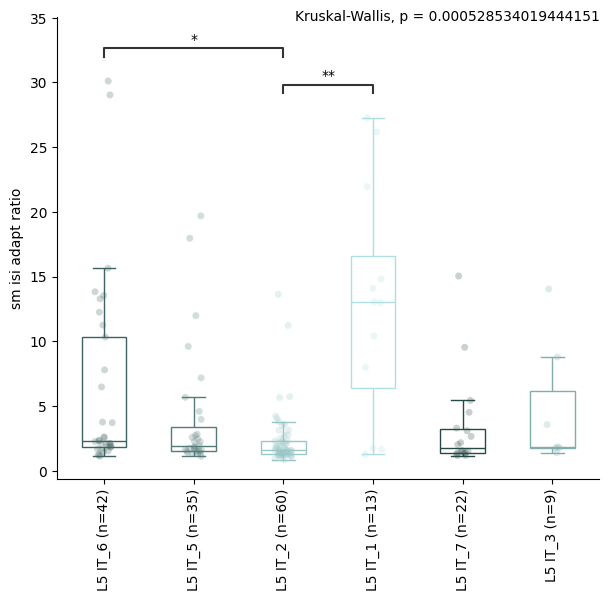

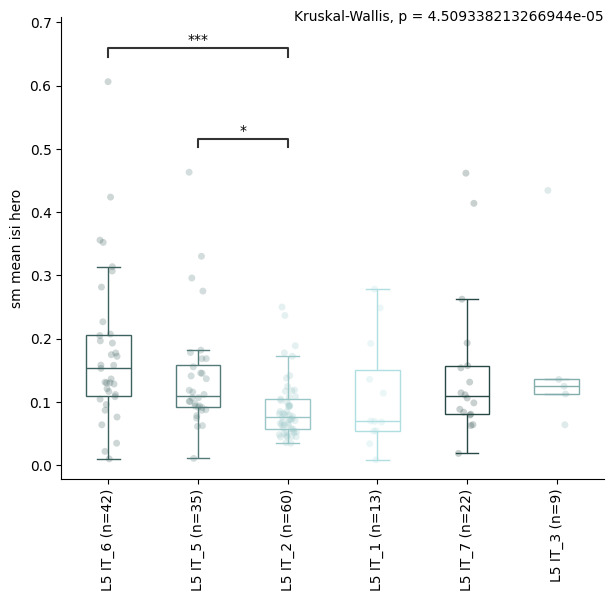

...

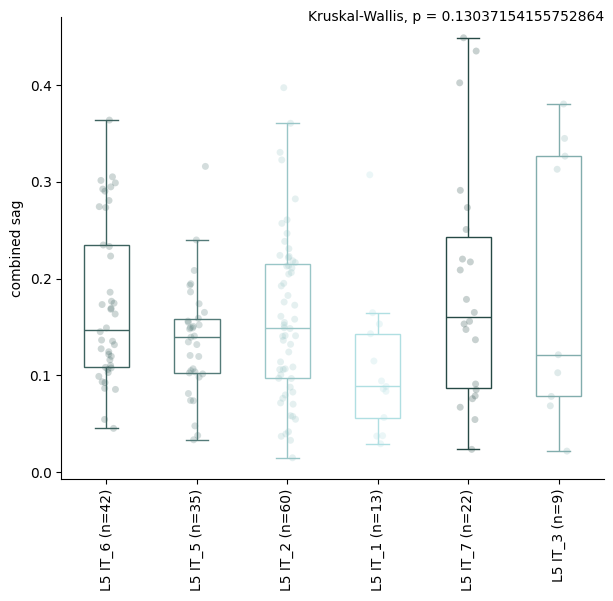

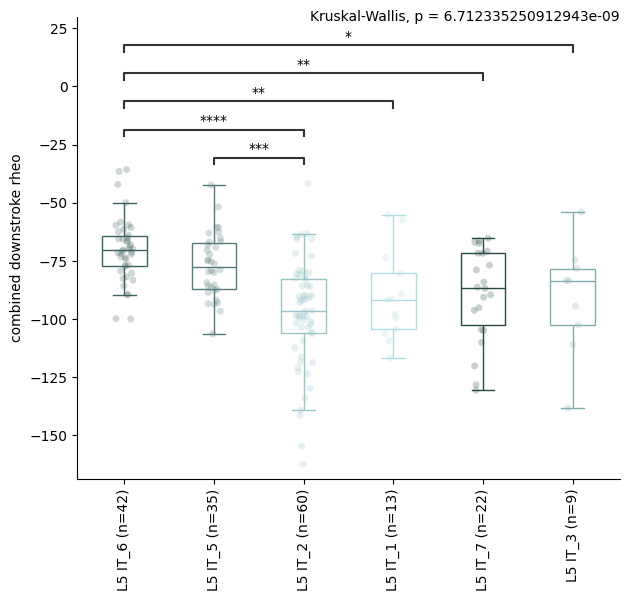

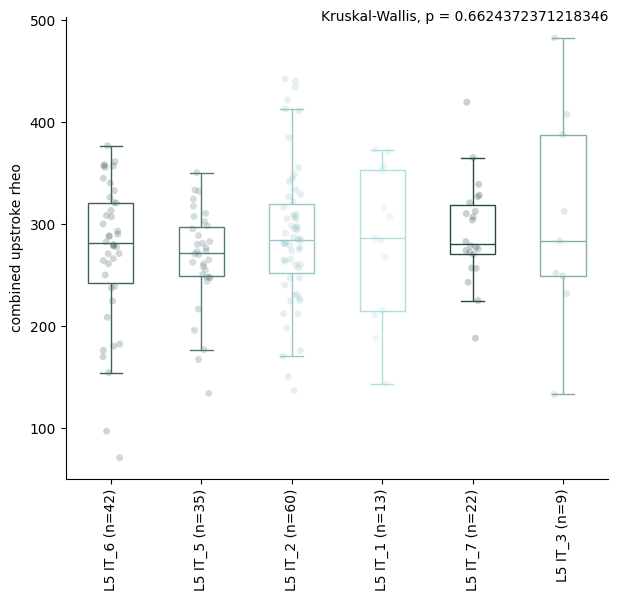

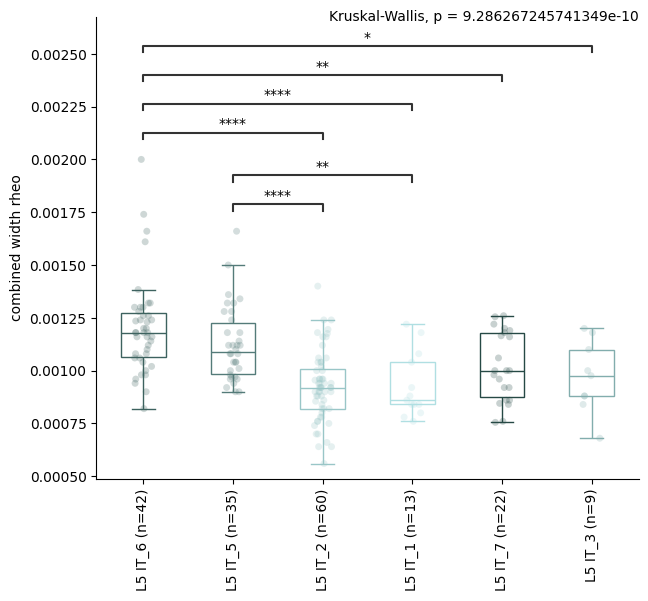

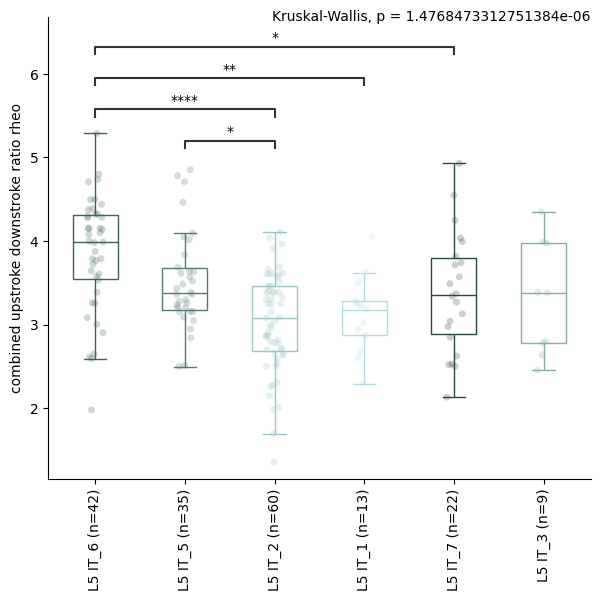

C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sar

<Figure size 640x480 with 0 Axes>

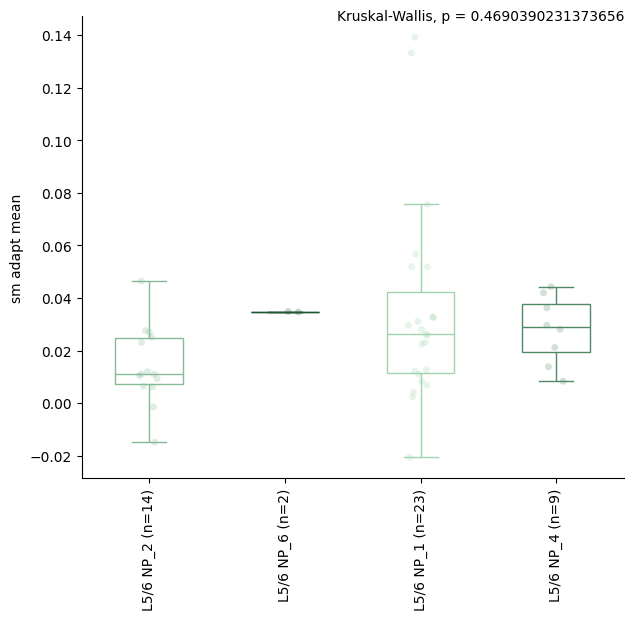

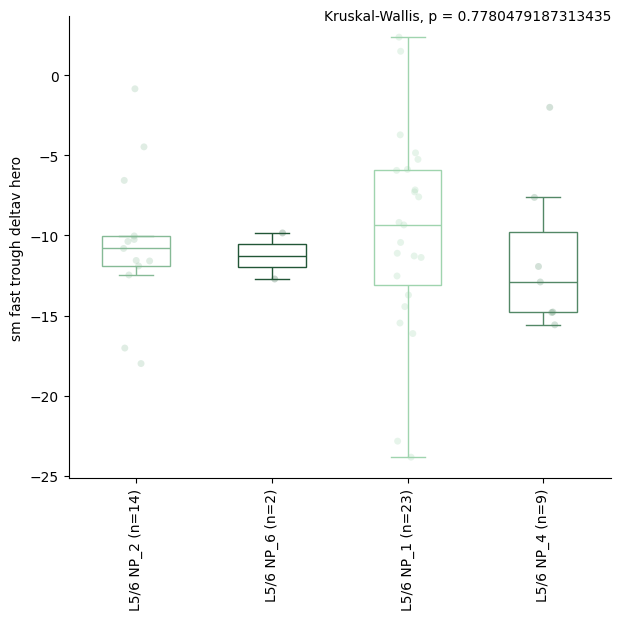

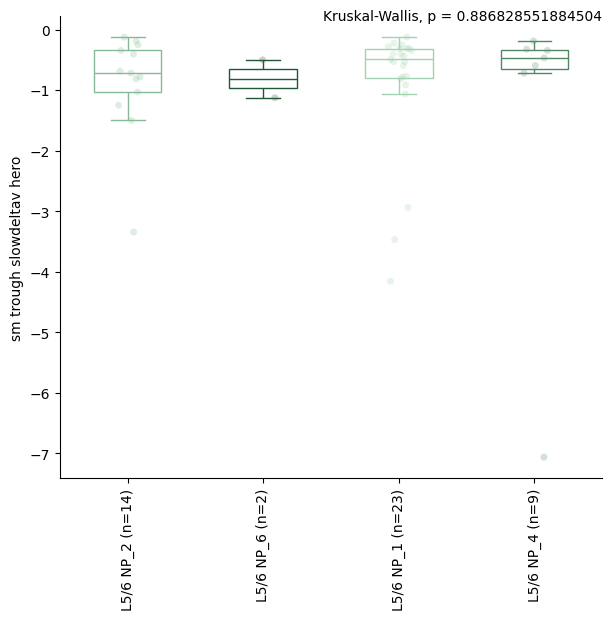

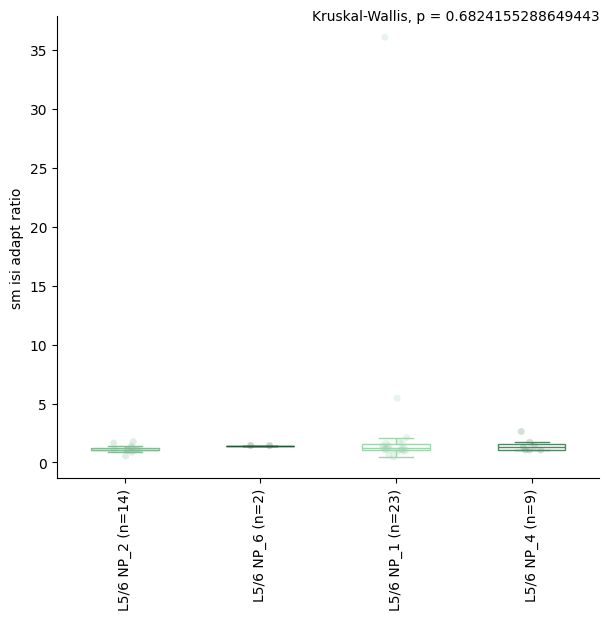

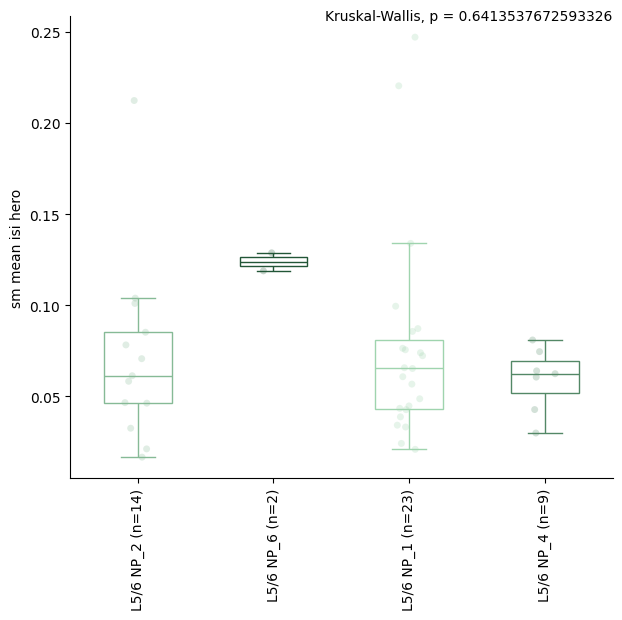

...

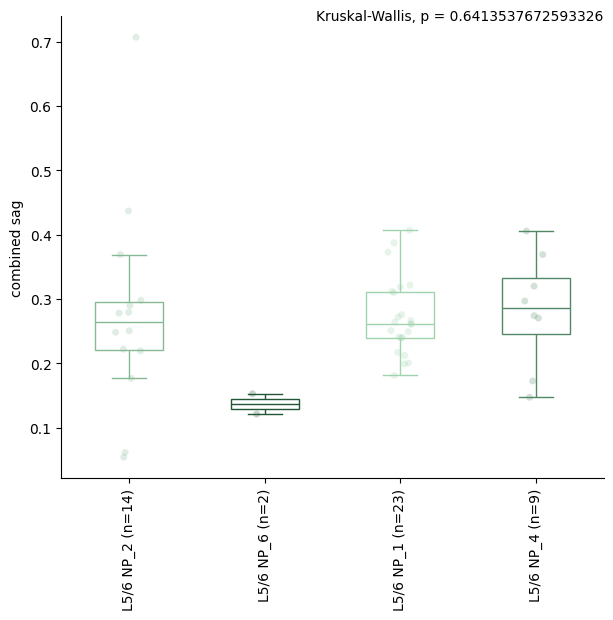

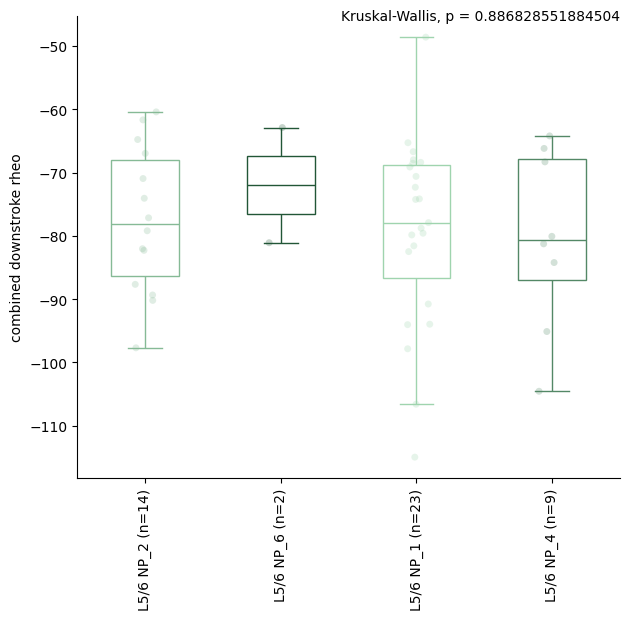

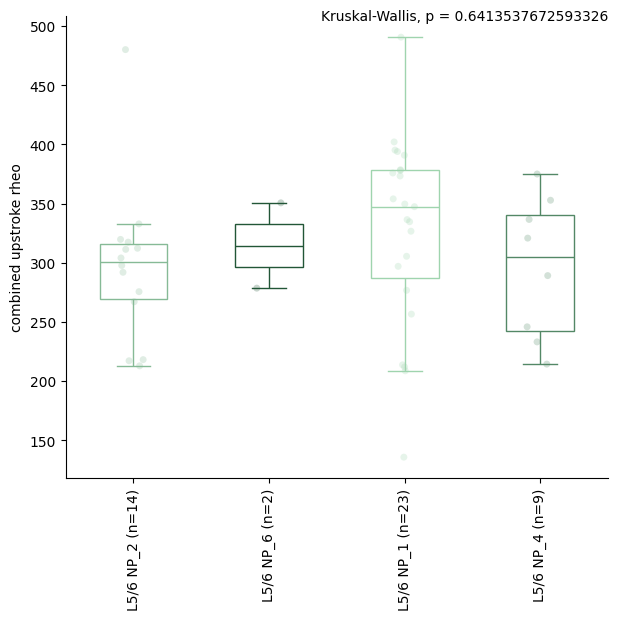

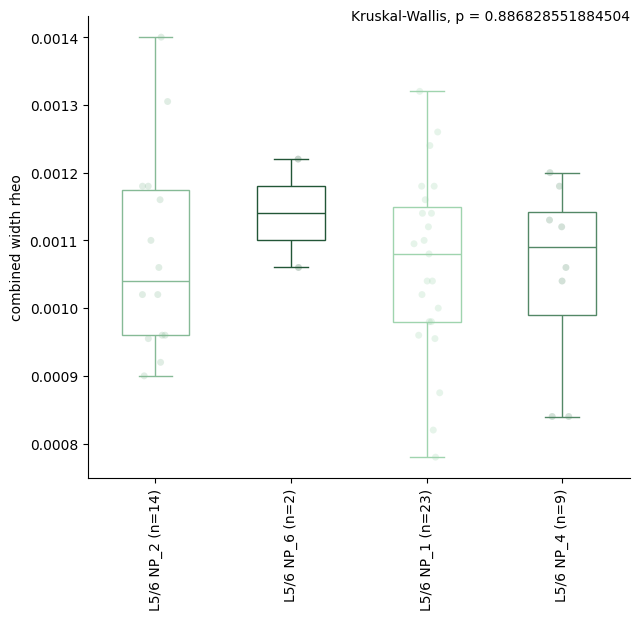

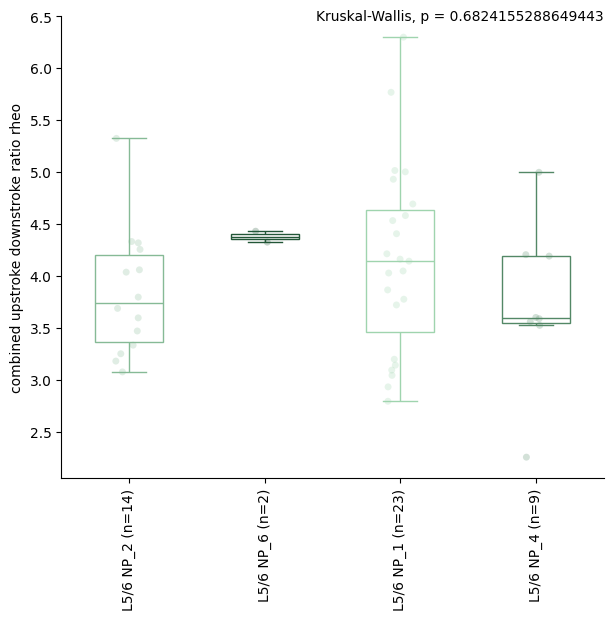

C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sar

<Figure size 640x480 with 0 Axes>

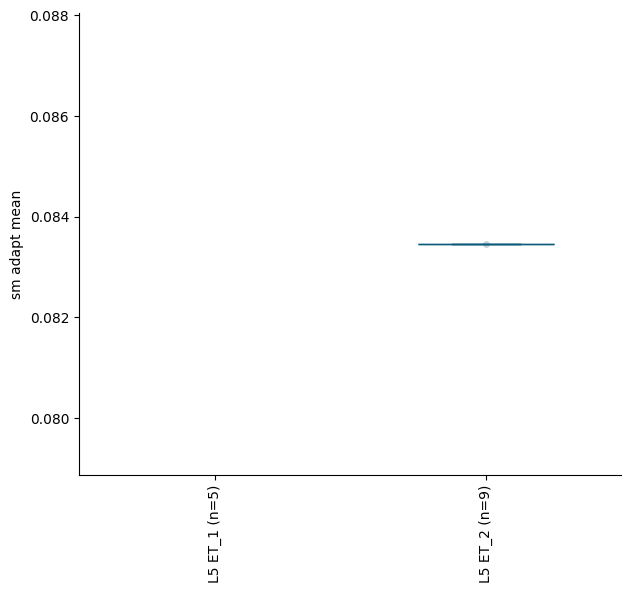

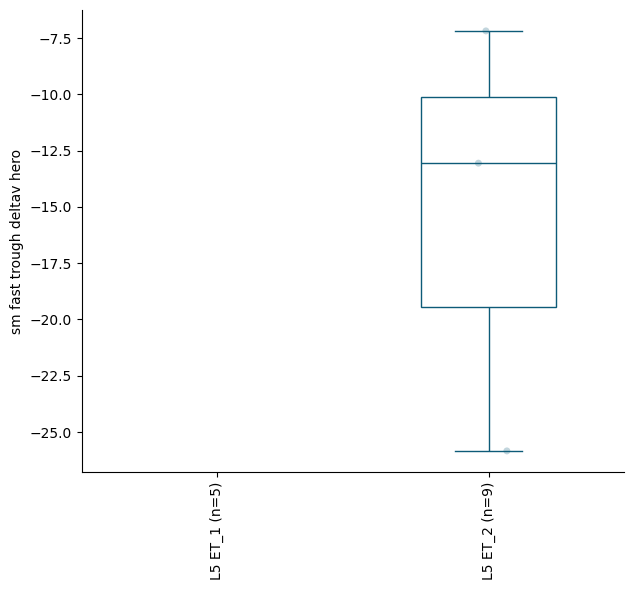

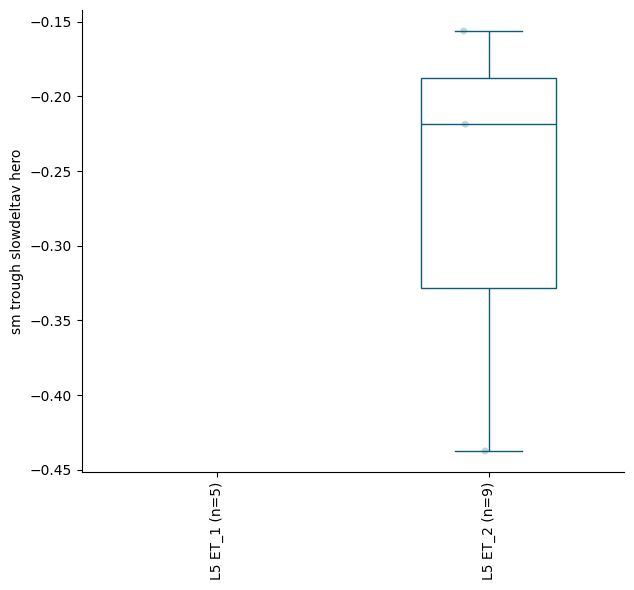

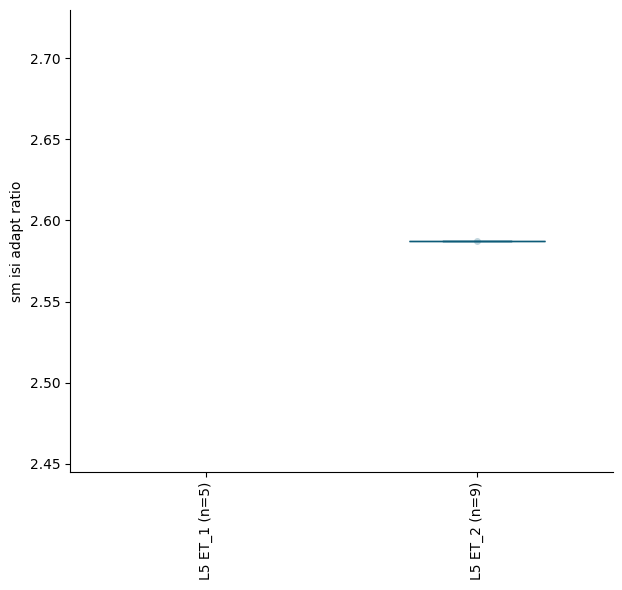

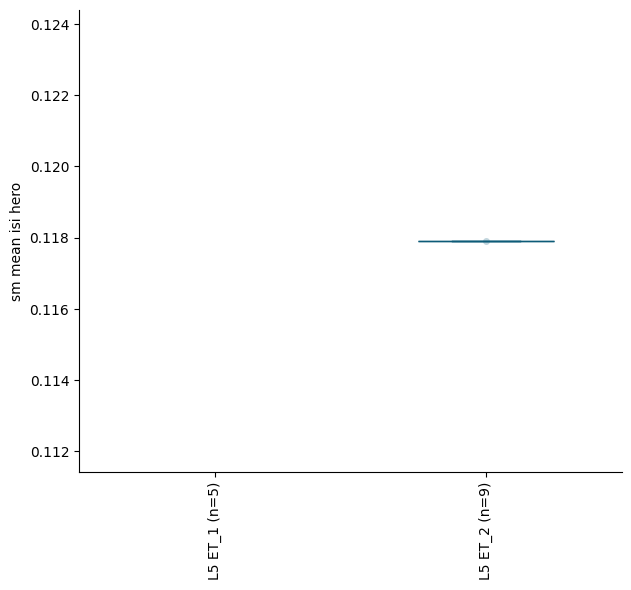

...

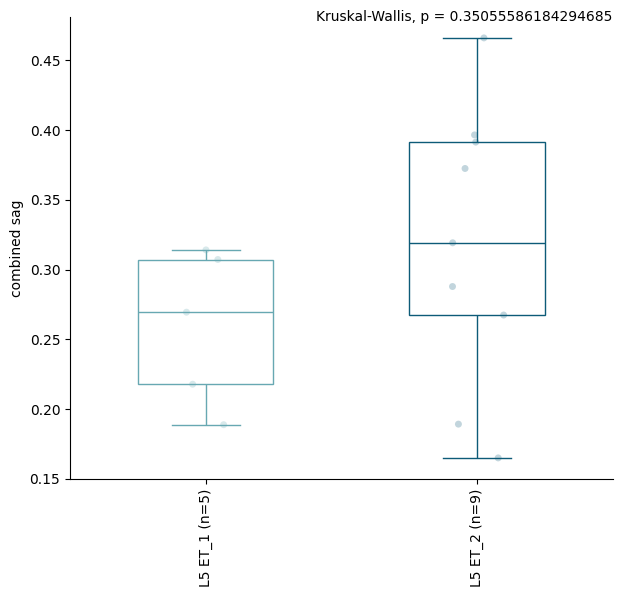

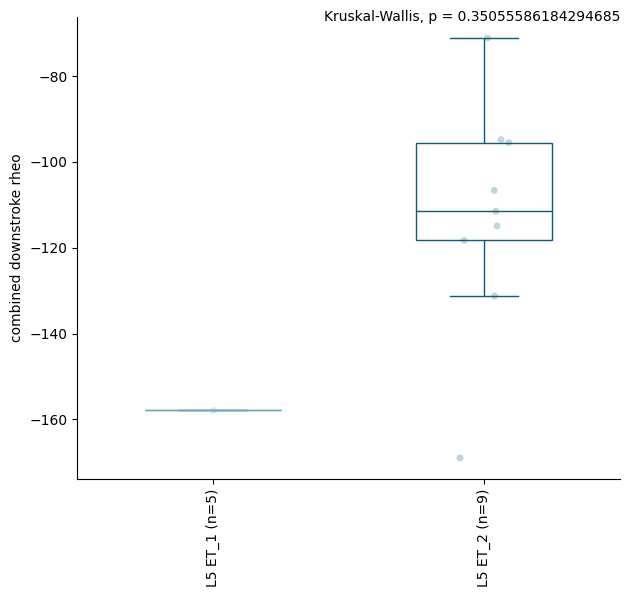

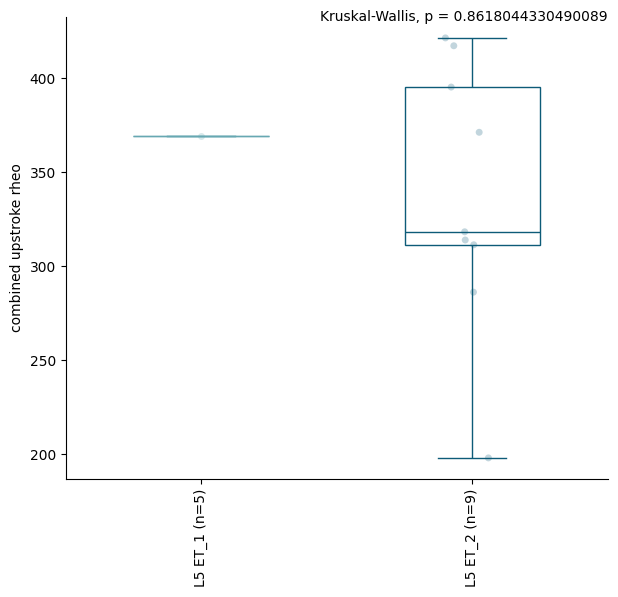

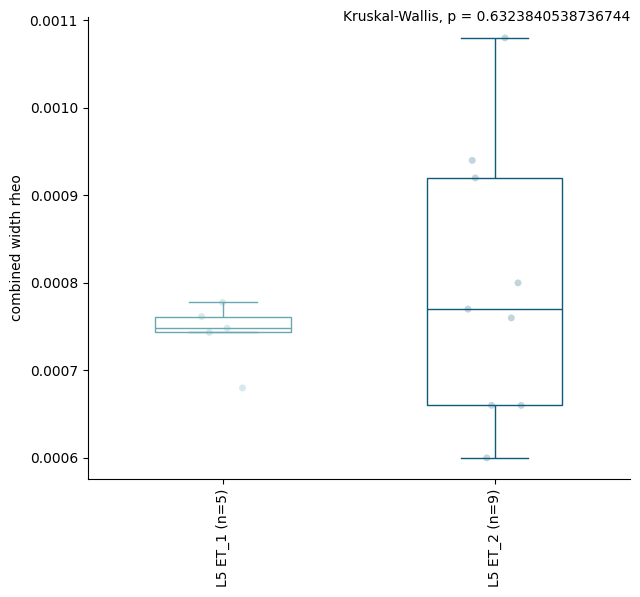

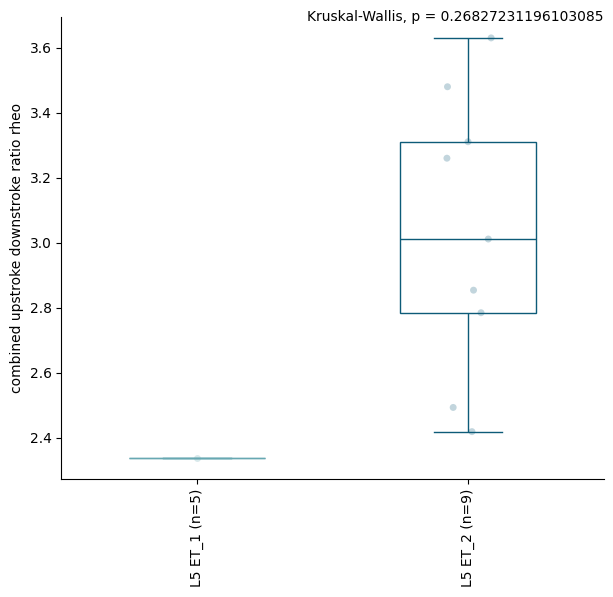

C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sar

<Figure size 640x480 with 0 Axes>

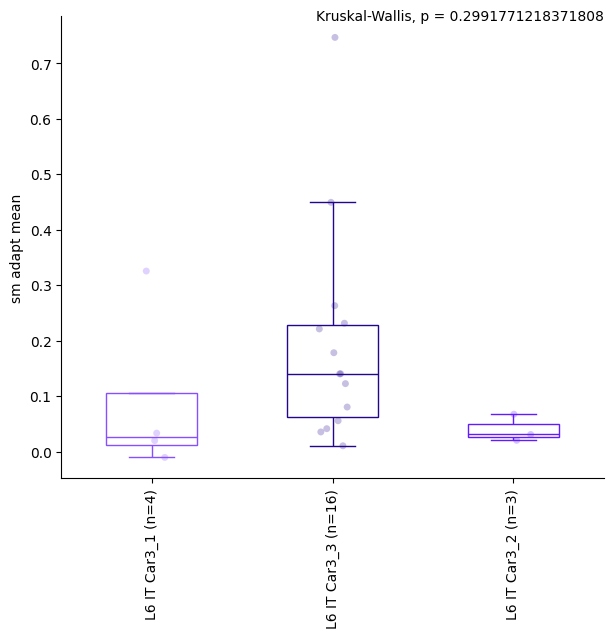

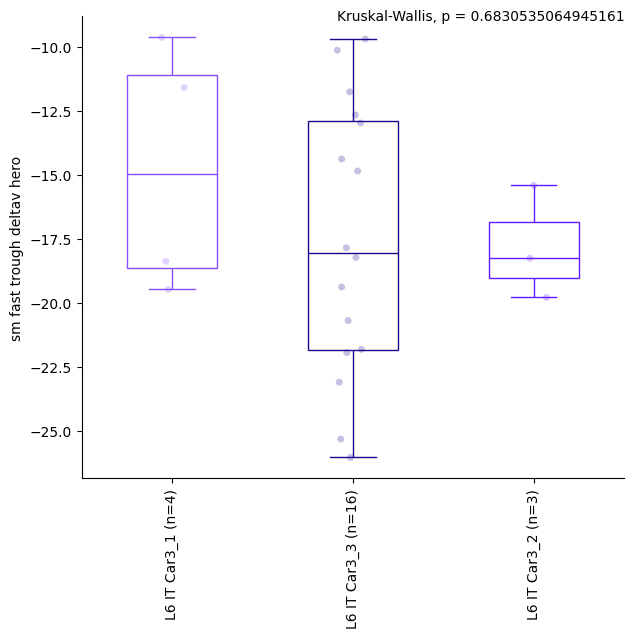

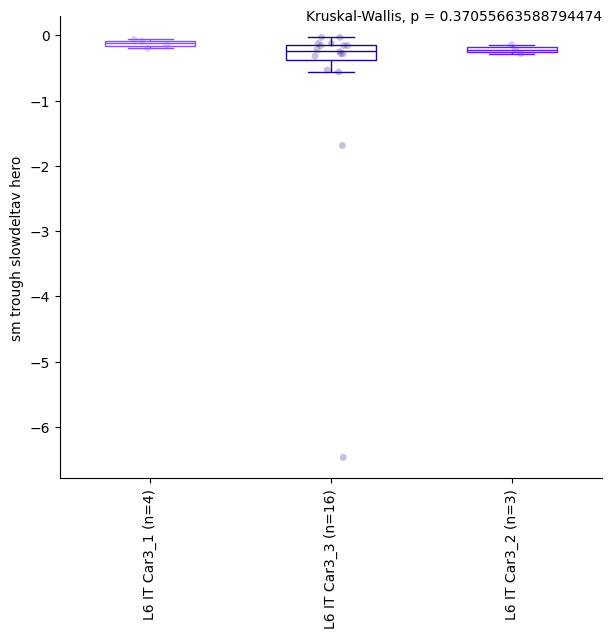

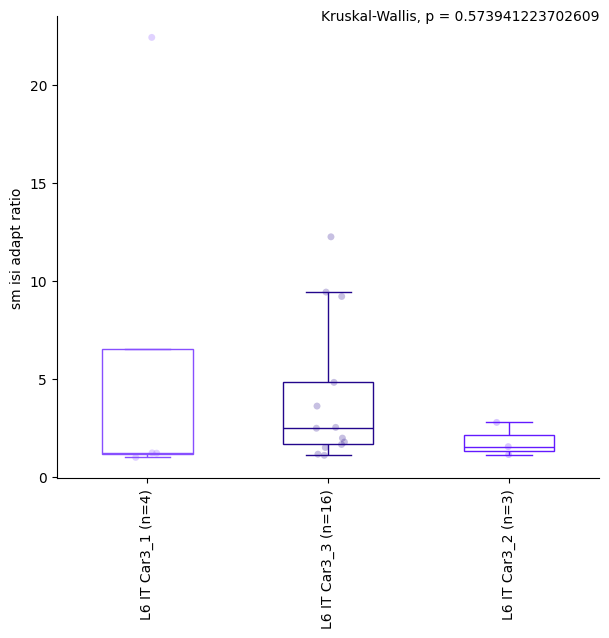

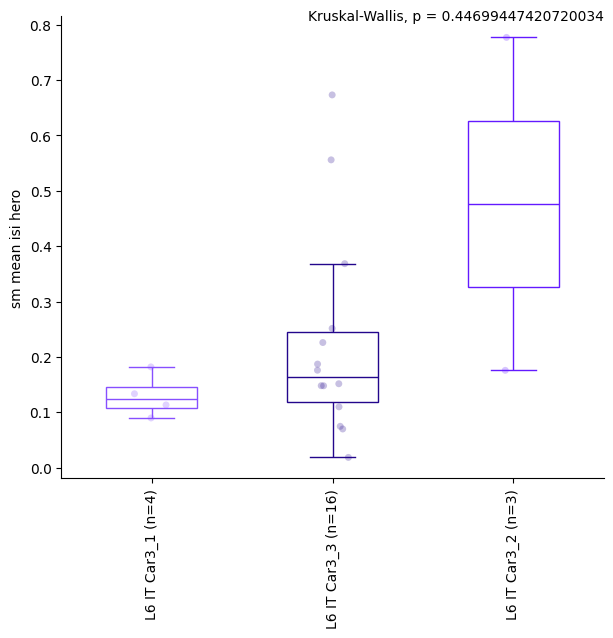

...

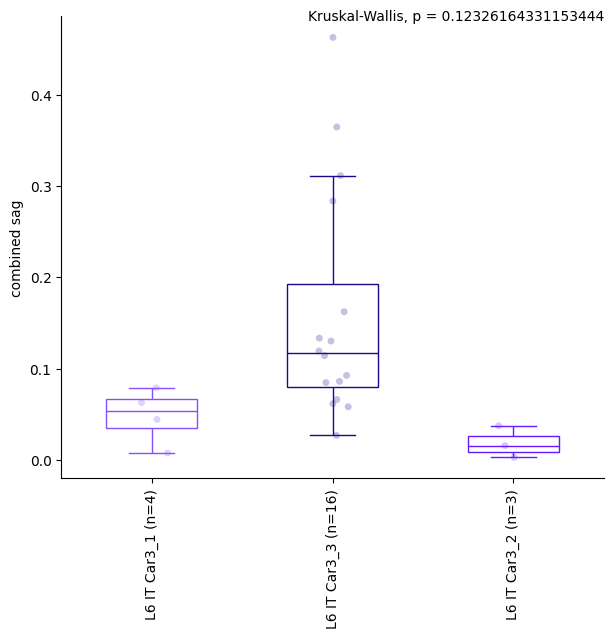

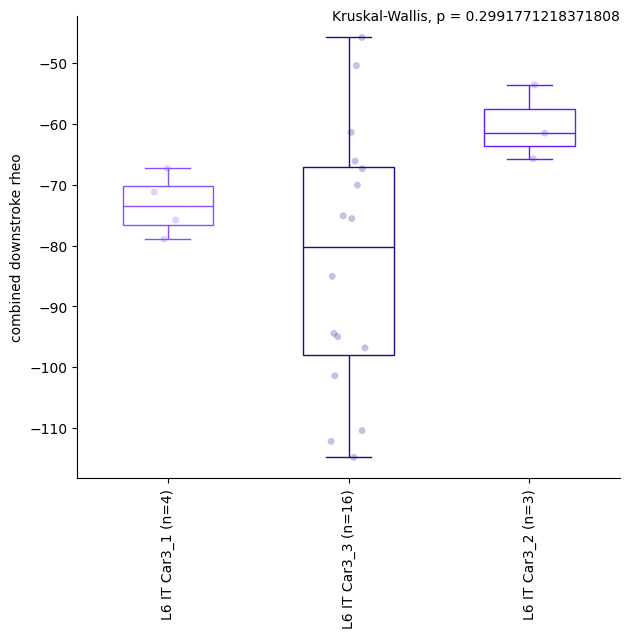

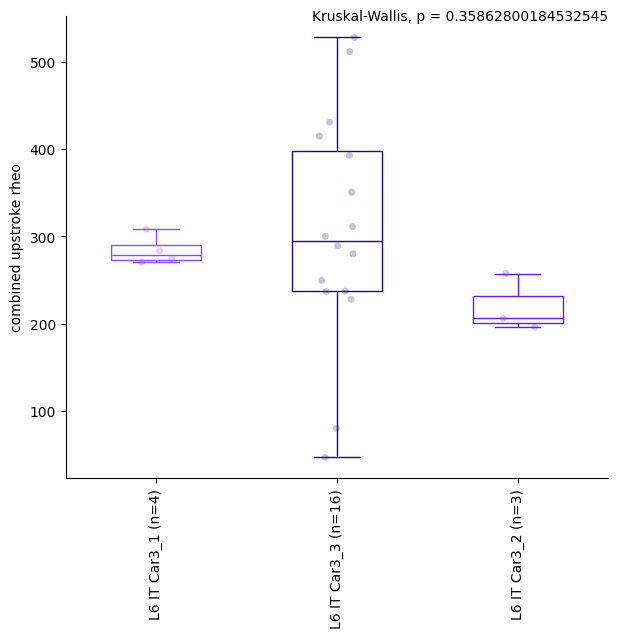

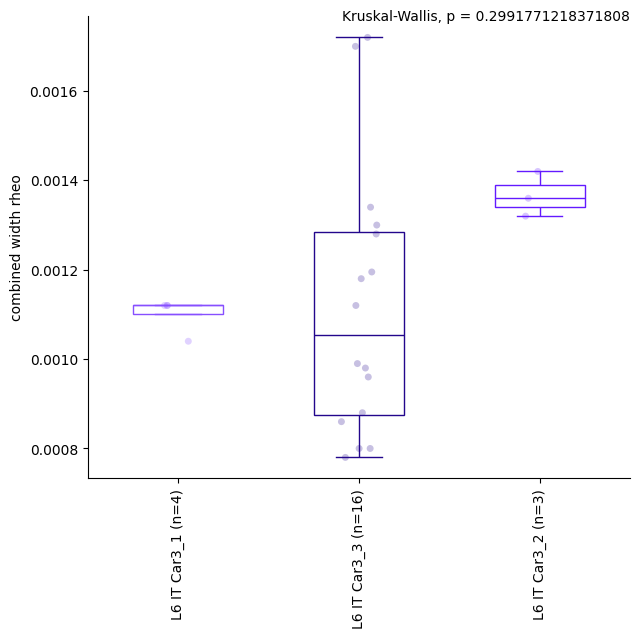

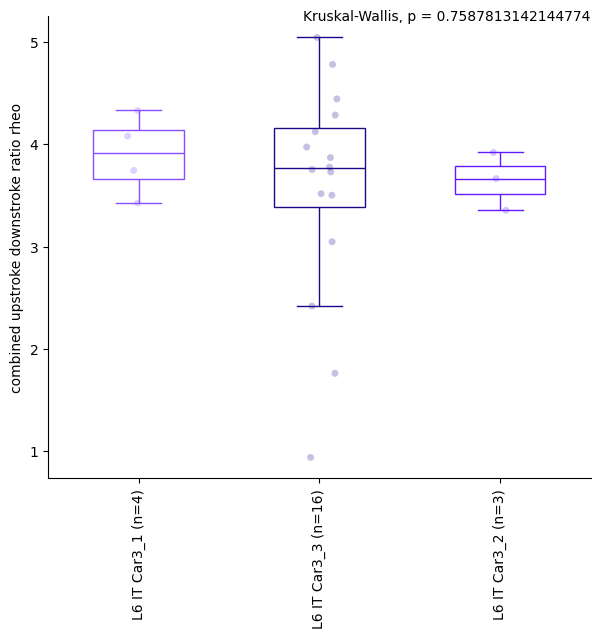

C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sar

<Figure size 640x480 with 0 Axes>

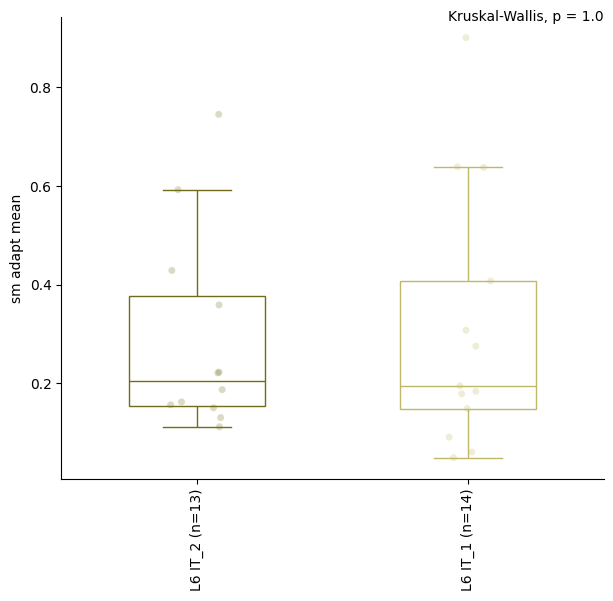

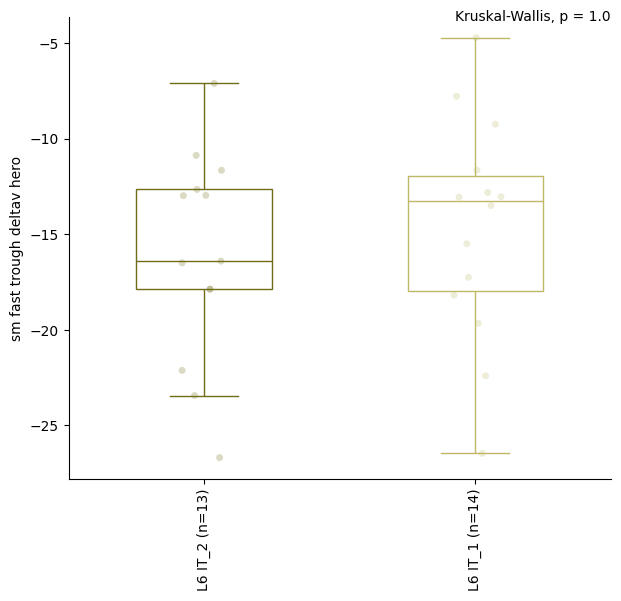

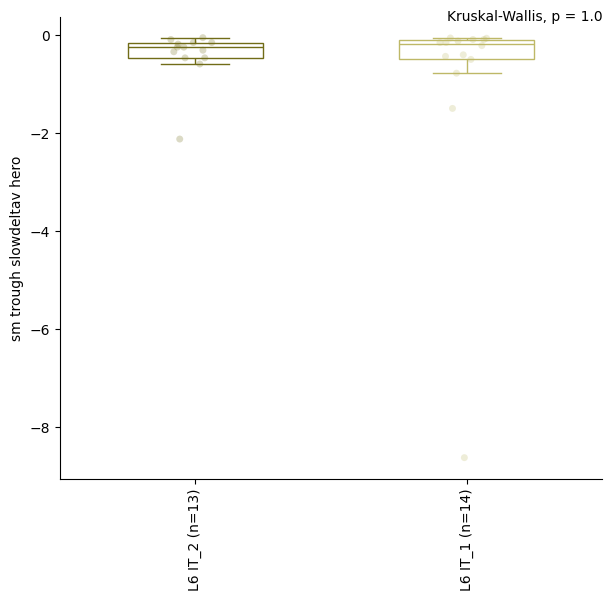

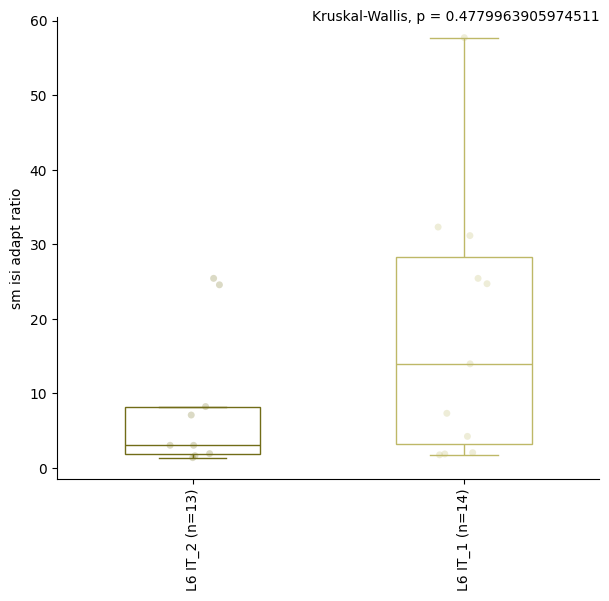

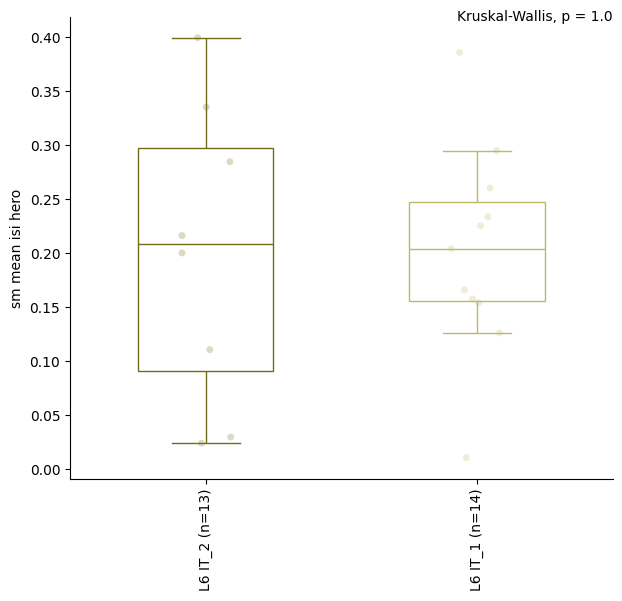

...

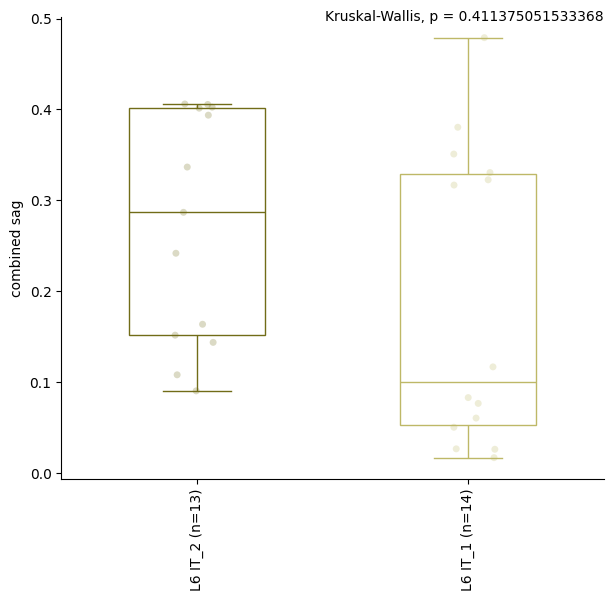

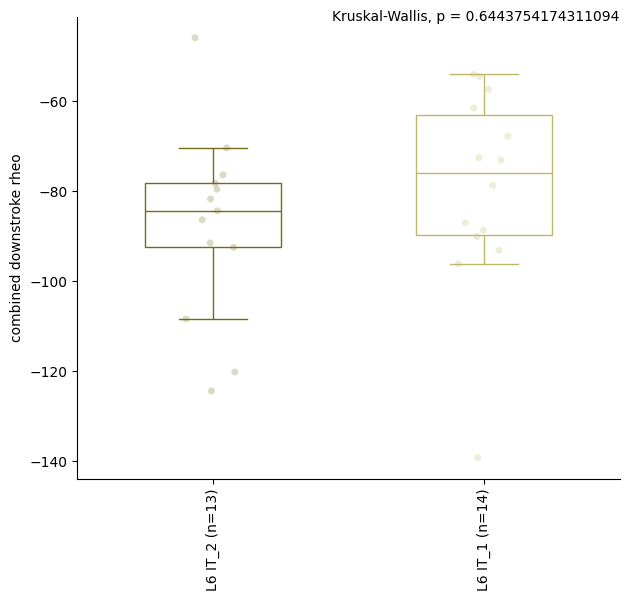

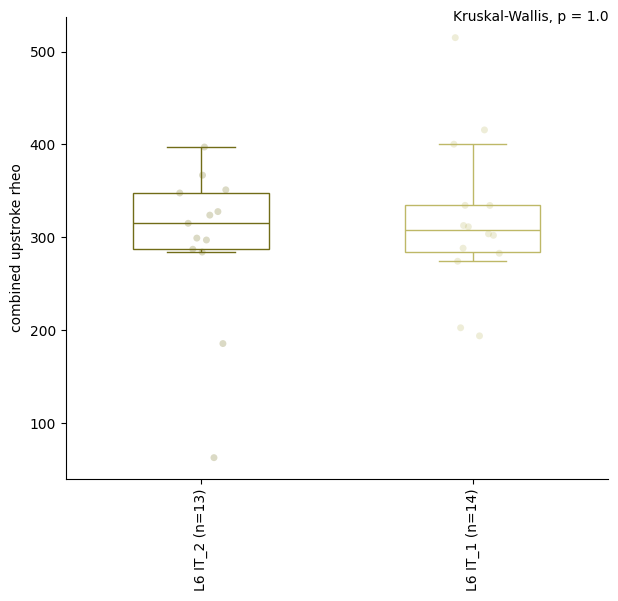

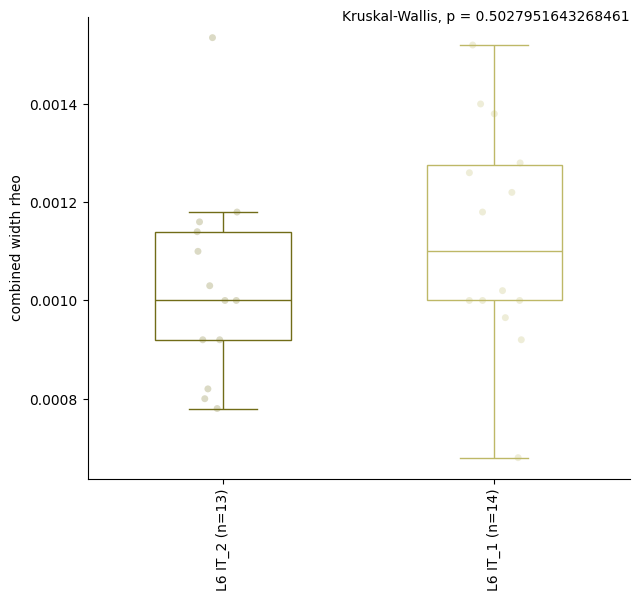

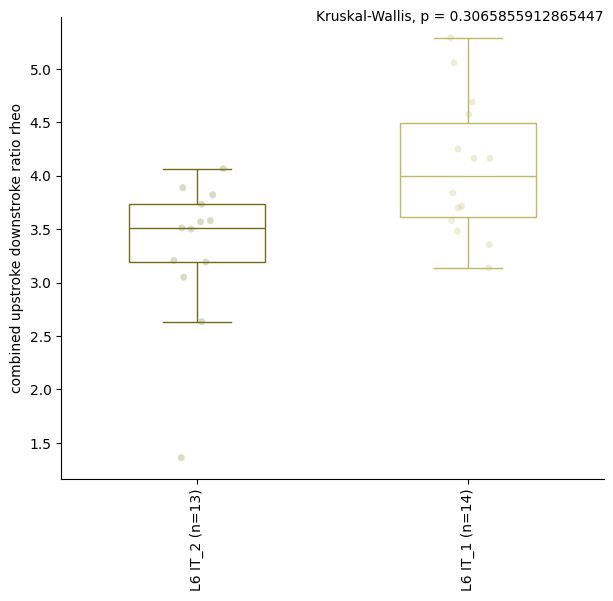

C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sar

<Figure size 640x480 with 0 Axes>

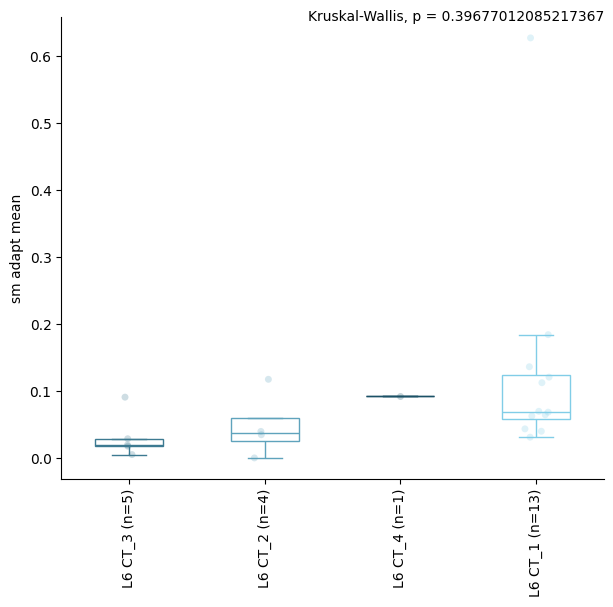

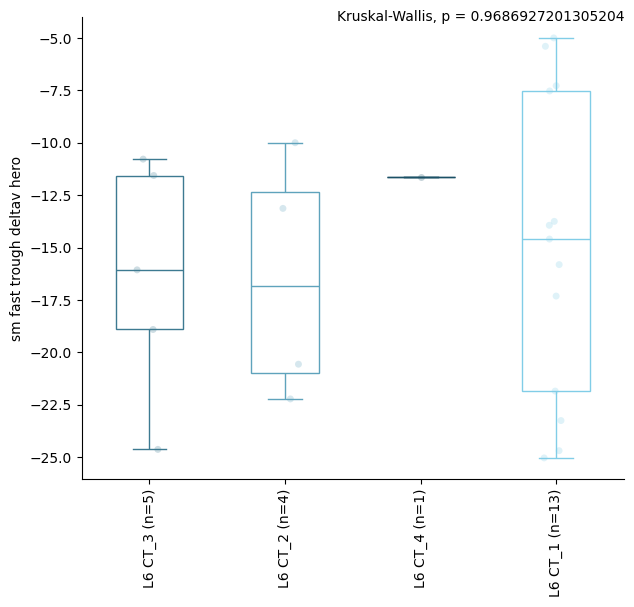

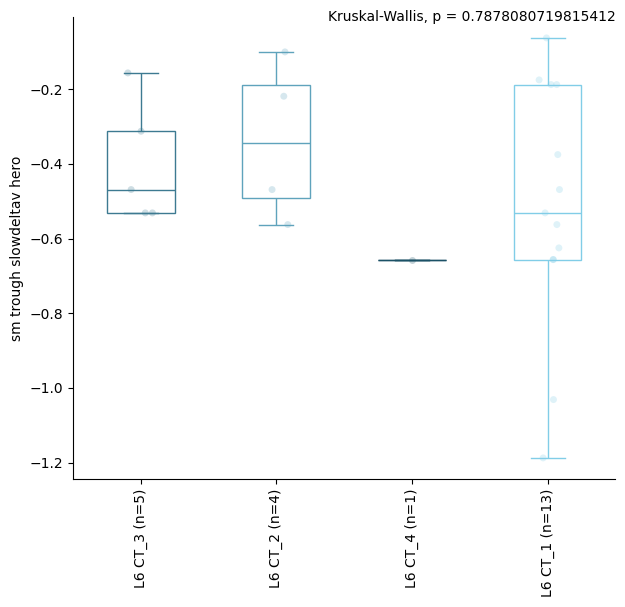

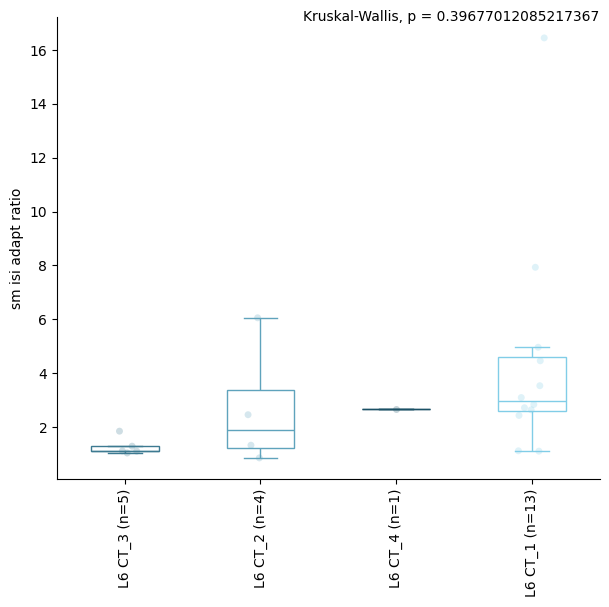

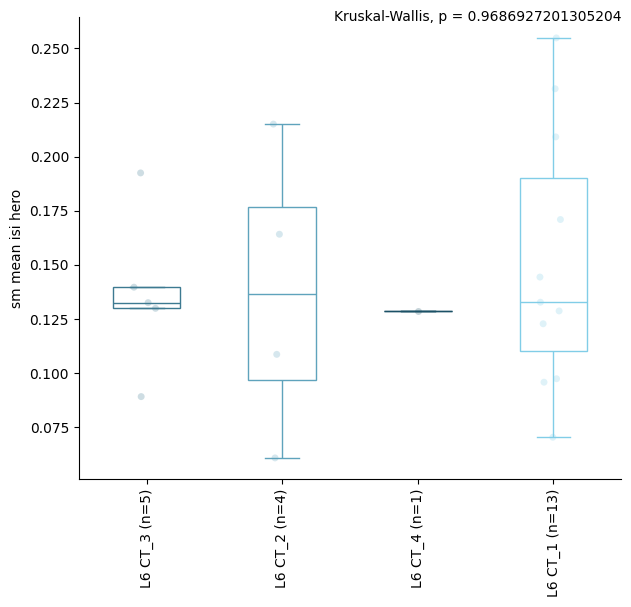

...

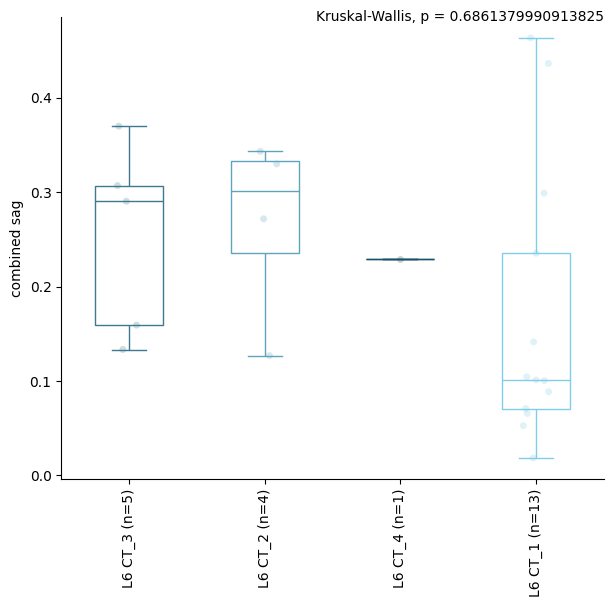

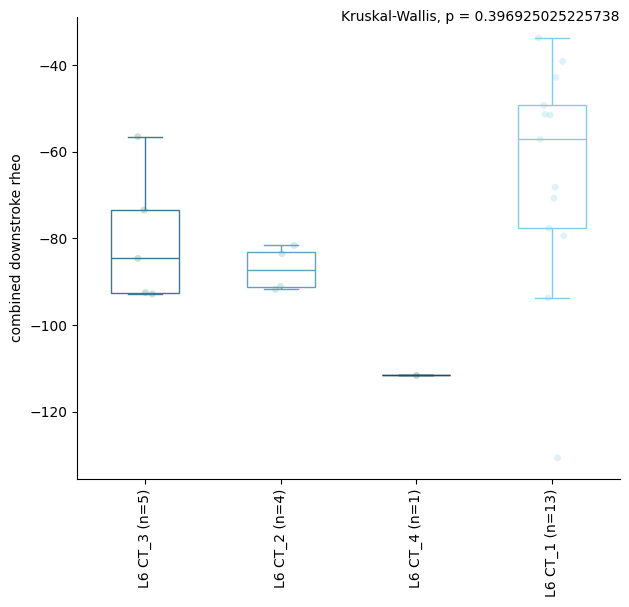

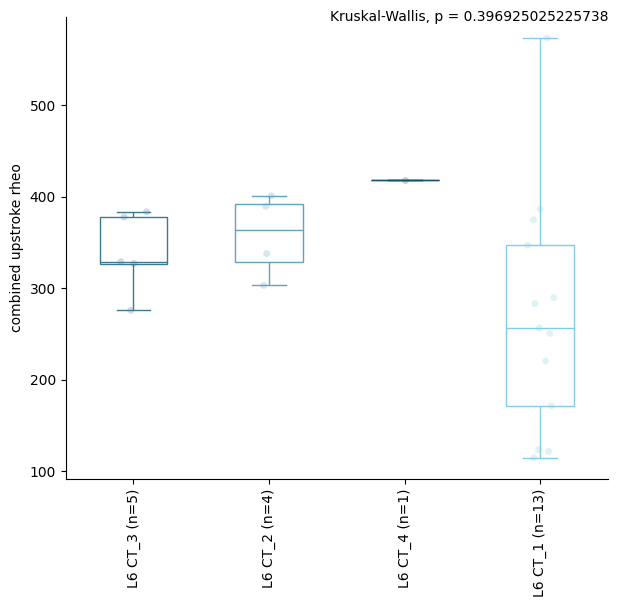

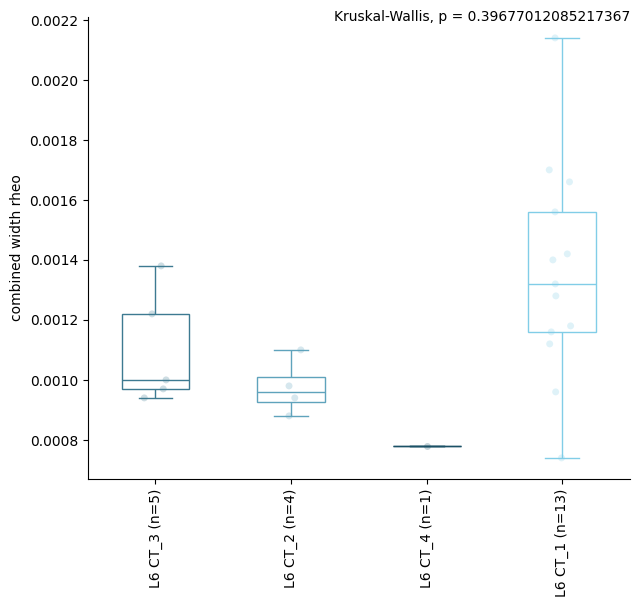

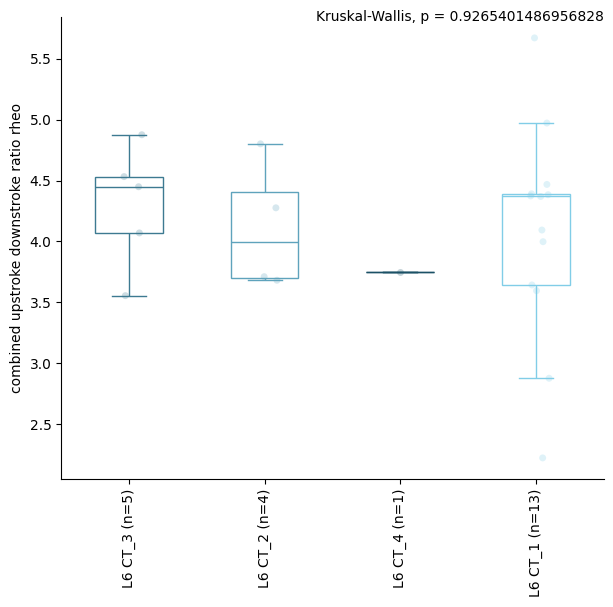

C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\578903445.py:49: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sar

<Figure size 640x480 with 0 Axes>

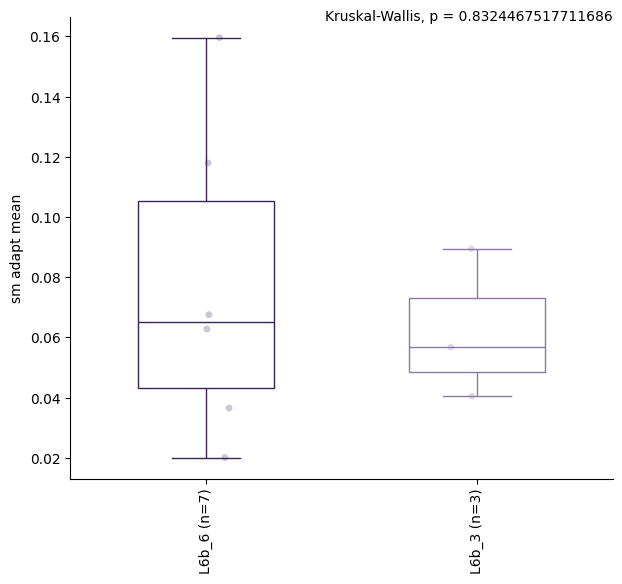

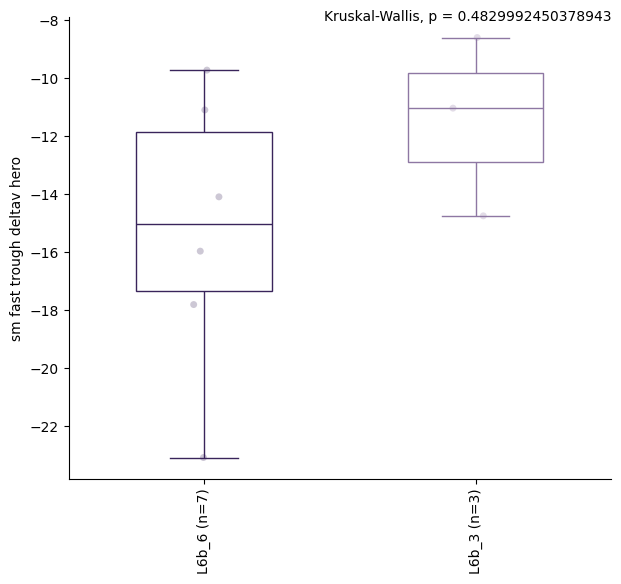

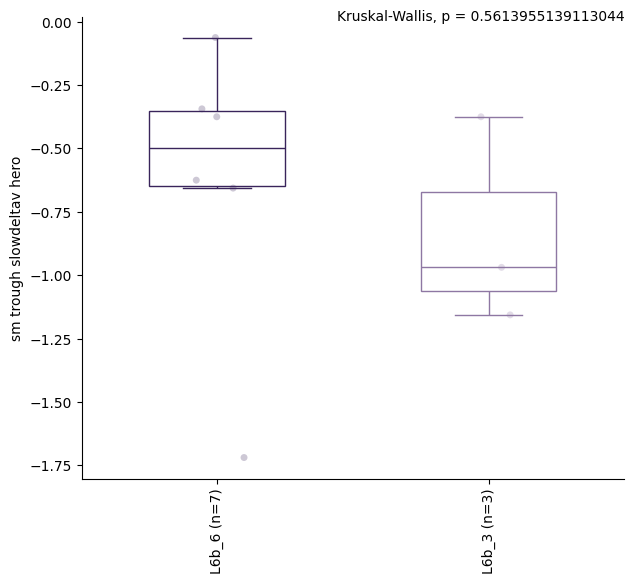

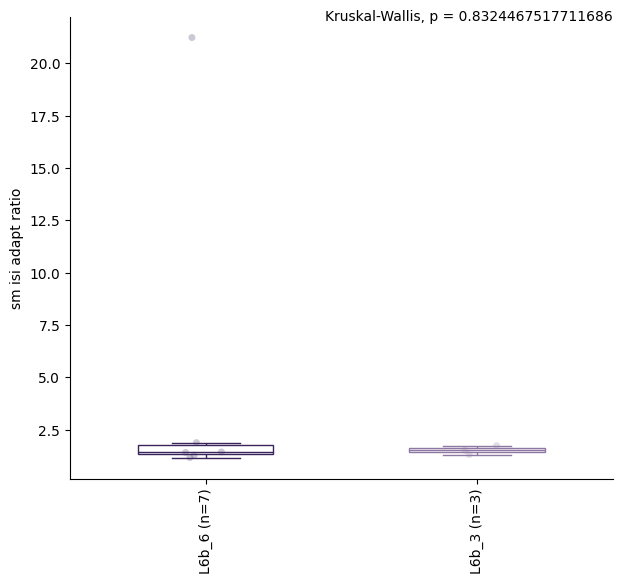

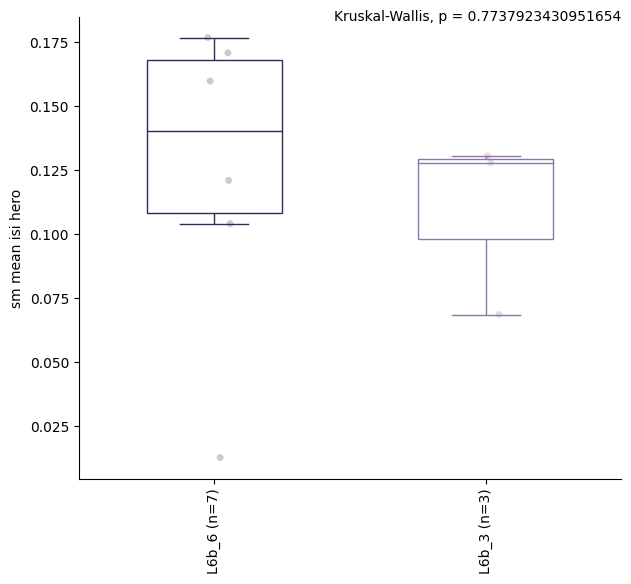

...

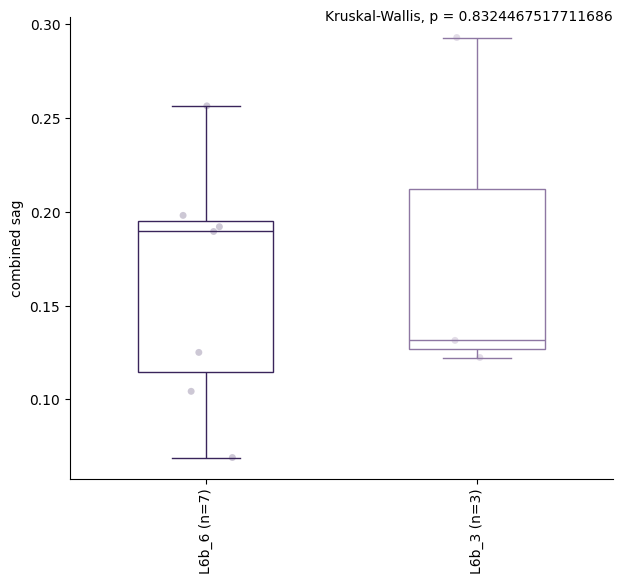

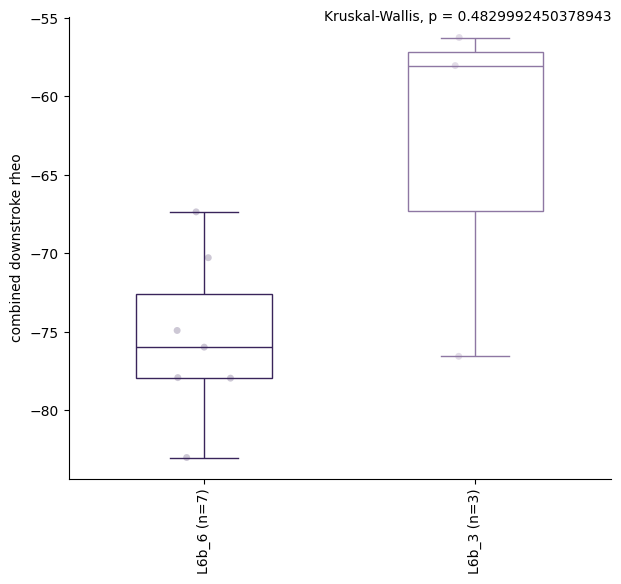

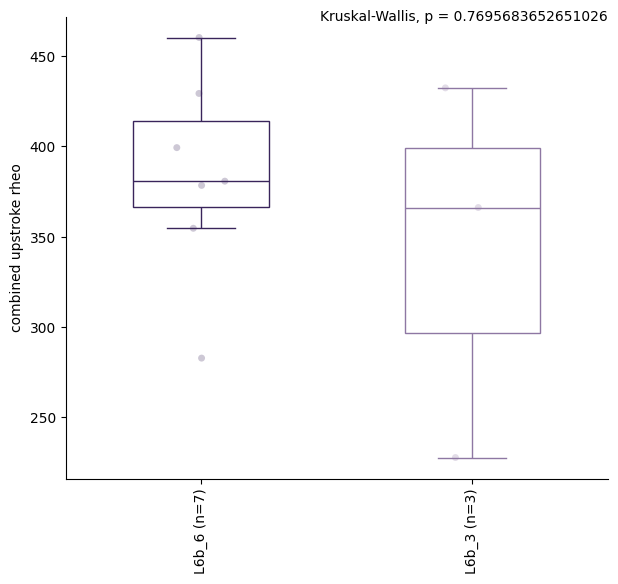

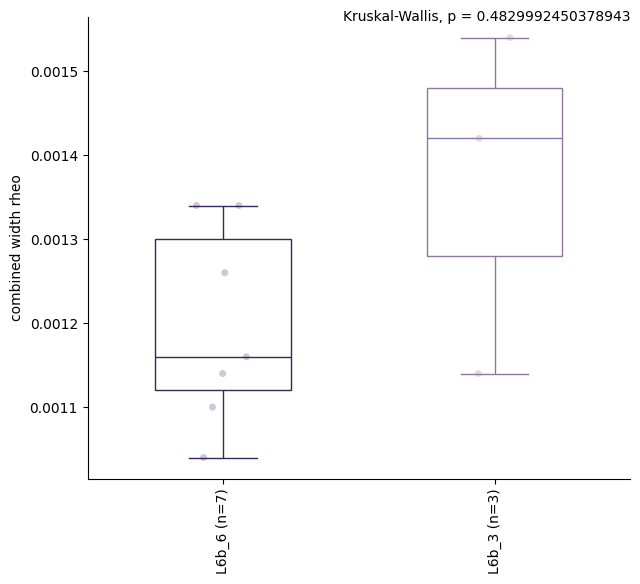

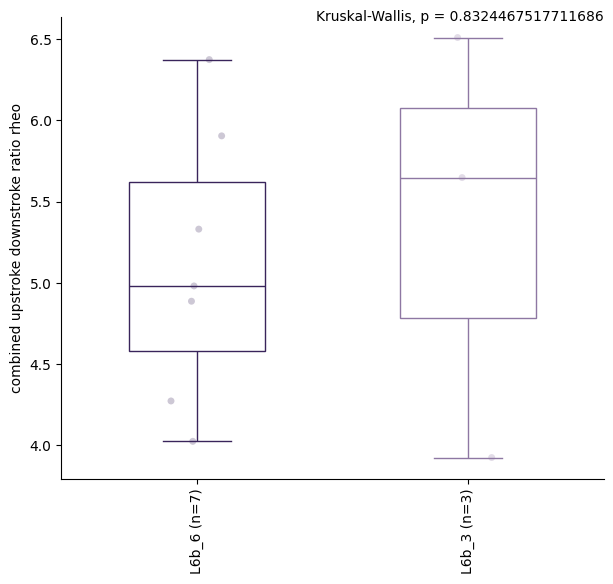

<Figure size 640x480 with 0 Axes>

In [14]:
# ttype x feature box plots

ttype_order = group_order['t_type']

for subclass in kw_pvals_fdr_subclass.keys():
    if kw_pvals_fdr_subclass[subclass]:
        #subclass has results (there were enough ttypes in the subclass, etc.)
        subclass_data = sorted_clean_data.loc[sorted_clean_data[subcalss_var] == subclass]
        kw_pvals_fdr = kw_pvals_fdr_subclass[subclass]  
        dunn_pvals_fdr = dunn_pvals_fdr_subclass[subclass]
        x_var = 't_type'  # what to do box plots on
        x_var_order = [t for t in ttype_order if t in subclass_data[x_var].unique()]

        #ADJUST VARS
        fig_name = 'human_excitatory_boxplots_ephys_features_KW_Dunn_FDR_{}_byTtype.pdf'.format(subclass.replace('/', '-').replace(' ', '_'))
        color_palette = color_dict #colors for x_var
        hue_var = 't_type' #seperate strip plots into these categories 
        hue_color_palette = color_dicts[hue_var] #color palette for hue_var
        ##### MAKE SURE TO UPDATE KRUSKAL CALL IN CODE BELOW TO CONTAIN ALL THE X_VAR GROUPS #####

        #######################

        fig_path = os.path.join(output_dir, fig_name)
        ephys_features = feature_cols.copy()

        with warnings.catch_warnings():
            warnings.simplefilter(action='ignore', category=FutureWarning)

            with PdfPages(fig_path) as pdf:
                while ephys_features != []:
                    
                    #one fig per page, each has page (fig) has 4 rows. 
                    fig, ax = plt.subplots(nrows=1,ncols=1,figsize=(7,6),sharex=True, gridspec_kw = {'wspace':0, 'hspace':0.1}) #gridspec_kw = {'wspace':0, 'hspace':0},
                    # for ax in axes: #plot as many neurons as fit on this page (num_rows rows of plotting)
                    
                    y_var = ephys_features.pop()
                    
                    sns.stripplot(data=subclass_data, x=x_var, y=y_var, ax=ax, order=x_var_order, palette=color_palette, alpha=0.25)
                    sns.boxplot(data=subclass_data, x=x_var, y=y_var, ax=ax, order=x_var_order, palette=color_palette, saturation=1, showfliers = False, width=0.5)
                    format_box_plot(ax) #color line not fill of boxplot


                    #add num observations per x_var
                    nobs = []
                    for t in x_var_order:
                        n = len(subclass_data[subclass_data[x_var] == t])
                        nobs.append(" (n=%s)" % str(n))
                    new_x_tick_labels = [x_var_order[i] + nobs[i] for i in range(len(x_var_order))]  
                    ax.set_xticklabels(new_x_tick_labels)

                    # add stats (KW w/ Dunn post hoc FDR corrected)

                    #plot signif dunn fdr p-vals 
                    if y_var in dunn_pvals_fdr.keys(): 
                        #kw fdr val was signif so there are dunn fdr vals to plot
                        
                        this_dunn_pvals_fdr = dunn_pvals_fdr[y_var]
                        remove = np.tril(np.ones(this_dunn_pvals_fdr.shape), k=0).astype("bool")
                        this_dunn_pvals_fdr[remove] = np.nan
                        dunn_pvals_fdr_melt = this_dunn_pvals_fdr.melt(ignore_index=False).reset_index().dropna()

                        #set insignificant pvals to nan 
                        p_thresh = 0.05 #threshold for plotting p vals 
                        dunn_pvals_fdr_melt.drop(dunn_pvals_fdr_melt[dunn_pvals_fdr_melt['value'] > p_thresh].index, inplace = True)

                        #plot bar for all signif fdr corrected dunn p vals 
                        pairs = [(i[1]["index"], i[1]["variable"]) for i in dunn_pvals_fdr_melt.iterrows()]
                        if len(pairs): 
                            #there's at least one pair of x_vals for which fdr corrected dunn test is signif
                            p_values = [i[1]["value"] for i in dunn_pvals_fdr_melt.iterrows()]                    
                            annotator = Annotator(ax, pairs, data=subclass_data, x=x_var, y=y_var, order=x_var_order)
                            annotator.configure(text_format="star", loc="inside") #text_format="simple"
                            annotator.set_pvalues_and_annotate(p_values)
                            
                    #plot Kruskal-Wallis fdr p-vals
                    if y_var in kw_pvals_fdr.keys():
                        xlimit = ax.get_xlim()
                        ylimit = ax.get_ylim()
                        p_txt = 'Kruskal-Wallis, p = ' + str(kw_pvals_fdr[y_var])
                        ax.text(xlimit[1], ylimit[1], p_txt, verticalalignment='center', horizontalalignment='right')

                    #rotate and format x_var labels 
                    ax.set(xlabel=None)
                    ax.tick_params(axis='x', rotation=90)
                    ax.set_ylabel(y_var.replace("_", " "), rotation=90)
                    ax.spines[['right', 'top']].set_visible(False)

                    fig.subplots_adjust(wspace=0, hspace=0.0)
                    pdf.savefig(dpi=600, bbox_inches='tight')
                plt.show()
                plt.clf()
                print()



Cross areal box plots - subclass

In [15]:
# subclass x feature box plots

x_var = 'lobe_group'
group1_label = 'TemL'
group2_label = 'Other'
group_var = 'subclass_label'

n_min_cells = 3
combo_counts = sorted_clean_data.groupby([group_var, x_var]).size().unstack(fill_value=0)
groups = combo_counts[(combo_counts >= n_min_cells).all(axis=1)].index.tolist()

# Collect p-values and stats by (subclass, feature)
mw_pvals = dict()
mw_stats = dict()

for group in groups:
    sub_data = sorted_clean_data[sorted_clean_data[group_var] == group]
    for f in feature_cols:
        group1 = sub_data[sub_data[x_var] == group1_label][f].dropna()
        group2 = sub_data[sub_data[x_var] == group2_label][f].dropna()

        if group1.empty or group2.empty:
            continue

        try:
            stat, pval = mannwhitneyu(group1, group2, alternative='two-sided')
            mw_pvals[(group, f)] = pval
            mw_stats[(group, f)] = stat
        except ValueError as e:
            print(f'Mann-Whitney failed for {group}, {f}: {e}')

# FDR correction across all tests (subclass-feature pairs)
mw_pvals_list = list(mw_pvals.values())
mw_rejected_list, mw_pvals_fdr_list = fdrcorrection(mw_pvals_list, alpha=0.05, method='indep', is_sorted=False)

mw_pvals_fdr = dict(zip(mw_pvals.keys(), mw_pvals_fdr_list))
mw_rejected = dict(zip(mw_pvals.keys(), mw_rejected_list))


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\234911206.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2/3 IT_TemL vs. L2/3 IT_Other: Custom statistical test, P_val:7.120e-03


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\234911206.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2/3 IT_TemL vs. L2/3 IT_Other: Custom statistical test, P_val:1.241e-02
L6 IT_TemL vs. L6 IT_Other: Custom statistical test, P_val:2.800e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\234911206.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\234911206.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2/3 IT_TemL vs. L2/3 IT_Other: Custom statistical test, P_val:4.388e-02
L6 IT_TemL vs. L6 IT_Other: Custom statistical test, P_val:2.088e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\234911206.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L4 IT_TemL vs. L4 IT_Other: Custom statistical test, P_val:1.396e-02
L2/3 IT_TemL vs. L2/3 IT_Other: Custom statistical test, P_val:1.881e-09
L5 IT_TemL vs. L5 IT_Other: Custom statistical test, P_val:2.364e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\234911206.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\234911206.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\234911206.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2/3 IT_TemL vs. L2/3 IT_Other: Custom statistical test, P_val:7.120e-03


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\234911206.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\234911206.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\234911206.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\234911206.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sar

p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L4 IT_TemL vs. L4 IT_Other: Custom statistical test, P_val:6.945e-03


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\234911206.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\234911206.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\234911206.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\234911206.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2/3 IT_TemL vs. L2/3 IT_Other: Custom statistical test, P_val:5.612e-05


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\234911206.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L4 IT_TemL vs. L4 IT_Other: Custom statistical test, P_val:4.966e-03


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\234911206.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L4 IT_TemL vs. L4 IT_Other: Custom statistical test, P_val:1.992e-04


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\234911206.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L4 IT_TemL vs. L4 IT_Other: Custom statistical test, P_val:2.800e-02
L6 IT_TemL vs. L6 IT_Other: Custom statistical test, P_val:2.515e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\234911206.py:19: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(nrows=1,ncols=1,figsize=(7,6),sharex=True, gridspec_kw = {'wspace':0, 'hspace':0.1}) #gridspec_kw = {'wspace':0, 'hspace':0},
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\234911206.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\234911206.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  a

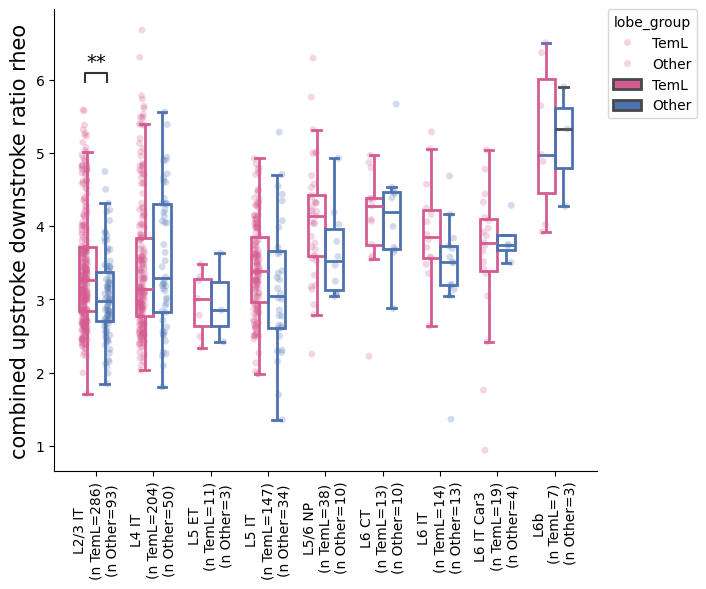

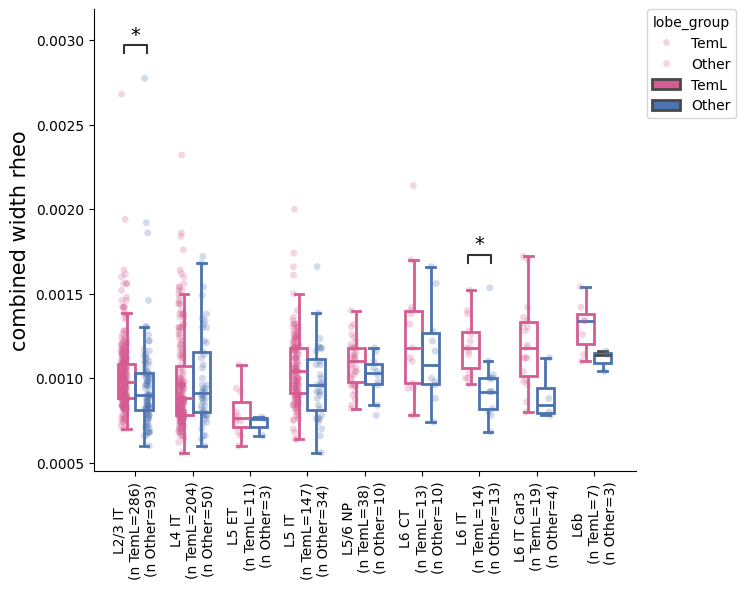

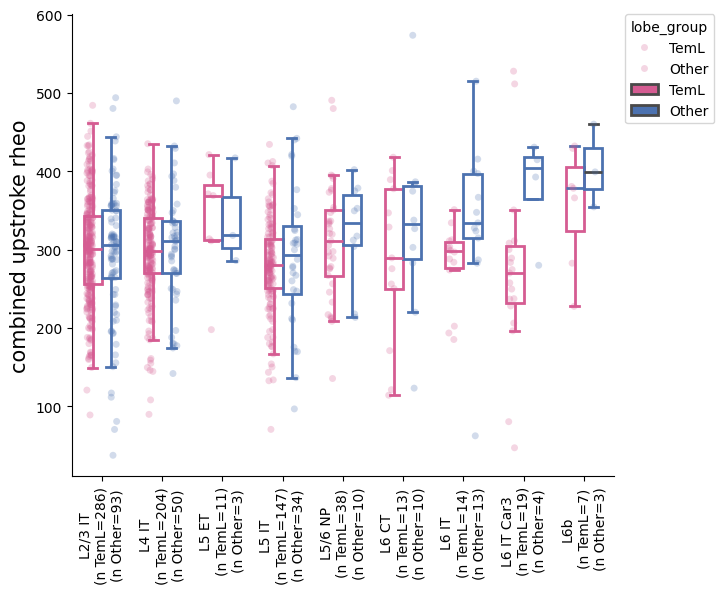

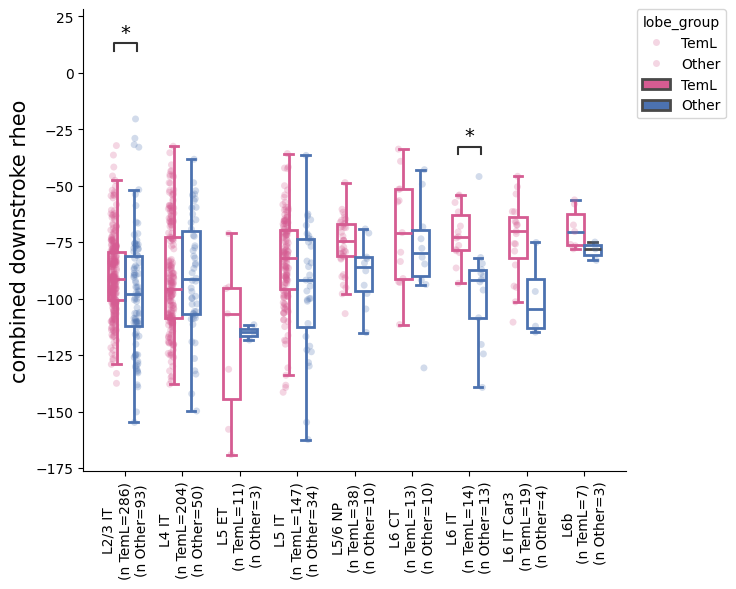

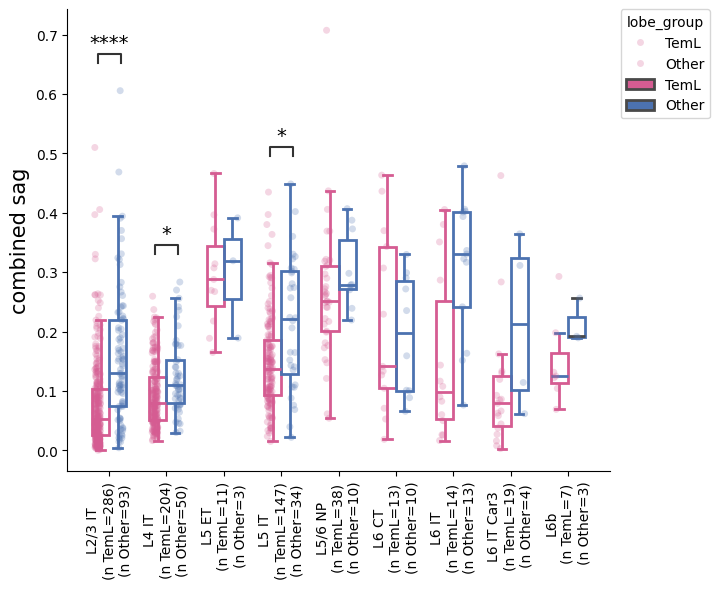

...

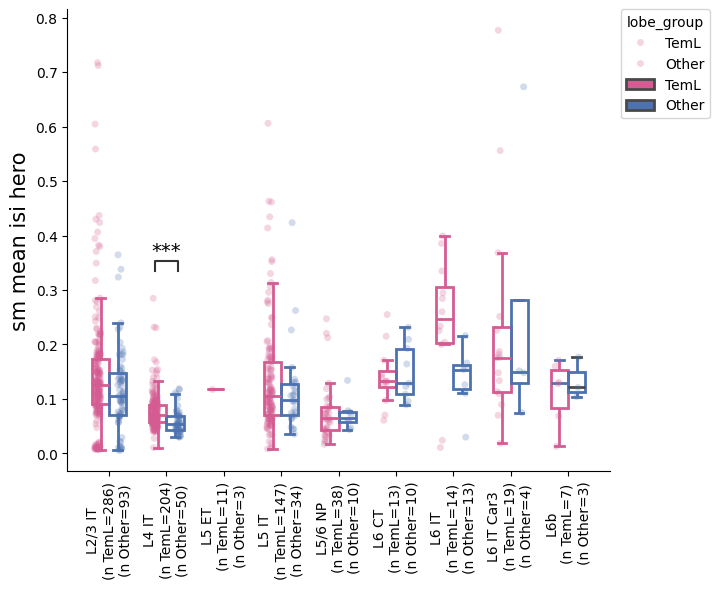

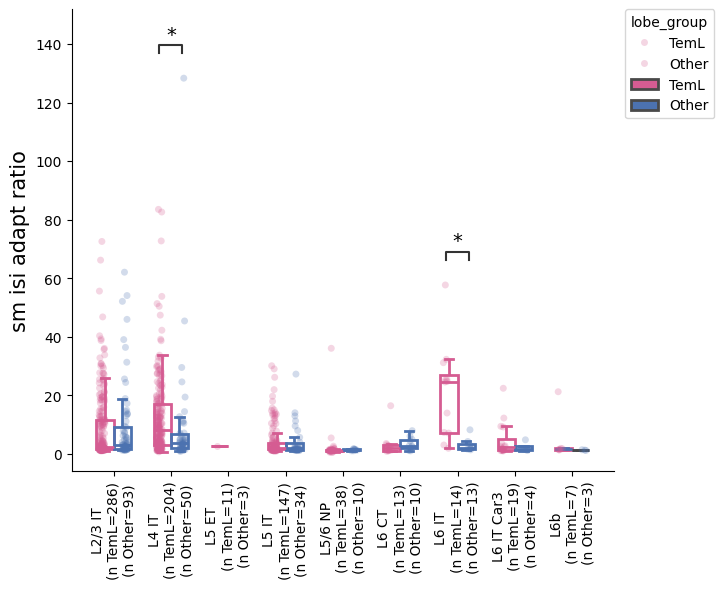

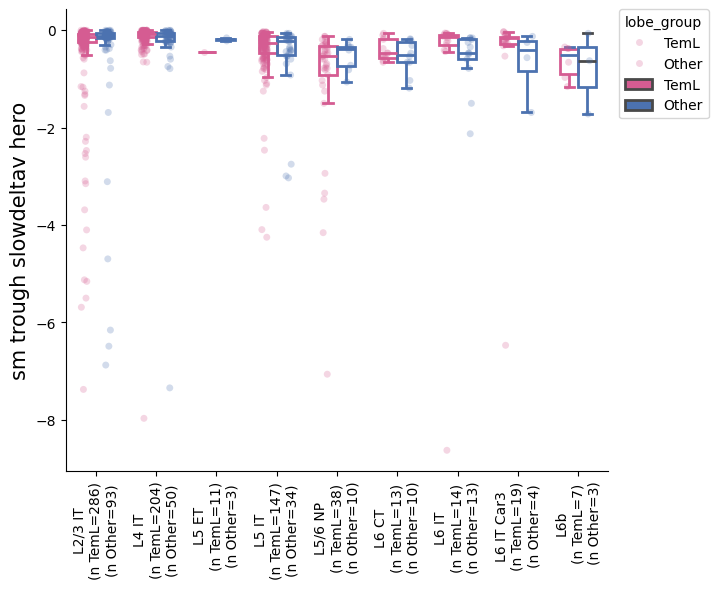

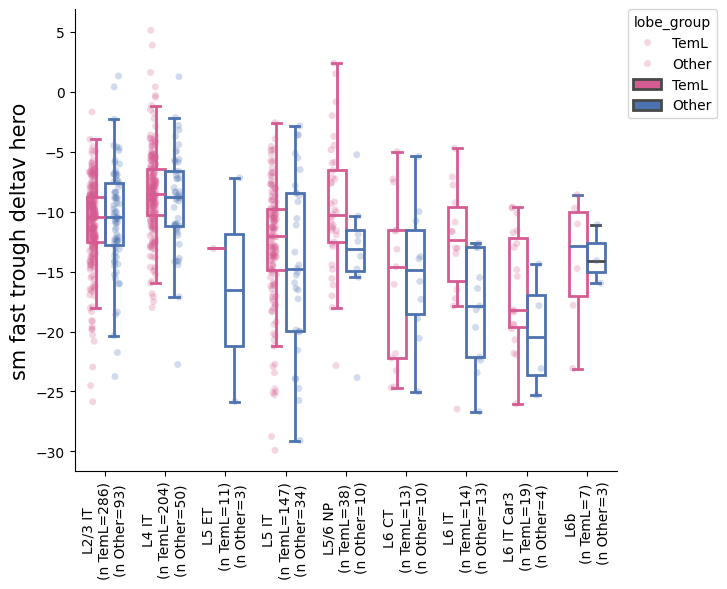

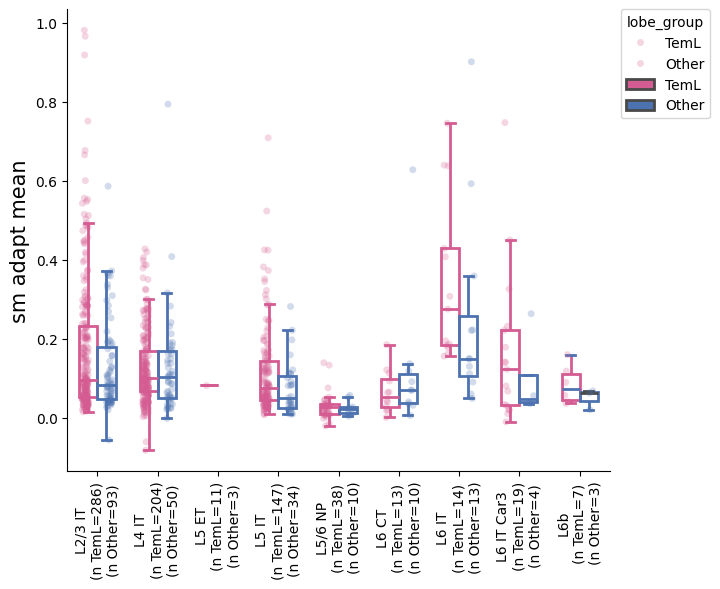

Boxplots with Mann-Whitney U stats saved.


In [16]:
# subclass x feature box plots
fig_name = 'human_excitatory_boxplots_ephys_features_lobe_MWU_FDR_bySubclass.pdf'

x_var = 'subclass_label'
hue_var = 'lobe_group'
x_order = groups #sorted_clean_data[x_var].unique().tolist()
hue_order = ['TemL', 'Other']
color_palette = color_dicts[hue_var]

fig_path = os.path.join(output_dir, fig_name)
ephys_features = feature_cols.copy()

with warnings.catch_warnings():
    warnings.simplefilter(action='ignore', category=FutureWarning)

    with PdfPages(fig_path) as pdf:
        for y_var in ephys_features:
            # fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(7, 6), sharex=True)
            fig, ax = plt.subplots(nrows=1,ncols=1,figsize=(7,6),sharex=True, gridspec_kw = {'wspace':0, 'hspace':0.1}) #gridspec_kw = {'wspace':0, 'hspace':0},

            # sns.set_context('poster')
            strip = sns.stripplot(data=sorted_clean_data, x=x_var, y=y_var, hue=hue_var, palette=color_palette, order=x_order, alpha=0.25, dodge=True, size=5)
            sns.boxplot(data=sorted_clean_data, x=x_var, y=y_var, hue=hue_var, palette=color_palette, order=x_order, saturation=1, linewidth=2, width=0.6, showfliers = False)

            #format 
            format_box_plot(ax) #clear fill of box plots, color edges
            sns.despine(right=True, top=True)

            ax.set_xlabel("")
            ax.set_ylabel(y_var.replace("_", " "), rotation=90, size=15)
            
            ax.legend_.remove()
            handles, labels = strip.get_legend_handles_labels()
            ax.legend(handles, labels, title=hue_var, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)

            #add num observations per x_var
            nobs = []
            for s in x_order:
                nT = len(sorted_clean_data[(sorted_clean_data[x_var] == s) & (sorted_clean_data[hue_var] == 'TemL')])
                nO = len(sorted_clean_data[(sorted_clean_data[x_var] == s) & (sorted_clean_data[hue_var] == 'Other')])
                nobs.append("\n(n TemL={})\n(n Other={})".format(nT, nO))
            new_x_tick_labels = [x_order[i] + nobs[i] for i in range(len(x_order))]  
            ax.set_xticklabels(new_x_tick_labels)
            ax.tick_params(axis='x', rotation=90, labelsize=10)

            # Annotate p-values
            pairs = []
            p_values = []
            for subclass in x_order:
                key = (subclass, y_var)
                if key in mw_pvals_fdr:
                    pval = mw_pvals_fdr[key]
                    sig = mw_rejected.get(key, False)
                    if sig:
                        pairs.append([(subclass, 'TemL'), (subclass, 'Other')])  # or vice versa
                        p_values.append(pval)

            # Only annotate if there are significant results
            if pairs:
                annotator = Annotator(ax, pairs, data=sorted_clean_data, x=x_var, y=y_var, hue=hue_var, order=x_order)
                annotator.configure(text_format="star", loc="inside", fontsize=14)
                annotator.set_pvalues_and_annotate(p_values)

            # fig.tight_layout()
            pdf.savefig(dpi=600, bbox_inches='tight')
        plt.show()
        plt.clf

    print("Boxplots with Mann-Whitney U stats saved.")


Cross areal box plots - ttype 

In [17]:
# ttype x feature box plots

x_var = 'lobe_group'
group1_label = 'TemL'
group2_label = 'Other'
group_var = 't_type'

n_min_cells = 3
combo_counts = sorted_clean_data.groupby([group_var, x_var]).size().unstack(fill_value=0)
groups = combo_counts[(combo_counts >= n_min_cells).all(axis=1)].index.tolist()


# Collect p-values and stats by (ttype, feature)
mw_pvals = dict()
mw_stats = dict()

for group in groups:
    sub_data = sorted_clean_data[sorted_clean_data[group_var] == group]
    for f in feature_cols:
        group1 = sub_data[sub_data[x_var] == group1_label][f].dropna()
        group2 = sub_data[sub_data[x_var] == group2_label][f].dropna()

        if group1.empty or group2.empty:
            continue

        try:
            stat, pval = mannwhitneyu(group1, group2, alternative='two-sided')
            mw_pvals[(group, f)] = pval
            mw_stats[(group, f)] = stat
        except ValueError as e:
            print(f'Mann-Whitney failed for {group}, {f}: {e}')

# FDR correction across all tests (subclass-feature pairs)
mw_pvals_list = list(mw_pvals.values())
mw_rejected_list, mw_pvals_fdr_list = fdrcorrection(mw_pvals_list, alpha=0.05, method='indep', is_sorted=False)

mw_pvals_fdr = dict(zip(mw_pvals.keys(), mw_pvals_fdr_list))
mw_rejected = dict(zip(mw_pvals.keys(), mw_rejected_list))


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2678593707.py:42: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2678593707.py:42: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2678593707.py:42: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2678593707.py:42: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users

p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L3 IT_10_TemL vs. L3 IT_10_Other: Custom statistical test, P_val:3.141e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2678593707.py:42: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2678593707.py:42: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2678593707.py:42: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2678593707.py:42: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users

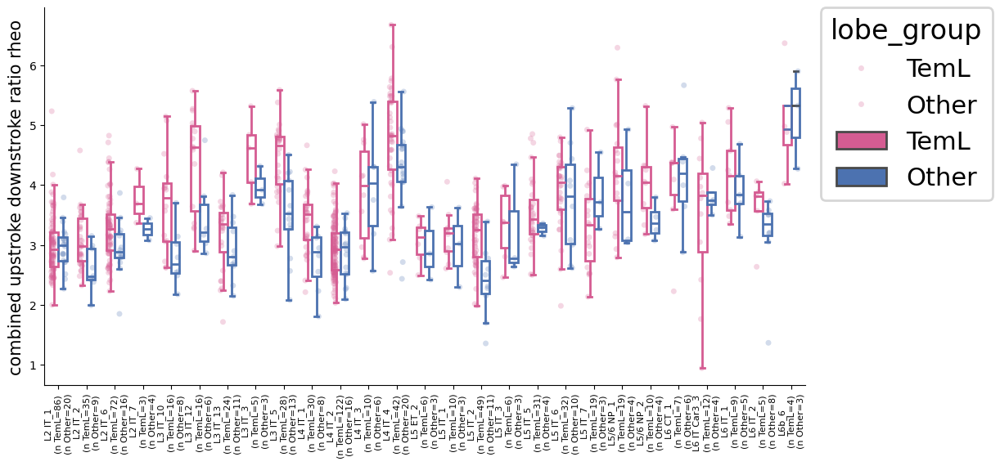

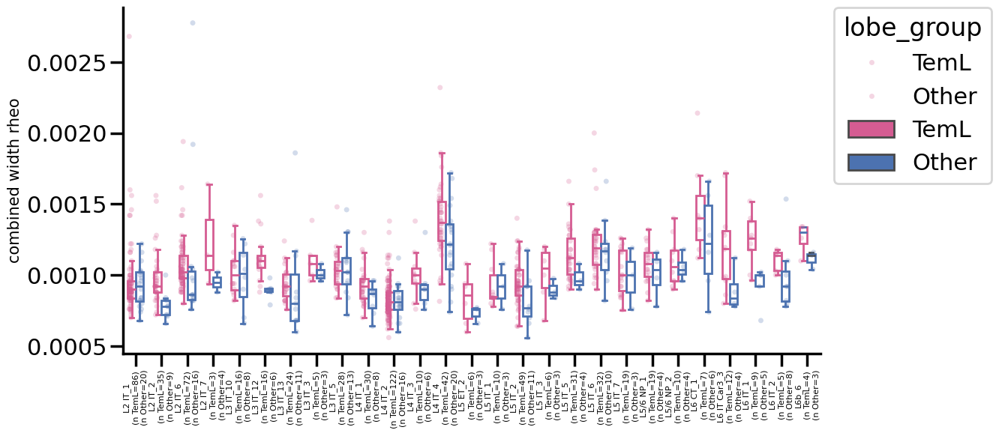

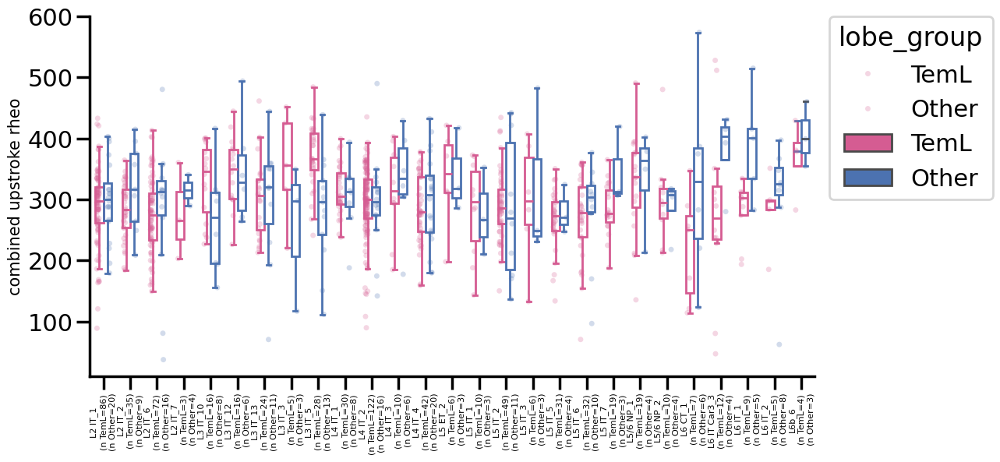

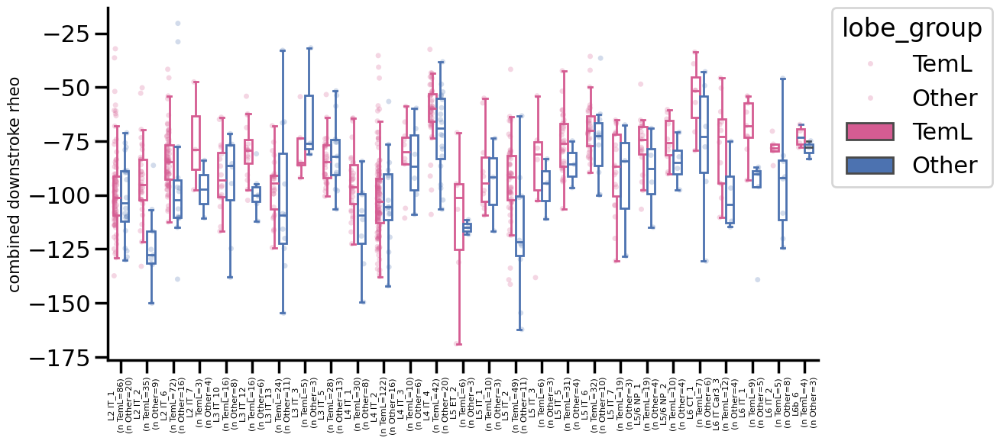

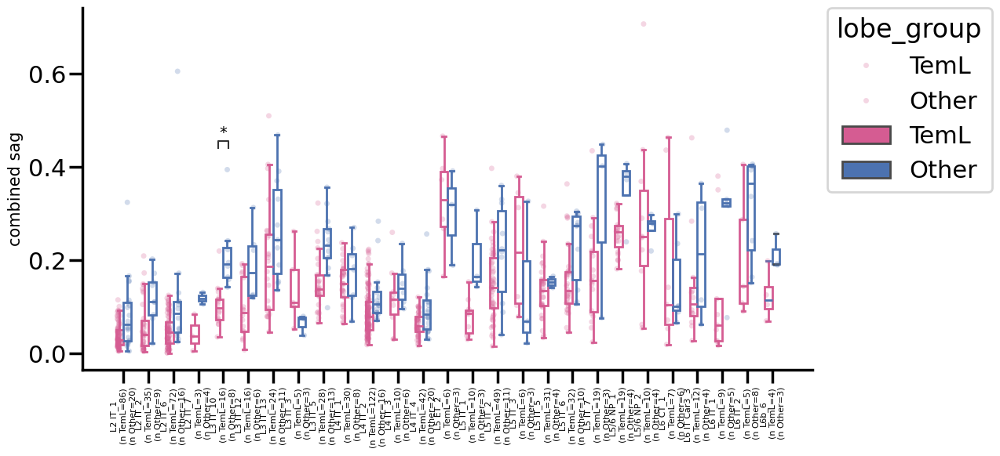

...

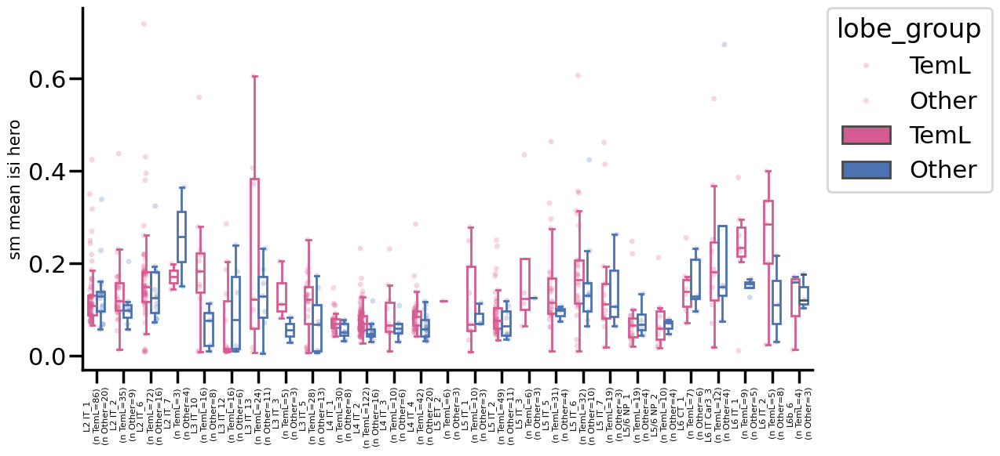

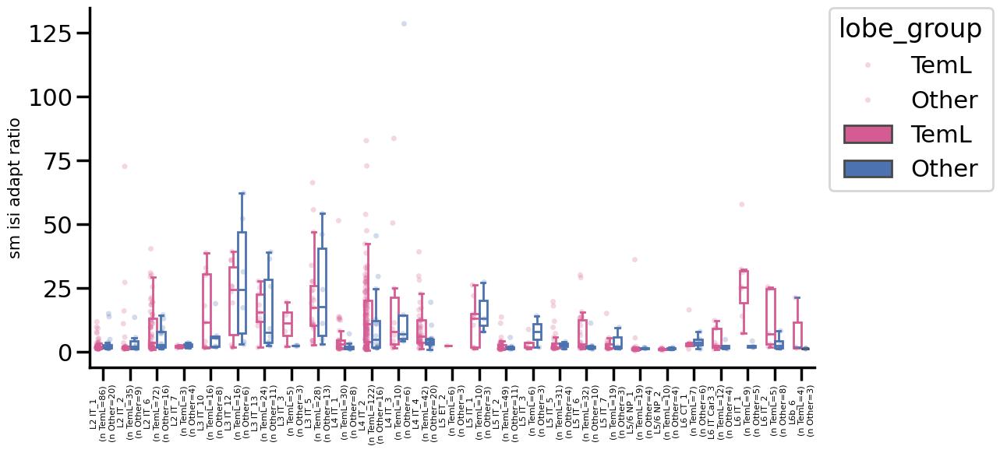

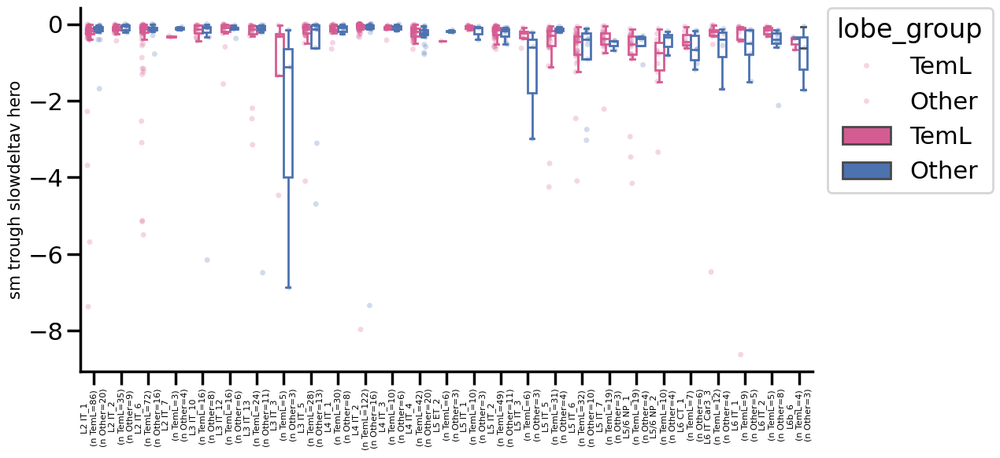

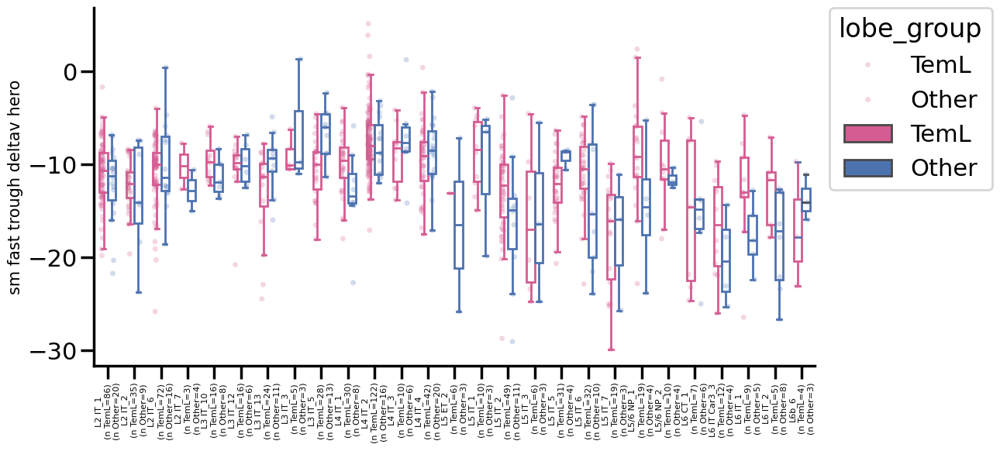

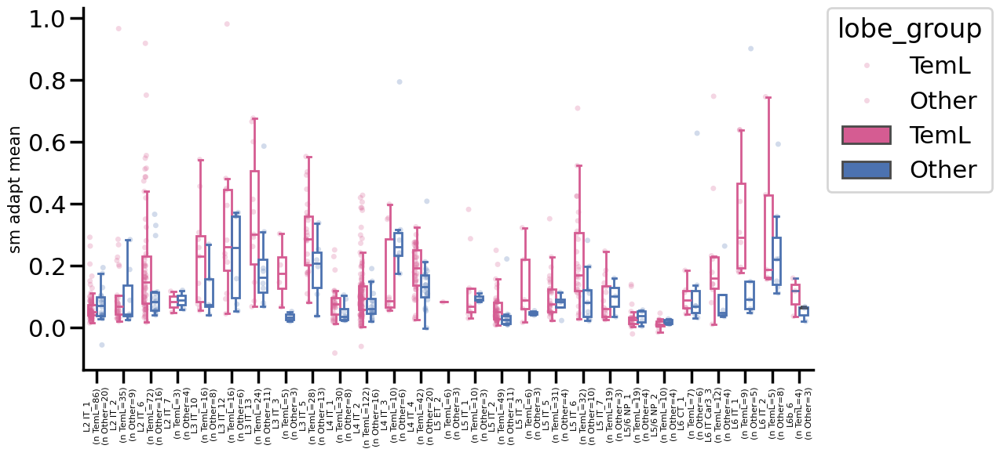

In [18]:
# ttype x feature box plots
fig_name = 'human_excitatory_boxplots_ephys_features_lobe_MWU_FDR_byTtype.pdf'

x_var = 't_type'
hue_var = 'lobe_group'
x_order = groups #sorted_clean_data[x_var].unique().tolist()
hue_order = ['TemL', 'Other']
color_palette = color_dicts[hue_var]

fig_path = os.path.join(output_dir, fig_name)
ephys_features = feature_cols.copy()

with warnings.catch_warnings():
    warnings.simplefilter(action='ignore', category=FutureWarning)

    with PdfPages(fig_path) as pdf:
        for y_var in ephys_features:
            # fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(7, 6), sharex=True)
            fig, ax = plt.subplots(nrows=1,ncols=1,figsize=(12,6),sharex=True, gridspec_kw = {'wspace':0, 'hspace':0.1}) #gridspec_kw = {'wspace':0, 'hspace':0},

            sns.set_context('poster')
            strip = sns.stripplot(data=sorted_clean_data, x=x_var, y=y_var, hue=hue_var, palette=color_palette, order=x_order, alpha=0.25, dodge=True, size=5)
            sns.boxplot(data=sorted_clean_data, x=x_var, y=y_var, hue=hue_var, palette=color_palette, order=x_order, saturation=1, linewidth=2, width=0.6, showfliers = False)

            #format 
            format_box_plot(ax) #clear fill of box plots, color edges
            sns.despine(right=True, top=True)
            ax.set_xlabel("")
            ax.set_ylabel(y_var.replace("_", " "), rotation=90, size=15)
                 
            ax.legend_.remove()
            handles, labels = strip.get_legend_handles_labels()
            ax.legend(handles, labels, title=hue_var, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)

            #add num observations per x_var
            nobs = []
            for s in x_order:
                nT = len(sorted_clean_data[(sorted_clean_data[x_var] == s) & (sorted_clean_data[hue_var] == 'TemL')])
                nO = len(sorted_clean_data[(sorted_clean_data[x_var] == s) & (sorted_clean_data[hue_var] == 'Other')])
                nobs.append("\n(n TemL={})\n(n Other={})".format(nT, nO))
            new_x_tick_labels = [x_order[i] + nobs[i] for i in range(len(x_order))]  
            ax.set_xticklabels(new_x_tick_labels)
            ax.tick_params(axis='x', rotation=90, labelsize=8)

            # Annotate p-values
            pairs = []
            p_values = []
            for subclass in x_order:
                key = (subclass, y_var)
                if key in mw_pvals_fdr:
                    pval = mw_pvals_fdr[key]
                    sig = mw_rejected.get(key, False)
                    if sig:
                        pairs.append([(subclass, 'TemL'), (subclass, 'Other')])  # or vice versa
                        p_values.append(pval)

            # Only annotate if there are significant results
            if pairs:
                annotator = Annotator(ax, pairs, data=sorted_clean_data, x=x_var, y=y_var, hue=hue_var, order=x_order)
                annotator.configure(text_format="star", loc="inside", fontsize=14)
                annotator.set_pvalues_and_annotate(p_values)

            # fig.tight_layout()
            pdf.savefig(dpi=600, bbox_inches='tight')
        plt.show()
        plt.clf


Cross areal box plots - subclass - TemL vs FroL

In [19]:
# subclass x feature box plots

x_var = 'lobe'
x_var_order = group_order[x_var]
group1_label = 'TemL'
group2_label = 'FroL'
group_var = 'subclass_label'

this_sorted_clean_data = sorted_clean_data[sorted_clean_data[x_var].isin(x_var_order)]
n_min_cells = 3
combo_counts = this_sorted_clean_data.groupby([group_var, x_var]).size().unstack(fill_value=0)
groups = combo_counts[(combo_counts >= n_min_cells).all(axis=1)].index.tolist()

# Collect p-values and stats by (subclass, feature)
mw_pvals = dict()
mw_stats = dict()

for group in groups:
    sub_data = this_sorted_clean_data[this_sorted_clean_data[group_var] == group]
    for f in ephys_features:
        group1 = sub_data[sub_data[x_var] == group1_label][f].dropna()
        group2 = sub_data[sub_data[x_var] == group2_label][f].dropna()

        if group1.empty or group2.empty:
            continue

        try:
            stat, pval = mannwhitneyu(group1, group2, alternative='two-sided')
            mw_pvals[(group, f)] = pval
            mw_stats[(group, f)] = stat
        except ValueError as e:
            print(f'Mann-Whitney failed for {group}, {f}: {e}')

# FDR correction across all tests (subclass-feature pairs)
mw_pvals_list = list(mw_pvals.values())
mw_rejected_list, mw_pvals_fdr_list = fdrcorrection(mw_pvals_list, alpha=0.05, method='indep', is_sorted=False)

mw_pvals_fdr = dict(zip(mw_pvals.keys(), mw_pvals_fdr_list))
mw_rejected = dict(zip(mw_pvals.keys(), mw_rejected_list))


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2292705234.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2292705234.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2/3 IT_TemL vs. L2/3 IT_FroL: Custom statistical test, P_val:4.327e-02
L6 IT_TemL vs. L6 IT_FroL: Custom statistical test, P_val:2.320e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2292705234.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2292705234.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L6 IT_TemL vs. L6 IT_FroL: Custom statistical test, P_val:1.244e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2292705234.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2/3 IT_TemL vs. L2/3 IT_FroL: Custom statistical test, P_val:1.438e-05


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2292705234.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2292705234.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2292705234.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2292705234.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users

p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L4 IT_TemL vs. L4 IT_FroL: Custom statistical test, P_val:8.440e-03


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2292705234.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2292705234.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2292705234.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2292705234.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2/3 IT_TemL vs. L2/3 IT_FroL: Custom statistical test, P_val:2.731e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2292705234.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L4 IT_TemL vs. L4 IT_FroL: Custom statistical test, P_val:1.244e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2292705234.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L4 IT_TemL vs. L4 IT_FroL: Custom statistical test, P_val:1.244e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2292705234.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L6 IT_TemL vs. L6 IT_FroL: Custom statistical test, P_val:3.505e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2292705234.py:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(nrows=1,ncols=1,figsize=(7,6),sharex=True, gridspec_kw = {'wspace':0, 'hspace':0.1}) #gridspec_kw = {'wspace':0, 'hspace':0},
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2292705234.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2292705234.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.


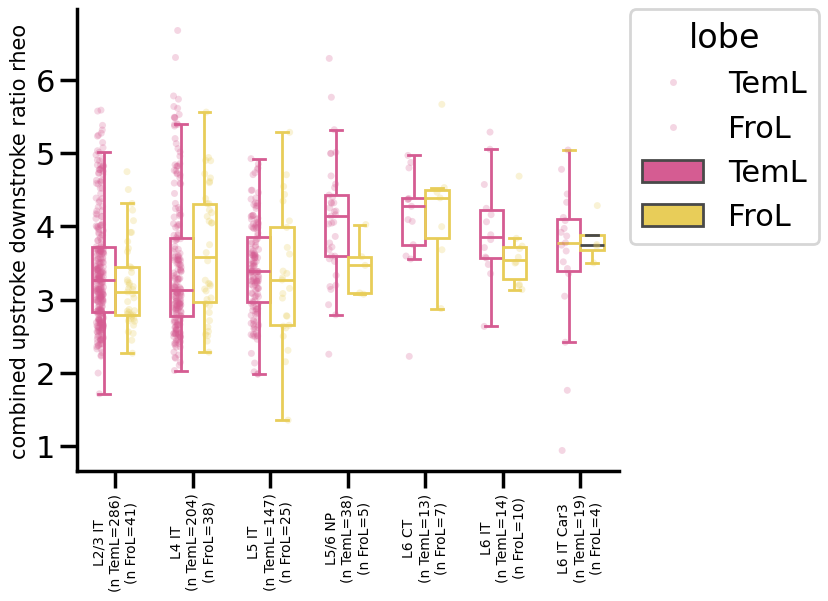

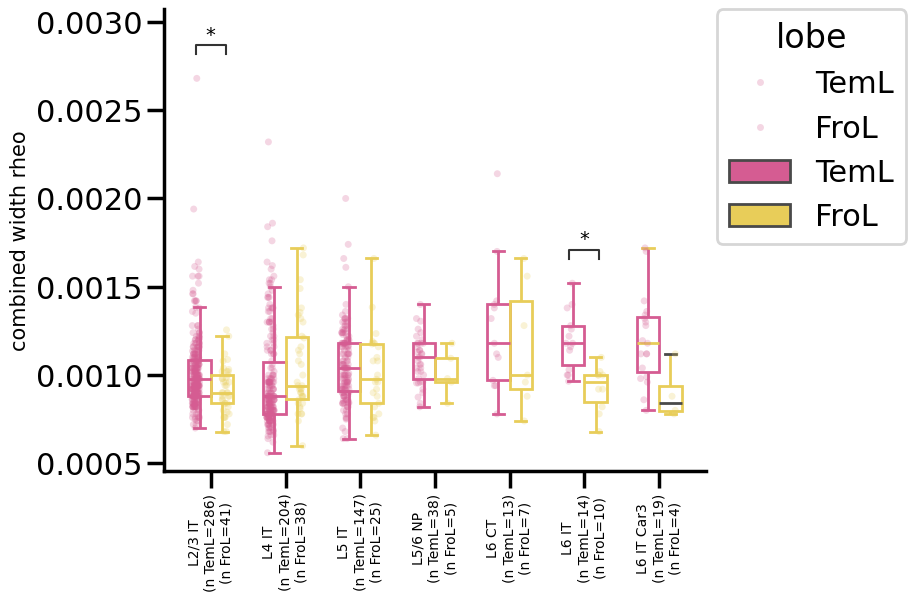

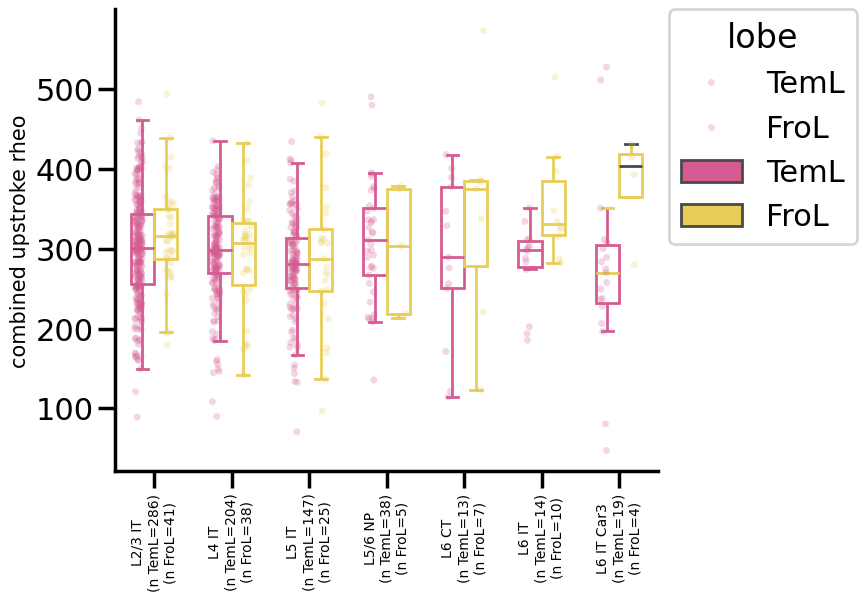

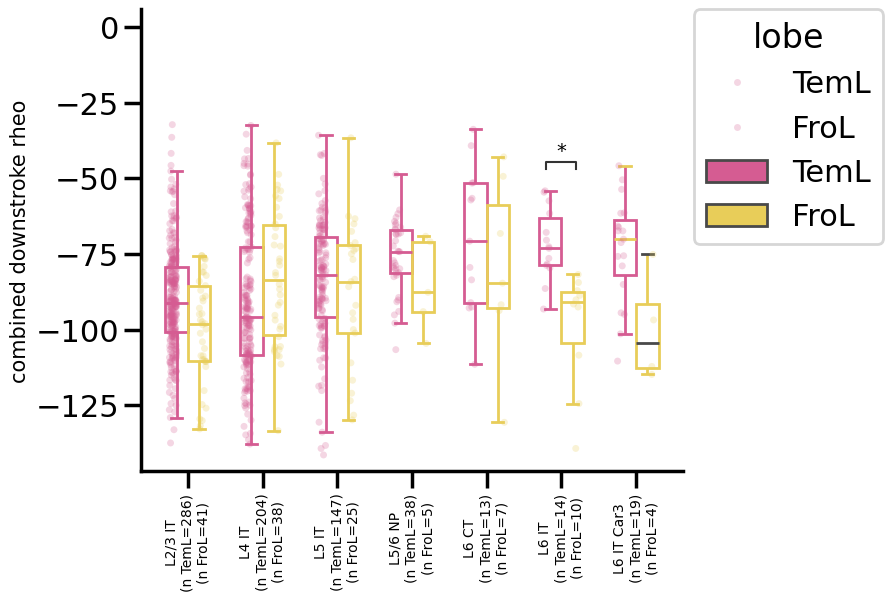

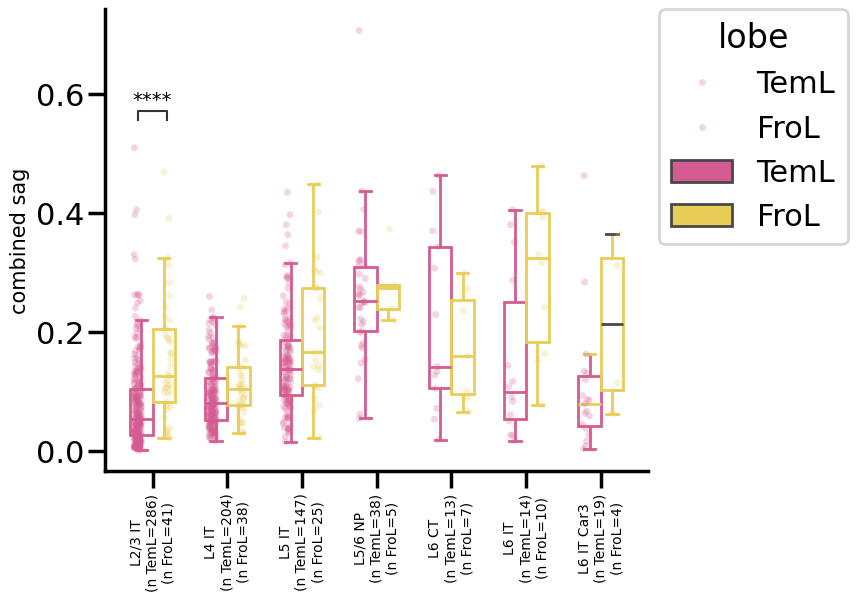

...

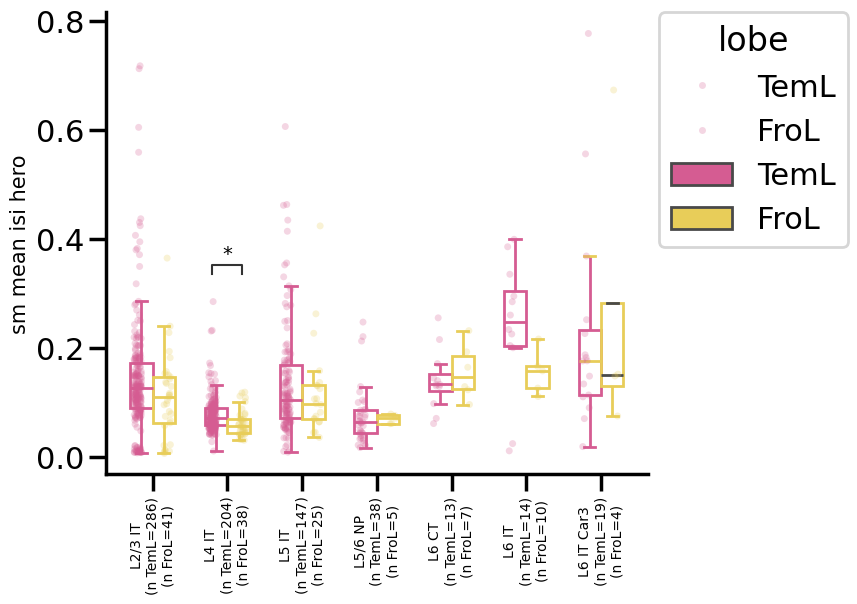

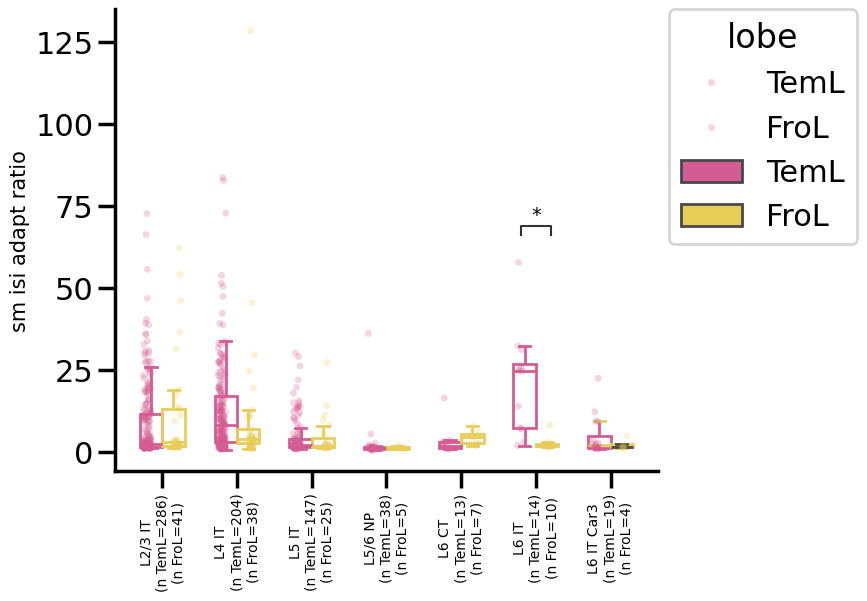

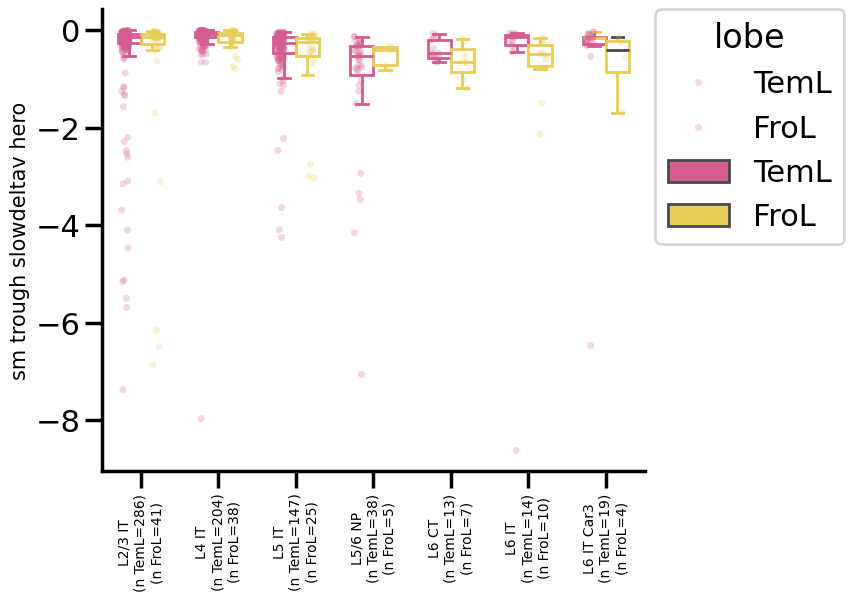

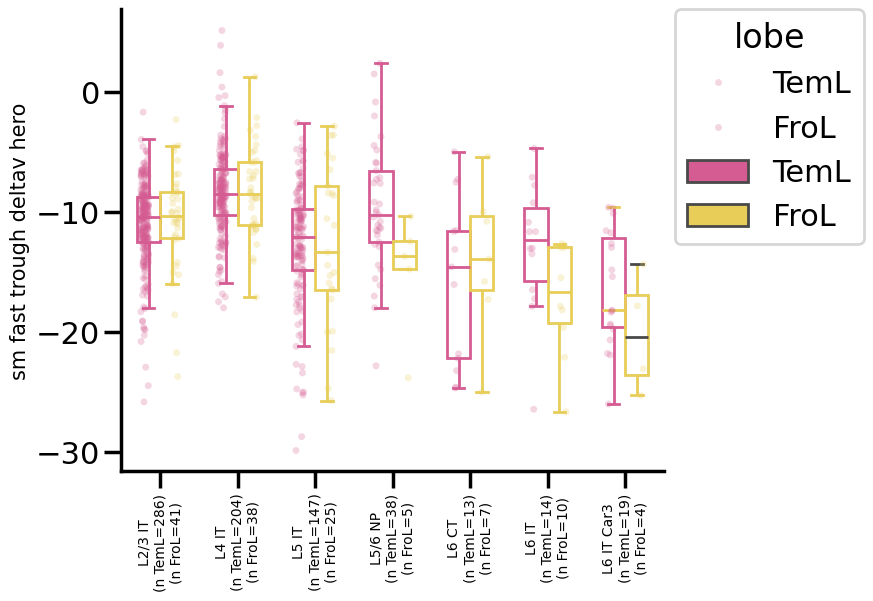

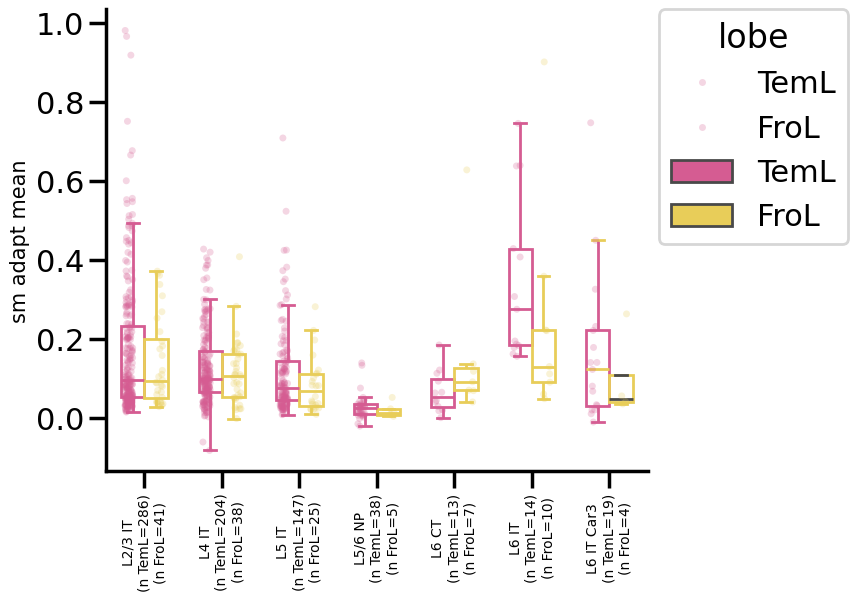

Boxplots with Mann-Whitney U stats saved.


In [20]:
# subclass x feature box plots
fig_name = 'human_excitatory_boxplots_ephys_features_lobe_teml_frol_MWU_FDR_bySubclass.pdf'

x_var = 'subclass_label'
hue_var = 'lobe'
x_order = groups #sorted_clean_data[x_var].unique().tolist()
hue_order = ['TemL', 'FroL']
color_palette = color_dicts[hue_var]

this_sorted_clean_data = sorted_clean_data[sorted_clean_data[hue_var].isin(hue_order)]

fig_path = os.path.join(output_dir, fig_name)
ephys_features = feature_cols.copy()

with warnings.catch_warnings():
    warnings.simplefilter(action='ignore', category=FutureWarning)

    with PdfPages(fig_path) as pdf:
        for y_var in ephys_features:
            # fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(7, 6), sharex=True)
            fig, ax = plt.subplots(nrows=1,ncols=1,figsize=(7,6),sharex=True, gridspec_kw = {'wspace':0, 'hspace':0.1}) #gridspec_kw = {'wspace':0, 'hspace':0},

            sns.set_context('poster')
            strip = sns.stripplot(data=this_sorted_clean_data, x=x_var, y=y_var, hue=hue_var, palette=color_palette, order=x_order, alpha=0.25, dodge=True, size=5)
            sns.boxplot(data=this_sorted_clean_data, x=x_var, y=y_var, hue=hue_var, palette=color_palette, order=x_order, saturation=1, linewidth=2, width=0.6, showfliers = False)

            #format 
            format_box_plot(ax) #clear fill of box plots, color edges
            sns.despine(right=True, top=True)

            ax.set_xlabel("")
            ax.set_ylabel(y_var.replace("_", " "), rotation=90, size=15)
                        
            ax.legend_.remove()
            handles, labels = strip.get_legend_handles_labels()
            ax.legend(handles, labels, title=hue_var, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)

            #add num observations per x_var
            nobs = []
            for s in x_order:
                nT = len(this_sorted_clean_data[(this_sorted_clean_data[x_var] == s) & (this_sorted_clean_data[hue_var] == 'TemL')])
                nO = len(this_sorted_clean_data[(this_sorted_clean_data[x_var] == s) & (this_sorted_clean_data[hue_var] == 'FroL')])
                nobs.append("\n(n TemL={})\n(n FroL={})".format(nT, nO))
            new_x_tick_labels = [x_order[i] + nobs[i] for i in range(len(x_order))]  
            ax.set_xticklabels(new_x_tick_labels)
            ax.tick_params(axis='x', rotation=90, labelsize=10)

            # Annotate p-values
            pairs = []
            p_values = []
            for subclass in x_order:
                key = (subclass, y_var)
                if key in mw_pvals_fdr:
                    pval = mw_pvals_fdr[key]
                    sig = mw_rejected.get(key, False)
                    if sig:
                        pairs.append([(subclass, 'TemL'), (subclass, 'FroL')])  # or vice versa
                        p_values.append(pval)

            # Only annotate if there are significant results
            if pairs:
                annotator = Annotator(ax, pairs, data=this_sorted_clean_data, x=x_var, y=y_var, hue=hue_var, order=x_order)
                annotator.configure(text_format="star", loc="inside", fontsize=14)
                annotator.set_pvalues_and_annotate(p_values)

            # fig.tight_layout()
            pdf.savefig(dpi=600, bbox_inches='tight')
        plt.show()
        plt.clf

    print("Boxplots with Mann-Whitney U stats saved.")


Cross areal box plots - ttype - TemL vs FroL

In [21]:
# ttype x feature box plots

x_var = 'lobe'
x_var_order = ['TemL', 'FroL']
group1_label = 'TemL'
group2_label = 'FroL'
group_var = 't_type'

this_sorted_clean_data = sorted_clean_data[sorted_clean_data[x_var].isin(x_var_order)]
n_min_cells = 3
combo_counts = this_sorted_clean_data.groupby([group_var, x_var]).size().unstack(fill_value=0)
groups = combo_counts[(combo_counts >= n_min_cells).all(axis=1)].index.tolist()

# Collect p-values and stats by (ttype, feature)
mw_pvals = dict()
mw_stats = dict()

for group in groups:
    sub_data = this_sorted_clean_data[this_sorted_clean_data[group_var] == group]
    for f in feature_cols:
        group1 = sub_data[sub_data[x_var] == group1_label][f].dropna()
        group2 = sub_data[sub_data[x_var] == group2_label][f].dropna()

        if group1.empty or group2.empty:
            continue

        try:
            stat, pval = mannwhitneyu(group1, group2, alternative='two-sided')
            mw_pvals[(group, f)] = pval
            mw_stats[(group, f)] = stat
        except ValueError as e:
            print(f'Mann-Whitney failed for {group}, {f}: {e}')

# FDR correction across all tests (subclass-feature pairs)
mw_pvals_list = list(mw_pvals.values())
mw_rejected_list, mw_pvals_fdr_list = fdrcorrection(mw_pvals_list, alpha=0.05, method='indep', is_sorted=False)

mw_pvals_fdr = dict(zip(mw_pvals.keys(), mw_pvals_fdr_list))
mw_rejected = dict(zip(mw_pvals.keys(), mw_rejected_list))


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\3033294357.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\3033294357.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\3033294357.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\3033294357.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2 IT_6_TemL vs. L2 IT_6_FroL: Custom statistical test, P_val:3.853e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\3033294357.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\3033294357.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\3033294357.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\3033294357.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users

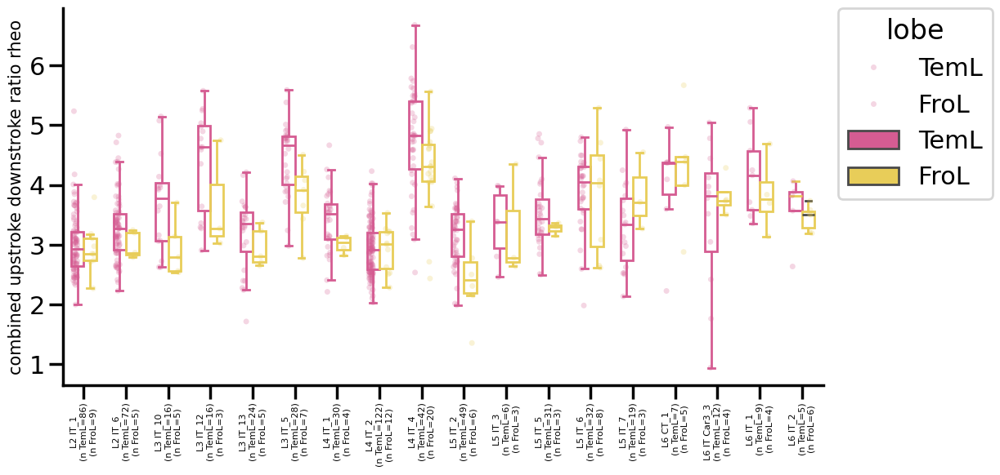

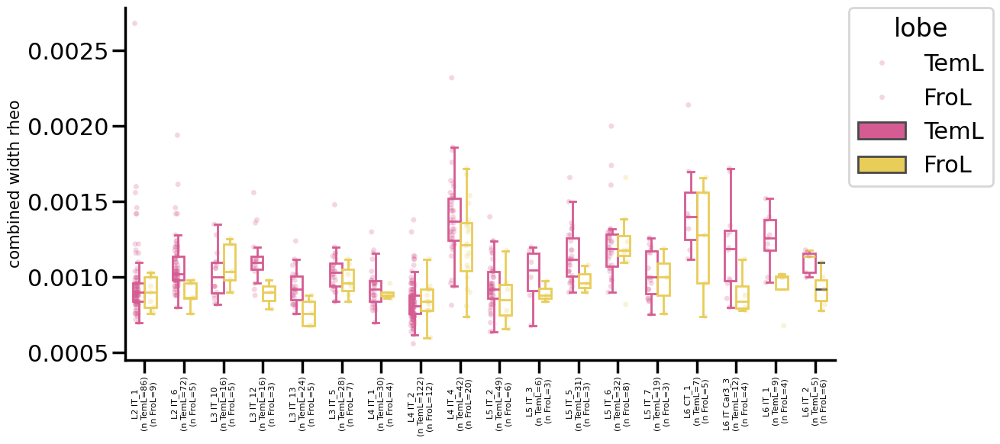

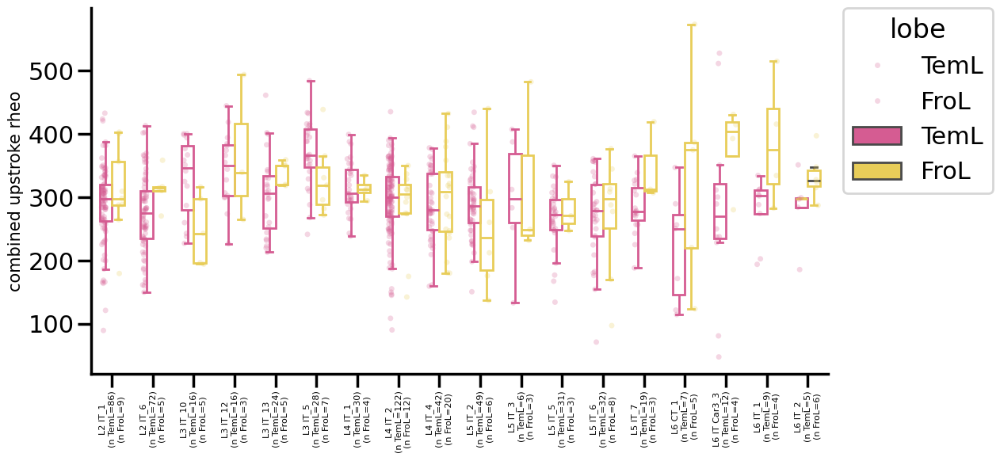

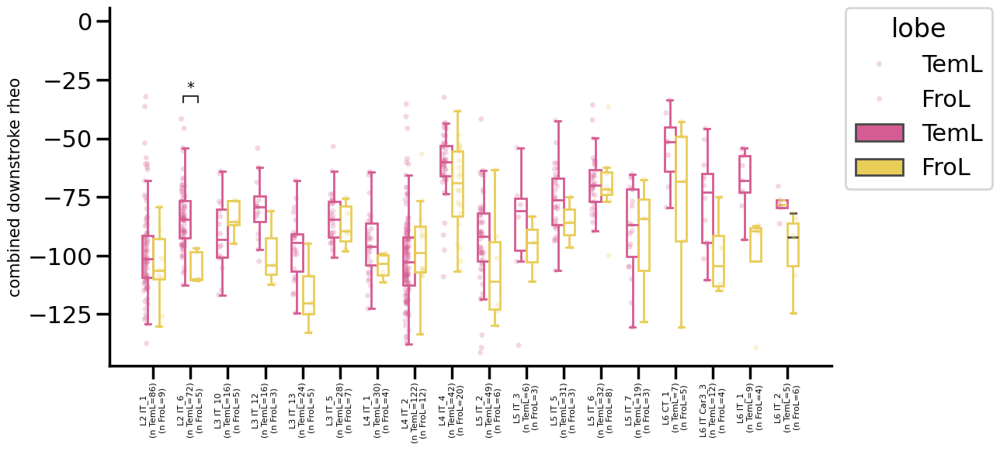

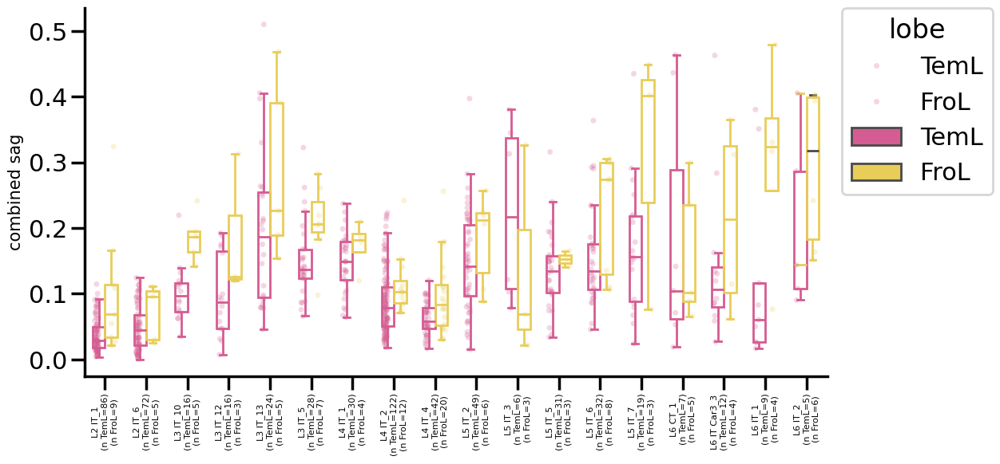

...

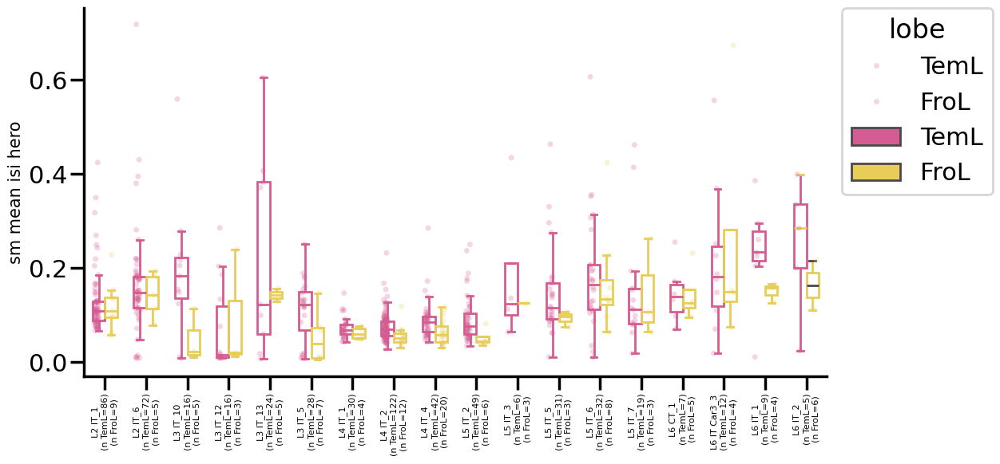

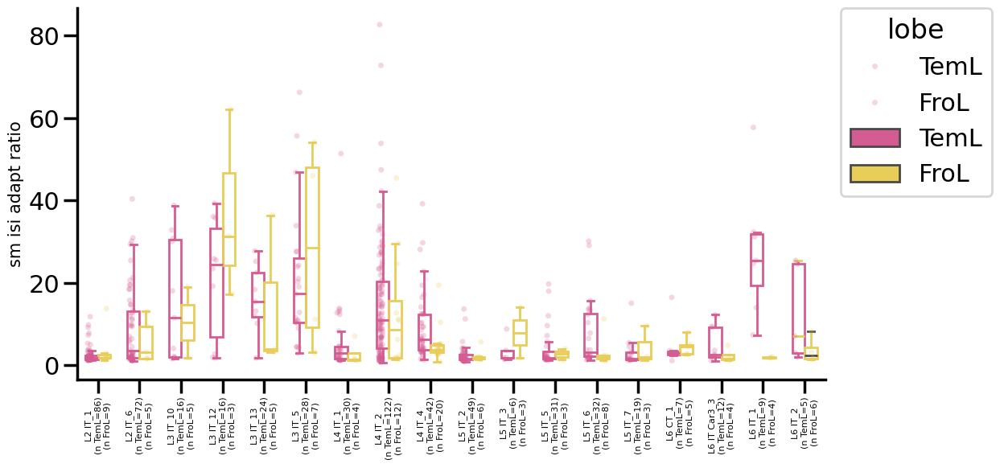

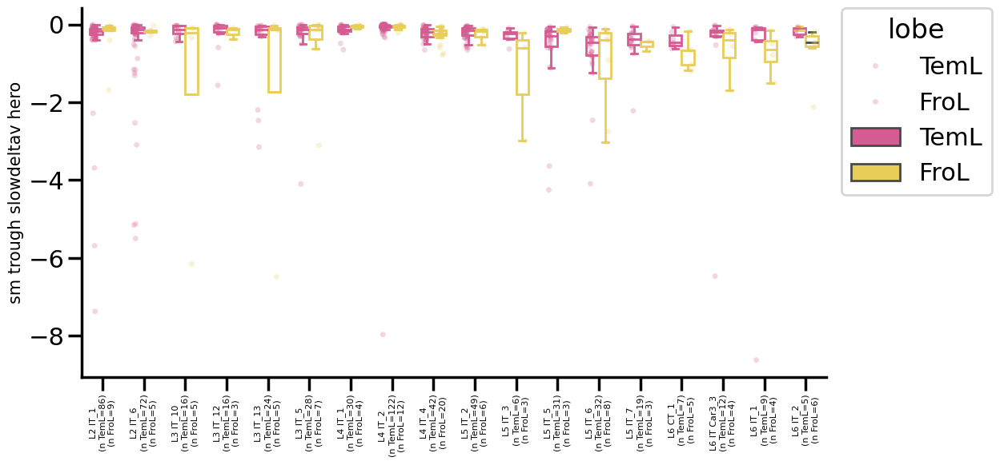

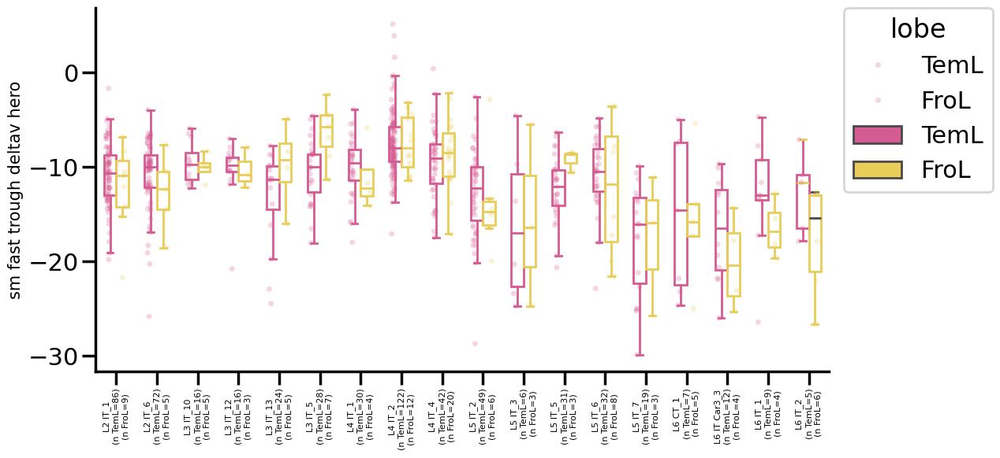

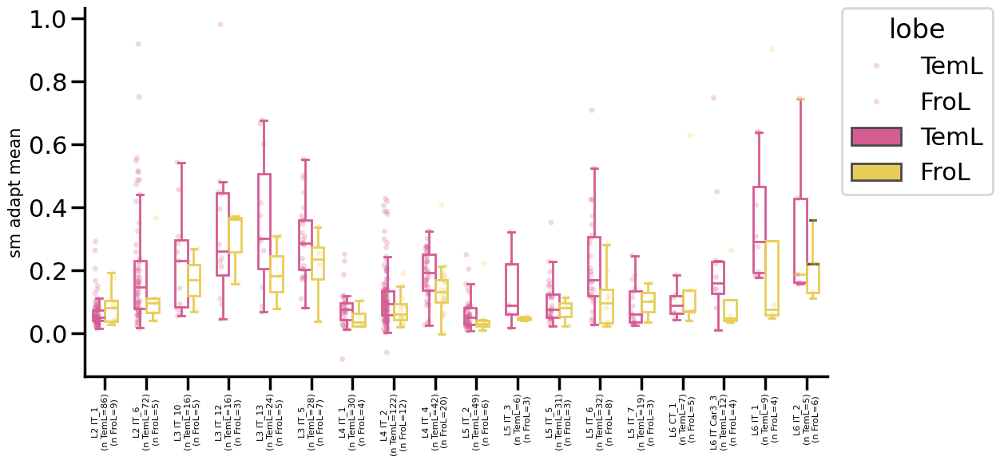

In [22]:
# ttype x feature box plots
fig_name = 'human_excitatory_boxplots_ephys_features_lobe_teml_frol_MWU_FDR_byTtype.pdf'

x_var = 't_type'
hue_var = 'lobe'
x_order = groups #sorted_clean_data[x_var].unique().tolist()
hue_order = ['TemL', 'FroL']
color_palette = color_dicts[hue_var]

this_sorted_clean_data = sorted_clean_data[sorted_clean_data[hue_var].isin(hue_order)]

fig_path = os.path.join(output_dir, fig_name)
ephys_features = feature_cols.copy()

with warnings.catch_warnings():
    warnings.simplefilter(action='ignore', category=FutureWarning)

    with PdfPages(fig_path) as pdf:
        for y_var in ephys_features:
            # fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(7, 6), sharex=True)
            fig, ax = plt.subplots(nrows=1,ncols=1,figsize=(12,6),sharex=True, gridspec_kw = {'wspace':0, 'hspace':0.1}) #gridspec_kw = {'wspace':0, 'hspace':0},

            sns.set_context('poster')
            strip = sns.stripplot(data=this_sorted_clean_data, x=x_var, y=y_var, hue=hue_var, palette=color_palette, order=x_order, alpha=0.25, dodge=True, size=5)
            sns.boxplot(data=this_sorted_clean_data, x=x_var, y=y_var, hue=hue_var, palette=color_palette, order=x_order, saturation=1, linewidth=2, width=0.6, showfliers = False)

            #format 
            format_box_plot(ax) #clear fill of box plots, color edges
            sns.despine(right=True, top=True)

            ax.set_xlabel("")
            ax.set_ylabel(y_var.replace("_", " "), rotation=90, size=15)
            
            ax.legend_.remove()
            handles, labels = strip.get_legend_handles_labels()
            ax.legend(handles, labels, title=hue_var, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)

            #add num observations per x_var
            nobs = []
            for s in x_order:
                nT = len(this_sorted_clean_data[(this_sorted_clean_data[x_var] == s) & (this_sorted_clean_data[hue_var] == 'TemL')])
                nO = len(this_sorted_clean_data[(this_sorted_clean_data[x_var] == s) & (this_sorted_clean_data[hue_var] == 'FroL')])
                nobs.append("\n(n TemL={})\n(n FroL={})".format(nT, nO))
            new_x_tick_labels = [x_order[i] + nobs[i] for i in range(len(x_order))]  
            ax.set_xticklabels(new_x_tick_labels)
            ax.tick_params(axis='x', rotation=90, labelsize=8)

            # Annotate p-values
            pairs = []
            p_values = []
            for subclass in x_order:
                key = (subclass, y_var)
                if key in mw_pvals_fdr:
                    pval = mw_pvals_fdr[key]
                    sig = mw_rejected.get(key, False)
                    if sig:
                        pairs.append([(subclass, 'TemL'), (subclass, 'FroL')])  # or vice versa
                        p_values.append(pval)

            # Only annotate if there are significant results
            if pairs:
                annotator = Annotator(ax, pairs, data=this_sorted_clean_data, x=x_var, y=y_var, hue=hue_var, order=x_order)
                annotator.configure(text_format="star", loc="inside", fontsize=14)
                annotator.set_pvalues_and_annotate(p_values)

            # fig.tight_layout()
            pdf.savefig(dpi=600, bbox_inches='tight')
        plt.show()
        plt.clf


Cross paradigm box plots - subclass

In [10]:
# subclass x feature box plots

x_var = 'paradigm'
group1_label = 'acute'
group2_label = 'culture'
group_var = 'subclass_label'

n_min_cells = 3
combo_counts = sorted_clean_data.groupby([group_var, x_var]).size().unstack(fill_value=0)
groups = combo_counts[(combo_counts >= n_min_cells).all(axis=1)].index.tolist()

# Collect p-values and stats by (subclass, feature)
mw_pvals = dict()
mw_stats = dict()

for group in groups:
    sub_data = sorted_clean_data[sorted_clean_data[group_var] == group]
    for f in feature_cols:
        group1 = sub_data[sub_data[x_var] == group1_label][f].dropna()
        group2 = sub_data[sub_data[x_var] == group2_label][f].dropna()

        if group1.empty or group2.empty:
            continue

        try:
            stat, pval = mannwhitneyu(group1, group2, alternative='two-sided')
            mw_pvals[(group, f)] = pval
            mw_stats[(group, f)] = stat
        except ValueError as e:
            print(f'Mann-Whitney failed for {group}, {f}: {e}')

# FDR correction across all tests (subclass-feature pairs)
mw_pvals_list = list(mw_pvals.values())
mw_rejected_list, mw_pvals_fdr_list = fdrcorrection(mw_pvals_list, alpha=0.05, method='indep', is_sorted=False)

mw_pvals_fdr = dict(zip(mw_pvals.keys(), mw_pvals_fdr_list))
mw_rejected = dict(zip(mw_pvals.keys(), mw_rejected_list))


In [11]:
#Save stats
rows = []
for (subclass, feature), pval in mw_pvals.items():
    rows.append({
        'subclass': subclass,
        'feature': feature,
        'mw_stat': mw_stats.get((subclass, feature)),
        'pval_raw': pval,
        'pval_fdr': mw_pvals_fdr.get((subclass, feature)),
        'rejected_pval_fdr': mw_rejected.get((subclass, feature)),
        'group1': group1_label,
        'group2': group2_label
    })

mw_stats_df = pd.DataFrame(rows)

# optional: sort for readability
mw_stats_df = mw_stats_df.sort_values(
    ['subclass', 'pval_fdr'],
    ascending=[True, True]
)

# save
mw_stats_df.to_csv(os.path.join(output_dir, r'ephys_feature_box_plot_stats_paradigm_subclass.csv'), index=False)
mw_stats_df

,subclass,feature,mw_stat,pval_raw,pval_fdr,rejected_pval_fdr,group1,group2
12,L2/3 IT,combined_peak_impedance_chirp,169.0,3.092562e-13,2.984323e-11,True,acute,culture
5,L2/3 IT,combined_baseline,2081.0,2.870710e-11,1.385118e-09,True,acute,culture
4,L2/3 IT,combined_sag,3102.0,6.156414e-07,1.320209e-05,True,acute,culture
13,L2/3 IT,combined_AP_threshold,3117.5,5.956891e-07,1.320209e-05,True,acute,culture
9,L2/3 IT,combined_trough_v_rheo,3424.0,6.744402e-06,1.084725e-04,True,acute,culture
...,...,...,...,...,...,...,...,...
186,L6b,sm_latency_rheo,11.0,9.047619e-01,9.810059e-01,False,acute,culture
187,L6b,sm_avg_rate_hero,9.0,9.004375e-01,9.810059e-01,False,acute,culture
181,L6b,combined_peak_freq_chirp,1.0,1.000000e+00,1.000000e+00,False,acute,culture
182,L6b,combined_peak_impedance_chirp,1.0,1.000000e+00,1.000000e+00,False,acute,culture


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2574612311.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L6 IT_acute vs. L6 IT_culture: Custom statistical test, P_val:1.529e-02
L6 IT Car3_acute vs. L6 IT Car3_culture: Custom statistical test, P_val:1.064e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2574612311.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2574612311.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L6b_acute vs. L6b_culture: Custom statistical test, P_val:4.642e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2574612311.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2574612311.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L4 IT_acute vs. L4 IT_culture: Custom statistical test, P_val:5.573e-05
L2/3 IT_acute vs. L2/3 IT_culture: Custom statistical test, P_val:1.320e-05
L5 IT_acute vs. L5 IT_culture: Custom statistical test, P_val:1.186e-09
L5/6 NP_acute vs. L5/6 NP_culture: Custom statistical test, P_val:1.064e-02
L6 IT_acute vs. L6 IT_culture: Custom statistical test, P_val:3.230e-04
L6 IT Car3_acute vs. L6 IT Car3_culture: Custom statistical test, P_val:2.393e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2574612311.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2/3 IT_acute vs. L2/3 IT_culture: Custom statistical test, P_val:1.385e-09
L5 IT_acute vs. L5 IT_culture: Custom statistical test, P_val:2.977e-08
L5/6 NP_acute vs. L5/6 NP_culture: Custom statistical test, P_val:1.055e-04


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2574612311.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L5 IT_acute vs. L5 IT_culture: Custom statistical test, P_val:6.031e-08
L6 IT_acute vs. L6 IT_culture: Custom statistical test, P_val:3.198e-03
L6 IT Car3_acute vs. L6 IT Car3_culture: Custom statistical test, P_val:3.676e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2574612311.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2574612311.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L5 IT_acute vs. L5 IT_culture: Custom statistical test, P_val:4.813e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2574612311.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2/3 IT_acute vs. L2/3 IT_culture: Custom statistical test, P_val:1.085e-04
L5/6 NP_acute vs. L5/6 NP_culture: Custom statistical test, P_val:8.593e-03


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2574612311.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2/3 IT_acute vs. L2/3 IT_culture: Custom statistical test, P_val:3.217e-02
L5/6 NP_acute vs. L5/6 NP_culture: Custom statistical test, P_val:1.064e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2574612311.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2574612311.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2/3 IT_acute vs. L2/3 IT_culture: Custom statistical test, P_val:2.984e-11


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2574612311.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L4 IT_acute vs. L4 IT_culture: Custom statistical test, P_val:3.217e-02
L2/3 IT_acute vs. L2/3 IT_culture: Custom statistical test, P_val:1.320e-05
L5 IT_acute vs. L5 IT_culture: Custom statistical test, P_val:5.388e-09
L5/6 NP_acute vs. L5/6 NP_culture: Custom statistical test, P_val:1.064e-02
L6 CT_acute vs. L6 CT_culture: Custom statistical test, P_val:1.458e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2574612311.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L5 IT_acute vs. L5 IT_culture: Custom statistical test, P_val:2.035e-03


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2574612311.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2574612311.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2/3 IT_acute vs. L2/3 IT_culture: Custom statistical test, P_val:4.642e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2574612311.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L5/6 NP_acute vs. L5/6 NP_culture: Custom statistical test, P_val:1.122e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2574612311.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L5/6 NP_acute vs. L5/6 NP_culture: Custom statistical test, P_val:4.813e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2574612311.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2574612311.py:19: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(nrows=1,ncols=1,figsize=(7,6),sharex=True, gridspec_kw = {'wspace':0, 'hspace':0.1}) #gridspec_kw = {'wspace':0, 'hspace':0},
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2574612311.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L5 IT_acute vs. L5 IT_culture: Custom statistical test, P_val:3.435e-03


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2574612311.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2/3 IT_acute vs. L2/3 IT_culture: Custom statistical test, P_val:4.301e-03
L5 IT_acute vs. L5 IT_culture: Custom statistical test, P_val:1.340e-11
L6 CT_acute vs. L6 CT_culture: Custom statistical test, P_val:3.427e-02
L6 IT_acute vs. L6 IT_culture: Custom statistical test, P_val:1.064e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2574612311.py:43: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


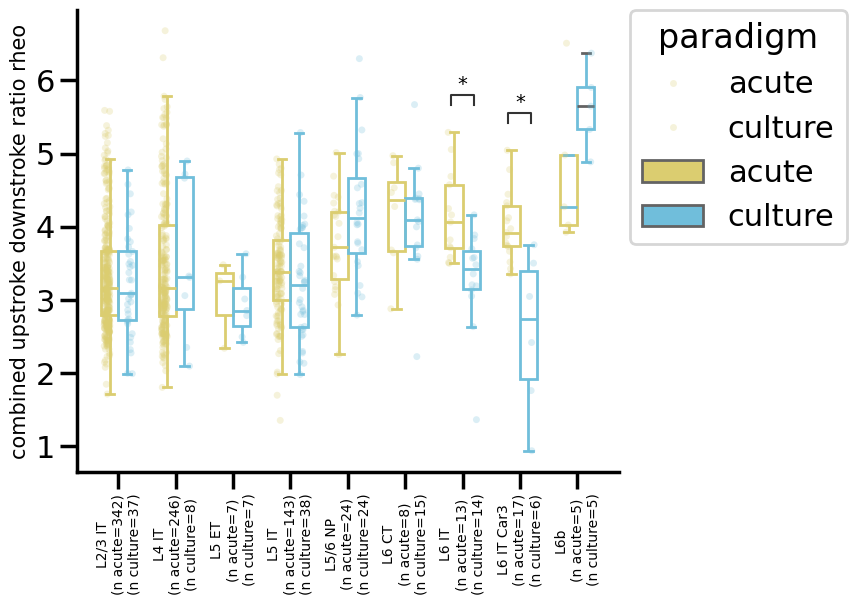

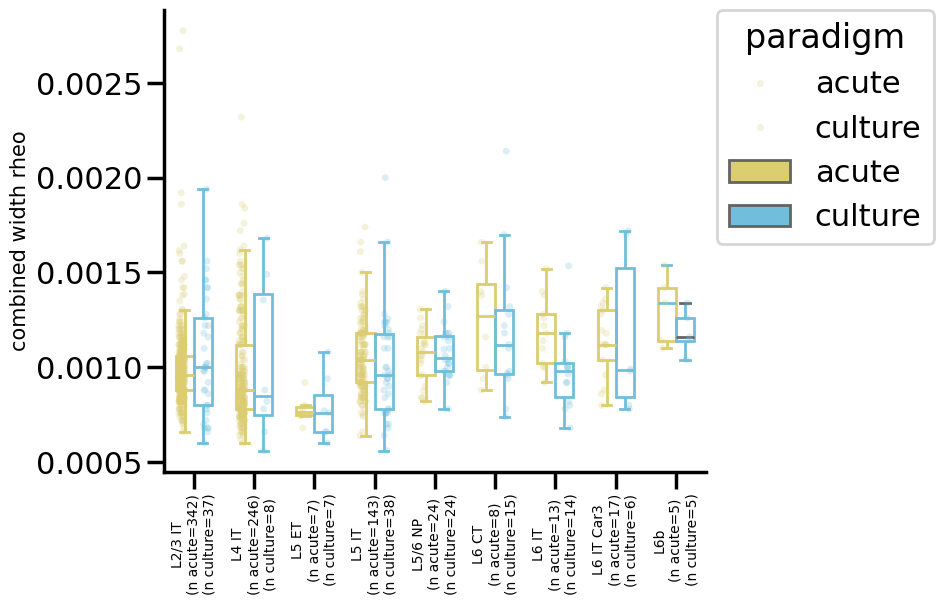

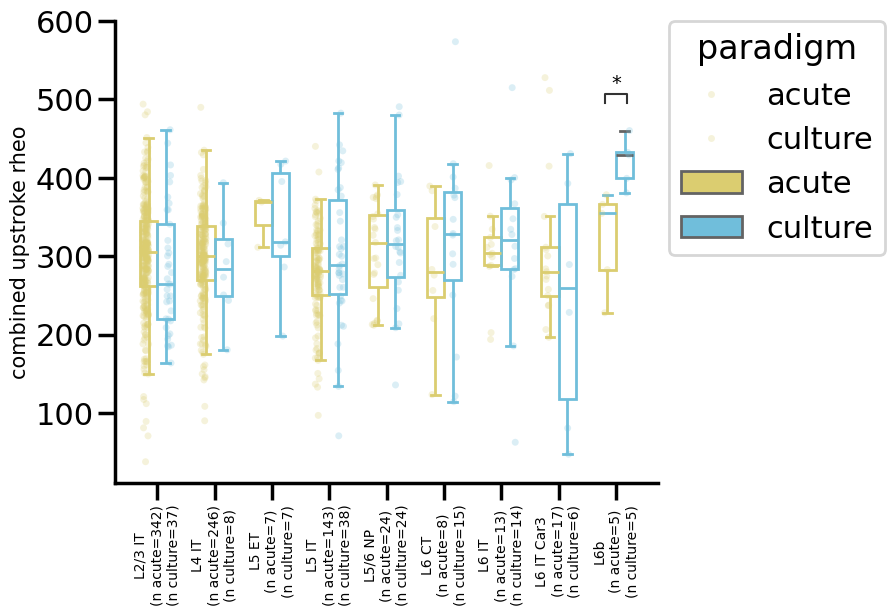

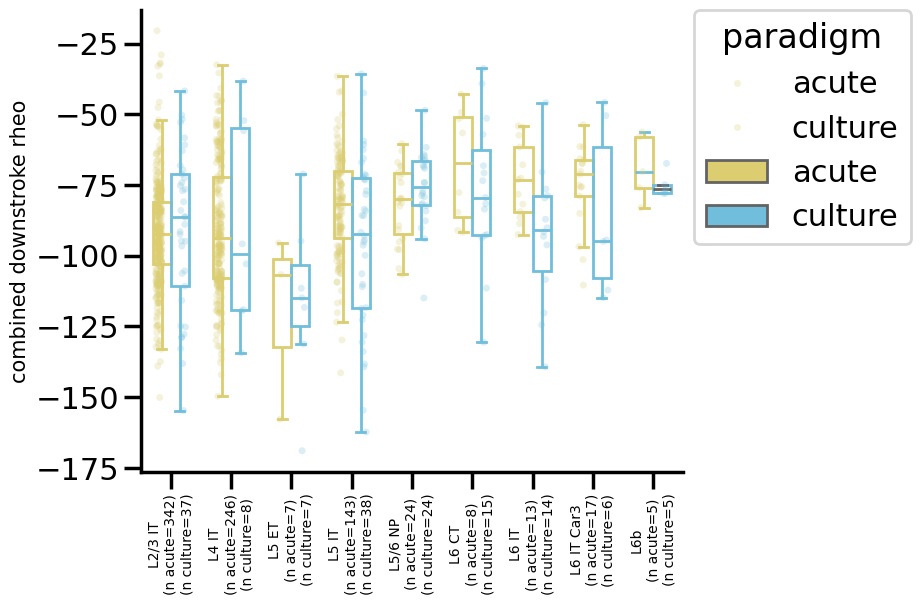

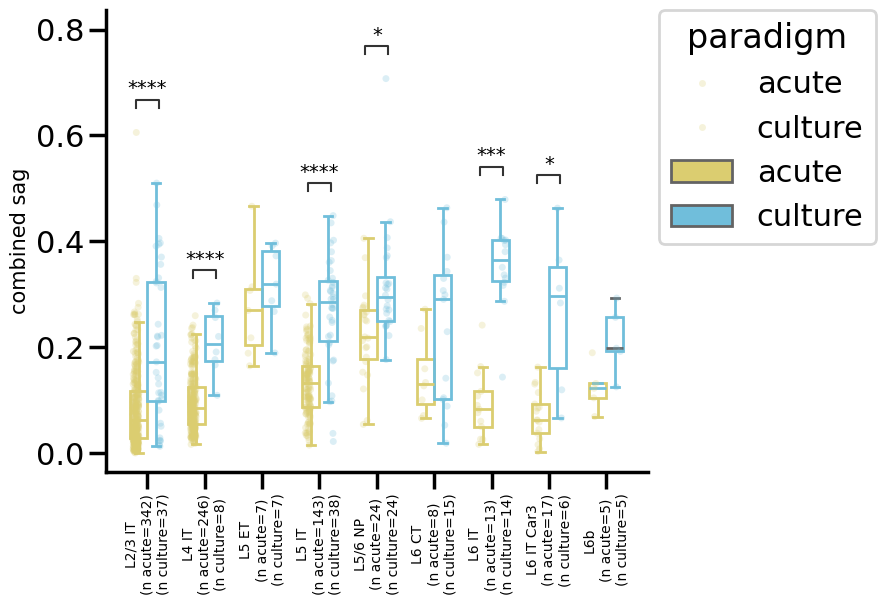

...

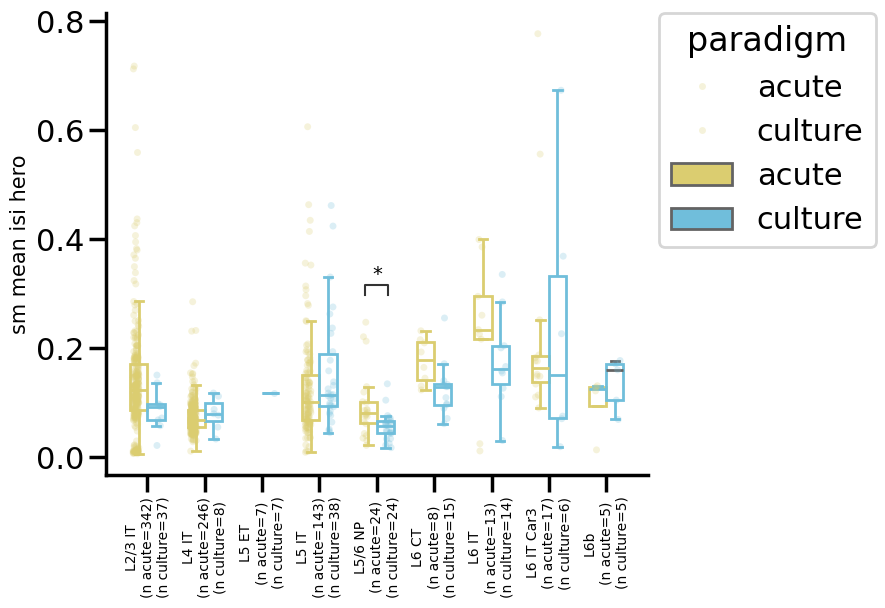

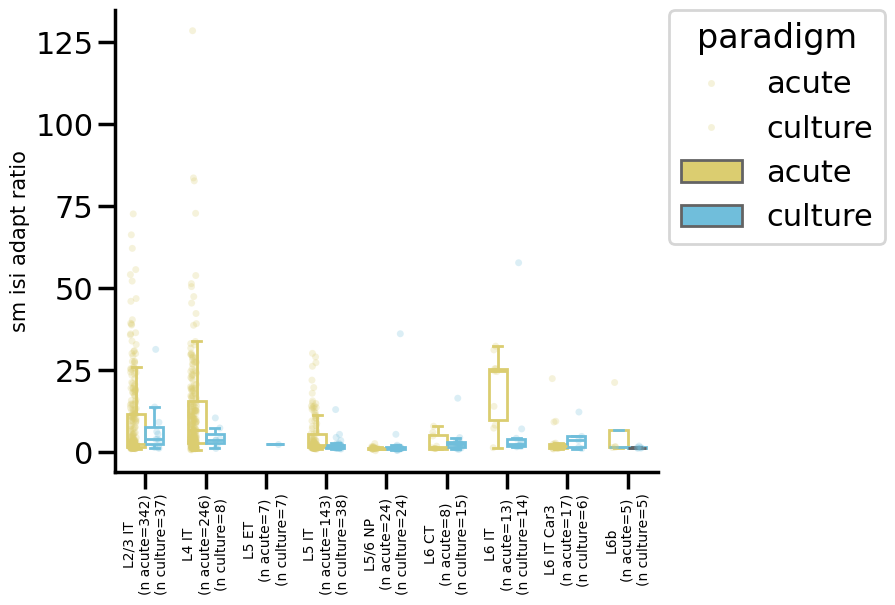

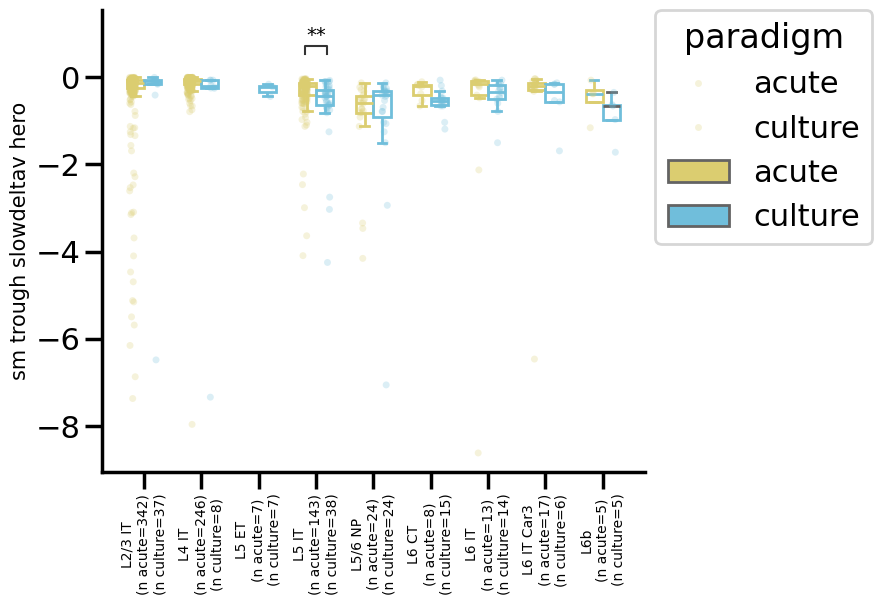

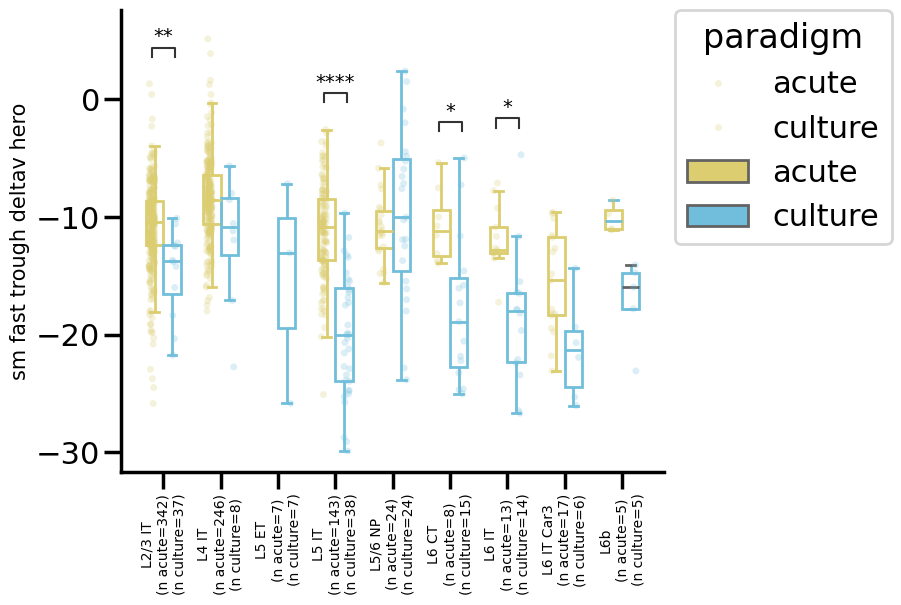

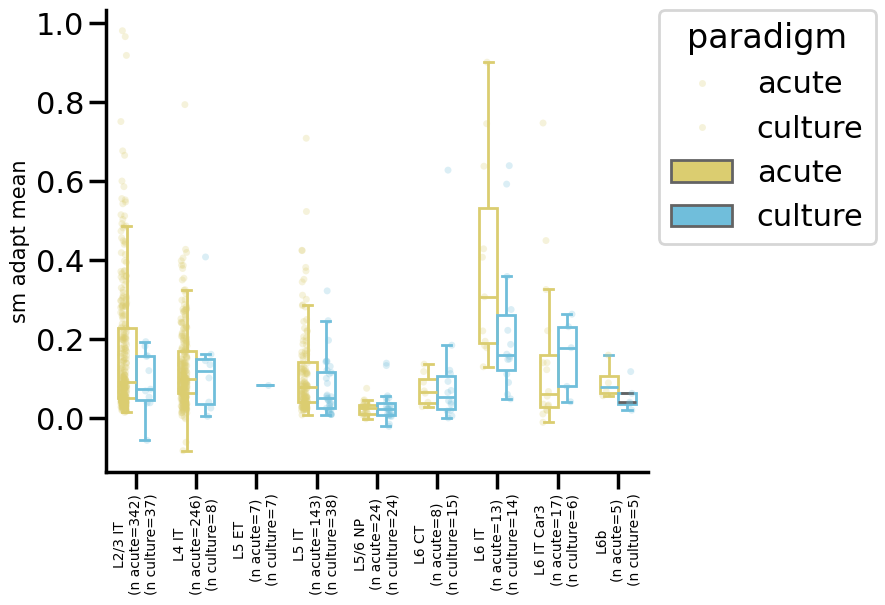

Boxplots with Mann-Whitney U stats saved.


In [24]:
# subclass x feature box plots
fig_name = 'human_excitatory_boxplots_ephys_features_paradigm_MWU_FDR_bySubclass.pdf'

x_var = 'subclass_label'
hue_var = 'paradigm'
x_order = groups #sorted_clean_data[x_var].unique().tolist()
hue_order = group_order[hue_var]
color_palette = color_dicts[hue_var]

fig_path = os.path.join(output_dir, fig_name)
ephys_features = feature_cols.copy()

with warnings.catch_warnings():
    warnings.simplefilter(action='ignore', category=FutureWarning)

    with PdfPages(fig_path) as pdf:
        for y_var in ephys_features:
            # fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(7, 6), sharex=True)
            fig, ax = plt.subplots(nrows=1,ncols=1,figsize=(7,6),sharex=True, gridspec_kw = {'wspace':0, 'hspace':0.1}) #gridspec_kw = {'wspace':0, 'hspace':0},

            sns.set_context('poster')
            strip = sns.stripplot(data=sorted_clean_data, x=x_var, y=y_var, hue=hue_var, palette=color_palette, order=x_order, alpha=0.25, dodge=True, size=5)
            sns.boxplot(data=sorted_clean_data, x=x_var, y=y_var, hue=hue_var, palette=color_palette, order=x_order, saturation=1, linewidth=2, width=0.6, showfliers = False)

            #format 
            format_box_plot(ax) #clear fill of box plots, color edges
            sns.despine(right=True, top=True)

            ax.set_xlabel("")
            ax.set_ylabel(y_var.replace("_", " "), rotation=90, size=15)
            
            ax.legend_.remove()
            handles, labels = strip.get_legend_handles_labels()
            ax.legend(handles, labels, title=hue_var, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)

            #add num observations per x_var
            nobs = []
            for s in x_order:
                nT = len(sorted_clean_data[(sorted_clean_data[x_var] == s) & (sorted_clean_data[hue_var] == 'acute')])
                nO = len(sorted_clean_data[(sorted_clean_data[x_var] == s) & (sorted_clean_data[hue_var] == 'culture')])
                nobs.append("\n(n acute={})\n(n culture={})".format(nT, nO))
            new_x_tick_labels = [x_order[i] + nobs[i] for i in range(len(x_order))]  
            ax.set_xticklabels(new_x_tick_labels)
            ax.tick_params(axis='x', rotation=90, labelsize=10)

            # Annotate p-values
            pairs = []
            p_values = []
            for subclass in x_order:
                key = (subclass, y_var)
                if key in mw_pvals_fdr:
                    pval = mw_pvals_fdr[key]
                    sig = mw_rejected.get(key, False)
                    if sig:
                        pairs.append([(subclass, 'acute'), (subclass, 'culture')])  # or vice versa
                        p_values.append(pval)

            # Only annotate if there are significant results
            if pairs:
                annotator = Annotator(ax, pairs, data=sorted_clean_data, x=x_var, y=y_var, hue=hue_var, order=x_order)
                annotator.configure(text_format="star", loc="inside", fontsize=14)
                annotator.set_pvalues_and_annotate(p_values)

            # fig.tight_layout()
            pdf.savefig(dpi=600, bbox_inches='tight')
        plt.show()
        plt.clf

    print("Boxplots with Mann-Whitney U stats saved.")


Cross paradigm box plots - ttype

In [8]:
# ttype x feature box plots

x_var = 'paradigm'
group1_label = 'acute'
group2_label = 'culture'
group_var = 't_type'

n_min_cells = 3
combo_counts = sorted_clean_data.groupby([group_var, x_var]).size().unstack(fill_value=0)
groups = combo_counts[(combo_counts >= n_min_cells).all(axis=1)].index.tolist()

# Collect p-values and stats by (ttype, feature)
mw_pvals = dict()
mw_stats = dict()

for group in groups:
    sub_data = sorted_clean_data[sorted_clean_data[group_var] == group]
    for f in feature_cols:
        group1 = sub_data[sub_data[x_var] == group1_label][f].dropna()
        group2 = sub_data[sub_data[x_var] == group2_label][f].dropna()

        if group1.empty or group2.empty:
            continue

        try:
            stat, pval = mannwhitneyu(group1, group2, alternative='two-sided')
            mw_pvals[(group, f)] = pval
            mw_stats[(group, f)] = stat
        except ValueError as e:
            print(f'Mann-Whitney failed for {group}, {f}: {e}')

# FDR correction across all tests (subclass-feature pairs)
mw_pvals_list = list(mw_pvals.values())
mw_rejected_list, mw_pvals_fdr_list = fdrcorrection(mw_pvals_list, alpha=0.05, method='indep', is_sorted=False)

mw_pvals_fdr = dict(zip(mw_pvals.keys(), mw_pvals_fdr_list))
mw_rejected = dict(zip(mw_pvals.keys(), mw_rejected_list))


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2625050737.py:42: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L5/6 NP_2_acute vs. L5/6 NP_2_culture: Custom statistical test, P_val:4.114e-02
L6 IT Car3_3_acute vs. L6 IT Car3_3_culture: Custom statistical test, P_val:3.117e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2625050737.py:42: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L6 IT_1_acute vs. L6 IT_1_culture: Custom statistical test, P_val:4.114e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2625050737.py:42: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2625050737.py:42: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L6 IT_1_acute vs. L6 IT_1_culture: Custom statistical test, P_val:4.339e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2625050737.py:42: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L5 IT_6_acute vs. L5 IT_6_culture: Custom statistical test, P_val:1.718e-02
L5 IT_7_acute vs. L5 IT_7_culture: Custom statistical test, P_val:1.426e-03
L6 IT_1_acute vs. L6 IT_1_culture: Custom statistical test, P_val:2.336e-02
L2 IT_1_acute vs. L2 IT_1_culture: Custom statistical test, P_val:4.114e-02
L3 IT_13_acute vs. L3 IT_13_culture: Custom statistical test, P_val:1.342e-04
L4 IT_2_acute vs. L4 IT_2_culture: Custom statistical test, P_val:6.790e-03
L4 IT_4_acute vs. L4 IT_4_culture: Custom statistical test, P_val:3.123e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2625050737.py:42: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L5 IT_6_acute vs. L5 IT_6_culture: Custom statistical test, P_val:1.718e-02
L5/6 NP_1_acute vs. L5/6 NP_1_culture: Custom statistical test, P_val:3.123e-02
L2 IT_1_acute vs. L2 IT_1_culture: Custom statistical test, P_val:6.047e-03
L3 IT_10_acute vs. L3 IT_10_culture: Custom statistical test, P_val:1.718e-02
L3 IT_13_acute vs. L3 IT_13_culture: Custom statistical test, P_val:4.114e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2625050737.py:42: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L5 IT_7_acute vs. L5 IT_7_culture: Custom statistical test, P_val:3.679e-02
L6 IT_1_acute vs. L6 IT_1_culture: Custom statistical test, P_val:4.339e-02
L5 IT_2_acute vs. L5 IT_2_culture: Custom statistical test, P_val:1.718e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2625050737.py:42: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2625050737.py:42: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2625050737.py:42: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2625050737.py:42: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users

p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L2 IT_2_acute vs. L2 IT_2_culture: Custom statistical test, P_val:2.336e-02
L2 IT_1_acute vs. L2 IT_1_culture: Custom statistical test, P_val:1.342e-04
L3 IT_5_acute vs. L3 IT_5_culture: Custom statistical test, P_val:3.117e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2625050737.py:42: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L5 IT_6_acute vs. L5 IT_6_culture: Custom statistical test, P_val:4.114e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2625050737.py:42: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2625050737.py:42: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2625050737.py:42: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2625050737.py:42: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users

p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L5 IT_6_acute vs. L5 IT_6_culture: Custom statistical test, P_val:4.114e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2625050737.py:19: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(nrows=1,ncols=1,figsize=(12,6),sharex=True, gridspec_kw = {'wspace':0, 'hspace':0.1}) #gridspec_kw = {'wspace':0, 'hspace':0},
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2625050737.py:42: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)
C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2625050737.py:42: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

L5 IT_6_acute vs. L5 IT_6_culture: Custom statistical test, P_val:1.342e-04
L5 IT_7_acute vs. L5 IT_7_culture: Custom statistical test, P_val:2.336e-02
L5 IT_2_acute vs. L5 IT_2_culture: Custom statistical test, P_val:3.117e-02
L2 IT_1_acute vs. L2 IT_1_culture: Custom statistical test, P_val:3.653e-02


C:\Users\sarah.wallingbell\AppData\Local\Temp\ipykernel_19596\2625050737.py:42: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(new_x_tick_labels)


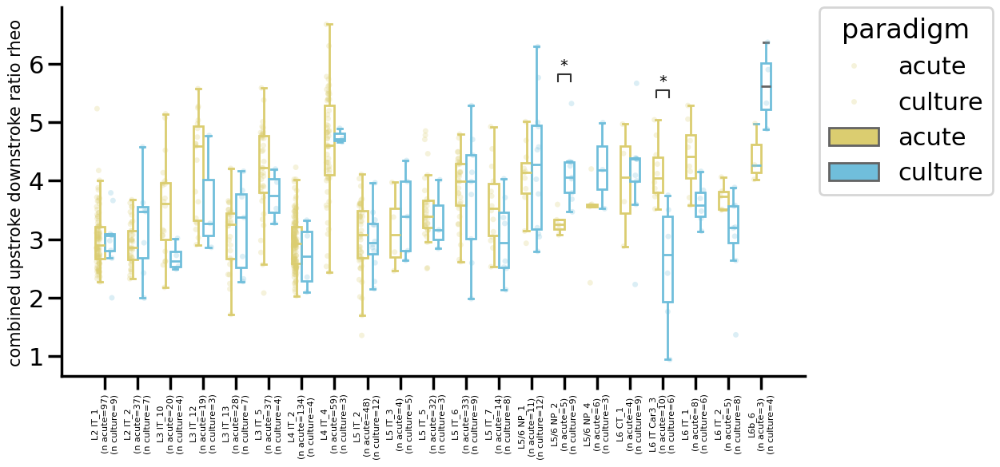

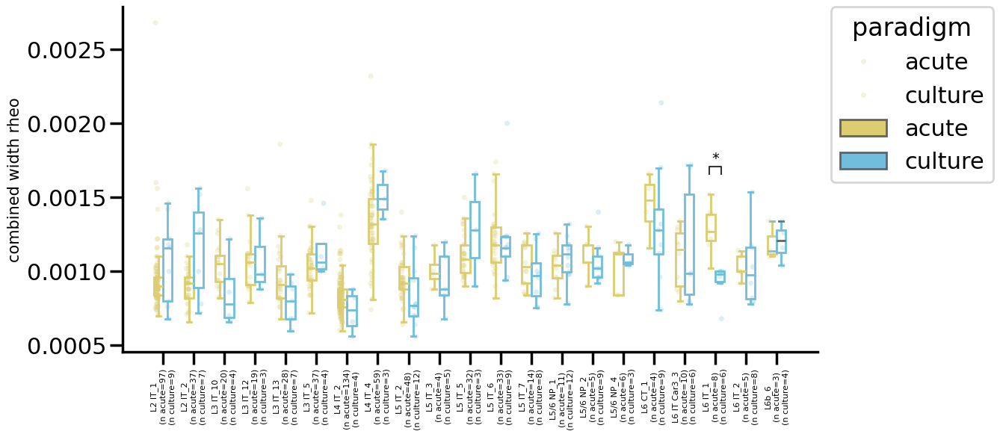

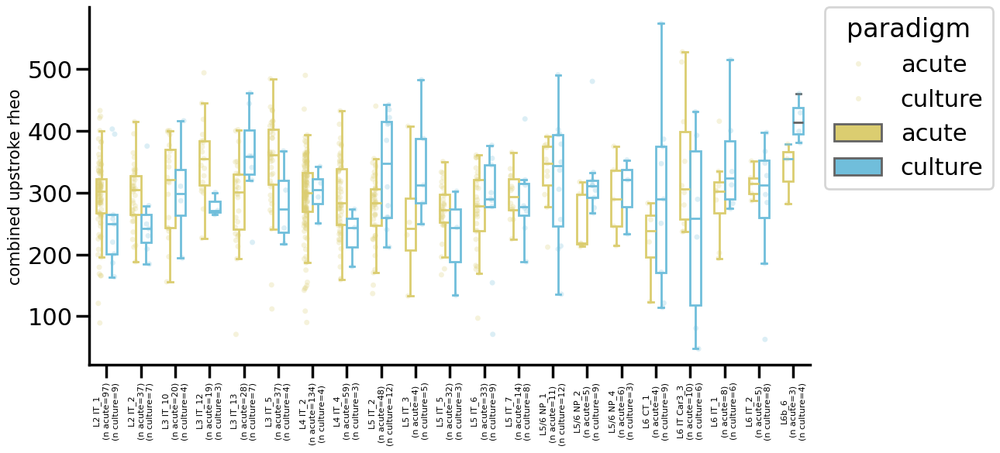

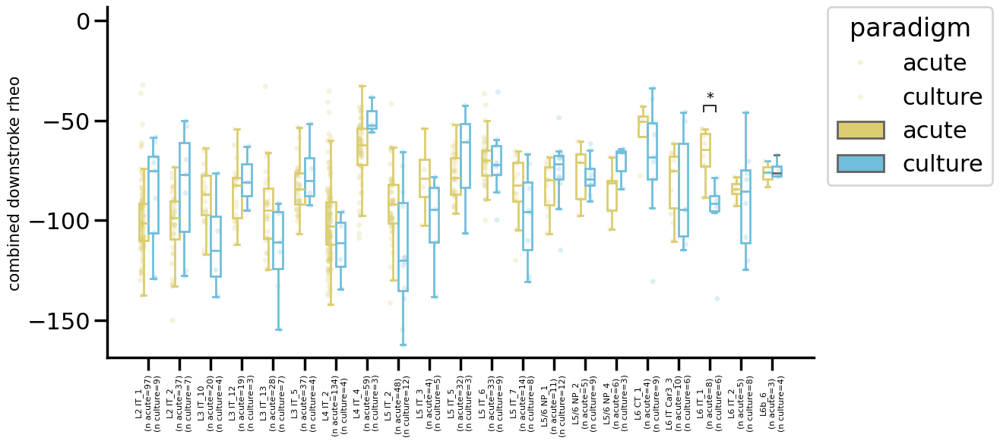

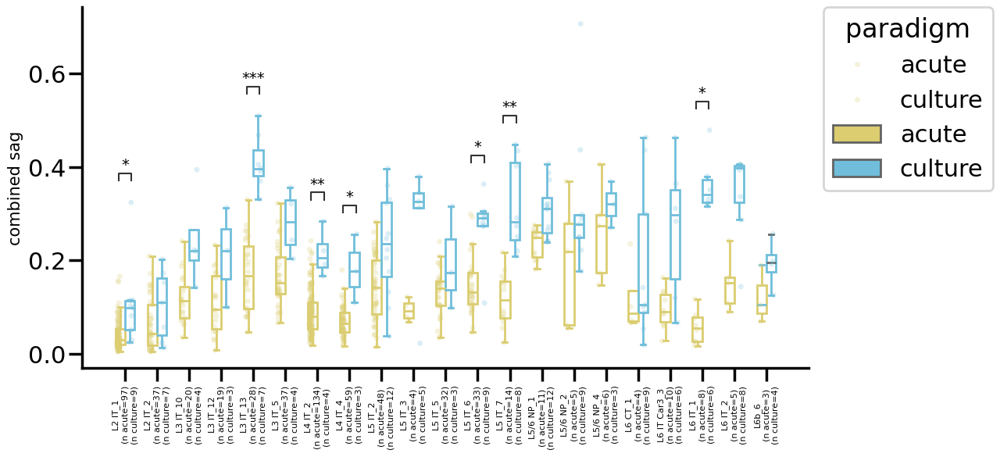

...

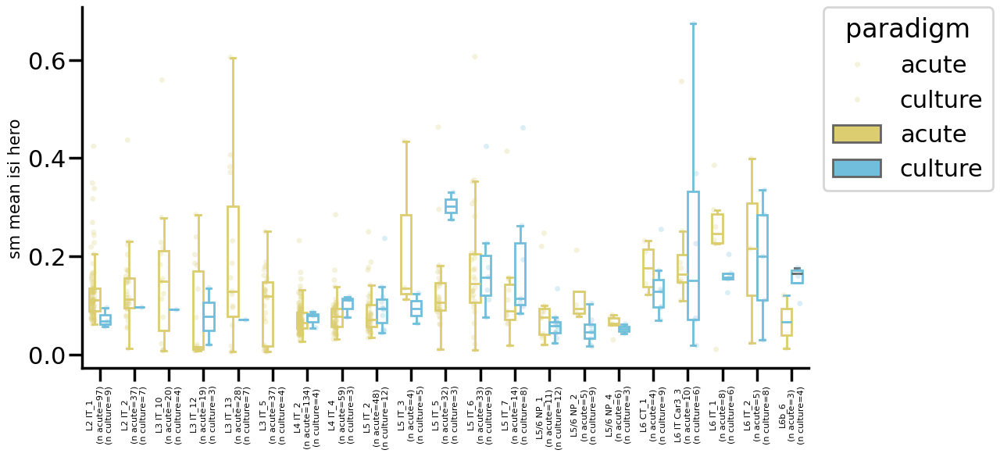

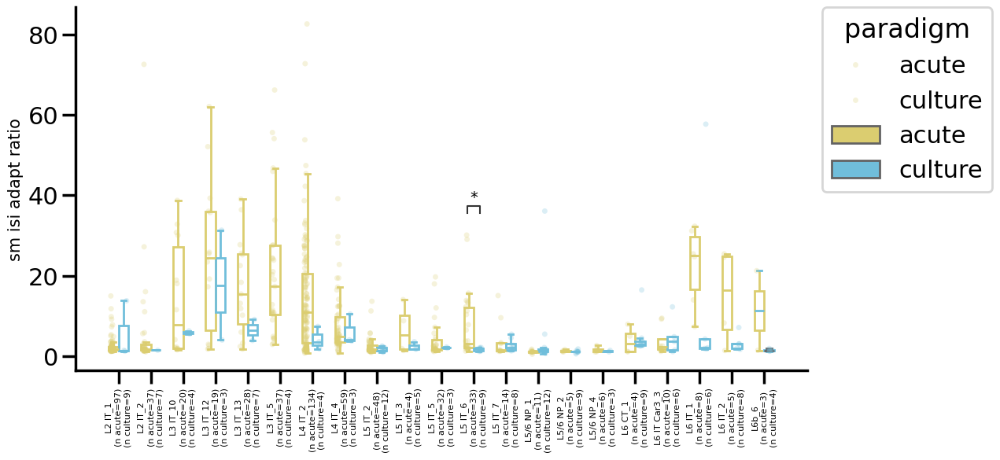

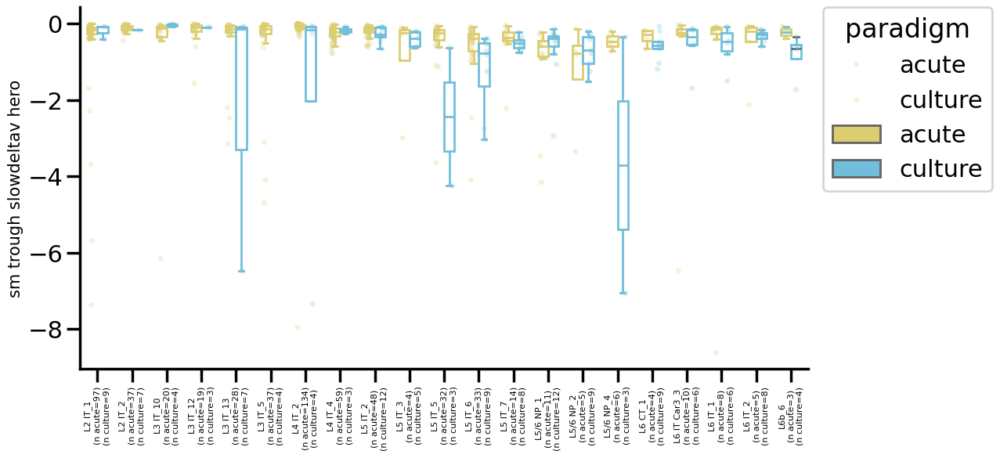

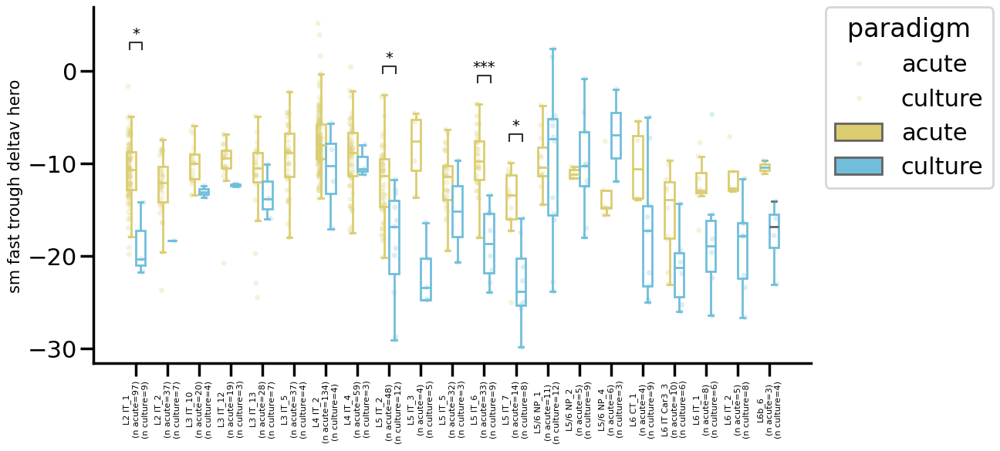

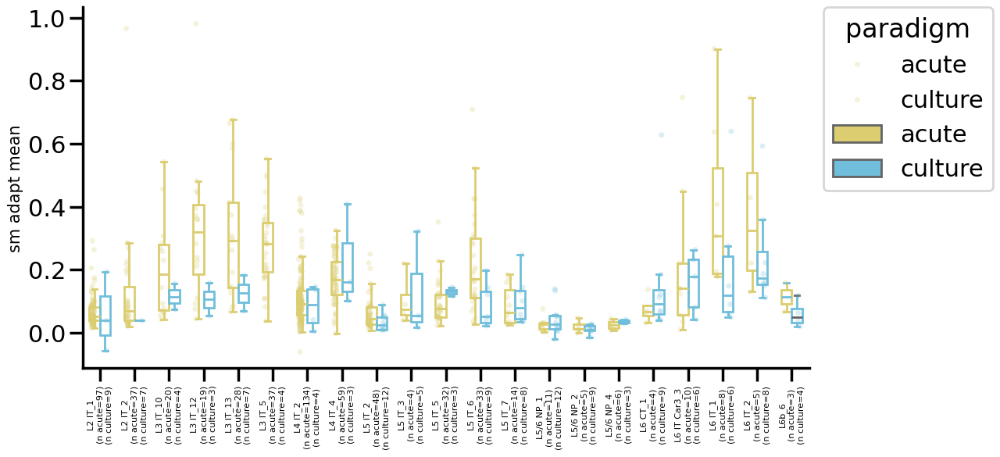

In [26]:
# ttype x feature box plots
fig_name = 'human_excitatory_boxplots_ephys_features_paradigm_MWU_FDR_byTtype.pdf'

x_var = 't_type'
hue_var = 'paradigm'
x_order = groups #sorted_clean_data[x_var].unique().tolist()
hue_order = ['acute', 'culture']
color_palette = color_dicts[hue_var]

fig_path = os.path.join(output_dir, fig_name)
ephys_features = feature_cols.copy()

with warnings.catch_warnings():
    warnings.simplefilter(action='ignore', category=FutureWarning)

    with PdfPages(fig_path) as pdf:
        for y_var in ephys_features:
            # fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(7, 6), sharex=True)
            fig, ax = plt.subplots(nrows=1,ncols=1,figsize=(12,6),sharex=True, gridspec_kw = {'wspace':0, 'hspace':0.1}) #gridspec_kw = {'wspace':0, 'hspace':0},

            sns.set_context('poster')
            strip = sns.stripplot(data=sorted_clean_data, x=x_var, y=y_var, hue=hue_var, palette=color_palette, order=x_order, alpha=0.25, dodge=True, size=5)
            sns.boxplot(data=sorted_clean_data, x=x_var, y=y_var, hue=hue_var, palette=color_palette, order=x_order, saturation=1, linewidth=2, width=0.6, showfliers = False)

            #format 
            format_box_plot(ax) #clear fill of box plots, color edges
            sns.despine(right=True, top=True)
            ax.set_xlabel("")
            ax.set_ylabel(y_var.replace("_", " "), rotation=90, size=15)
            
            ax.legend_.remove()
            handles, labels = strip.get_legend_handles_labels()
            ax.legend(handles, labels, title=hue_var, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)

            #add num observations per x_var
            nobs = []
            for s in x_order:
                nT = len(sorted_clean_data[(sorted_clean_data[x_var] == s) & (sorted_clean_data[hue_var] == 'acute')])
                nO = len(sorted_clean_data[(sorted_clean_data[x_var] == s) & (sorted_clean_data[hue_var] == 'culture')])
                nobs.append("\n(n acute={})\n(n culture={})".format(nT, nO))
            new_x_tick_labels = [x_order[i] + nobs[i] for i in range(len(x_order))]  
            ax.set_xticklabels(new_x_tick_labels)
            ax.tick_params(axis='x', rotation=90, labelsize=8)

            # Annotate p-values
            pairs = []
            p_values = []
            for subclass in x_order:
                key = (subclass, y_var)
                if key in mw_pvals_fdr:
                    pval = mw_pvals_fdr[key]
                    sig = mw_rejected.get(key, False)
                    if sig:
                        pairs.append([(subclass, 'acute'), (subclass, 'culture')])  # or vice versa
                        p_values.append(pval)

            # Only annotate if there are significant results
            if pairs:
                annotator = Annotator(ax, pairs, data=sorted_clean_data, x=x_var, y=y_var, hue=hue_var, order=x_order)
                annotator.configure(text_format="star", loc="inside", fontsize=14)
                annotator.set_pvalues_and_annotate(p_values)

            # fig.tight_layout()
            pdf.savefig(dpi=600, bbox_inches='tight')
        plt.show()
        plt.clf
